## Step 1: Loading and Preprocessing Images

### New Code for Loading and Preprocessing

code for original image sizes (711, 651, 1):

In [23]:
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split

# Define folders for each label
folder_paths = {
    "no_phase": 'Phase_shifter-new/no_phase/no_phase_first100',
    "pi_by_2_phase": 'Phase_shifter-new/pi_by_2_phase/pi_by_2_phase_first100',
    "zero_phase": 'Phase_shifter-new/zero_phase/zero_phase_first100'
}

images = []
labels = []

# Process each folder and assign labels
for label, folder_path in enumerate(folder_paths.values()):
    for filename in os.listdir(folder_path):
        if filename.endswith(".bmp"):
            image_path = os.path.join(folder_path, filename)
            image = Image.open(image_path)
            image = image.convert('L')  # Convert to grayscale
            image_array = np.array(image)
            images.append(image_array)
            # One-hot encoding: [1,0,0] for "no_phase", [0,1,0] for "pi_by_2_phase", [0,0,1] for "zero_phase"
            labels.append([int(label == 0), int(label == 1), int(label == 2)])

# Convert lists to numpy arrays
labels = np.array(labels)
images = np.array(images) / 255.0  # Normalize images to [0, 1] range
images = np.expand_dims(images, axis=-1)  # Add channel dimension

# Split into train+validation and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(images, labels, test_size=0.25, random_state=16)

# Further split train+validation into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.2, random_state=16)

print("Total images loaded and preprocessed:", len(images))
print("Training set size:", X_train.shape[0])
print("Validation set size:", X_val.shape[0])
print("Test set size:", X_test.shape[0])


Total images loaded and preprocessed: 300
Training set size: 180
Validation set size: 45
Test set size: 75


code to resize images to (256, 256, 1):

In [ ]:
'''
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split

# Define folders for each label
folder_paths = {
    "no_phase": 'Phase_shifter-new/no_phase/no_phase_first100',
    "pi_by_2_phase": 'Phase_shifter-new/pi_by_2_phase/pi_by_2_phase_first100',
    "zero_phase": 'Phase_shifter-new/zero_phase/zero_phase_first100'
}

# Define the target shape for resizing
target_shape = (256, 256)

images = []
labels = []

# Process each folder and assign labels
for label, folder_path in enumerate(folder_paths.values()):
    for filename in os.listdir(folder_path):
        if filename.endswith(".bmp"):
            image_path = os.path.join(folder_path, filename)
            image = Image.open(image_path)
            image = image.convert('L')  # Convert to grayscale
            image = image.resize(target_shape)  # Resize to (256, 256)
            image_array = np.array(image)
            images.append(image_array)
            # One-hot encoding: [1,0,0] for "no_phase", [0,1,0] for "pi_by_2_phase", [0,0,1] for "zero_phase"
            labels.append([int(label == 0), int(label == 1), int(label == 2)])

# Convert lists to numpy arrays
labels = np.array(labels)
images = np.array(images) / 255.0  # Normalize images to [0, 1] range
images = np.expand_dims(images, axis=-1)  # Add channel dimension

# Split into train+validation and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(images, labels, test_size=0.25, random_state=16)

# Further split train+validation into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.2, random_state=16)

print("Total images loaded and preprocessed:", len(images))
print("Training set size:", X_train.shape[0])
print("Validation set size:", X_val.shape[0])
print("Test set size:", X_test.shape[0])
'''


Total images loaded and preprocessed: 300
Training set size: 180
Validation set size: 45
Test set size: 75


## Step 2: Create Classification Model

### Efficient code for the new CNN which takes into consideration all the features and creates a fully connected CNN

Code that creates classification model for the original image without resizing:

In [24]:
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers

model = Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(711, 651, 1), padding="same"))
model.add(layers.Conv2D(32, (3, 3), activation='relu', padding="same"))
model.add(layers.MaxPooling2D((2, 2), padding="same"))
model.add(layers.BatchNormalization())
'''
model.add(layers.Conv2D(64, (3, 3), activation='relu', padding="same"))
model.add(layers.Conv2D(64, (3, 3), activation='relu', padding="same"))
model.add(layers.MaxPooling2D((2, 2), padding="same"))
model.add(layers.BatchNormalization())

model.add(layers.Conv2D(128, (3, 3), activation='relu', padding="same"))
model.add(layers.Conv2D(128, (3, 3), activation='relu', padding="same"))
model.add(layers.MaxPooling2D((2, 2), padding="same"))
model.add(layers.BatchNormalization())
'''

model.add(layers.GlobalAveragePooling2D())
model.add(layers.Dense(units=512, activation='relu'))
model.add(layers.Dropout(0.5))  # Dropout to prevent overfitting
model.add(layers.Dense(units=3, activation='softmax'))  # 3 units for 3 classes

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])


/Users/nayanthara/Library/Python/3.9/lib/python/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [25]:
# Display the model summary
model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 711, 651, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 711, 651, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 356, 326, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 356, 326, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_4      │ (None, 32)             │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │        16,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 3)              │         1,539 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,131 (109.89 KB)

 Trainable params: 28,067 (109.64 KB)

 Non-trainable params: 64 (256.00 B)

### Code to classify the model for resized images:

In [19]:
'''
from tensorflow.keras import Sequential, layers

model = Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 1), padding="same"))
model.add(layers.Conv2D(32, (3, 3), activation='relu', padding="same"))
model.add(layers.MaxPooling2D((2, 2), padding="same"))

model.add(layers.Conv2D(64, (3, 3), activation='relu', padding="same"))
model.add(layers.BatchNormalization())
model.add(layers.Conv2D(64, (3, 3), activation='relu', padding="same"))
model.add(layers.MaxPooling2D((2, 2), padding="same"))

model.add(layers.Conv2D(128, (3, 3), activation='relu', padding="same"))
model.add(layers.Conv2D(128, (3, 3), activation='relu', padding="same"))
model.add(layers.MaxPooling2D((2, 2), padding="same"))

model.add(layers.GlobalAveragePooling2D())
model.add(layers.Dense(units=512, activation='relu'))
model.add(layers.Dropout(0.5))  # Dropout for regularization
model.add(layers.Dense(units=3, activation='softmax'))  # 3 classes

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
'''


'\nfrom tensorflow.keras import Sequential, layers\n\nmodel = Sequential()\nmodel.add(layers.Conv2D(32, (3, 3), activation=\'relu\', input_shape=(256, 256, 1), padding="same"))\nmodel.add(layers.Conv2D(32, (3, 3), activation=\'relu\', padding="same"))\nmodel.add(layers.MaxPooling2D((2, 2), padding="same"))\n\nmodel.add(layers.Conv2D(64, (3, 3), activation=\'relu\', padding="same"))\nmodel.add(layers.BatchNormalization())\nmodel.add(layers.Conv2D(64, (3, 3), activation=\'relu\', padding="same"))\nmodel.add(layers.MaxPooling2D((2, 2), padding="same"))\n\nmodel.add(layers.Conv2D(128, (3, 3), activation=\'relu\', padding="same"))\nmodel.add(layers.Conv2D(128, (3, 3), activation=\'relu\', padding="same"))\nmodel.add(layers.MaxPooling2D((2, 2), padding="same"))\n\nmodel.add(layers.GlobalAveragePooling2D())\nmodel.add(layers.Dense(units=512, activation=\'relu\'))\nmodel.add(layers.Dropout(0.5))  # Dropout for regularization\nmodel.add(layers.Dense(units=3, activation=\'softmax\'))  # 3 classe

In [20]:
# Display the model summary
#model.summary()

## Step 3: Model Training

#### Includes train dataset, test dataset and validation dataset, unlike the previous code that only had train and validation

In [26]:
#initial code
'''
import sys
import os
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

train_dataset = X_train_val
val_dataset = X_val
test_dataset = y_test
# Suppress output class to mute the training logs
class SuppressOutput:
    def __enter__(self):
        self._original_stdout = sys.stdout
        sys.stdout = open(os.devnull, 'w')

    def __exit__(self, exc_type, exc_value, traceback):
        sys.stdout.close()
        sys.stdout = self._original_stdout

# Define the callbacks
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0.01, patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6, verbose=1)

# Train the model with updated parameters
with SuppressOutput():
    history = model.fit(
        train_dataset,
        epochs=100,  # Increased epoch count
        steps_per_epoch=len(X_train) // 32,
        validation_data=val_dataset,
        callbacks=[early_stopping, reduce_lr]
    )

print("Model training complete.")

# Evaluate the model on the test dataset
test_loss, test_accuracy = model.evaluate(test_dataset)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")
'''


'\nimport sys\nimport os\nfrom tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau\nimport tensorflow as tf\n\ntrain_dataset = X_train_val\nval_dataset = X_val\ntest_dataset = y_test\n# Suppress output class to mute the training logs\nclass SuppressOutput:\n    def __enter__(self):\n        self._original_stdout = sys.stdout\n        sys.stdout = open(os.devnull, \'w\')\n\n    def __exit__(self, exc_type, exc_value, traceback):\n        sys.stdout.close()\n        sys.stdout = self._original_stdout\n\n# Define the callbacks\nearly_stopping = EarlyStopping(monitor=\'val_loss\', min_delta=0.01, patience=10, restore_best_weights=True)\nreduce_lr = ReduceLROnPlateau(monitor=\'val_loss\', factor=0.5, patience=3, min_lr=1e-6, verbose=1)\n\n# Train the model with updated parameters\nwith SuppressOutput():\n    history = model.fit(\n        train_dataset,\n        epochs=100,  # Increased epoch count\n        steps_per_epoch=len(X_train) // 32,\n        validation_data=val_datas

In [27]:
import sys
import os
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

# Convert training, validation, and test data to TensorFlow dataset format
train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
train_dataset = train_dataset.shuffle(buffer_size=len(X_train)).batch(32).repeat()

val_dataset = tf.data.Dataset.from_tensor_slices((X_val, y_val))
val_dataset = val_dataset.batch(32)  # No need to shuffle validation data

test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))
test_dataset = test_dataset.batch(32)  # No need to shuffle test data

# Suppress output class to mute the training logs
class SuppressOutput:
    def __enter__(self):
        self._original_stdout = sys.stdout
        sys.stdout = open(os.devnull, 'w')

    def __exit__(self, exc_type, exc_value, traceback):
        sys.stdout.close()
        sys.stdout = self._original_stdout

# Define the callbacks
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0.01, patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6, verbose=1)

# Train the model with updated parameters
with SuppressOutput():
    history = model.fit(
        train_dataset,
        epochs=100,  # Increased epoch count
        steps_per_epoch=len(X_train) // 32,
        validation_data=val_dataset,
        callbacks=[early_stopping, reduce_lr]
    )

print("Model training complete.")

# Evaluate the model on the test dataset
test_loss, test_accuracy = model.evaluate(test_dataset)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")


Model training complete.
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 790ms/step - accuracy: 0.2951 - loss: 1.1041
Test Loss: 1.1045, Test Accuracy: 0.2933


Importing necessary packages

In [28]:
from keras.applications import inception_v3 as inc_net
from keras.preprocessing import image
from lime import lime_image
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import glob
import imageio
import os
import PIL
import cv2

/Users/nayanthara/Library/Python/3.9/lib/python/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Model Output - LIME Explanation for the images



  0%|          | 0/1000 [00:00<?, ?it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step



  1%|          | 10/1000 [00:00<00:37, 26.39it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


  2%|▏         | 20/1000 [00:00<00:31, 30.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step



  2%|▏         | 20/1000 [00:00<00:32, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step



  3%|▎         | 30/1000 [00:00<00:29, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

  3%|▎         | 30/1000 [00:00<00:29, 32.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step



  3%|▎         | 30/1000 [00:00<00:30, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


  4%|▍         | 40/1000 [00:01<00:33, 28.75it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  5%|▌         | 50/1000 [00:01<00:33, 28.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step





  5%|▌         | 50/1000 [00:01<00:33, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


  6%|▌         | 60/1000 [00:01<00:26, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

  6%|▌         | 60/1000 [00:02<00:33, 28.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  7%|▋         | 70/1000 [00:02<00:24, 37.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  8%|▊         | 80/1000 [00:02<00:25, 36.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

  9%|▉         | 90/1000 [00:02<00:24, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

  9%|▉         | 90/1000 [00:02<00:26, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 10%|█         | 100/1000 [00:02<00:24, 37.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 11%|█         | 110/1000 [00:03<00:20, 42.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 12%|█▏        | 120/1000 [00:03<00:20, 42.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 11%|█         | 110/1000 [00:03<00:27, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 13%|█▎        | 130/1000 [00:03<00:22, 38.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 14%|█▍        | 140/1000 [00:04<00:26, 32.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

 15%|█▌        | 150/1000 [00:04<00:25, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 16%|█▌        | 160/1000 [00:04<00:25, 33.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 17%|█▋        | 170/1000 [00:04<00:25, 32.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step




 16%|█▌        | 160/1000 [00:05<00:24, 33.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 18%|█▊        | 180/1000 [00:05<00:22, 35.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 19%|█▉        | 190/1000 [00:05<00:22, 36.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 19%|█▉        | 190/1000 [00:05<00:20, 38.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

 20%|██        | 200/1000 [00:05<00:23, 33.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 21%|██        | 210/1000 [00:06<00:22, 34.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 22%|██▏       | 220/1000 [00:06<00:23, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 23%|██▎       | 230/1000 [00:06<00:20, 37.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 24%|██▍       | 240/1000 [00:06<00:19, 38.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step




 24%|██▍       | 240/1000 [00:07<00:19, 39.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 25%|██▌       | 250/1000 [00:07<00:21, 34.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 26%|██▌       | 260/1000 [00:07<00:19, 38.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



 26%|██▌       | 260/1000 [00:07<00:23, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step




 27%|██▋       | 270/1000 [00:07<00:17, 41.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step



 28%|██▊       | 279/1000 [00:07<00:14, 49.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 28%|██▊       | 285/1000 [00:07<00:17, 40.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 29%|██▉       | 290/1000 [00:08<00:20, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step




 29%|██▉       | 290/1000 [00:08<00:15, 47.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 30%|███       | 300/1000 [00:08<00:21, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 31%|███       | 310/1000 [00:08<00:17, 40.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 32%|███▏      | 320/1000 [00:08<00:18, 36.23it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 31%|███       | 310/1000 [00:08<00:23, 29.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

 32%|███▏      | 320/1000 [00:08<00:16, 42.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 33%|███▎      | 330/1000 [00:09<00:16, 39.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

 33%|███▎      | 330/1000 [00:09<00:18, 36.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 34%|███▍      | 340/1000 [00:09<00:16, 40.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 35%|███▌      | 350/1000 [00:09<00:17, 36.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 34%|███▍      | 340/1000 [00:09<00:19, 33.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step




 36%|███▌      | 360/1000 [00:09<00:17, 36.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step




 36%|███▌      | 360/1000 [00:10<00:18, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step



 37%|███▋      | 370/1000 [00:10<00:18, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 38%|███▊      | 380/1000 [00:10<00:17, 35.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 39%|███▉      | 390/1000 [00:10<00:16, 37.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step





 38%|███▊      | 380/1000 [00:10<00:17, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step




 38%|███▊      | 380/1000 [00:10<00:20, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 40%|████      | 400/1000 [00:10<00:14, 40.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step



 41%|████      | 410/1000 [00:11<00:14, 39.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 42%|████▏     | 420/1000 [00:11<00:15, 36.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step

 41%|████      | 410/1000 [00:11<00:16, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 43%|████▎     | 430/1000 [00:11<00:15, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 42%|████▏     | 420/1000 [00:12<00:17, 32.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 44%|████▍     | 440/1000 [00:12<00:16, 34.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 44%|████▍     | 440/1000 [00:12<00:14, 37.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 45%|████▌     | 450/1000 [00:12<00:15, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 46%|████▌     | 460/1000 [00:12<00:15, 35.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 47%|████▋     | 470/1000 [00:13<00:16, 32.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step



 47%|████▋     | 470/1000 [00:13<00:12, 41.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step



 48%|████▊     | 480/1000 [00:13<00:15, 33.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 49%|████▉     | 490/1000 [00:13<00:16, 30.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 50%|█████     | 500/1000 [00:14<00:16, 30.29it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 48%|████▊     | 480/1000 [00:14<00:17, 30.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 51%|█████     | 510/1000 [00:14<00:17, 28.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step




 49%|████▉     | 490/1000 [00:14<00:18, 27.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 52%|█████▏    | 520/1000 [00:14<00:14, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 53%|█████▎    | 530/1000 [00:14<00:13, 35.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 54%|█████▍    | 540/1000 [00:15<00:13, 34.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 55%|█████▌    | 550/1000 [00:15<00:13, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 56%|█████▌    | 560/1000 [00:15<00:13, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 54%|█████▍    | 540/1000 [00:15<00:13, 34.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 55%|█████▌    | 550/1000 [00:16<00:14, 31.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 57%|█████▋    | 570/1000 [00:16<00:14, 30.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step




 60%|██████    | 600/1000 [00:16<00:11, 36.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

 58%|█████▊    | 580/1000 [00:16<00:13, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

 61%|██████    | 610/1000 [00:16<00:10, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 59%|█████▉    | 590/1000 [00:16<00:12, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 62%|██████▏   | 620/1000 [00:17<00:10, 35.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 60%|██████    | 600/1000 [00:17<00:11, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 61%|██████    | 610/1000 [00:17<00:11, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 62%|██████▏   | 620/1000 [00:17<00:10, 37.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 63%|██████▎   | 630/1000 [00:17<00:10, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 64%|██████▍   | 640/1000 [00:18<00:11, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 65%|██████▌   | 650/1000 [00:18<00:10, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 66%|██████▌   | 660/1000 [00:18<00:09, 34.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

 67%|██████▋   | 670/1000 [00:19<00:09, 33.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

 68%|██████▊   | 680/1000 [00:19<00:10, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step




 69%|██████▉   | 690/1000 [00:19<00:09, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step




 72%|███████▏  | 720/1000 [00:20<00:08, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

 70%|███████   | 700/1000 [00:20<00:09, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 71%|███████   | 710/1000 [00:20<00:08, 33.14it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

 70%|███████   | 700/1000 [00:20<00:09, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step







 71%|███████   | 707/1000 [00:20<00:07, 40.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 72%|███████▏  | 720/1000 [00:20<00:09, 30.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 73%|███████▎  | 730/1000 [00:21<00:08, 31.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 74%|███████▍  | 740/1000 [00:21<00:07, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 72%|███████▏  | 720/1000 [00:21<00:09, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step



 73%|███████▎  | 730/1000 [00:21<00:07, 33.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 80%|███████▉  | 799/1000 [00:21<00:03, 57.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 75%|███████▌  | 750/1000 [00:21<00:07, 34.04it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 76%|███████▌  | 760/1000 [00:21<00:07, 32.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 77%|███████▋  | 770/1000 [00:22<00:07, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 76%|███████▌  | 760/1000 [00:22<00:07, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 78%|███████▊  | 780/1000 [00:22<00:06, 33.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 79%|███████▉  | 790/1000 [00:22<00:05, 36.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step



 80%|████████  | 800/1000 [00:23<00:06, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 81%|████████  | 810/1000 [00:23<00:05, 33.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 80%|████████  | 800/1000 [00:23<00:05, 37.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


 82%|████████▏ | 820/1000 [00:23<00:04, 39.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step




 88%|████████▊ | 880/1000 [00:23<00:03, 39.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 83%|████████▎ | 830/1000 [00:23<00:04, 39.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 84%|████████▍ | 840/1000 [00:24<00:04, 39.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 90%|█████████ | 900/1000 [00:24<00:02, 39.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 85%|████████▌ | 850/1000 [00:24<00:04, 36.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step

 91%|█████████ | 910/1000 [00:24<00:02, 40.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 86%|████████▌ | 860/1000 [00:24<00:03, 36.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 85%|████████▌ | 850/1000 [00:24<00:04, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▌ | 860/1000 [00:24<00:03, 39.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 87%|████████▋ | 870/1000 [00:24<00:03, 42.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



 88%|████████▊ | 880/1000 [00:25<00:03, 37.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 89%|████████▉ | 890/1000 [00:25<00:03, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 90%|█████████ | 900/1000 [00:25<00:02, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 91%|█████████ | 910/1000 [00:26<00:02, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



 92%|█████████▏| 920/1000 [00:26<00:02, 35.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step



 93%|█████████▎| 930/1000 [00:26<00:01, 36.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step



 94%|█████████▍| 940/1000 [00:26<00:01, 37.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step




 95%|█████████▌| 950/1000 [00:27<00:01, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 96%|█████████▌| 960/1000 [00:27<00:01, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 95%|█████████▌| 950/1000 [00:27<00:01, 30.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 97%|█████████▋| 970/1000 [00:27<00:00, 38.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 989/1000 [00:28<00:00, 45.91it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


100%|█████████▉| 995/1000 [00:28<00:00, 34.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


  1%|          | 10/1000 [00:00<00:17, 55.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step




100%|██████████| 1000/1000 [00:29<00:00, 34.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

  6%|▋         | 64/1000 [00:02<00:35, 26.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  2%|▏         | 20/1000 [00:00<00:33, 29.38it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


  3%|▎         | 30/1000 [00:01<00:36, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  4%|▍         | 40/1000 [00:01<00:27, 35.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step



  7%|▋         | 70/1000 [00:01<00:24, 37.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  5%|▌         | 50/1000 [00:01<00:24, 38.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step



  8%|▊         | 80/1000 [00:02<00:27, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  6%|▌         | 60/1000 [00:01<00:28, 33.49it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


  7%|▋         | 70/1000 [00:02<00:27, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  8%|▊         | 80/1000 [00:02<00:28, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step



 13%|█▎        | 130/1000 [00:04<00:28, 30.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


  9%|▉         | 90/1000 [00:02<00:29, 30.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 10%|█         | 100/1000 [00:03<00:28, 32.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 11%|█         | 110/1000 [00:03<00:25, 35.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 16%|█▌        | 160/1000 [00:05<00:22, 37.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 12%|█▏        | 120/1000 [00:03<00:24, 36.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 17%|█▋        | 170/1000 [00:05<00:24, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step




 13%|█▎        | 130/1000 [00:03<00:24, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 14%|█▍        | 140/1000 [00:04<00:24, 35.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

 18%|█▊        | 180/1000 [00:04<00:22, 36.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 35.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step



 19%|█▉        | 190/1000 [00:05<00:22, 35.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 16%|█▌        | 160/1000 [00:04<00:24, 34.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 17%|█▋        | 170/1000 [00:04<00:21, 38.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 18%|█▊        | 180/1000 [00:05<00:19, 43.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 22%|██▏       | 220/1000 [00:06<00:22, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step




 19%|█▉        | 190/1000 [00:05<00:18, 44.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 22%|██▏       | 220/1000 [00:06<00:21, 35.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 17%|█▋        | 170/1000 [00:04<00:23, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 20%|██        | 200/1000 [00:05<00:19, 41.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 21%|██        | 210/1000 [00:05<00:21, 36.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 24%|██▍       | 240/1000 [00:07<00:23, 32.47it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 22%|██▏       | 220/1000 [00:06<00:22, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 23%|██▎       | 230/1000 [00:06<00:23, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 24%|██▍       | 240/1000 [00:06<00:23, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step




 28%|██▊       | 280/1000 [00:08<00:19, 36.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 25%|██▌       | 250/1000 [00:07<00:20, 35.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 22%|██▏       | 220/1000 [00:06<00:27, 28.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 26%|██▌       | 260/1000 [00:07<00:19, 37.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 27%|██▋       | 270/1000 [00:07<00:19, 38.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 280/1000 [00:07<00:18, 38.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 24%|██▍       | 240/1000 [00:07<00:23, 31.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 29%|██▉       | 290/1000 [00:08<00:16, 42.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step



 32%|███▏      | 320/1000 [00:08<00:19, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 30%|███       | 300/1000 [00:08<00:17, 41.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 31%|███       | 310/1000 [00:08<00:21, 31.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 34%|███▍      | 340/1000 [00:09<00:18, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 32%|███▏      | 320/1000 [00:09<00:21, 31.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 33%|███▎      | 330/1000 [00:09<00:18, 37.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step





 34%|███▍      | 340/1000 [00:09<00:18, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 38%|███▊      | 380/1000 [00:10<00:15, 39.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 35%|███▌      | 350/1000 [00:09<00:18, 34.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 38%|███▊      | 380/1000 [00:11<00:17, 34.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 36%|███▌      | 360/1000 [00:10<00:16, 38.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 37%|███▋      | 370/1000 [00:10<00:18, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 38%|███▊      | 380/1000 [00:10<00:17, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

 42%|████▏     | 420/1000 [00:12<00:15, 37.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 39%|███▉      | 390/1000 [00:11<00:19, 31.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step





 34%|███▍      | 340/1000 [00:10<00:19, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 40%|████      | 400/1000 [00:11<00:18, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 41%|████      | 410/1000 [00:11<00:15, 38.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step




 45%|████▌     | 450/1000 [00:13<00:14, 37.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step




 42%|████▏     | 420/1000 [00:11<00:17, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 46%|████▌     | 460/1000 [00:13<00:13, 40.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 43%|████▎     | 430/1000 [00:12<00:15, 37.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step



 44%|████▍     | 440/1000 [00:12<00:14, 37.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 45%|████▌     | 450/1000 [00:12<00:15, 35.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 46%|████▌     | 460/1000 [00:12<00:12, 41.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 470/1000 [00:13<00:13, 39.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 48%|████▊     | 480/1000 [00:13<00:14, 36.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 49%|████▉     | 490/1000 [00:13<00:13, 37.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 50%|█████     | 500/1000 [00:13<00:12, 39.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 51%|█████     | 510/1000 [00:14<00:13, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 52%|█████▏    | 520/1000 [00:14<00:13, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

 55%|█████▌    | 550/1000 [00:16<00:11, 38.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 53%|█████▎    | 530/1000 [00:14<00:12, 38.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 54%|█████▍    | 540/1000 [00:14<00:11, 40.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 57%|█████▋    | 570/1000 [00:16<00:11, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 55%|█████▌    | 550/1000 [00:15<00:11, 38.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 56%|█████▌    | 560/1000 [00:15<00:11, 37.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step





 51%|█████     | 510/1000 [00:14<00:14, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 57%|█████▋    | 570/1000 [00:15<00:11, 36.20it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 61%|██████    | 610/1000 [00:17<00:10, 36.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 58%|█████▊    | 580/1000 [00:16<00:11, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 59%|█████▉    | 590/1000 [00:16<00:11, 35.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step




 66%|██████▌   | 660/1000 [00:17<00:09, 36.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step




 60%|██████    | 600/1000 [00:16<00:13, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

 67%|██████▋   | 670/1000 [00:17<00:09, 35.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step




 61%|██████    | 610/1000 [00:16<00:11, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 62%|██████▏   | 620/1000 [00:17<00:11, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

 67%|██████▋   | 670/1000 [00:19<00:08, 36.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 63%|██████▎   | 630/1000 [00:17<00:11, 31.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 71%|███████   | 710/1000 [00:18<00:07, 37.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step




 64%|██████▍   | 640/1000 [00:17<00:11, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 65%|██████▌   | 650/1000 [00:18<00:11, 31.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 66%|██████▌   | 660/1000 [00:18<00:10, 33.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 62%|██████▏   | 620/1000 [00:17<00:10, 36.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

 63%|██████▎   | 630/1000 [00:18<00:10, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 67%|██████▋   | 670/1000 [00:18<00:10, 31.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step



 75%|███████▌  | 750/1000 [00:19<00:07, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step



 68%|██████▊   | 680/1000 [00:19<00:09, 32.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 69%|██████▉   | 690/1000 [00:19<00:09, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 76%|███████▌  | 760/1000 [00:19<00:06, 34.91it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step






 75%|███████▌  | 750/1000 [00:21<00:06, 36.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 70%|███████   | 700/1000 [00:19<00:09, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 78%|███████▊  | 780/1000 [00:20<00:06, 35.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 71%|███████   | 710/1000 [00:20<00:08, 34.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 72%|███████▏  | 720/1000 [00:20<00:07, 35.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 68%|██████▊   | 680/1000 [00:19<00:09, 35.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


 73%|███████▎  | 730/1000 [00:20<00:06, 42.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 69%|██████▉   | 690/1000 [00:19<00:09, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

 78%|███████▊  | 780/1000 [00:22<00:06, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 74%|███████▍  | 740/1000 [00:20<00:06, 41.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 75%|███████▌  | 750/1000 [00:20<00:06, 40.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 80%|████████  | 800/1000 [00:22<00:05, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 76%|███████▌  | 760/1000 [00:21<00:05, 41.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 77%|███████▋  | 770/1000 [00:21<00:06, 38.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step




 81%|████████  | 810/1000 [00:23<00:05, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

 72%|███████▏  | 720/1000 [00:20<00:08, 33.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 78%|███████▊  | 780/1000 [00:21<00:05, 43.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step





 73%|███████▎  | 730/1000 [00:21<00:08, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 79%|███████▉  | 790/1000 [00:21<00:04, 44.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 86%|████████▌ | 860/1000 [00:22<00:03, 38.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 83%|████████▎ | 830/1000 [00:23<00:05, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 80%|████████  | 800/1000 [00:22<00:04, 40.70it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step




 81%|████████  | 810/1000 [00:22<00:04, 39.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 82%|████████▏ | 820/1000 [00:22<00:04, 38.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 83%|████████▎ | 830/1000 [00:22<00:03, 43.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step



 84%|████████▍ | 840/1000 [00:23<00:03, 44.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step




 85%|████████▌ | 850/1000 [00:23<00:03, 41.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

 79%|███████▉  | 790/1000 [00:22<00:06, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 860/1000 [00:23<00:03, 37.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 90%|█████████ | 900/1000 [00:25<00:02, 35.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 87%|████████▋ | 870/1000 [00:23<00:03, 36.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 88%|████████▊ | 880/1000 [00:24<00:03, 36.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

 92%|█████████▏| 920/1000 [00:26<00:02, 36.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step




 89%|████████▉ | 890/1000 [00:24<00:02, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 90%|█████████ | 900/1000 [00:24<00:02, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step




 83%|████████▎ | 830/1000 [00:24<00:04, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 91%|█████████ | 910/1000 [00:25<00:02, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 92%|█████████▏| 920/1000 [00:25<00:01, 40.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 93%|█████████▎| 930/1000 [00:25<00:01, 42.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 94%|█████████▍| 940/1000 [00:25<00:01, 40.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


100%|██████████| 1000/1000 [00:26<00:00, 38.14it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 95%|█████████▌| 950/1000 [00:26<00:01, 38.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 96%|█████████▌| 960/1000 [00:26<00:00, 42.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  2%|▏         | 20/1000 [00:00<00:29, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step




 97%|█████████▋| 970/1000 [00:26<00:00, 38.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step




100%|██████████| 1000/1000 [00:28<00:00, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 98%|█████████▊| 980/1000 [00:26<00:00, 36.74it/s]

100%|██████████| 1000/1000 [00:28<00:00, 35.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 99%|█████████▉| 990/1000 [00:27<00:00, 39.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step



  4%|▍         | 40/1000 [00:01<00:31, 30.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


100%|██████████| 1000/1000 [00:27<00:00, 36.76it/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step




  1%|          | 10/1000 [00:00<00:19, 49.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step




  2%|▏         | 20/1000 [00:00<00:28, 34.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  2%|▏         | 20/1000 [00:00<00:25, 38.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

  3%|▎         | 30/1000 [00:00<00:27, 34.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  3%|▎         | 30/1000 [00:00<00:29, 32.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

  8%|▊         | 80/1000 [00:02<00:24, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  4%|▍         | 40/1000 [00:01<00:25, 37.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  5%|▌         | 50/1000 [00:01<00:25, 37.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  6%|▌         | 60/1000 [00:01<00:20, 45.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step



 11%|█         | 110/1000 [00:02<00:20, 42.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


  7%|▋         | 70/1000 [00:01<00:17, 52.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 12%|█▏        | 120/1000 [00:03<00:22, 38.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  8%|▊         | 80/1000 [00:01<00:21, 42.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  9%|▉         | 90/1000 [00:02<00:22, 41.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step





100%|██████████| 1000/1000 [00:28<00:00, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


100%|██████████| 1000/1000 [00:28<00:00, 34.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 10%|█         | 100/1000 [00:02<00:23, 37.70it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  8%|▊         | 84/1000 [00:02<00:29, 30.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 11%|█         | 110/1000 [00:02<00:24, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 12%|█▏        | 120/1000 [00:03<00:23, 37.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

  3%|▎         | 30/1000 [00:00<00:24, 40.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 13%|█▎        | 130/1000 [00:03<00:23, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 14%|█▍        | 140/1000 [00:03<00:21, 40.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 19%|█▉        | 190/1000 [00:05<00:20, 38.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 15%|█▌        | 150/1000 [00:03<00:19, 42.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 13%|█▎        | 130/1000 [00:04<00:26, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 20%|██        | 200/1000 [00:05<00:22, 36.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 16%|█▌        | 160/1000 [00:04<00:21, 38.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 14%|█▍        | 140/1000 [00:04<00:26, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 17%|█▋        | 170/1000 [00:04<00:21, 38.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 18%|█▊        | 180/1000 [00:04<00:20, 39.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  8%|▊         | 80/1000 [00:02<00:23, 38.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 19%|█▉        | 190/1000 [00:04<00:17, 46.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 20%|██        | 200/1000 [00:04<00:17, 46.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 21%|██        | 210/1000 [00:05<00:17, 44.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

 18%|█▊        | 180/1000 [00:05<00:23, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 22%|██▏       | 220/1000 [00:05<00:20, 38.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 23%|██▎       | 230/1000 [00:05<00:18, 40.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

 13%|█▎        | 130/1000 [00:03<00:20, 42.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 24%|██▍       | 240/1000 [00:05<00:15, 47.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 20%|██        | 200/1000 [00:06<00:25, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▌       | 250/1000 [00:06<00:18, 41.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 15%|█▌        | 150/1000 [00:03<00:22, 37.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 26%|██▌       | 260/1000 [00:06<00:18, 39.70it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 27%|██▋       | 270/1000 [00:06<00:18, 39.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 30%|███       | 300/1000 [00:08<00:17, 39.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 28%|██▊       | 280/1000 [00:06<00:19, 37.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 29%|██▉       | 290/1000 [00:07<00:16, 42.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 30%|███       | 300/1000 [00:07<00:16, 43.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 31%|███       | 310/1000 [00:07<00:16, 41.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 32%|███▏      | 320/1000 [00:07<00:19, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



 35%|███▌      | 350/1000 [00:09<00:17, 37.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 33%|███▎      | 330/1000 [00:08<00:19, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 34%|███▍      | 340/1000 [00:08<00:17, 37.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 35%|███▌      | 350/1000 [00:08<00:18, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 39%|███▉      | 390/1000 [00:10<00:14, 41.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 360/1000 [00:09<00:20, 30.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 37%|███▋      | 370/1000 [00:09<00:19, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 38%|███▊      | 380/1000 [00:09<00:19, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step





 28%|██▊       | 280/1000 [00:07<00:21, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 39%|███▉      | 390/1000 [00:10<00:16, 36.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step





 29%|██▉       | 290/1000 [00:07<00:22, 31.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

 40%|████      | 400/1000 [00:10<00:17, 35.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 41%|████      | 410/1000 [00:10<00:15, 39.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 42%|████▏     | 420/1000 [00:10<00:15, 37.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 43%|████▎     | 430/1000 [00:11<00:14, 38.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 33%|███▎      | 330/1000 [00:08<00:18, 36.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 44%|████▍     | 440/1000 [00:11<00:14, 39.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 45%|████▌     | 450/1000 [00:11<00:14, 37.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 46%|████▌     | 460/1000 [00:11<00:14, 37.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 47%|████▋     | 470/1000 [00:12<00:12, 40.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 48%|████▊     | 480/1000 [00:12<00:14, 36.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

 43%|████▎     | 430/1000 [00:12<00:16, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 49%|████▉     | 490/1000 [00:12<00:14, 35.15it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 50%|█████     | 500/1000 [00:12<00:12, 38.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step




 44%|████▍     | 440/1000 [00:13<00:17, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 56%|█████▌    | 560/1000 [00:14<00:10, 40.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 51%|█████     | 510/1000 [00:13<00:11, 44.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step





 40%|████      | 400/1000 [00:10<00:17, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 52%|█████▏    | 520/1000 [00:13<00:11, 40.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 53%|█████▎    | 530/1000 [00:13<00:12, 38.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step



 59%|█████▉    | 590/1000 [00:15<00:10, 37.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 54%|█████▍    | 540/1000 [00:13<00:11, 38.57it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 55%|█████▌    | 550/1000 [00:14<00:12, 36.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 56%|█████▌    | 560/1000 [00:14<00:11, 37.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

 57%|█████▋    | 570/1000 [00:14<00:12, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step




 58%|█████▊    | 580/1000 [00:15<00:12, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 59%|█████▉    | 590/1000 [00:15<00:12, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 60%|██████    | 600/1000 [00:15<00:12, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 54%|█████▍    | 540/1000 [00:16<00:13, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 61%|██████    | 610/1000 [00:15<00:09, 39.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 50%|█████     | 500/1000 [00:13<00:14, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 62%|██████▏   | 620/1000 [00:16<00:10, 36.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 63%|██████▎   | 630/1000 [00:16<00:10, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 64%|██████▍   | 640/1000 [00:16<00:09, 38.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step




 65%|██████▌   | 650/1000 [00:17<00:10, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▌   | 660/1000 [00:17<00:10, 32.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 67%|██████▋   | 670/1000 [00:17<00:10, 30.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 60%|██████    | 600/1000 [00:18<00:12, 31.42it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 68%|██████▊   | 680/1000 [00:18<00:10, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 69%|██████▉   | 690/1000 [00:18<00:08, 36.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 62%|██████▏   | 620/1000 [00:18<00:12, 29.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 76%|███████▌  | 760/1000 [00:19<00:06, 35.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 70%|███████   | 700/1000 [00:18<00:07, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step




 71%|███████   | 710/1000 [00:18<00:08, 34.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 72%|███████▏  | 720/1000 [00:19<00:09, 30.15it/s]


 60%|██████    | 600/1000 [00:16<00:14, 28.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step



 79%|███████▉  | 790/1000 [00:20<00:05, 36.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 73%|███████▎  | 730/1000 [00:19<00:08, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 61%|██████    | 610/1000 [00:17<00:13, 29.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 74%|███████▍  | 740/1000 [00:19<00:07, 34.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 81%|████████  | 810/1000 [00:21<00:06, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 75%|███████▌  | 750/1000 [00:20<00:06, 36.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 76%|███████▌  | 760/1000 [00:20<00:07, 32.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step




 68%|██████▊   | 680/1000 [00:20<00:11, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 77%|███████▋  | 770/1000 [00:20<00:06, 37.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step



 78%|███████▊  | 780/1000 [00:20<00:05, 38.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 79%|███████▉  | 790/1000 [00:21<00:05, 37.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

 70%|███████   | 700/1000 [00:21<00:11, 27.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 80%|████████  | 800/1000 [00:21<00:05, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 81%|████████  | 810/1000 [00:21<00:04, 41.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step



 88%|████████▊ | 880/1000 [00:23<00:03, 36.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 82%|████████▏ | 820/1000 [00:21<00:04, 38.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 89%|████████▉ | 890/1000 [00:23<00:03, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 83%|████████▎ | 830/1000 [00:22<00:04, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step



 84%|████████▍ | 840/1000 [00:22<00:04, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 85%|████████▌ | 850/1000 [00:22<00:04, 34.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 86%|████████▌ | 860/1000 [00:23<00:04, 33.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 870/1000 [00:23<00:03, 35.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 88%|████████▊ | 880/1000 [00:23<00:03, 31.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 89%|████████▉ | 890/1000 [00:24<00:03, 29.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step





 76%|███████▌  | 760/1000 [00:21<00:07, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 90%|█████████ | 900/1000 [00:24<00:03, 30.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 91%|█████████ | 910/1000 [00:24<00:03, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 92%|█████████▏| 920/1000 [00:25<00:02, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


100%|██████████| 1000/1000 [00:26<00:00, 37.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 93%|█████████▎| 930/1000 [00:25<00:02, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 94%|█████████▍| 940/1000 [00:25<00:01, 32.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 950/1000 [00:25<00:01, 34.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

 96%|█████████▌| 960/1000 [00:26<00:01, 35.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step




 86%|████████▌ | 860/1000 [00:26<00:04, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 97%|█████████▋| 970/1000 [00:26<00:00, 33.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

 98%|█████████▊| 980/1000 [00:26<00:00, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 99%|█████████▉| 990/1000 [00:27<00:00, 32.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


100%|██████████| 1000/1000 [00:27<00:00, 30.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


100%|██████████| 1000/1000 [00:27<00:00, 36.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step



  1%|          | 10/1000 [00:00<00:38, 25.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


  2%|▏         | 20/1000 [00:00<00:39, 24.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  3%|▎         | 30/1000 [00:01<00:34, 27.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

  4%|▍         | 40/1000 [00:01<00:33, 29.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

 14%|█▍        | 140/1000 [00:03<00:26, 32.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

  5%|▌         | 50/1000 [00:01<00:32, 29.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  6%|▌         | 60/1000 [00:02<00:32, 29.35it/s]


 95%|█████████▌| 950/1000 [00:27<00:01, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  7%|▋         | 70/1000 [00:02<00:28, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

 96%|█████████▌| 960/1000 [00:27<00:01, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  8%|▊         | 80/1000 [00:02<00:27, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step



100%|██████████| 1000/1000 [00:31<00:00, 32.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 19%|█▉        | 190/1000 [00:05<00:26, 30.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step




  9%|▉         | 90/1000 [00:03<00:32, 27.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 20%|██        | 200/1000 [00:05<00:26, 30.49it/s]

 10%|█         | 100/1000 [00:03<00:31, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 11%|█         | 110/1000 [00:03<00:31, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


100%|██████████| 1000/1000 [00:29<00:00, 34.12it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 12%|█▏        | 120/1000 [00:04<00:30, 29.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step




 13%|█▎        | 130/1000 [00:04<00:32, 26.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 14%|█▍        | 140/1000 [00:04<00:28, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step




 15%|█▍        | 146/1000 [00:04<00:25, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 15%|█▌        | 150/1000 [00:05<00:33, 25.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 26%|██▌       | 260/1000 [00:07<00:22, 32.70it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 16%|█▌        | 160/1000 [00:05<00:29, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 27%|██▋       | 270/1000 [00:07<00:21, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 17%|█▋        | 170/1000 [00:05<00:28, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 28%|██▊       | 280/1000 [00:08<00:22, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

  6%|▌         | 60/1000 [00:01<00:32, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 18%|█▊        | 180/1000 [00:06<00:23, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step




 19%|█▉        | 190/1000 [00:06<00:23, 35.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 31%|███       | 310/1000 [00:09<00:19, 34.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step




 20%|██        | 200/1000 [00:06<00:28, 27.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 21%|██        | 210/1000 [00:07<00:26, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 22%|██▏       | 220/1000 [00:07<00:26, 29.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 23%|██▎       | 230/1000 [00:07<00:25, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step





 13%|█▎        | 130/1000 [00:03<00:26, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 24%|██▍       | 240/1000 [00:07<00:22, 33.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


 25%|██▌       | 250/1000 [00:08<00:26, 27.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 26%|██▌       | 260/1000 [00:08<00:26, 28.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step




 27%|██▋       | 269/1000 [00:08<00:21, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 27%|██▋       | 274/1000 [00:09<00:25, 28.88it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 28%|██▊       | 280/1000 [00:09<00:25, 28.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 29%|██▉       | 290/1000 [00:09<00:21, 32.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

 42%|████▏     | 420/1000 [00:12<00:17, 32.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step




 30%|███       | 300/1000 [00:10<00:25, 27.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 31%|███       | 310/1000 [00:10<00:21, 32.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 32%|███▏      | 320/1000 [00:10<00:18, 36.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 26%|██▌       | 260/1000 [00:07<00:24, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 33%|███▎      | 330/1000 [00:10<00:19, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

 23%|██▎       | 230/1000 [00:06<00:23, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 34%|███▍      | 340/1000 [00:11<00:18, 36.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 24%|██▍       | 240/1000 [00:07<00:24, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

 35%|███▌      | 350/1000 [00:11<00:16, 38.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

 48%|████▊     | 480/1000 [00:14<00:16, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step

 36%|███▌      | 360/1000 [00:11<00:20, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 37%|███▋      | 370/1000 [00:12<00:19, 31.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step





 28%|██▊       | 280/1000 [00:08<00:18, 38.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 38%|███▊      | 380/1000 [00:12<00:18, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 32%|███▏      | 320/1000 [00:09<00:25, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 39%|███▉      | 390/1000 [00:12<00:18, 33.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 33%|███▎      | 330/1000 [00:09<00:23, 28.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 40%|████      | 400/1000 [00:12<00:17, 33.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 41%|████      | 410/1000 [00:13<00:18, 32.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 42%|████▏     | 420/1000 [00:13<00:15, 36.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 43%|████▎     | 430/1000 [00:13<00:16, 34.94it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 44%|████▍     | 440/1000 [00:14<00:16, 34.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 45%|████▌     | 450/1000 [00:14<00:18, 30.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 46%|████▌     | 460/1000 [00:14<00:18, 29.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

 60%|██████    | 600/1000 [00:17<00:11, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 47%|████▋     | 470/1000 [00:15<00:14, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step



 48%|████▊     | 480/1000 [00:15<00:14, 35.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 62%|██████▏   | 620/1000 [00:17<00:11, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 49%|████▉     | 490/1000 [00:15<00:15, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step




 50%|█████     | 500/1000 [00:15<00:14, 34.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████     | 510/1000 [00:16<00:14, 33.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 52%|█████▏    | 520/1000 [00:16<00:15, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step




 40%|████      | 400/1000 [00:12<00:21, 28.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 53%|█████▎    | 530/1000 [00:16<00:13, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 67%|██████▋   | 670/1000 [00:19<00:10, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step



 54%|█████▍    | 540/1000 [00:17<00:12, 37.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 46%|████▌     | 460/1000 [00:14<00:18, 28.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 68%|██████▊   | 680/1000 [00:19<00:10, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step




 55%|█████▌    | 550/1000 [00:17<00:13, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step



 69%|██████▉   | 690/1000 [00:20<00:10, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step




 56%|█████▌    | 560/1000 [00:17<00:13, 31.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 45%|████▌     | 450/1000 [00:14<00:17, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step



 57%|█████▋    | 570/1000 [00:18<00:14, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 58%|█████▊    | 580/1000 [00:18<00:12, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 59%|█████▉    | 590/1000 [00:18<00:11, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 60%|██████    | 600/1000 [00:19<00:12, 31.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 61%|██████    | 610/1000 [00:19<00:13, 28.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 52%|█████▏    | 520/1000 [00:16<00:16, 28.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 62%|██████▏   | 620/1000 [00:19<00:11, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 53%|█████▎    | 530/1000 [00:16<00:16, 28.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

 76%|███████▌  | 760/1000 [00:22<00:07, 32.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step




 63%|██████▎   | 630/1000 [00:19<00:10, 35.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 64%|██████▍   | 640/1000 [00:20<00:10, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

 78%|███████▊  | 780/1000 [00:22<00:06, 31.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 65%|██████▌   | 650/1000 [00:20<00:10, 33.18it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 79%|███████▉  | 790/1000 [00:23<00:06, 31.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 66%|██████▌   | 660/1000 [00:20<00:10, 31.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 67%|██████▋   | 670/1000 [00:21<00:11, 28.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 55%|█████▌    | 550/1000 [00:17<00:13, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 68%|██████▊   | 680/1000 [00:21<00:10, 30.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step




 69%|██████▉   | 690/1000 [00:22<00:11, 26.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 70%|███████   | 700/1000 [00:22<00:10, 29.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 71%|███████   | 710/1000 [00:22<00:09, 29.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 72%|███████▏  | 720/1000 [00:22<00:08, 33.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step




 73%|███████▎  | 730/1000 [00:23<00:07, 34.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

 65%|██████▍   | 647/1000 [00:20<00:07, 44.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

 61%|██████    | 610/1000 [00:19<00:12, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 74%|███████▍  | 740/1000 [00:23<00:07, 34.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step




 75%|███████▌  | 750/1000 [00:23<00:06, 37.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 76%|███████▌  | 760/1000 [00:23<00:06, 36.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 77%|███████▋  | 770/1000 [00:24<00:05, 39.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 92%|█████████▏| 920/1000 [00:26<00:02, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 79%|███████▉  | 790/1000 [00:24<00:05, 41.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

 69%|██████▉   | 690/1000 [00:21<00:10, 30.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 80%|████████  | 800/1000 [00:24<00:04, 41.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 81%|████████  | 810/1000 [00:25<00:04, 40.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 82%|████████▏ | 820/1000 [00:25<00:04, 37.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

 69%|██████▉   | 690/1000 [00:21<00:08, 37.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 83%|████████▎ | 830/1000 [00:25<00:04, 37.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 70%|███████   | 700/1000 [00:21<00:08, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 84%|████████▍ | 840/1000 [00:25<00:04, 37.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 85%|████████▌ | 850/1000 [00:26<00:04, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 86%|████████▌ | 860/1000 [00:26<00:04, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

100%|██████████| 1000/1000 [00:29<00:00, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|██████████| 1000/1000 [00:29<00:00, 34.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 76%|███████▌  | 760/1000 [00:23<00:07, 32.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 88%|████████▊ | 880/1000 [00:27<00:04, 29.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step



  2%|▏         | 20/1000 [00:00<00:29, 33.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 89%|████████▉ | 890/1000 [00:27<00:03, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

  3%|▎         | 30/1000 [00:00<00:30, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



 90%|█████████ | 900/1000 [00:28<00:03, 30.87it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


  4%|▍         | 40/1000 [00:01<00:28, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 91%|█████████ | 910/1000 [00:28<00:02, 32.35it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 92%|█████████▏| 920/1000 [00:28<00:02, 32.15it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 93%|█████████▎| 930/1000 [00:28<00:02, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step




 94%|█████████▍| 940/1000 [00:29<00:01, 35.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step



  7%|▋         | 70/1000 [00:02<00:28, 32.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  7%|▋         | 74/1000 [00:02<00:27, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 95%|█████████▌| 950/1000 [00:29<00:01, 36.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

 96%|█████████▌| 960/1000 [00:29<00:01, 33.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

 87%|████████▋ | 870/1000 [00:26<00:04, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step




 97%|█████████▋| 970/1000 [00:30<00:01, 29.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step




 88%|████████▊ | 880/1000 [00:27<00:03, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 98%|█████████▊| 980/1000 [00:30<00:00, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 99%|█████████▉| 990/1000 [00:30<00:00, 31.57it/s]

 89%|████████▉ | 890/1000 [00:27<00:03, 30.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

100%|██████████| 1000/1000 [00:31<00:00, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


100%|██████████| 1000/1000 [00:31<00:00, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step



 15%|█▌        | 150/1000 [00:04<00:25, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


  1%|          | 10/1000 [00:00<00:21, 45.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step



 16%|█▌        | 160/1000 [00:04<00:24, 34.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  2%|▏         | 20/1000 [00:00<00:27, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  3%|▎         | 30/1000 [00:00<00:26, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  4%|▍         | 40/1000 [00:01<00:25, 38.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 94%|█████████▍| 940/1000 [00:29<00:02, 27.72it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  5%|▌         | 50/1000 [00:01<00:23, 40.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


  6%|▌         | 60/1000 [00:01<00:27, 34.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  7%|▋         | 70/1000 [00:01<00:23, 39.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step




  8%|▊         | 80/1000 [00:02<00:22, 40.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



 22%|██▏       | 220/1000 [00:06<00:22, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


  9%|▉         | 90/1000 [00:02<00:28, 32.32it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step



100%|██████████| 1000/1000 [00:30<00:00, 32.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 10%|█         | 100/1000 [00:02<00:29, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step




100%|██████████| 1000/1000 [00:30<00:00, 32.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 12%|█▏        | 120/1000 [00:03<00:26, 33.58it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 13%|█▎        | 130/1000 [00:03<00:26, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 14%|█▍        | 140/1000 [00:03<00:24, 35.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 16%|█▌        | 160/1000 [00:04<00:23, 36.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  4%|▍         | 40/1000 [00:01<00:28, 33.84it/s]

  5%|▌         | 50/1000 [00:01<00:33, 28.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 17%|█▋        | 170/1000 [00:04<00:23, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step



 18%|█▊        | 180/1000 [00:05<00:23, 35.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 32%|███▏      | 320/1000 [00:09<00:20, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 19%|█▉        | 190/1000 [00:05<00:22, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 20%|██        | 200/1000 [00:05<00:20, 39.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  8%|▊         | 80/1000 [00:02<00:31, 29.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 21%|██        | 210/1000 [00:05<00:19, 41.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 22%|██▏       | 220/1000 [00:05<00:18, 41.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 23%|██▎       | 230/1000 [00:06<00:17, 45.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

 36%|███▌      | 360/1000 [00:10<00:19, 32.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step




 24%|██▍       | 240/1000 [00:06<00:17, 43.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 10%|█         | 100/1000 [00:03<00:29, 30.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step



 25%|██▌       | 250/1000 [00:06<00:22, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step




 26%|██▌       | 257/1000 [00:07<00:20, 36.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step




 26%|██▌       | 262/1000 [00:07<00:24, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step



 40%|████      | 400/1000 [00:11<00:15, 38.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 27%|██▋       | 270/1000 [00:07<00:24, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 15%|█▌        | 150/1000 [00:04<00:27, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 280/1000 [00:07<00:24, 29.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step



 42%|████▏     | 420/1000 [00:12<00:18, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 29%|██▉       | 290/1000 [00:08<00:23, 30.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

 16%|█▌        | 160/1000 [00:04<00:22, 36.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 30%|███       | 300/1000 [00:08<00:24, 28.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 31%|███       | 310/1000 [00:08<00:22, 30.76it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

 18%|█▊        | 180/1000 [00:05<00:22, 36.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step




 20%|██        | 200/1000 [00:06<00:21, 37.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 32%|███▏      | 320/1000 [00:09<00:19, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

 33%|███▎      | 330/1000 [00:09<00:19, 34.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 34%|███▍      | 340/1000 [00:09<00:21, 31.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 35%|███▌      | 350/1000 [00:09<00:18, 35.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 36%|███▌      | 360/1000 [00:10<00:18, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step



 49%|████▉     | 490/1000 [00:14<00:16, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 37%|███▋      | 370/1000 [00:10<00:15, 39.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step



 50%|█████     | 500/1000 [00:15<00:16, 29.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step





 38%|███▊      | 380/1000 [00:10<00:15, 39.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 26%|██▌       | 260/1000 [00:07<00:20, 36.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step



 39%|███▉      | 390/1000 [00:10<00:15, 38.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 27%|██▋       | 270/1000 [00:07<00:20, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 40%|████      | 400/1000 [00:11<00:18, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 41%|████      | 410/1000 [00:11<00:19, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step



 42%|████▏     | 418/1000 [00:11<00:17, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 30%|██▉       | 299/1000 [00:08<00:16, 41.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 42%|████▏     | 422/1000 [00:12<00:19, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step




 31%|███       | 310/1000 [00:08<00:19, 36.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 43%|████▎     | 430/1000 [00:12<00:17, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 31%|███       | 310/1000 [00:09<00:23, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 57%|█████▊    | 575/1000 [00:16<00:11, 37.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 44%|████▍     | 440/1000 [00:12<00:16, 33.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step





 32%|███▏      | 320/1000 [00:09<00:20, 33.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 45%|████▌     | 450/1000 [00:12<00:14, 37.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step



 46%|████▌     | 460/1000 [00:13<00:13, 40.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 47%|████▋     | 470/1000 [00:13<00:13, 37.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 34%|███▍      | 340/1000 [00:09<00:20, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step



 49%|████▊     | 486/1000 [00:13<00:11, 46.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step




 49%|████▉     | 492/1000 [00:13<00:13, 38.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 500/1000 [00:14<00:14, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step






 36%|███▌      | 360/1000 [00:11<00:22, 28.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 51%|█████     | 510/1000 [00:14<00:12, 40.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 52%|█████▏    | 520/1000 [00:14<00:13, 35.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step




 38%|███▊      | 380/1000 [00:11<00:19, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step



 65%|██████▌   | 650/1000 [00:19<00:11, 31.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 53%|█████▎    | 530/1000 [00:14<00:12, 37.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 54%|█████▍    | 540/1000 [00:15<00:12, 37.56it/s]


 40%|████      | 400/1000 [00:11<00:20, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 55%|█████▌    | 550/1000 [00:15<00:11, 39.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 56%|█████▌    | 560/1000 [00:15<00:11, 37.04it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 57%|█████▋    | 570/1000 [00:15<00:11, 37.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 58%|█████▊    | 580/1000 [00:16<00:11, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

 70%|███████   | 700/1000 [00:20<00:09, 31.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 59%|█████▉    | 590/1000 [00:16<00:10, 37.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step





 44%|████▍     | 440/1000 [00:13<00:19, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step




 45%|████▌     | 450/1000 [00:13<00:16, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 60%|██████    | 600/1000 [00:16<00:10, 39.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step



 46%|████▌     | 460/1000 [00:14<00:17, 31.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 61%|██████    | 610/1000 [00:17<00:11, 34.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step



 74%|███████▍  | 740/1000 [00:21<00:07, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step




 62%|██████▏   | 620/1000 [00:17<00:13, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 75%|███████▌  | 750/1000 [00:21<00:07, 35.41it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 63%|██████▎   | 630/1000 [00:17<00:11, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 49%|████▉     | 490/1000 [00:14<00:14, 35.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 64%|██████▍   | 640/1000 [00:18<00:10, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step



 77%|███████▋  | 770/1000 [00:22<00:06, 36.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 65%|██████▌   | 650/1000 [00:18<00:10, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 66%|██████▌   | 660/1000 [00:18<00:10, 32.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 67%|██████▋   | 670/1000 [00:18<00:09, 36.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 68%|██████▊   | 680/1000 [00:19<00:08, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step



 54%|█████▍    | 540/1000 [00:16<00:15, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 69%|██████▉   | 690/1000 [00:19<00:09, 33.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 700/1000 [00:19<00:08, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step




 56%|█████▌    | 560/1000 [00:17<00:12, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 56%|█████▋    | 564/1000 [00:17<00:12, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 71%|███████   | 710/1000 [00:20<00:08, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 72%|███████▏  | 720/1000 [00:20<00:08, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 73%|███████▎  | 730/1000 [00:20<00:07, 37.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 59%|█████▉    | 590/1000 [00:17<00:11, 35.82it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 74%|███████▍  | 740/1000 [00:20<00:07, 36.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 75%|███████▌  | 750/1000 [00:21<00:06, 37.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 76%|███████▌  | 760/1000 [00:21<00:06, 38.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 77%|███████▋  | 770/1000 [00:21<00:05, 38.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 88%|████████▊ | 880/1000 [00:25<00:03, 34.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 78%|███████▊  | 780/1000 [00:21<00:05, 37.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



 89%|████████▉ | 890/1000 [00:26<00:03, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 63%|██████▎   | 630/1000 [00:19<00:10, 34.85it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 79%|███████▉  | 790/1000 [00:22<00:04, 43.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step



 80%|████████  | 800/1000 [00:22<00:05, 39.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 81%|████████  | 810/1000 [00:22<00:05, 37.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 82%|████████▏ | 820/1000 [00:23<00:05, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

 93%|█████████▎| 930/1000 [00:27<00:02, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 83%|████████▎ | 830/1000 [00:23<00:04, 36.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 84%|████████▍ | 840/1000 [00:23<00:04, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 85%|████████▌ | 850/1000 [00:24<00:04, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 86%|████████▌ | 860/1000 [00:24<00:03, 36.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 87%|████████▋ | 870/1000 [00:24<00:03, 36.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 71%|███████   | 710/1000 [00:20<00:10, 27.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 88%|████████▊ | 880/1000 [00:24<00:03, 39.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 89%|████████▉ | 890/1000 [00:25<00:03, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


100%|██████████| 1000/1000 [00:29<00:00, 33.97it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 90%|█████████ | 900/1000 [00:25<00:03, 30.83it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

 91%|█████████ | 910/1000 [00:25<00:02, 31.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 74%|███████▍  | 740/1000 [00:22<00:09, 28.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 92%|█████████▏| 920/1000 [00:26<00:02, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 93%|█████████▎| 930/1000 [00:26<00:02, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

 77%|███████▋  | 770/1000 [00:22<00:07, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 94%|█████████▍| 940/1000 [00:26<00:02, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 950/1000 [00:27<00:01, 29.59it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

 80%|████████  | 800/1000 [00:24<00:06, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 96%|█████████▌| 960/1000 [00:27<00:01, 28.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 97%|█████████▋| 970/1000 [00:27<00:00, 30.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 98%|█████████▊| 980/1000 [00:28<00:00, 31.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 84%|████████▎ | 836/1000 [00:24<00:04, 38.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 99%|█████████▉| 990/1000 [00:28<00:00, 33.87it/s]

 84%|████████▎ | 835/1000 [00:25<00:04, 38.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


100%|██████████| 1000/1000 [00:28<00:00, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 85%|████████▌ | 850/1000 [00:25<00:05, 26.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  1%|          | 10/1000 [00:00<00:25, 38.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step




 86%|████████▌ | 860/1000 [00:26<00:04, 29.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  2%|▏         | 20/1000 [00:00<00:29, 33.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step

 87%|████████▋ | 870/1000 [00:26<00:03, 33.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


  3%|▎         | 30/1000 [00:00<00:22, 42.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step



 15%|█▌        | 150/1000 [00:04<00:23, 36.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


  4%|▍         | 40/1000 [00:01<00:25, 37.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step




 88%|████████▊ | 882/1000 [00:27<00:03, 30.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

  5%|▌         | 50/1000 [00:01<00:27, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  6%|▌         | 60/1000 [00:01<00:25, 37.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


  7%|▋         | 70/1000 [00:01<00:23, 39.21it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


  8%|▊         | 80/1000 [00:02<00:25, 35.84it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


  9%|▉         | 90/1000 [00:02<00:26, 34.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step



 10%|█         | 100/1000 [00:02<00:28, 31.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 94%|█████████▍| 940/1000 [00:28<00:01, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 11%|█         | 110/1000 [00:03<00:25, 34.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



 12%|█▏        | 118/1000 [00:03<00:21, 40.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 950/1000 [00:28<00:01, 34.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 12%|█▏        | 123/1000 [00:03<00:25, 34.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step




 96%|█████████▌| 960/1000 [00:29<00:01, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 13%|█▎        | 130/1000 [00:03<00:24, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 25%|██▌       | 250/1000 [00:07<00:19, 38.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 14%|█▍        | 140/1000 [00:03<00:24, 35.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 26%|██▌       | 260/1000 [00:07<00:19, 37.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step




 15%|█▌        | 150/1000 [00:04<00:22, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step




 16%|█▌        | 160/1000 [00:04<00:22, 36.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step



100%|██████████| 1000/1000 [00:30<00:00, 32.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 17%|█▋        | 170/1000 [00:04<00:26, 31.21it/s]

100%|██████████| 1000/1000 [00:30<00:00, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 18%|█▊        | 180/1000 [00:05<00:26, 30.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 19%|█▉        | 190/1000 [00:05<00:26, 30.69it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

 20%|██        | 200/1000 [00:05<00:26, 30.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 21%|██        | 210/1000 [00:06<00:24, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

  2%|▏         | 20/1000 [00:00<00:23, 41.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 22%|██▏       | 220/1000 [00:06<00:21, 35.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 22%|██▎       | 225/1000 [00:06<00:20, 37.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step





  3%|▎         | 30/1000 [00:00<00:26, 36.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

  4%|▍         | 40/1000 [00:01<00:29, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step



 23%|██▎       | 230/1000 [00:06<00:31, 24.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 36%|███▌      | 360/1000 [00:10<00:16, 38.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

  7%|▋         | 70/1000 [00:02<00:28, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 24%|██▍       | 240/1000 [00:07<00:24, 30.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


  6%|▌         | 60/1000 [00:01<00:27, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



 25%|██▌       | 250/1000 [00:07<00:23, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

  7%|▋         | 70/1000 [00:01<00:26, 34.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step



 26%|██▌       | 260/1000 [00:07<00:22, 32.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

 10%|█         | 100/1000 [00:03<00:26, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 27%|██▋       | 270/1000 [00:07<00:21, 34.11it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 28%|██▊       | 280/1000 [00:08<00:21, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step



 29%|██▉       | 290/1000 [00:08<00:21, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 30%|███       | 300/1000 [00:08<00:21, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step

 43%|████▎     | 430/1000 [00:12<00:15, 36.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 31%|███       | 310/1000 [00:09<00:19, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 12%|█▏        | 120/1000 [00:03<00:26, 33.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 32%|███▏      | 320/1000 [00:09<00:20, 33.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 33%|███▎      | 330/1000 [00:09<00:19, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 34%|███▍      | 340/1000 [00:09<00:17, 36.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

 18%|█▊        | 180/1000 [00:05<00:25, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 35%|███▌      | 350/1000 [00:10<00:17, 36.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

 19%|█▉        | 190/1000 [00:05<00:24, 33.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 360/1000 [00:10<00:19, 33.11it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 37%|███▋      | 370/1000 [00:10<00:16, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 38%|███▊      | 380/1000 [00:10<00:15, 39.02it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 19%|█▉        | 190/1000 [00:05<00:25, 31.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 39%|███▉      | 390/1000 [00:11<00:16, 36.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step



 23%|██▎       | 230/1000 [00:06<00:24, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 40%|████      | 400/1000 [00:11<00:17, 34.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 24%|██▍       | 240/1000 [00:06<00:21, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 41%|████      | 410/1000 [00:11<00:15, 38.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 42%|████▏     | 420/1000 [00:12<00:16, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 43%|████▎     | 430/1000 [00:12<00:17, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 44%|████▍     | 440/1000 [00:12<00:16, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

 53%|█████▎    | 530/1000 [00:16<00:17, 26.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 45%|████▌     | 450/1000 [00:12<00:14, 37.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step





 26%|██▌       | 260/1000 [00:07<00:22, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 29%|██▉       | 290/1000 [00:08<00:20, 34.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 46%|████▌     | 460/1000 [00:13<00:14, 37.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

 47%|████▋     | 470/1000 [00:13<00:16, 32.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 57%|█████▋    | 570/1000 [00:17<00:13, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 48%|████▊     | 480/1000 [00:14<00:16, 31.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 49%|████▉     | 490/1000 [00:14<00:16, 30.15it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 30%|███       | 300/1000 [00:08<00:21, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 50%|█████     | 500/1000 [00:14<00:16, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step





 31%|███       | 310/1000 [00:09<00:22, 30.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 51%|█████     | 510/1000 [00:14<00:13, 36.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

 52%|█████▏    | 520/1000 [00:15<00:12, 38.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 53%|█████▎    | 530/1000 [00:15<00:12, 36.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 54%|█████▍    | 540/1000 [00:15<00:12, 36.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 37%|███▋      | 370/1000 [00:10<00:20, 31.28it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 55%|█████▌    | 550/1000 [00:15<00:13, 33.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 64%|██████▍   | 640/1000 [00:19<00:10, 32.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 38%|███▊      | 380/1000 [00:11<00:19, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 56%|█████▌    | 560/1000 [00:16<00:13, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 57%|█████▋    | 570/1000 [00:16<00:11, 38.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step




 58%|█████▊    | 580/1000 [00:16<00:11, 37.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 39%|███▉      | 390/1000 [00:11<00:19, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step



 59%|█████▉    | 590/1000 [00:17<00:12, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 60%|██████    | 600/1000 [00:17<00:11, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 61%|██████    | 610/1000 [00:17<00:10, 35.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 42%|████▏     | 420/1000 [00:12<00:16, 36.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 62%|██████▏   | 620/1000 [00:17<00:10, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 45%|████▌     | 450/1000 [00:13<00:17, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 64%|██████▍   | 638/1000 [00:18<00:08, 42.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 72%|███████▏  | 720/1000 [00:21<00:08, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step




 64%|██████▍   | 644/1000 [00:18<00:10, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 65%|██████▌   | 650/1000 [00:18<00:11, 30.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 73%|███████▎  | 730/1000 [00:22<00:09, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 66%|██████▌   | 660/1000 [00:19<00:09, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 49%|████▉     | 490/1000 [00:14<00:14, 34.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 47%|████▋     | 470/1000 [00:13<00:16, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 67%|██████▋   | 670/1000 [00:19<00:08, 37.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 68%|██████▊   | 680/1000 [00:19<00:09, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 69%|██████▉   | 690/1000 [00:19<00:08, 38.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step



 70%|███████   | 700/1000 [00:20<00:08, 37.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 71%|███████   | 710/1000 [00:20<00:08, 33.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 72%|███████▏  | 720/1000 [00:20<00:08, 33.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

 73%|███████▎  | 730/1000 [00:21<00:08, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 74%|███████▍  | 740/1000 [00:21<00:08, 30.17it/s]


 54%|█████▍    | 540/1000 [00:15<00:13, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 75%|███████▌  | 750/1000 [00:21<00:08, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 83%|████████▎ | 830/1000 [00:25<00:04, 34.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 76%|███████▌  | 760/1000 [00:22<00:08, 28.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step





 57%|█████▋    | 570/1000 [00:16<00:12, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 77%|███████▋  | 770/1000 [00:22<00:07, 30.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 60%|██████    | 600/1000 [00:17<00:14, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 78%|███████▊  | 780/1000 [00:22<00:06, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 59%|█████▉    | 590/1000 [00:17<00:13, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 79%|███████▉  | 790/1000 [00:23<00:06, 30.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step



 88%|████████▊ | 884/1000 [00:26<00:03, 35.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step




 80%|████████  | 800/1000 [00:23<00:06, 29.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step





 61%|██████    | 610/1000 [00:18<00:13, 29.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step




 64%|██████▍   | 640/1000 [00:18<00:10, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 81%|████████  | 810/1000 [00:23<00:06, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 82%|████████▏ | 820/1000 [00:24<00:06, 27.96it/s]


 63%|██████▎   | 630/1000 [00:18<00:11, 32.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 83%|████████▎ | 830/1000 [00:24<00:06, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 84%|████████▍ | 840/1000 [00:24<00:05, 30.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 85%|████████▌ | 850/1000 [00:25<00:04, 31.16it/s]

 94%|█████████▍| 940/1000 [00:28<00:02, 29.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



 86%|████████▌ | 860/1000 [00:25<00:04, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 95%|█████████▌| 950/1000 [00:28<00:01, 28.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 87%|████████▋ | 870/1000 [00:25<00:03, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step





 88%|████████▊ | 880/1000 [00:26<00:04, 29.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 97%|█████████▋| 970/1000 [00:29<00:00, 32.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 89%|████████▉ | 890/1000 [00:26<00:03, 31.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|█████████ | 900/1000 [00:26<00:03, 32.35it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step

 70%|███████   | 704/1000 [00:21<00:09, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 91%|█████████ | 910/1000 [00:26<00:02, 34.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


100%|██████████| 1000/1000 [00:30<00:00, 32.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 92%|█████████▏| 920/1000 [00:27<00:02, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 93%|█████████▎| 930/1000 [00:27<00:02, 34.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 94%|█████████▍| 940/1000 [00:27<00:01, 33.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 74%|███████▍  | 740/1000 [00:22<00:09, 28.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 95%|█████████▌| 950/1000 [00:28<00:01, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 75%|███████▌  | 750/1000 [00:22<00:09, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 97%|█████████▋| 969/1000 [00:28<00:00, 38.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 97%|█████████▋| 974/1000 [00:28<00:00, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 98%|█████████▊| 980/1000 [00:29<00:00, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 99%|█████████▉| 990/1000 [00:29<00:00, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


100%|██████████| 1000/1000 [00:29<00:00, 33.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step




 85%|████████▌ | 850/1000 [00:25<00:05, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 86%|████████▌ | 860/1000 [00:25<00:04, 29.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


  1%|          | 10/1000 [00:00<00:19, 49.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step





 81%|████████  | 810/1000 [00:24<00:06, 29.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step



  2%|▏         | 20/1000 [00:00<00:28, 34.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step



  3%|▎         | 30/1000 [00:00<00:31, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


  4%|▍         | 39/1000 [00:01<00:23, 40.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  4%|▍         | 45/1000 [00:01<00:34, 27.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  5%|▌         | 50/1000 [00:01<00:34, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 86%|████████▌ | 860/1000 [00:26<00:03, 35.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step



 14%|█▍        | 140/1000 [00:04<00:26, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  6%|▋         | 65/1000 [00:02<00:28, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

 87%|████████▋ | 870/1000 [00:26<00:03, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  7%|▋         | 70/1000 [00:02<00:36, 25.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 88%|████████▊ | 880/1000 [00:26<00:03, 33.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

  8%|▊         | 80/1000 [00:02<00:33, 27.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




  9%|▉         | 90/1000 [00:02<00:29, 30.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 10%|█         | 100/1000 [00:03<00:28, 31.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 11%|█         | 110/1000 [00:03<00:32, 27.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

 21%|██        | 210/1000 [00:06<00:25, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 12%|█▏        | 120/1000 [00:04<00:32, 26.86it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step



 13%|█▎        | 130/1000 [00:04<00:35, 24.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 14%|█▍        | 140/1000 [00:04<00:32, 26.56it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 15%|█▌        | 150/1000 [00:05<00:28, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

  1%|          | 10/1000 [00:00<00:42, 23.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step




 16%|█▌        | 160/1000 [00:05<00:28, 29.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 17%|█▋        | 170/1000 [00:05<00:27, 30.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 18%|█▊        | 180/1000 [00:06<00:27, 29.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step





100%|██████████| 1000/1000 [00:30<00:00, 32.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 19%|█▉        | 190/1000 [00:06<00:26, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 20%|██        | 200/1000 [00:06<00:26, 30.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 21%|██        | 210/1000 [00:06<00:22, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 22%|██▏       | 220/1000 [00:07<00:22, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 23%|██▎       | 230/1000 [00:07<00:22, 34.94it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step



 24%|██▍       | 240/1000 [00:07<00:21, 35.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  5%|▌         | 50/1000 [00:01<00:26, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step



 10%|█         | 100/1000 [00:03<00:27, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 25%|██▌       | 250/1000 [00:08<00:20, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 26%|██▌       | 260/1000 [00:08<00:21, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step





  7%|▋         | 70/1000 [00:01<00:28, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 27%|██▋       | 270/1000 [00:08<00:20, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 28%|██▊       | 280/1000 [00:09<00:21, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 29%|██▉       | 290/1000 [00:09<00:20, 34.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 30%|███       | 300/1000 [00:09<00:20, 34.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

 11%|█         | 110/1000 [00:03<00:27, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step



 31%|███       | 310/1000 [00:09<00:18, 37.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 32%|███▏      | 320/1000 [00:10<00:19, 34.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 33%|███▎      | 330/1000 [00:10<00:19, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 40%|████      | 400/1000 [00:12<00:17, 34.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 34%|███▍      | 340/1000 [00:10<00:17, 38.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 35%|███▌      | 350/1000 [00:10<00:18, 36.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step




 36%|███▌      | 355/1000 [00:11<00:17, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 36%|███▌      | 360/1000 [00:11<00:22, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step



 37%|███▋      | 370/1000 [00:11<00:22, 28.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



 45%|████▌     | 450/1000 [00:14<00:17, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 38%|███▊      | 380/1000 [00:12<00:22, 28.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 39%|███▉      | 390/1000 [00:12<00:21, 28.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 22%|██▏       | 220/1000 [00:07<00:33, 23.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 20%|██        | 200/1000 [00:05<00:25, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 40%|████      | 400/1000 [00:12<00:18, 32.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 21%|██        | 210/1000 [00:06<00:26, 30.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 41%|████      | 410/1000 [00:12<00:17, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step




 24%|██▍       | 240/1000 [00:07<00:26, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 42%|████▏     | 420/1000 [00:13<00:17, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 43%|████▎     | 430/1000 [00:13<00:16, 34.94it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 44%|████▍     | 440/1000 [00:13<00:16, 34.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 45%|████▌     | 450/1000 [00:14<00:16, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 46%|████▌     | 460/1000 [00:14<00:16, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 28%|██▊       | 280/1000 [00:09<00:25, 28.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 47%|████▋     | 470/1000 [00:14<00:14, 36.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step





 28%|██▊       | 280/1000 [00:08<00:22, 31.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 54%|█████▍    | 540/1000 [00:17<00:18, 25.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 48%|████▊     | 480/1000 [00:14<00:15, 33.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 49%|████▉     | 490/1000 [00:15<00:16, 30.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 31%|███       | 310/1000 [00:10<00:22, 31.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 50%|█████     | 500/1000 [00:15<00:15, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 51%|█████     | 510/1000 [00:15<00:15, 31.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 52%|█████▏    | 520/1000 [00:16<00:13, 36.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 53%|█████▎    | 530/1000 [00:16<00:12, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 54%|█████▍    | 540/1000 [00:16<00:11, 38.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step





 35%|███▌      | 350/1000 [00:10<00:20, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 55%|█████▌    | 550/1000 [00:16<00:11, 38.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

 61%|██████    | 610/1000 [00:19<00:13, 29.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step



 56%|█████▌    | 560/1000 [00:17<00:14, 30.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



 38%|███▊      | 380/1000 [00:12<00:19, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 57%|█████▋    | 570/1000 [00:17<00:13, 32.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 58%|█████▊    | 580/1000 [00:18<00:14, 28.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 64%|██████▍   | 640/1000 [00:20<00:11, 32.01it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 59%|█████▉    | 590/1000 [00:18<00:12, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step



 41%|████      | 410/1000 [00:13<00:18, 31.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 60%|██████    | 600/1000 [00:18<00:11, 33.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 62%|██████▏   | 616/1000 [00:18<00:10, 37.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 67%|██████▋   | 670/1000 [00:21<00:10, 32.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 62%|██████▏   | 621/1000 [00:19<00:12, 29.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 63%|██████▎   | 630/1000 [00:19<00:12, 29.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 69%|██████▉   | 690/1000 [00:22<00:11, 26.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step





 64%|██████▍   | 640/1000 [00:19<00:13, 26.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step




 65%|██████▌   | 650/1000 [00:20<00:12, 27.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step




 66%|██████▌   | 660/1000 [00:20<00:12, 28.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step




 48%|████▊     | 483/1000 [00:15<00:15, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 67%|██████▋   | 670/1000 [00:20<00:11, 29.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step







 49%|████▊     | 487/1000 [00:14<00:14, 35.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▉     | 490/1000 [00:16<00:18, 27.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 68%|██████▊   | 680/1000 [00:21<00:10, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 74%|███████▍  | 740/1000 [00:23<00:09, 28.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 69%|██████▉   | 690/1000 [00:21<00:10, 30.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step




 70%|███████   | 700/1000 [00:21<00:09, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 76%|███████▌  | 760/1000 [00:24<00:07, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 77%|███████▋  | 769/1000 [00:24<00:06, 38.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step




 71%|███████   | 710/1000 [00:22<00:09, 30.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 72%|███████▏  | 720/1000 [00:22<00:09, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 73%|███████▎  | 730/1000 [00:23<00:09, 28.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 74%|███████▍  | 740/1000 [00:23<00:08, 32.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 56%|█████▌    | 560/1000 [00:18<00:14, 30.28it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

 80%|████████  | 800/1000 [00:25<00:06, 29.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 75%|███████▌  | 750/1000 [00:23<00:07, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 76%|███████▌  | 760/1000 [00:23<00:07, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

 58%|█████▊    | 580/1000 [00:19<00:16, 26.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 77%|███████▋  | 770/1000 [00:24<00:08, 28.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

 59%|█████▉    | 590/1000 [00:19<00:15, 26.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step




 78%|███████▊  | 780/1000 [00:24<00:07, 28.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 79%|███████▉  | 790/1000 [00:24<00:06, 31.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 60%|██████    | 600/1000 [00:19<00:15, 25.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 80%|████████  | 800/1000 [00:25<00:07, 27.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 81%|████████  | 810/1000 [00:25<00:06, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 82%|████████▏ | 820/1000 [00:25<00:05, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 62%|██████▏   | 620/1000 [00:19<00:13, 27.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step



 83%|████████▎ | 830/1000 [00:26<00:04, 35.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step




 84%|████████▍ | 840/1000 [00:26<00:04, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 65%|██████▌   | 650/1000 [00:21<00:11, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 85%|████████▌ | 850/1000 [00:26<00:04, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 86%|████████▌ | 860/1000 [00:26<00:03, 36.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step

 87%|████████▋ | 870/1000 [00:27<00:03, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 67%|██████▋   | 670/1000 [00:22<00:13, 24.86it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 88%|████████▊ | 880/1000 [00:27<00:04, 28.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|████████▉ | 896/1000 [00:28<00:03, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 90%|█████████ | 900/1000 [00:28<00:03, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step




 71%|███████   | 710/1000 [00:23<00:10, 28.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 91%|█████████ | 910/1000 [00:28<00:03, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 92%|█████████▏| 920/1000 [00:29<00:03, 26.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 93%|█████████▎| 930/1000 [00:29<00:02, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step



 94%|█████████▍| 940/1000 [00:29<00:01, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 73%|███████▎  | 730/1000 [00:23<00:08, 31.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step



 95%|█████████▌| 950/1000 [00:30<00:01, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 96%|█████████▌| 960/1000 [00:30<00:01, 31.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step







 75%|███████▌  | 754/1000 [00:23<00:07, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step




 77%|███████▋  | 770/1000 [00:25<00:07, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 97%|█████████▋| 970/1000 [00:30<00:00, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


100%|██████████| 1000/1000 [00:33<00:00, 30.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 98%|█████████▊| 980/1000 [00:31<00:00, 28.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 99%|█████████▉| 990/1000 [00:31<00:00, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step





 79%|███████▉  | 790/1000 [00:25<00:07, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  1%|          | 10/1000 [00:00<00:26, 37.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  2%|▏         | 20/1000 [00:00<00:34, 28.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  3%|▎         | 30/1000 [00:00<00:31, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 82%|████████▏ | 820/1000 [00:26<00:05, 32.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  5%|▍         | 48/1000 [00:01<00:23, 40.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step



  5%|▌         | 53/1000 [00:01<00:28, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


  6%|▌         | 60/1000 [00:01<00:34, 26.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

  7%|▋         | 70/1000 [00:02<00:31, 29.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step





 86%|████████▋ | 865/1000 [00:27<00:03, 36.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

  8%|▊         | 80/1000 [00:02<00:31, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  9%|▉         | 90/1000 [00:02<00:31, 29.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  7%|▋         | 70/1000 [00:02<00:34, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 10%|█         | 100/1000 [00:03<00:30, 29.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



  8%|▊         | 80/1000 [00:02<00:32, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 11%|█         | 110/1000 [00:03<00:30, 29.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step



  9%|▉         | 90/1000 [00:02<00:30, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 12%|█▏        | 120/1000 [00:03<00:27, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

 91%|█████████ | 910/1000 [00:29<00:03, 29.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step



 13%|█▎        | 130/1000 [00:04<00:26, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step




 14%|█▍        | 140/1000 [00:04<00:26, 32.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step






 93%|█████████▎| 930/1000 [00:29<00:02, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 15%|█▌        | 150/1000 [00:04<00:28, 30.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

 16%|█▌        | 160/1000 [00:05<00:27, 30.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 17%|█▋        | 170/1000 [00:05<00:27, 30.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 18%|█▊        | 180/1000 [00:05<00:23, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 19%|█▉        | 190/1000 [00:05<00:23, 34.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

 98%|█████████▊| 980/1000 [00:32<00:00, 27.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step




 17%|█▋        | 170/1000 [00:05<00:28, 28.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step




 21%|██        | 210/1000 [00:06<00:21, 36.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step





100%|██████████| 1000/1000 [00:33<00:00, 29.87it/s]


 22%|██▏       | 224/1000 [00:06<00:21, 35.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

100%|██████████| 1000/1000 [00:32<00:00, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step



 23%|██▎       | 230/1000 [00:07<00:25, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 24%|██▍       | 240/1000 [00:07<00:25, 29.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 25%|██▌       | 250/1000 [00:07<00:26, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 26%|██▌       | 260/1000 [00:08<00:23, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

 23%|██▎       | 230/1000 [00:07<00:26, 28.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 27%|██▋       | 270/1000 [00:08<00:23, 30.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 28%|██▊       | 280/1000 [00:08<00:23, 31.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 29%|██▉       | 290/1000 [00:09<00:26, 26.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 30%|███       | 300/1000 [00:09<00:24, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 31%|███       | 310/1000 [00:09<00:24, 28.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


  7%|▋         | 70/1000 [00:02<00:30, 30.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 28%|██▊       | 280/1000 [00:09<00:25, 27.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 33%|███▎      | 330/1000 [00:10<00:20, 32.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 29%|██▉       | 290/1000 [00:09<00:24, 28.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 34%|███▍      | 340/1000 [00:10<00:22, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 30%|███       | 300/1000 [00:10<00:24, 28.61it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 35%|███▌      | 350/1000 [00:11<00:19, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step



 13%|█▎        | 130/1000 [00:04<00:29, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 36%|███▌      | 360/1000 [00:11<00:20, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step







 15%|█▍        | 148/1000 [00:04<00:24, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

 37%|███▋      | 370/1000 [00:11<00:20, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 38%|███▊      | 380/1000 [00:12<00:23, 26.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 39%|███▉      | 390/1000 [00:12<00:20, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 40%|████      | 400/1000 [00:12<00:18, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 36%|███▌      | 360/1000 [00:12<00:21, 29.15it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 41%|████      | 410/1000 [00:13<00:19, 30.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 42%|████▏     | 420/1000 [00:13<00:20, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 43%|████▎     | 430/1000 [00:13<00:19, 29.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step



 44%|████▍     | 440/1000 [00:14<00:21, 26.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step




 21%|██        | 210/1000 [00:07<00:28, 27.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 45%|████▌     | 450/1000 [00:14<00:20, 27.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 24%|██▍       | 240/1000 [00:08<00:24, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 46%|████▌     | 460/1000 [00:15<00:19, 27.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 47%|████▋     | 470/1000 [00:15<00:19, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step





 44%|████▍     | 440/1000 [00:14<00:20, 27.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step




 48%|████▊     | 480/1000 [00:15<00:17, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

 26%|██▌       | 260/1000 [00:08<00:20, 36.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 49%|████▉     | 490/1000 [00:16<00:16, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 50%|█████     | 500/1000 [00:16<00:18, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

 51%|█████     | 508/1000 [00:16<00:14, 32.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 51%|█████▏    | 513/1000 [00:17<00:21, 22.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 52%|█████▏    | 520/1000 [00:17<00:20, 23.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 53%|█████▎    | 530/1000 [00:17<00:16, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step




 54%|█████▎    | 535/1000 [00:17<00:15, 30.72it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 54%|█████▍    | 540/1000 [00:18<00:18, 24.21it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

 32%|███▏      | 320/1000 [00:10<00:23, 28.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 55%|█████▌    | 550/1000 [00:18<00:15, 28.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 56%|█████▌    | 560/1000 [00:18<00:15, 29.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 36%|███▌      | 360/1000 [00:11<00:18, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 57%|█████▋    | 570/1000 [00:18<00:12, 35.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step

 54%|█████▍    | 540/1000 [00:18<00:16, 27.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 58%|█████▊    | 580/1000 [00:19<00:11, 35.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 59%|█████▉    | 590/1000 [00:19<00:12, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 60%|██████    | 600/1000 [00:19<00:11, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

 39%|███▉      | 394/1000 [00:12<00:18, 31.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 61%|██████    | 610/1000 [00:19<00:11, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 62%|██████▏   | 620/1000 [00:20<00:10, 36.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 42%|████▏     | 417/1000 [00:13<00:17, 34.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 63%|██████▎   | 630/1000 [00:20<00:10, 34.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step





 41%|████      | 410/1000 [00:13<00:21, 27.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 64%|██████▍   | 640/1000 [00:20<00:11, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step




 65%|██████▌   | 650/1000 [00:21<00:12, 27.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step



 62%|██████▏   | 620/1000 [00:20<00:11, 34.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step




 44%|████▍     | 440/1000 [00:14<00:25, 22.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 66%|██████▌   | 660/1000 [00:21<00:10, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

 67%|██████▋   | 670/1000 [00:21<00:10, 30.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

 68%|██████▊   | 680/1000 [00:22<00:10, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step





 46%|████▌     | 460/1000 [00:14<00:15, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 69%|██████▉   | 690/1000 [00:22<00:09, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step



 65%|██████▌   | 650/1000 [00:21<00:12, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step



 70%|███████   | 700/1000 [00:22<00:08, 37.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 49%|████▉     | 490/1000 [00:16<00:18, 27.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 66%|██████▌   | 660/1000 [00:22<00:12, 26.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 71%|███████   | 710/1000 [00:23<00:08, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step



 67%|██████▋   | 670/1000 [00:22<00:12, 27.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step




 72%|███████▏  | 720/1000 [00:23<00:09, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 51%|█████     | 510/1000 [00:16<00:15, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 73%|███████▎  | 730/1000 [00:23<00:08, 30.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 74%|███████▍  | 740/1000 [00:24<00:09, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 75%|███████▌  | 750/1000 [00:24<00:08, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 76%|███████▌  | 755/1000 [00:24<00:07, 30.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 76%|███████▌  | 760/1000 [00:24<00:08, 28.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 77%|███████▋  | 770/1000 [00:25<00:07, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 78%|███████▊  | 780/1000 [00:25<00:06, 32.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 74%|███████▍  | 738/1000 [00:24<00:07, 35.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 79%|███████▉  | 790/1000 [00:25<00:06, 30.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step



 74%|███████▍  | 743/1000 [00:24<00:09, 28.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 80%|████████  | 800/1000 [00:26<00:06, 30.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 59%|█████▉    | 594/1000 [00:18<00:12, 32.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 81%|████████  | 810/1000 [00:26<00:05, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step




 60%|██████    | 600/1000 [00:19<00:15, 26.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 82%|████████▏ | 820/1000 [00:26<00:05, 30.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 83%|████████▎ | 830/1000 [00:27<00:05, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step




 62%|██████▏   | 620/1000 [00:20<00:12, 30.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 84%|████████▍ | 840/1000 [00:27<00:04, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step



 85%|████████▌ | 850/1000 [00:27<00:04, 30.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 86%|████████▌ | 860/1000 [00:28<00:04, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 87%|████████▋ | 870/1000 [00:28<00:03, 35.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 65%|██████▌   | 650/1000 [00:21<00:12, 28.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step



 88%|████████▊ | 880/1000 [00:28<00:04, 28.84it/s]

 66%|██████▋   | 664/1000 [00:21<00:10, 32.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step

 67%|██████▋   | 670/1000 [00:21<00:11, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 89%|████████▉ | 890/1000 [00:28<00:03, 34.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step





 68%|██████▊   | 680/1000 [00:21<00:10, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 90%|█████████ | 900/1000 [00:29<00:03, 32.78it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 68%|██████▊   | 684/1000 [00:21<00:10, 30.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 91%|█████████ | 910/1000 [00:29<00:02, 31.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 92%|█████████▏| 920/1000 [00:29<00:02, 35.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 85%|████████▌ | 850/1000 [00:28<00:05, 26.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 93%|█████████▎| 930/1000 [00:29<00:01, 42.25it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step

 71%|███████▏  | 714/1000 [00:22<00:08, 32.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 94%|█████████▍| 940/1000 [00:30<00:01, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 87%|████████▋ | 870/1000 [00:29<00:05, 24.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step



 95%|█████████▌| 950/1000 [00:30<00:01, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 96%|█████████▌| 960/1000 [00:31<00:01, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step




 97%|█████████▋| 969/1000 [00:31<00:00, 34.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 74%|███████▍  | 740/1000 [00:24<00:09, 27.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 97%|█████████▋| 974/1000 [00:31<00:00, 28.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step




 98%|█████████▊| 980/1000 [00:31<00:00, 23.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 91%|█████████ | 910/1000 [00:31<00:03, 25.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 99%|█████████▉| 990/1000 [00:32<00:00, 25.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step



 77%|███████▋  | 770/1000 [00:25<00:08, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


100%|██████████| 1000/1000 [00:32<00:00, 30.66it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  1%|          | 10/1000 [00:00<00:34, 28.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  2%|▏         | 20/1000 [00:00<00:35, 27.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 95%|█████████▌| 950/1000 [00:32<00:01, 26.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

  3%|▎         | 30/1000 [00:00<00:31, 31.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step



  4%|▍         | 40/1000 [00:01<00:37, 25.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step

 84%|████████▍ | 840/1000 [00:26<00:05, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 99%|█████████▉| 989/1000 [00:33<00:00, 39.46it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  5%|▌         | 50/1000 [00:01<00:32, 29.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


  6%|▌         | 60/1000 [00:02<00:36, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step




 86%|████████▌ | 860/1000 [00:27<00:04, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


100%|██████████| 1000/1000 [00:34<00:00, 29.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


  7%|▋         | 70/1000 [00:02<00:39, 23.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


  8%|▊         | 80/1000 [00:02<00:31, 28.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step




  9%|▉         | 89/1000 [00:03<00:25, 35.87it/s]


 88%|████████▊ | 884/1000 [00:28<00:03, 29.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 10%|▉         | 95/1000 [00:03<00:27, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 10%|█         | 100/1000 [00:03<00:37, 23.95it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 89%|████████▉ | 888/1000 [00:29<00:03, 28.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 11%|█         | 110/1000 [00:04<00:35, 25.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 12%|█▏        | 120/1000 [00:04<00:30, 29.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step




 13%|█▎        | 130/1000 [00:04<00:29, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

  6%|▌         | 60/1000 [00:01<00:30, 30.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 14%|█▍        | 140/1000 [00:05<00:34, 25.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 93%|█████████▎| 930/1000 [00:31<00:02, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 16%|█▌        | 158/1000 [00:05<00:24, 33.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 16%|█▋        | 163/1000 [00:05<00:29, 28.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 17%|█▋        | 170/1000 [00:06<00:32, 25.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|█         | 100/1000 [00:03<00:36, 24.98it/s]







1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 18%|█▊        | 180/1000 [00:06<00:26, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step





 99%|█████████▉| 990/1000 [00:32<00:00, 25.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 19%|█▉        | 190/1000 [00:06<00:28, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

100%|██████████| 1000/1000 [00:32<00:00, 25.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 20%|██        | 200/1000 [00:07<00:28, 28.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 21%|██        | 207/1000 [00:07<00:24, 33.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 21%|██        | 212/1000 [00:07<00:27, 28.88it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 22%|██▏       | 220/1000 [00:07<00:25, 31.18it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 15%|█▌        | 150/1000 [00:05<00:35, 24.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 24%|██▍       | 238/1000 [00:08<00:20, 37.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 16%|█▋        | 164/1000 [00:05<00:30, 27.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 24%|██▍       | 243/1000 [00:08<00:26, 28.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 25%|██▌       | 250/1000 [00:08<00:29, 25.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 26%|██▌       | 260/1000 [00:09<00:25, 29.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step




  2%|▏         | 20/1000 [00:00<00:43, 22.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 27%|██▋       | 270/1000 [00:09<00:22, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step



 20%|██        | 200/1000 [00:06<00:29, 27.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 28%|██▊       | 280/1000 [00:09<00:24, 28.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step



 21%|██        | 210/1000 [00:07<00:30, 26.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step



 29%|██▉       | 294/1000 [00:10<00:22, 30.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step

  9%|▉         | 90/1000 [00:02<00:30, 29.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 30%|███       | 300/1000 [00:10<00:27, 25.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 31%|███       | 310/1000 [00:10<00:24, 27.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 32%|███▏      | 320/1000 [00:10<00:21, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step




  7%|▋         | 70/1000 [00:02<00:32, 28.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 33%|███▎      | 330/1000 [00:11<00:19, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

 12%|█▏        | 120/1000 [00:03<00:29, 30.29it/s]

  8%|▊         | 80/1000 [00:03<00:33, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step



 34%|███▍      | 340/1000 [00:11<00:19, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 27%|██▋       | 270/1000 [00:09<00:26, 27.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 35%|███▌      | 350/1000 [00:11<00:21, 30.72it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 36%|███▌      | 360/1000 [00:12<00:20, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 28%|██▊       | 280/1000 [00:09<00:27, 26.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 37%|███▋      | 370/1000 [00:12<00:18, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 38%|███▊      | 380/1000 [00:12<00:21, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 39%|███▉      | 390/1000 [00:13<00:22, 27.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

 31%|███       | 310/1000 [00:10<00:24, 27.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 32%|███▏      | 320/1000 [00:10<00:25, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 40%|████      | 400/1000 [00:13<00:23, 25.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 41%|████      | 410/1000 [00:14<00:22, 26.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 42%|████▏     | 420/1000 [00:14<00:20, 28.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 17%|█▋        | 170/1000 [00:06<00:33, 24.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 43%|████▎     | 430/1000 [00:14<00:19, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 36%|███▌      | 360/1000 [00:12<00:21, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step





 44%|████▍     | 440/1000 [00:15<00:18, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 19%|█▉        | 190/1000 [00:07<00:29, 27.03it/s]

 45%|████▌     | 450/1000 [00:15<00:18, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step




 20%|██        | 200/1000 [00:07<00:29, 27.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 46%|████▌     | 460/1000 [00:15<00:18, 29.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 47%|████▋     | 470/1000 [00:16<00:18, 27.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 48%|████▊     | 480/1000 [00:16<00:18, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 41%|████      | 410/1000 [00:13<00:20, 28.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 49%|████▉     | 490/1000 [00:16<00:17, 29.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 50%|█████     | 500/1000 [00:17<00:18, 26.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 25%|██▌       | 250/1000 [00:09<00:29, 25.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 51%|█████     | 510/1000 [00:17<00:18, 25.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 52%|█████▏    | 520/1000 [00:17<00:17, 26.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 270/1000 [00:09<00:26, 27.48it/s]

 53%|█████▎    | 530/1000 [00:18<00:17, 27.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

 54%|█████▍    | 540/1000 [00:18<00:15, 29.32it/s]

 28%|██▊       | 280/1000 [00:10<00:24, 29.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step



 48%|████▊     | 480/1000 [00:16<00:16, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step





 55%|█████▌    | 550/1000 [00:18<00:15, 28.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 57%|█████▋    | 569/1000 [00:19<00:12, 34.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 57%|█████▋    | 574/1000 [00:19<00:15, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step



 32%|███▏      | 320/1000 [00:11<00:25, 26.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step




 58%|█████▊    | 580/1000 [00:20<00:17, 24.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 53%|█████▎    | 530/1000 [00:17<00:14, 32.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step




 59%|█████▉    | 590/1000 [00:20<00:15, 25.95it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 60%|██████    | 600/1000 [00:20<00:14, 27.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████    | 610/1000 [00:21<00:13, 28.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 39%|███▉      | 390/1000 [00:13<00:20, 29.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 62%|██████▏   | 620/1000 [00:21<00:12, 30.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 56%|█████▌    | 560/1000 [00:18<00:13, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 63%|██████▎   | 630/1000 [00:21<00:12, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



 57%|█████▋    | 570/1000 [00:19<00:14, 29.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 64%|██████▍   | 640/1000 [00:21<00:10, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 65%|██████▌   | 650/1000 [00:22<00:11, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 59%|█████▉    | 590/1000 [00:19<00:14, 28.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 66%|██████▌   | 660/1000 [00:22<00:12, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step





 44%|████▍     | 440/1000 [00:15<00:23, 24.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 67%|██████▋   | 670/1000 [00:23<00:12, 26.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 68%|██████▊   | 680/1000 [00:23<00:11, 28.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step








 46%|████▋     | 464/1000 [00:16<00:21, 24.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 69%|██████▉   | 690/1000 [00:23<00:11, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 70%|███████   | 700/1000 [00:24<00:11, 27.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step




 71%|███████   | 710/1000 [00:24<00:11, 24.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 72%|███████▏  | 720/1000 [00:25<00:10, 26.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 72%|███████▎  | 725/1000 [00:25<00:09, 28.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

 47%|████▋     | 470/1000 [00:16<00:17, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 48%|████▊     | 476/1000 [00:17<00:15, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 73%|███████▎  | 730/1000 [00:25<00:10, 26.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 48%|████▊     | 480/1000 [00:17<00:22, 23.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 74%|███████▍  | 740/1000 [00:25<00:09, 27.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 75%|███████▌  | 750/1000 [00:26<00:09, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 76%|███████▌  | 760/1000 [00:26<00:08, 27.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 77%|███████▋  | 770/1000 [00:26<00:07, 30.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 78%|███████▊  | 780/1000 [00:27<00:07, 28.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 79%|███████▉  | 790/1000 [00:27<00:07, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 80%|████████  | 800/1000 [00:27<00:06, 30.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 75%|███████▌  | 750/1000 [00:25<00:09, 27.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 81%|████████  | 810/1000 [00:28<00:06, 30.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step




 55%|█████▌    | 550/1000 [00:20<00:16, 26.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 83%|████████▎ | 828/1000 [00:28<00:04, 38.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step





 83%|████████▎ | 833/1000 [00:29<00:06, 24.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 78%|███████▊  | 780/1000 [00:26<00:08, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 84%|████████▍ | 840/1000 [00:29<00:06, 26.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 85%|████████▌ | 850/1000 [00:29<00:05, 26.93it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 86%|████████▌ | 860/1000 [00:29<00:04, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 87%|████████▋ | 870/1000 [00:30<00:03, 35.18it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 88%|████████▊ | 880/1000 [00:30<00:04, 29.57it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 65%|██████▌   | 650/1000 [00:22<00:15, 23.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 89%|████████▉ | 890/1000 [00:30<00:04, 27.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 90%|█████████ | 900/1000 [00:31<00:03, 28.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 91%|█████████ | 910/1000 [00:31<00:03, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 92%|█████████▏| 920/1000 [00:31<00:02, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

 86%|████████▌ | 860/1000 [00:29<00:05, 25.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 66%|██████▌   | 660/1000 [00:23<00:12, 27.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 94%|█████████▍| 939/1000 [00:32<00:01, 37.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step




 94%|█████████▍| 944/1000 [00:32<00:01, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 95%|█████████▌| 950/1000 [00:32<00:02, 23.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 96%|█████████▌| 960/1000 [00:33<00:01, 25.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

 73%|███████▎  | 730/1000 [00:25<00:11, 23.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 98%|█████████▊| 976/1000 [00:33<00:00, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 98%|█████████▊| 980/1000 [00:33<00:00, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step





 75%|███████▌  | 750/1000 [00:26<00:10, 23.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

 99%|█████████▉| 990/1000 [00:34<00:00, 26.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step




 74%|███████▍  | 740/1000 [00:26<00:08, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


100%|██████████| 1000/1000 [00:34<00:00, 28.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step




 76%|███████▌  | 760/1000 [00:27<00:09, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 78%|███████▊  | 780/1000 [00:28<00:08, 24.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  1%|          | 10/1000 [00:00<00:31, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step







 80%|███████▉  | 796/1000 [00:28<00:06, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  2%|▏         | 20/1000 [00:00<00:33, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step




 78%|███████▊  | 780/1000 [00:27<00:08, 27.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


  3%|▎         | 30/1000 [00:01<00:37, 26.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

  4%|▍         | 40/1000 [00:01<00:35, 26.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 79%|███████▉  | 790/1000 [00:28<00:08, 23.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


  5%|▍         | 46/1000 [00:01<00:31, 30.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  5%|▌         | 50/1000 [00:01<00:40, 23.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

 83%|████████▎ | 830/1000 [00:29<00:06, 27.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


100%|██████████| 1000/1000 [00:34<00:00, 29.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  6%|▌         | 60/1000 [00:02<00:36, 25.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.66it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  8%|▊         | 80/1000 [00:02<00:32, 27.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  1%|          | 10/1000 [00:00<00:51, 19.07it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  9%|▉         | 90/1000 [00:03<00:31, 28.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  2%|▏         | 20/1000 [00:01<00:53, 18.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 10%|█         | 100/1000 [00:03<00:28, 31.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 11%|█         | 110/1000 [00:03<00:32, 27.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 12%|█▏        | 120/1000 [00:04<00:32, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 13%|█▎        | 130/1000 [00:04<00:31, 27.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

  6%|▌         | 60/1000 [00:02<00:35, 26.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 14%|█▍        | 140/1000 [00:05<00:30, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

  7%|▋         | 70/1000 [00:02<00:36, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 16%|█▌        | 156/1000 [00:05<00:24, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 16%|█▌        | 160/1000 [00:05<00:33, 25.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 17%|█▋        | 170/1000 [00:06<00:31, 26.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 18%|█▊        | 180/1000 [00:06<00:25, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step




 93%|█████████▎| 930/1000 [00:33<00:02, 25.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 11%|█         | 110/1000 [00:04<00:30, 29.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 19%|█▉        | 190/1000 [00:06<00:23, 34.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 12%|█▏        | 120/1000 [00:04<00:29, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 20%|██        | 200/1000 [00:06<00:23, 33.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 94%|█████████▍| 940/1000 [00:33<00:02, 26.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 13%|█▎        | 130/1000 [00:04<00:27, 31.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 21%|██        | 210/1000 [00:07<00:23, 34.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 14%|█▍        | 140/1000 [00:05<00:27, 30.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step





 22%|██▏       | 220/1000 [00:07<00:23, 32.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 15%|█▌        | 150/1000 [00:05<00:28, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step




100%|██████████| 1000/1000 [00:35<00:00, 28.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 24%|██▍       | 240/1000 [00:08<00:26, 28.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 25%|██▌       | 250/1000 [00:08<00:27, 27.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 26%|██▌       | 260/1000 [00:08<00:24, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step



100%|██████████| 1000/1000 [00:35<00:00, 27.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 27%|██▋       | 270/1000 [00:09<00:25, 28.80it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 28%|██▊       | 280/1000 [00:09<00:23, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step





  5%|▌         | 52/1000 [00:01<00:30, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 29%|██▉       | 290/1000 [00:09<00:23, 30.27it/s]



  2%|▏         | 18/1000 [00:00<00:27, 36.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 30%|███       | 300/1000 [00:10<00:20, 33.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 31%|███       | 310/1000 [00:10<00:23, 29.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step




  3%|▎         | 30/1000 [00:01<00:42, 22.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step




 32%|███▏      | 320/1000 [00:10<00:24, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 33%|███▎      | 330/1000 [00:11<00:22, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step





 34%|███▎      | 335/1000 [00:11<00:21, 31.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step




 34%|███▍      | 340/1000 [00:11<00:26, 24.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 35%|███▌      | 350/1000 [00:12<00:25, 25.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

  8%|▊         | 80/1000 [00:03<00:33, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 12%|█▏        | 120/1000 [00:04<00:34, 25.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 36%|███▌      | 360/1000 [00:12<00:25, 25.12it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 13%|█▎        | 130/1000 [00:04<00:32, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 37%|███▋      | 370/1000 [00:12<00:23, 26.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 29%|██▉       | 290/1000 [00:10<00:20, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 38%|███▊      | 380/1000 [00:13<00:22, 27.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 39%|███▉      | 390/1000 [00:13<00:20, 29.85it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 11%|█         | 110/1000 [00:04<00:33, 26.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 40%|████      | 400/1000 [00:13<00:20, 29.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 41%|████      | 410/1000 [00:14<00:19, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 42%|████▏     | 420/1000 [00:14<00:18, 32.10it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 43%|████▎     | 430/1000 [00:14<00:18, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

 44%|████▍     | 440/1000 [00:15<00:20, 27.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 45%|████▌     | 450/1000 [00:15<00:18, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 17%|█▋        | 174/1000 [00:06<00:27, 30.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step



 37%|███▋      | 370/1000 [00:13<00:22, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 46%|████▌     | 460/1000 [00:15<00:17, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 47%|████▋     | 470/1000 [00:16<00:17, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 48%|████▊     | 480/1000 [00:16<00:17, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

 22%|██▏       | 220/1000 [00:08<00:32, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 49%|████▉     | 490/1000 [00:16<00:15, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 50%|█████     | 500/1000 [00:17<00:16, 31.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 51%|█████     | 510/1000 [00:17<00:15, 30.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 52%|█████▏    | 520/1000 [00:17<00:15, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step





 26%|██▌       | 260/1000 [00:09<00:31, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 53%|█████▎    | 530/1000 [00:18<00:15, 30.02it/s]


 54%|█████▎    | 537/1000 [00:18<00:13, 34.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



 54%|█████▍    | 542/1000 [00:18<00:19, 23.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 55%|█████▌    | 550/1000 [00:19<00:20, 22.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 56%|█████▌    | 560/1000 [00:19<00:17, 24.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step



 28%|██▊       | 280/1000 [00:10<00:29, 24.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 57%|█████▋    | 570/1000 [00:19<00:16, 26.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 31%|███       | 310/1000 [00:11<00:26, 26.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 580/1000 [00:20<00:15, 26.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 59%|█████▉    | 590/1000 [00:20<00:14, 27.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 60%|██████    | 600/1000 [00:20<00:13, 28.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step




 32%|███▏      | 320/1000 [00:11<00:25, 26.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 61%|██████    | 610/1000 [00:21<00:15, 25.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 620/1000 [00:21<00:13, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step




 33%|███▎      | 330/1000 [00:12<00:26, 25.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step







 36%|███▋      | 364/1000 [00:13<00:21, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 63%|██████▎   | 630/1000 [00:21<00:11, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 64%|██████▍   | 640/1000 [00:22<00:11, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 65%|██████▌   | 650/1000 [00:22<00:11, 31.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



 55%|█████▌    | 550/1000 [00:20<00:20, 21.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 55%|█████▌    | 553/1000 [00:20<00:20, 21.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 67%|██████▋   | 670/1000 [00:23<00:11, 27.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 41%|████      | 410/1000 [00:15<00:23, 25.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 69%|██████▉   | 688/1000 [00:23<00:10, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step





 69%|██████▉   | 692/1000 [00:24<00:13, 22.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 70%|███████   | 700/1000 [00:24<00:11, 25.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step



 60%|██████    | 600/1000 [00:22<00:15, 25.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 71%|███████   | 710/1000 [00:24<00:11, 26.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 41%|████      | 410/1000 [00:15<00:25, 23.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 72%|███████▏  | 720/1000 [00:25<00:10, 26.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 42%|████▏     | 420/1000 [00:15<00:22, 25.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 73%|███████▎  | 730/1000 [00:25<00:08, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 47%|████▋     | 470/1000 [00:17<00:20, 26.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 74%|███████▍  | 740/1000 [00:25<00:07, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 75%|███████▌  | 750/1000 [00:26<00:08, 29.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 76%|███████▌  | 760/1000 [00:26<00:08, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 77%|███████▋  | 770/1000 [00:26<00:08, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step





 50%|█████     | 500/1000 [00:18<00:22, 22.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step




 78%|███████▊  | 780/1000 [00:27<00:08, 26.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 793/1000 [00:27<00:07, 27.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 80%|████████  | 800/1000 [00:28<00:09, 21.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 81%|████████  | 810/1000 [00:28<00:07, 26.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 82%|████████▏ | 820/1000 [00:28<00:06, 29.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 83%|████████▎ | 830/1000 [00:28<00:05, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 84%|████████▍ | 840/1000 [00:29<00:05, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 85%|████████▌ | 850/1000 [00:29<00:04, 35.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step



 86%|████████▌ | 860/1000 [00:29<00:03, 36.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 87%|████████▋ | 870/1000 [00:29<00:03, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 88%|████████▊ | 880/1000 [00:30<00:03, 33.19it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 89%|████████▉ | 890/1000 [00:30<00:03, 32.46it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 60%|██████    | 600/1000 [00:22<00:16, 24.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step




 90%|█████████ | 900/1000 [00:30<00:02, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step





 61%|██████▏   | 614/1000 [00:23<00:15, 25.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

 91%|█████████ | 910/1000 [00:31<00:02, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

 76%|███████▋  | 764/1000 [00:28<00:09, 25.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 92%|█████████▏| 920/1000 [00:31<00:02, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 93%|█████████▎| 930/1000 [00:31<00:02, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 94%|█████████▍| 940/1000 [00:32<00:01, 31.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step



 95%|█████████▌| 950/1000 [00:32<00:01, 35.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step





 65%|██████▌   | 650/1000 [00:24<00:13, 25.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step




 97%|█████████▋| 970/1000 [00:33<00:00, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step



 98%|█████████▊| 980/1000 [00:33<00:00, 40.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 39.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


100%|██████████| 1000/1000 [00:33<00:00, 29.64it/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step



 84%|████████▍ | 840/1000 [00:31<00:05, 27.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  1%|          | 10/1000 [00:00<00:21, 45.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 69%|██████▉   | 690/1000 [00:26<00:13, 23.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


  2%|▏         | 20/1000 [00:00<00:23, 42.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


  3%|▎         | 30/1000 [00:00<00:25, 38.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  4%|▍         | 40/1000 [00:01<00:29, 32.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step

  5%|▌         | 50/1000 [00:01<00:30, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▌         | 60/1000 [00:01<00:32, 29.34it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step




 70%|███████   | 700/1000 [00:26<00:11, 25.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


  7%|▋         | 70/1000 [00:02<00:32, 28.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step



 90%|█████████ | 900/1000 [00:33<00:03, 28.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  8%|▊         | 80/1000 [00:02<00:28, 32.38it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 72%|███████▏  | 718/1000 [00:27<00:09, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


  9%|▉         | 90/1000 [00:02<00:29, 31.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 10%|█         | 100/1000 [00:02<00:24, 36.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step




 73%|███████▎  | 730/1000 [00:27<00:12, 22.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 11%|█         | 110/1000 [00:03<00:25, 35.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 12%|█▏        | 120/1000 [00:03<00:29, 29.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 13%|█▎        | 130/1000 [00:04<00:27, 31.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 76%|███████▌  | 759/1000 [00:28<00:07, 34.06it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 14%|█▍        | 140/1000 [00:04<00:26, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 15%|█▌        | 150/1000 [00:04<00:27, 30.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 16%|█▌        | 160/1000 [00:04<00:27, 30.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 17%|█▋        | 170/1000 [00:05<00:27, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step



 98%|█████████▊| 980/1000 [00:37<00:00, 23.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step




 18%|█▊        | 180/1000 [00:05<00:24, 33.75it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 19%|█▉        | 190/1000 [00:05<00:24, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 20%|██        | 200/1000 [00:06<00:25, 31.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step



100%|██████████| 1000/1000 [00:37<00:00, 25.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

100%|██████████| 1000/1000 [00:37<00:00, 26.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 21%|██        | 210/1000 [00:06<00:29, 27.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 22%|██▏       | 220/1000 [00:06<00:26, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

 23%|██▎       | 230/1000 [00:07<00:23, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 24%|██▍       | 240/1000 [00:07<00:26, 29.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 25%|██▌       | 250/1000 [00:07<00:24, 30.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 26%|██▌       | 260/1000 [00:08<00:23, 30.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 270/1000 [00:08<00:24, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step



  6%|▌         | 60/1000 [00:02<00:35, 26.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step




 28%|██▊       | 280/1000 [00:09<00:27, 25.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

 93%|█████████▎| 930/1000 [00:35<00:02, 28.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 29%|██▉       | 290/1000 [00:09<00:26, 26.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 30%|███       | 300/1000 [00:09<00:26, 26.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 10%|█         | 100/1000 [00:03<00:32, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step





 93%|█████████▎| 926/1000 [00:35<00:02, 31.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 32%|███▏      | 320/1000 [00:10<00:25, 26.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 33%|███▎      | 330/1000 [00:10<00:22, 29.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 34%|███▍      | 340/1000 [00:11<00:20, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step



 13%|█▎        | 130/1000 [00:04<00:33, 26.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 35%|███▌      | 350/1000 [00:11<00:21, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.69it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 37%|███▋      | 370/1000 [00:12<00:19, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step



 38%|███▊      | 380/1000 [00:12<00:17, 34.58it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

 39%|███▉      | 390/1000 [00:12<00:18, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

  2%|▏         | 20/1000 [00:00<00:27, 35.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 40%|████      | 400/1000 [00:12<00:18, 31.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 41%|████      | 410/1000 [00:13<00:18, 31.91it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step



100%|██████████| 1000/1000 [00:37<00:00, 26.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 42%|████▏     | 420/1000 [00:13<00:18, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 43%|████▎     | 430/1000 [00:13<00:18, 31.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 44%|████▍     | 440/1000 [00:14<00:16, 34.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step




  6%|▌         | 60/1000 [00:01<00:31, 29.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 45%|████▌     | 450/1000 [00:14<00:15, 35.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 46%|████▌     | 460/1000 [00:14<00:16, 33.46it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 47%|████▋     | 470/1000 [00:15<00:16, 31.46it/s][A


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 48%|████▊     | 480/1000 [00:15<00:15, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

 24%|██▍       | 240/1000 [00:08<00:26, 28.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step



 49%|████▉     | 490/1000 [00:15<00:14, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 50%|█████     | 500/1000 [00:15<00:15, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step




 51%|█████     | 510/1000 [00:16<00:16, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 52%|█████▏    | 520/1000 [00:16<00:14, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 53%|█████▎    | 528/1000 [00:16<00:12, 38.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 53%|█████▎    | 533/1000 [00:16<00:13, 34.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 54%|█████▍    | 540/1000 [00:17<00:14, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 10%|█         | 100/1000 [00:03<00:32, 27.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 55%|█████▌    | 550/1000 [00:17<00:14, 31.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 56%|█████▌    | 560/1000 [00:17<00:12, 34.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step




 58%|█████▊    | 577/1000 [00:18<00:11, 38.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step




 58%|█████▊    | 582/1000 [00:18<00:12, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 32%|███▏      | 320/1000 [00:12<00:26, 25.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 59%|█████▉    | 590/1000 [00:18<00:14, 29.05it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

 60%|██████    | 600/1000 [00:19<00:14, 27.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step





 19%|█▉        | 190/1000 [00:06<00:30, 26.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

 61%|██████    | 610/1000 [00:19<00:13, 28.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 62%|██████▏   | 620/1000 [00:19<00:13, 29.02it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

 35%|███▌      | 350/1000 [00:13<00:23, 27.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

 21%|██        | 210/1000 [00:07<00:27, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 63%|██████▎   | 630/1000 [00:20<00:13, 28.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

 37%|███▋      | 370/1000 [00:13<00:20, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 64%|██████▍   | 644/1000 [00:20<00:12, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step




 19%|█▉        | 190/1000 [00:06<00:30, 26.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 65%|██████▌   | 650/1000 [00:20<00:12, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 66%|██████▌   | 660/1000 [00:21<00:10, 31.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

 67%|██████▋   | 668/1000 [00:21<00:08, 38.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 67%|██████▋   | 673/1000 [00:21<00:11, 28.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 68%|██████▊   | 680/1000 [00:21<00:11, 27.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 69%|██████▉   | 690/1000 [00:22<00:10, 28.83it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 70%|███████   | 704/1000 [00:22<00:09, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 71%|███████   | 710/1000 [00:22<00:10, 27.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 72%|███████▏  | 720/1000 [00:23<00:08, 31.39it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 30%|███       | 300/1000 [00:10<00:25, 27.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 73%|███████▎  | 730/1000 [00:23<00:08, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 74%|███████▍  | 740/1000 [00:23<00:08, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 75%|███████▌  | 750/1000 [00:24<00:08, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 76%|███████▌  | 760/1000 [00:24<00:07, 31.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step




 77%|███████▋  | 770/1000 [00:24<00:06, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 78%|███████▊  | 780/1000 [00:24<00:06, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 79%|███████▉  | 790/1000 [00:25<00:06, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 80%|████████  | 800/1000 [00:25<00:05, 35.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 81%|████████  | 810/1000 [00:25<00:05, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 82%|████████▏ | 820/1000 [00:26<00:05, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 83%|████████▎ | 830/1000 [00:26<00:05, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step







 39%|███▉      | 393/1000 [00:14<00:21, 28.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 84%|████████▍ | 840/1000 [00:26<00:05, 30.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 85%|████████▌ | 850/1000 [00:27<00:04, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 86%|████████▌ | 860/1000 [00:27<00:04, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 87%|████████▋ | 870/1000 [00:27<00:04, 28.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 88%|████████▊ | 880/1000 [00:28<00:04, 28.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step








 44%|████▍     | 438/1000 [00:16<00:17, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 89%|████████▉ | 890/1000 [00:28<00:03, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 90%|█████████ | 900/1000 [00:28<00:03, 30.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

 91%|█████████ | 910/1000 [00:29<00:03, 28.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 92%|█████████▏| 920/1000 [00:29<00:02, 26.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 93%|█████████▎| 930/1000 [00:30<00:02, 28.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 45%|████▌     | 450/1000 [00:16<00:21, 25.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 94%|█████████▍| 940/1000 [00:30<00:02, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

 61%|██████    | 610/1000 [00:23<00:13, 27.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▌| 950/1000 [00:30<00:01, 29.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 62%|██████▏   | 620/1000 [00:24<00:13, 28.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 96%|█████████▌| 960/1000 [00:30<00:01, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step





 50%|█████     | 500/1000 [00:18<00:18, 27.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step



 63%|██████▎   | 630/1000 [00:24<00:13, 28.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 97%|█████████▋| 970/1000 [00:31<00:00, 36.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 49%|████▉     | 490/1000 [00:17<00:19, 26.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 98%|█████████▊| 980/1000 [00:31<00:00, 31.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 99%|█████████▉| 990/1000 [00:31<00:00, 32.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step



 65%|██████▌   | 650/1000 [00:25<00:16, 20.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step



100%|██████████| 1000/1000 [00:32<00:00, 31.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step




 54%|█████▍    | 540/1000 [00:20<00:19, 23.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


  1%|          | 10/1000 [00:00<00:43, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  2%|▏         | 20/1000 [00:00<00:35, 27.80it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


  3%|▎         | 30/1000 [00:01<00:32, 29.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 53%|█████▎    | 530/1000 [00:19<00:20, 22.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  4%|▍         | 40/1000 [00:01<00:32, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  5%|▌         | 50/1000 [00:01<00:37, 25.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


  7%|▋         | 69/1000 [00:02<00:25, 35.89it/s]]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

 71%|███████▏  | 713/1000 [00:27<00:11, 25.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  7%|▋         | 74/1000 [00:02<00:26, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  8%|▊         | 80/1000 [00:02<00:31, 29.54it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 59%|█████▉    | 590/1000 [00:21<00:15, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 61%|██████    | 610/1000 [00:22<00:15, 24.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 10%|▉         | 99/1000 [00:03<00:22, 39.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

 62%|██████▏   | 620/1000 [00:23<00:15, 24.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 10%|█         | 105/1000 [00:03<00:29, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 11%|█         | 110/1000 [00:03<00:39, 22.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 12%|█▏        | 120/1000 [00:04<00:36, 23.93it/s]


 64%|██████▍   | 643/1000 [00:24<00:14, 24.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 13%|█▎        | 130/1000 [00:04<00:29, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step



 15%|█▍        | 149/1000 [00:04<00:24, 35.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 65%|██████▌   | 650/1000 [00:23<00:14, 24.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

 79%|███████▉  | 790/1000 [00:30<00:08, 24.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step




 15%|█▌        | 154/1000 [00:05<00:31, 26.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 66%|██████▌   | 660/1000 [00:23<00:13, 24.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step




 16%|█▌        | 160/1000 [00:05<00:34, 24.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 17%|█▋        | 170/1000 [00:05<00:30, 27.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 81%|████████  | 810/1000 [00:31<00:06, 28.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 18%|█▊        | 180/1000 [00:06<00:30, 27.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 19%|█▉        | 190/1000 [00:06<00:30, 26.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step



 20%|██        | 200/1000 [00:07<00:31, 25.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 84%|████████▍ | 840/1000 [00:32<00:06, 25.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 21%|██        | 210/1000 [00:07<00:31, 25.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 72%|███████▏  | 720/1000 [00:26<00:10, 25.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 22%|██▏       | 220/1000 [00:07<00:30, 25.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step





 76%|███████▌  | 760/1000 [00:28<00:07, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 23%|██▎       | 230/1000 [00:08<00:27, 27.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step





 77%|███████▋  | 770/1000 [00:28<00:08, 26.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 24%|██▍       | 240/1000 [00:08<00:30, 24.94it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 25%|██▌       | 250/1000 [00:08<00:26, 28.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

 26%|██▌       | 260/1000 [00:09<00:25, 28.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step




 77%|███████▋  | 770/1000 [00:27<00:09, 24.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 27%|██▋       | 270/1000 [00:09<00:25, 29.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 28%|██▊       | 280/1000 [00:09<00:22, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step



 29%|██▉       | 290/1000 [00:10<00:20, 34.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 30%|███       | 300/1000 [00:10<00:21, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 31%|███       | 310/1000 [00:10<00:19, 35.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step






 80%|████████  | 800/1000 [00:29<00:09, 20.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 32%|███▏      | 320/1000 [00:10<00:19, 35.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 33%|███▎      | 330/1000 [00:11<00:20, 33.10it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 82%|████████▏ | 820/1000 [00:29<00:07, 24.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 34%|███▍      | 340/1000 [00:11<00:20, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 83%|████████▎ | 830/1000 [00:30<00:06, 25.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

 35%|███▌      | 350/1000 [00:11<00:21, 30.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step




 86%|████████▌ | 860/1000 [00:32<00:05, 24.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 36%|███▌      | 360/1000 [00:12<00:23, 27.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 37%|███▋      | 370/1000 [00:12<00:24, 25.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


100%|██████████| 1000/1000 [00:38<00:00, 25.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

 88%|████████▊ | 880/1000 [00:33<00:05, 23.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 38%|███▊      | 380/1000 [00:13<00:25, 24.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 39%|███▉      | 390/1000 [00:13<00:22, 26.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 40%|████      | 400/1000 [00:13<00:20, 29.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


  2%|▏         | 16/1000 [00:00<00:22, 42.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 41%|████      | 410/1000 [00:14<00:20, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 42%|████▏     | 420/1000 [00:14<00:18, 31.36it/s]


 92%|█████████▏| 916/1000 [00:34<00:03, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 43%|████▎     | 430/1000 [00:14<00:17, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

 92%|█████████▏| 920/1000 [00:34<00:04, 18.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 44%|████▍     | 440/1000 [00:15<00:17, 32.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step



  3%|▎         | 33/1000 [00:01<00:48, 19.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 45%|████▌     | 450/1000 [00:15<00:17, 31.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 46%|████▌     | 460/1000 [00:15<00:17, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 47%|████▋     | 470/1000 [00:16<00:18, 28.89it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 48%|████▊     | 480/1000 [00:16<00:16, 31.65it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 49%|████▉     | 490/1000 [00:16<00:16, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 50%|█████     | 500/1000 [00:17<00:17, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step




  8%|▊         | 80/1000 [00:03<00:42, 21.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 51%|█████     | 510/1000 [00:17<00:15, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 52%|█████▏    | 524/1000 [00:17<00:16, 29.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 53%|█████▎    | 530/1000 [00:18<00:19, 23.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step





100%|██████████| 1000/1000 [00:36<00:00, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step



 54%|█████▍    | 540/1000 [00:18<00:16, 28.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 55%|█████▌    | 550/1000 [00:18<00:15, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

  2%|▏         | 19/1000 [00:00<00:16, 58.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 56%|█████▌    | 560/1000 [00:19<00:14, 29.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 57%|█████▋    | 570/1000 [00:19<00:13, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 58%|█████▊    | 580/1000 [00:19<00:14, 29.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 59%|█████▉    | 590/1000 [00:20<00:14, 28.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 60%|██████    | 600/1000 [00:20<00:13, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step

 61%|██████    | 610/1000 [00:20<00:12, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step



 62%|██████▏   | 616/1000 [00:20<00:10, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


  6%|▌         | 60/1000 [00:02<00:43, 21.72it/s]

 62%|██████▏   | 621/1000 [00:21<00:14, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 63%|██████▎   | 630/1000 [00:21<00:14, 25.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 65%|██████▍   | 648/1000 [00:22<00:10, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 20%|██        | 203/1000 [00:08<00:34, 23.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step




 65%|██████▌   | 653/1000 [00:22<00:10, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 66%|██████▌   | 660/1000 [00:22<00:13, 24.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 67%|██████▋   | 670/1000 [00:22<00:10, 31.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 68%|██████▊   | 680/1000 [00:23<00:10, 30.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 69%|██████▉   | 690/1000 [00:23<00:10, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 70%|███████   | 700/1000 [00:23<00:08, 33.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 12%|█▏        | 120/1000 [00:05<00:44, 19.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 71%|███████   | 710/1000 [00:24<00:10, 27.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 72%|███████▏  | 720/1000 [00:24<00:08, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step




 15%|█▌        | 150/1000 [00:05<00:35, 23.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 73%|███████▎  | 730/1000 [00:24<00:07, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 74%|███████▍  | 740/1000 [00:24<00:07, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 75%|███████▌  | 750/1000 [00:25<00:07, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 16%|█▌        | 160/1000 [00:06<00:28, 29.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 76%|███████▌  | 760/1000 [00:25<00:07, 30.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 30%|██▉       | 295/1000 [00:12<00:25, 27.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 77%|███████▋  | 770/1000 [00:25<00:07, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 78%|███████▊  | 780/1000 [00:26<00:06, 32.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

 20%|██        | 200/1000 [00:07<00:32, 24.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 79%|███████▉  | 790/1000 [00:26<00:06, 33.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 80%|████████  | 800/1000 [00:26<00:05, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 81%|████████  | 810/1000 [00:27<00:05, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 820/1000 [00:27<00:05, 32.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 83%|████████▎ | 830/1000 [00:27<00:04, 34.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 84%|████████▍ | 840/1000 [00:27<00:04, 37.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 85%|████████▌ | 850/1000 [00:28<00:04, 35.46it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 24%|██▎       | 237/1000 [00:09<00:28, 27.03it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 24%|██▍       | 240/1000 [00:09<00:34, 22.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 86%|████████▌ | 860/1000 [00:28<00:03, 39.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 25%|██▌       | 250/1000 [00:09<00:32, 23.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step




 24%|██▍       | 241/1000 [00:09<00:38, 19.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 87%|████████▋ | 870/1000 [00:28<00:03, 37.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 26%|██▌       | 260/1000 [00:10<00:29, 25.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 88%|████████▊ | 880/1000 [00:28<00:03, 35.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 89%|████████▉ | 890/1000 [00:29<00:03, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step



 90%|█████████ | 900/1000 [00:29<00:02, 37.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 91%|█████████ | 910/1000 [00:29<00:02, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 92%|█████████▏| 920/1000 [00:30<00:02, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step




 93%|█████████▎| 930/1000 [00:30<00:02, 32.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 94%|█████████▍| 940/1000 [00:30<00:01, 31.56it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 31%|███       | 306/1000 [00:12<00:25, 27.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 95%|█████████▌| 950/1000 [00:31<00:01, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 96%|█████████▌| 960/1000 [00:31<00:01, 32.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 33%|███▎      | 330/1000 [00:13<00:29, 22.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 97%|█████████▋| 970/1000 [00:31<00:01, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 98%|█████████▊| 980/1000 [00:32<00:00, 29.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 99%|█████████▉| 990/1000 [00:32<00:00, 30.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 47%|████▋     | 470/1000 [00:18<00:20, 26.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


100%|██████████| 1000/1000 [00:32<00:00, 30.53it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 50%|████▉     | 496/1000 [00:19<00:18, 27.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


  1%|          | 10/1000 [00:00<00:36, 27.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

  2%|▏         | 20/1000 [00:00<00:39, 24.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


  3%|▎         | 30/1000 [00:01<00:32, 29.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 39%|███▉      | 390/1000 [00:15<00:20, 29.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

 52%|█████▏    | 520/1000 [00:20<00:18, 26.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  4%|▍         | 40/1000 [00:01<00:29, 32.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step



 53%|█████▎    | 530/1000 [00:21<00:19, 24.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 40%|████      | 400/1000 [00:16<00:28, 20.74it/s]

  5%|▌         | 50/1000 [00:01<00:28, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


  6%|▌         | 60/1000 [00:02<00:32, 28.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 55%|█████▌    | 550/1000 [00:22<00:19, 23.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


  8%|▊         | 80/1000 [00:02<00:31, 29.58it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

 44%|████▎     | 437/1000 [00:17<00:18, 30.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  9%|▉         | 90/1000 [00:02<00:27, 32.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step



 10%|█         | 100/1000 [00:03<00:28, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step



 11%|█         | 110/1000 [00:03<00:30, 29.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step

 58%|█████▊    | 580/1000 [00:23<00:18, 23.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 12%|█▏        | 120/1000 [00:04<00:30, 28.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step




 47%|████▋     | 470/1000 [00:18<00:18, 28.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 13%|█▎        | 130/1000 [00:04<00:28, 30.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 60%|██████    | 601/1000 [00:24<00:17, 23.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 14%|█▍        | 140/1000 [00:04<00:29, 29.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 15%|█▌        | 150/1000 [00:05<00:31, 27.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 16%|█▌        | 159/1000 [00:05<00:25, 33.19it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step




 50%|█████     | 500/1000 [00:20<00:19, 26.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 16%|█▋        | 164/1000 [00:05<00:31, 26.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step




 17%|█▋        | 170/1000 [00:05<00:35, 23.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 64%|██████▍   | 640/1000 [00:26<00:17, 20.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 18%|█▊        | 180/1000 [00:06<00:36, 22.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 65%|██████▌   | 650/1000 [00:26<00:16, 20.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step

 19%|█▉        | 190/1000 [00:06<00:37, 21.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

 20%|██        | 200/1000 [00:07<00:34, 23.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 55%|█████▌    | 550/1000 [00:21<00:17, 25.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 21%|██        | 210/1000 [00:07<00:34, 22.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 68%|██████▊   | 680/1000 [00:27<00:12, 24.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 22%|██▏       | 220/1000 [00:08<00:31, 24.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 23%|██▎       | 230/1000 [00:08<00:30, 24.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 24%|██▍       | 240/1000 [00:08<00:30, 24.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step



 59%|█████▉    | 590/1000 [00:23<00:16, 24.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 25%|██▌       | 250/1000 [00:09<00:30, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step




 25%|██▌       | 253/1000 [00:09<00:30, 24.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 60%|██████    | 603/1000 [00:24<00:16, 23.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 26%|██▌       | 260/1000 [00:09<00:27, 26.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

 72%|███████▏  | 723/1000 [00:29<00:13, 21.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 27%|██▋       | 270/1000 [00:09<00:26, 27.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 28%|██▊       | 280/1000 [00:10<00:23, 30.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 29%|██▉       | 290/1000 [00:10<00:25, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 30%|███       | 300/1000 [00:10<00:22, 31.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 65%|██████▍   | 649/1000 [00:25<00:12, 29.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step




 31%|███       | 310/1000 [00:11<00:23, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 32%|███▏      | 320/1000 [00:11<00:23, 29.30it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step




 33%|███▎      | 330/1000 [00:11<00:23, 28.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step



 34%|███▍      | 338/1000 [00:12<00:19, 34.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

 78%|███████▊  | 780/1000 [00:31<00:09, 24.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step



 34%|███▍      | 343/1000 [00:12<00:25, 26.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 79%|███████▉  | 790/1000 [00:32<00:08, 25.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step





 70%|███████   | 700/1000 [00:27<00:10, 27.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step



 79%|███████▉  | 793/1000 [00:32<00:08, 23.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 35%|███▌      | 350/1000 [00:12<00:26, 24.27it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step





 36%|███▌      | 360/1000 [00:13<00:25, 24.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 37%|███▋      | 370/1000 [00:13<00:26, 23.69it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

 70%|███████   | 700/1000 [00:28<00:13, 22.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 380/1000 [00:14<00:26, 23.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 39%|███▉      | 390/1000 [00:14<00:24, 25.20it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 75%|███████▌  | 750/1000 [00:29<00:09, 25.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 40%|████      | 400/1000 [00:14<00:20, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 41%|████      | 410/1000 [00:15<00:23, 25.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step





 77%|███████▋  | 770/1000 [00:30<00:09, 23.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 42%|████▏     | 420/1000 [00:15<00:23, 24.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 78%|███████▊  | 780/1000 [00:30<00:08, 24.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step



 43%|████▎     | 430/1000 [00:16<00:24, 22.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step



 77%|███████▋  | 770/1000 [00:30<00:07, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 44%|████▍     | 440/1000 [00:16<00:21, 25.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 45%|████▌     | 450/1000 [00:16<00:23, 23.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step



 46%|████▌     | 459/1000 [00:16<00:18, 28.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 46%|████▋     | 463/1000 [00:17<00:20, 25.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 80%|████████  | 800/1000 [00:32<00:08, 24.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 47%|████▋     | 470/1000 [00:17<00:22, 23.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step




 84%|████████▎ | 837/1000 [00:32<00:05, 28.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 49%|████▉     | 488/1000 [00:18<00:17, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step



 49%|████▉     | 492/1000 [00:18<00:23, 22.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 84%|████████▍ | 840/1000 [00:33<00:05, 27.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 50%|█████     | 500/1000 [00:18<00:21, 22.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 51%|█████     | 510/1000 [00:19<00:21, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 85%|████████▌ | 850/1000 [00:34<00:06, 24.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 52%|█████▏    | 520/1000 [00:19<00:19, 24.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 98%|█████████▊| 980/1000 [00:39<00:00, 23.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step




 53%|█████▎    | 530/1000 [00:20<00:20, 22.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 87%|████████▋ | 870/1000 [00:35<00:06, 20.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 54%|█████▍    | 540/1000 [00:20<00:18, 25.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.89it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 55%|█████▌    | 550/1000 [00:20<00:18, 23.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 56%|█████▌    | 560/1000 [00:21<00:17, 25.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 92%|█████████▏| 920/1000 [00:35<00:03, 20.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  1%|          | 11/1000 [00:00<00:47, 20.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step




 57%|█████▋    | 570/1000 [00:21<00:16, 26.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 58%|█████▊    | 580/1000 [00:21<00:16, 25.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

 91%|█████████ | 910/1000 [00:36<00:03, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 59%|█████▉    | 590/1000 [00:22<00:14, 27.46it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 60%|██████    | 600/1000 [00:22<00:12, 32.21it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

 95%|█████████▌| 954/1000 [00:37<00:01, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 61%|██████    | 610/1000 [00:22<00:13, 29.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 62%|██████▏   | 620/1000 [00:23<00:12, 30.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 63%|██████▎   | 630/1000 [00:23<00:12, 29.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

  7%|▋         | 70/1000 [00:02<00:38, 23.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 64%|██████▍   | 640/1000 [00:23<00:10, 33.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 65%|██████▌   | 650/1000 [00:24<00:10, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 66%|██████▌   | 660/1000 [00:24<00:10, 31.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step




100%|██████████| 1000/1000 [00:39<00:00, 25.61it/s]


 98%|█████████▊| 979/1000 [00:39<00:00, 27.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 67%|██████▋   | 670/1000 [00:24<00:10, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step



 98%|█████████▊| 983/1000 [00:39<00:00, 20.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 68%|██████▊   | 680/1000 [00:25<00:10, 30.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 99%|█████████▉| 990/1000 [00:40<00:00, 20.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 69%|██████▉   | 690/1000 [00:25<00:10, 29.71it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 70%|███████   | 700/1000 [00:25<00:10, 29.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 71%|███████   | 710/1000 [00:26<00:11, 24.53it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 72%|███████▏  | 720/1000 [00:26<00:09, 28.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step




 73%|███████▎  | 730/1000 [00:26<00:09, 29.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step




  5%|▌         | 50/1000 [00:02<00:40, 23.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 74%|███████▍  | 740/1000 [00:27<00:09, 28.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 75%|███████▌  | 750/1000 [00:27<00:08, 28.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

  7%|▋         | 69/1000 [00:02<00:31, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 76%|███████▌  | 760/1000 [00:27<00:07, 31.10it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 77%|███████▋  | 770/1000 [00:28<00:07, 29.85it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

  8%|▊         | 80/1000 [00:03<00:46, 19.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

  6%|▌         | 60/1000 [00:02<00:36, 25.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 78%|███████▊  | 780/1000 [00:28<00:08, 27.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

  7%|▋         | 70/1000 [00:02<00:33, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 79%|███████▉  | 790/1000 [00:29<00:07, 27.64it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 80%|████████  | 800/1000 [00:29<00:07, 27.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step



 23%|██▎       | 230/1000 [00:08<00:27, 27.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 81%|████████  | 810/1000 [00:29<00:06, 27.45it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 82%|████████▏ | 820/1000 [00:30<00:05, 31.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 24%|██▍       | 240/1000 [00:09<00:29, 25.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step



 83%|████████▎ | 830/1000 [00:30<00:05, 33.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step




 84%|████████▍ | 840/1000 [00:30<00:04, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 85%|████████▌ | 850/1000 [00:30<00:04, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 86%|████████▌ | 860/1000 [00:31<00:03, 35.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 15%|█▌        | 150/1000 [00:06<00:37, 22.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step




 87%|████████▋ | 870/1000 [00:31<00:05, 23.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 88%|████████▊ | 880/1000 [00:32<00:04, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 89%|████████▉ | 890/1000 [00:32<00:03, 29.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 18%|█▊        | 175/1000 [00:07<00:35, 22.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 30%|███       | 300/1000 [00:11<00:24, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 90%|█████████ | 900/1000 [00:32<00:03, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 91%|█████████ | 910/1000 [00:32<00:02, 31.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 31%|███       | 310/1000 [00:11<00:27, 25.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

 19%|█▉        | 190/1000 [00:06<00:28, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 92%|█████████▏| 920/1000 [00:33<00:02, 37.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 93%|█████████▎| 930/1000 [00:33<00:02, 33.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 94%|█████████▍| 940/1000 [00:33<00:01, 31.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 33%|███▎      | 330/1000 [00:12<00:31, 20.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step




 21%|██        | 210/1000 [00:07<00:33, 23.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 32.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 96%|█████████▌| 960/1000 [00:34<00:01, 29.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 97%|█████████▋| 970/1000 [00:34<00:01, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 98%|█████████▊| 980/1000 [00:35<00:00, 26.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 36%|███▌      | 360/1000 [00:14<00:27, 22.99it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

 37%|███▋      | 370/1000 [00:14<00:28, 22.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


100%|██████████| 1000/1000 [00:35<00:00, 27.91it/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


  1%|          | 10/1000 [00:00<00:25, 39.44it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 26%|██▋       | 263/1000 [00:11<00:33, 22.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  2%|▏         | 20/1000 [00:00<00:28, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  3%|▎         | 30/1000 [00:00<00:28, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


  4%|▍         | 40/1000 [00:01<00:25, 37.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 40%|████      | 400/1000 [00:16<00:29, 20.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  5%|▌         | 50/1000 [00:01<00:26, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


  6%|▌         | 60/1000 [00:01<00:31, 30.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

 41%|████      | 410/1000 [00:16<00:30, 19.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


  7%|▋         | 70/1000 [00:02<00:27, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 31%|███       | 310/1000 [00:13<00:31, 22.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



  8%|▊         | 80/1000 [00:02<00:27, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 34%|███▍      | 340/1000 [00:12<00:25, 26.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step




 32%|███▏      | 320/1000 [00:13<00:29, 23.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  9%|▉         | 90/1000 [00:02<00:29, 30.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 10%|█         | 100/1000 [00:03<00:32, 27.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 33%|███▎      | 330/1000 [00:14<00:31, 21.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 11%|█         | 110/1000 [00:03<00:29, 29.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 12%|█▏        | 120/1000 [00:03<00:29, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step



 37%|███▋      | 370/1000 [00:13<00:26, 24.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 13%|█▎        | 130/1000 [00:04<00:32, 26.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 14%|█▍        | 140/1000 [00:04<00:27, 30.99it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 15%|█▌        | 150/1000 [00:04<00:24, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 16%|█▌        | 160/1000 [00:05<00:25, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 17%|█▋        | 170/1000 [00:05<00:25, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 18%|█▊        | 180/1000 [00:05<00:23, 35.04it/s]

 19%|█▉        | 188/1000 [00:05<00:20, 40.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step




 19%|█▉        | 193/1000 [00:05<00:25, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step



 52%|█████▏    | 520/1000 [00:21<00:20, 23.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step




 20%|██        | 200/1000 [00:06<00:31, 25.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 21%|██        | 210/1000 [00:06<00:31, 24.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 22%|██▏       | 220/1000 [00:07<00:33, 23.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 55%|█████▌    | 550/1000 [00:22<00:17, 25.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 23%|██▎       | 230/1000 [00:07<00:28, 27.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 24%|██▍       | 240/1000 [00:07<00:29, 25.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

 45%|████▌     | 450/1000 [00:19<00:24, 22.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 48%|████▊     | 480/1000 [00:17<00:21, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 25%|██▌       | 250/1000 [00:08<00:26, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 26%|██▌       | 260/1000 [00:08<00:27, 27.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 27%|██▋       | 270/1000 [00:08<00:25, 28.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step




 28%|██▊       | 280/1000 [00:09<00:24, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 29%|██▉       | 290/1000 [00:09<00:27, 25.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

 30%|███       | 300/1000 [00:10<00:27, 25.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 31%|███       | 310/1000 [00:10<00:27, 25.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 53%|█████▎    | 530/1000 [00:20<00:22, 21.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 63%|██████▎   | 630/1000 [00:25<00:15, 23.32it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

 52%|█████▏    | 520/1000 [00:21<00:17, 27.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 32%|███▏      | 320/1000 [00:10<00:22, 30.46it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 33%|███▎      | 330/1000 [00:11<00:22, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 34%|███▍      | 340/1000 [00:11<00:21, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

 55%|█████▌    | 550/1000 [00:21<00:19, 23.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 35%|███▌      | 350/1000 [00:11<00:18, 35.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 55%|█████▌    | 550/1000 [00:22<00:16, 26.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 36%|███▌      | 360/1000 [00:11<00:19, 33.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step

 37%|███▋      | 370/1000 [00:12<00:20, 30.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 38%|███▊      | 380/1000 [00:12<00:21, 29.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step








 58%|█████▊    | 578/1000 [00:23<00:15, 26.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 39%|███▉      | 390/1000 [00:13<00:21, 28.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 40%|████      | 400/1000 [00:13<00:19, 31.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step



 59%|█████▉    | 590/1000 [00:22<00:18, 22.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step




 41%|████      | 410/1000 [00:13<00:20, 28.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

 60%|██████    | 600/1000 [00:23<00:18, 22.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 42%|████▏     | 417/1000 [00:13<00:17, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 42%|████▏     | 422/1000 [00:14<00:21, 26.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step





 61%|██████    | 610/1000 [00:25<00:15, 24.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 43%|████▎     | 430/1000 [00:14<00:21, 26.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 44%|████▍     | 440/1000 [00:14<00:21, 25.85it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

 62%|██████▏   | 620/1000 [00:25<00:15, 24.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 45%|████▌     | 450/1000 [00:15<00:19, 28.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

 64%|██████▍   | 640/1000 [00:25<00:16, 21.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 46%|████▌     | 460/1000 [00:15<00:18, 29.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 47%|████▋     | 470/1000 [00:15<00:17, 30.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 76%|███████▌  | 760/1000 [00:30<00:11, 21.16it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



 77%|███████▋  | 770/1000 [00:31<00:09, 24.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 65%|██████▌   | 650/1000 [00:27<00:13, 25.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 48%|████▊     | 480/1000 [00:16<00:17, 30.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 66%|██████▌   | 660/1000 [00:27<00:13, 25.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 49%|████▉     | 490/1000 [00:16<00:17, 29.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step




 67%|██████▋   | 670/1000 [00:27<00:12, 26.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 50%|█████     | 500/1000 [00:16<00:16, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

 80%|████████  | 800/1000 [00:32<00:07, 26.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step




 51%|█████     | 510/1000 [00:17<00:17, 28.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step



 52%|█████▏    | 520/1000 [00:17<00:18, 26.55it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 53%|█████▎    | 530/1000 [00:18<00:18, 25.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step




 72%|███████▏  | 720/1000 [00:27<00:11, 25.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 54%|█████▍    | 540/1000 [00:18<00:17, 26.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 55%|█████▌    | 550/1000 [00:18<00:15, 28.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 72%|███████▏  | 720/1000 [00:29<00:13, 20.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 56%|█████▌    | 560/1000 [00:19<00:15, 28.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 57%|█████▋    | 570/1000 [00:19<00:14, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step




 75%|███████▌  | 750/1000 [00:29<00:10, 23.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 58%|█████▊    | 580/1000 [00:19<00:13, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 59%|█████▉    | 590/1000 [00:20<00:15, 26.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 75%|███████▌  | 750/1000 [00:31<00:09, 25.14it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 60%|██████    | 600/1000 [00:20<00:13, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step




 76%|███████▌  | 761/1000 [00:31<00:11, 21.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step



 61%|██████    | 610/1000 [00:20<00:13, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 62%|██████▏   | 620/1000 [00:21<00:13, 28.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 63%|██████▎   | 630/1000 [00:21<00:11, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 64%|██████▍   | 640/1000 [00:21<00:12, 28.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 65%|██████▌   | 650/1000 [00:22<00:11, 29.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

 81%|████████  | 810/1000 [00:31<00:08, 22.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 80%|████████  | 800/1000 [00:33<00:08, 23.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 66%|██████▌   | 660/1000 [00:22<00:10, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 670/1000 [00:22<00:11, 28.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step



 67%|██████▋   | 674/1000 [00:22<00:11, 28.82it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step




 68%|██████▊   | 680/1000 [00:23<00:11, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step




 69%|██████▉   | 690/1000 [00:23<00:10, 29.57it/s]


 70%|██████▉   | 698/1000 [00:23<00:08, 36.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 70%|███████   | 703/1000 [00:23<00:11, 26.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step

 85%|████████▌ | 850/1000 [00:33<00:07, 20.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 71%|███████   | 710/1000 [00:24<00:10, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 85%|████████▌ | 850/1000 [00:35<00:07, 20.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 72%|███████▏  | 720/1000 [00:24<00:09, 30.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 73%|███████▎  | 730/1000 [00:24<00:08, 32.15it/s]

100%|██████████| 1000/1000 [00:39<00:00, 25.19it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 74%|███████▍  | 740/1000 [00:25<00:08, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step





 87%|████████▋ | 870/1000 [00:36<00:06, 21.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 75%|███████▌  | 750/1000 [00:25<00:07, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step



 76%|███████▌  | 760/1000 [00:25<00:08, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



 77%|███████▋  | 769/1000 [00:25<00:06, 36.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 77%|███████▋  | 774/1000 [00:26<00:09, 23.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 78%|███████▊  | 780/1000 [00:26<00:09, 23.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step





 91%|█████████ | 910/1000 [00:37<00:03, 23.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 79%|███████▉  | 790/1000 [00:26<00:08, 26.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 80%|████████  | 800/1000 [00:27<00:08, 23.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 81%|████████  | 810/1000 [00:27<00:07, 27.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 82%|████████▏ | 820/1000 [00:28<00:06, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 83%|████████▎ | 830/1000 [00:28<00:06, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step



 84%|████████▍ | 840/1000 [00:28<00:06, 25.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 85%|████████▌ | 850/1000 [00:29<00:05, 27.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

 98%|█████████▊| 980/1000 [00:38<00:00, 25.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step

 99%|█████████▉| 988/1000 [00:40<00:00, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 86%|████████▌ | 860/1000 [00:29<00:05, 26.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step





 99%|█████████▉| 992/1000 [00:40<00:00, 21.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

 87%|████████▋ | 870/1000 [00:29<00:04, 26.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 88%|████████▊ | 880/1000 [00:30<00:04, 27.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step

100%|██████████| 1000/1000 [00:41<00:00, 24.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step



 89%|████████▉ | 890/1000 [00:30<00:03, 27.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step



 90%|█████████ | 900/1000 [00:30<00:03, 28.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 91%|█████████ | 910/1000 [00:31<00:03, 27.61it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 92%|█████████▏| 920/1000 [00:31<00:03, 25.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


  1%|          | 10/1000 [00:00<00:47, 20.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 93%|█████████▎| 930/1000 [00:32<00:02, 27.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 94%|█████████▍| 940/1000 [00:32<00:01, 30.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step




  5%|▌         | 50/1000 [00:02<00:37, 25.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 95%|█████████▌| 950/1000 [00:32<00:01, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 32.25it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 97%|█████████▋| 970/1000 [00:33<00:00, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 98%|█████████▊| 980/1000 [00:33<00:00, 38.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 20%|██        | 200/1000 [00:08<00:36, 21.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 37.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


100%|██████████| 1000/1000 [00:33<00:00, 29.46it/s]



  9%|▉         | 88/1000 [00:03<00:34, 26.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  1%|          | 10/1000 [00:00<00:22, 43.63it/s]

  9%|▉         | 92/1000 [00:04<00:51, 17.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step




  2%|▏         | 20/1000 [00:00<00:20, 48.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


  3%|▎         | 30/1000 [00:00<00:27, 35.43it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 10%|█         | 104/1000 [00:04<00:31, 28.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step



  4%|▍         | 40/1000 [00:01<00:33, 28.50it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step



 26%|██▌       | 260/1000 [00:10<00:29, 25.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step




 12%|█▏        | 120/1000 [00:05<00:44, 19.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

  5%|▌         | 50/1000 [00:01<00:37, 25.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  6%|▌         | 60/1000 [00:02<00:35, 26.15it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  7%|▋         | 70/1000 [00:02<00:34, 26.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  8%|▊         | 80/1000 [00:02<00:29, 31.64it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


  9%|▉         | 90/1000 [00:02<00:28, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 10%|█         | 100/1000 [00:03<00:32, 27.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 11%|█         | 110/1000 [00:03<00:33, 26.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 12%|█▏        | 120/1000 [00:03<00:27, 31.95it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 13%|█▎        | 130/1000 [00:04<00:29, 29.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

 14%|█▍        | 140/1000 [00:04<00:33, 25.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 15%|█▌        | 150/1000 [00:05<00:31, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step



 21%|██        | 210/1000 [00:09<00:32, 24.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step



 35%|███▌      | 350/1000 [00:14<00:26, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 16%|█▌        | 160/1000 [00:05<00:27, 30.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

 17%|█▋        | 170/1000 [00:05<00:28, 28.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 22%|██▏       | 220/1000 [00:09<00:32, 24.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 18%|█▊        | 180/1000 [00:06<00:25, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 37%|███▋      | 370/1000 [00:15<00:28, 22.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 19%|█▉        | 190/1000 [00:06<00:25, 31.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step

 38%|███▊      | 380/1000 [00:15<00:25, 23.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 20%|██        | 200/1000 [00:06<00:26, 30.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step

 25%|██▌       | 250/1000 [00:10<00:28, 26.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 21%|██        | 210/1000 [00:07<00:26, 29.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 26%|██▌       | 260/1000 [00:10<00:27, 27.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 26%|██▌       | 260/1000 [00:11<00:28, 25.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 22%|██▏       | 220/1000 [00:07<00:26, 29.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step




 27%|██▋       | 270/1000 [00:11<00:28, 25.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 23%|██▎       | 230/1000 [00:07<00:27, 27.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step




 24%|██▍       | 240/1000 [00:08<00:25, 29.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▌       | 250/1000 [00:08<00:24, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 26%|██▌       | 260/1000 [00:08<00:23, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 27%|██▋       | 270/1000 [00:09<00:22, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 28%|██▊       | 280/1000 [00:09<00:20, 34.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 29%|██▉       | 290/1000 [00:09<00:22, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 31%|███       | 310/1000 [00:13<00:30, 22.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 30%|███       | 300/1000 [00:09<00:20, 33.98it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 31%|███       | 310/1000 [00:10<00:22, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


 32%|███▏      | 320/1000 [00:10<00:25, 26.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step

 33%|███▎      | 330/1000 [00:14<00:36, 18.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 33%|███▎      | 330/1000 [00:10<00:21, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 34%|███▍      | 340/1000 [00:11<00:22, 29.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 35%|███▌      | 350/1000 [00:11<00:21, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 52%|█████▏    | 520/1000 [00:20<00:20, 23.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step



 36%|███▌      | 360/1000 [00:11<00:19, 33.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 37%|███▋      | 369/1000 [00:12<00:15, 40.70it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 53%|█████▎    | 531/1000 [00:21<00:20, 22.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 38%|███▊      | 375/1000 [00:12<00:20, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 38%|███▊      | 380/1000 [00:12<00:24, 25.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 39%|███▉      | 390/1000 [00:12<00:21, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step






 38%|███▊      | 380/1000 [00:16<00:34, 17.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 38%|███▊      | 383/1000 [00:16<00:32, 18.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 40%|████      | 400/1000 [00:13<00:18, 32.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 41%|████      | 410/1000 [00:13<00:18, 31.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 42%|████▏     | 420/1000 [00:13<00:18, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 58%|█████▊    | 580/1000 [00:23<00:16, 25.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 43%|████▎     | 430/1000 [00:14<00:19, 29.22it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

 59%|█████▉    | 590/1000 [00:23<00:15, 26.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 44%|████▍     | 440/1000 [00:14<00:19, 28.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 45%|████▌     | 450/1000 [00:15<00:19, 28.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step




 44%|████▍     | 440/1000 [00:19<00:21, 26.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step




 46%|████▌     | 460/1000 [00:15<00:19, 27.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

 62%|██████▏   | 620/1000 [00:24<00:14, 27.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 47%|████▋     | 470/1000 [00:15<00:19, 27.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step





 47%|████▋     | 470/1000 [00:19<00:19, 26.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 48%|████▊     | 480/1000 [00:16<00:18, 27.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 47%|████▋     | 470/1000 [00:20<00:19, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step




 49%|████▉     | 490/1000 [00:16<00:18, 27.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step





 50%|█████     | 500/1000 [00:16<00:18, 26.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 51%|█████     | 510/1000 [00:17<00:17, 27.30it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 52%|█████▏    | 520/1000 [00:17<00:17, 27.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



 67%|██████▋   | 670/1000 [00:26<00:12, 26.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 53%|█████▎    | 530/1000 [00:17<00:15, 29.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 54%|█████▍    | 540/1000 [00:18<00:15, 29.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 55%|█████▌    | 550/1000 [00:18<00:15, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 56%|█████▌    | 560/1000 [00:18<00:12, 34.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

 71%|███████   | 706/1000 [00:28<00:10, 27.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 57%|█████▋    | 570/1000 [00:19<00:12, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 58%|█████▊    | 580/1000 [00:19<00:14, 29.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step




 56%|█████▌    | 555/1000 [00:23<00:17, 25.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 59%|█████▉    | 590/1000 [00:19<00:12, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 60%|██████    | 600/1000 [00:19<00:11, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step

 61%|██████    | 610/1000 [00:20<00:12, 30.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 62%|██████▏   | 620/1000 [00:20<00:12, 31.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 74%|███████▍  | 743/1000 [00:29<00:11, 23.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 63%|██████▎   | 630/1000 [00:21<00:12, 28.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 64%|██████▍   | 640/1000 [00:21<00:12, 28.98it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 59%|█████▉    | 590/1000 [00:25<00:19, 21.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


 60%|██████    | 600/1000 [00:25<00:18, 21.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 65%|██████▌   | 650/1000 [00:21<00:13, 26.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 62%|██████▏   | 620/1000 [00:24<00:12, 29.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step




 66%|██████▌   | 660/1000 [00:22<00:12, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

 64%|██████▍   | 640/1000 [00:25<00:13, 25.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 67%|██████▋   | 670/1000 [00:22<00:13, 24.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 65%|██████▌   | 650/1000 [00:26<00:13, 25.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 68%|██████▊   | 680/1000 [00:23<00:13, 24.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 69%|██████▉   | 690/1000 [00:23<00:12, 25.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 82%|████████▏ | 820/1000 [00:32<00:06, 28.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 70%|███████   | 700/1000 [00:23<00:10, 28.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 83%|████████▎ | 830/1000 [00:33<00:06, 25.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 71%|███████   | 710/1000 [00:23<00:09, 31.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 72%|███████▏  | 720/1000 [00:24<00:09, 30.08it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

 68%|██████▊   | 680/1000 [00:27<00:12, 24.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step



 73%|███████▎  | 729/1000 [00:24<00:07, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step

 69%|██████▉   | 690/1000 [00:27<00:11, 27.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 73%|███████▎  | 734/1000 [00:24<00:09, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 67%|██████▋   | 670/1000 [00:28<00:16, 19.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 74%|███████▍  | 740/1000 [00:24<00:08, 28.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step



 86%|████████▌ | 860/1000 [00:34<00:05, 25.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 75%|███████▌  | 750/1000 [00:25<00:10, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 76%|███████▌  | 760/1000 [00:25<00:08, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 77%|███████▋  | 770/1000 [00:26<00:08, 26.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 70%|███████   | 700/1000 [00:29<00:13, 22.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 78%|███████▊  | 780/1000 [00:26<00:08, 27.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 79%|███████▉  | 790/1000 [00:26<00:07, 29.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 91%|█████████ | 910/1000 [00:36<00:03, 23.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step




 80%|████████  | 800/1000 [00:27<00:06, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 81%|████████  | 810/1000 [00:27<00:05, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 82%|████████▏ | 820/1000 [00:27<00:06, 29.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 83%|████████▎ | 830/1000 [00:28<00:05, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 84%|████████▍ | 840/1000 [00:28<00:05, 28.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step

 94%|█████████▍| 940/1000 [00:37<00:02, 21.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step



 76%|███████▌  | 760/1000 [00:32<00:11, 21.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step




 85%|████████▌ | 850/1000 [00:28<00:04, 30.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 86%|████████▌ | 860/1000 [00:29<00:04, 31.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 87%|████████▋ | 870/1000 [00:29<00:04, 28.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 88%|████████▊ | 880/1000 [00:29<00:04, 27.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 89%|████████▉ | 890/1000 [00:30<00:03, 27.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 90%|█████████ | 900/1000 [00:30<00:03, 25.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 91%|█████████ | 910/1000 [00:30<00:03, 29.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

100%|██████████| 1000/1000 [00:40<00:00, 24.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step





 92%|█████████▏| 920/1000 [00:31<00:02, 26.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step




 93%|█████████▎| 926/1000 [00:31<00:02, 30.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 93%|█████████▎| 930/1000 [00:31<00:02, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 94%|█████████▍| 940/1000 [00:31<00:02, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step




 94%|█████████▍| 944/1000 [00:32<00:01, 29.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step



 84%|████████▍ | 840/1000 [00:36<00:07, 22.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 95%|█████████▌| 950/1000 [00:32<00:01, 26.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 28.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 97%|█████████▋| 970/1000 [00:32<00:00, 30.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step







 86%|████████▋ | 864/1000 [00:37<00:05, 26.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 98%|█████████▊| 980/1000 [00:33<00:00, 29.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


100%|██████████| 1000/1000 [00:33<00:00, 29.46it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 89%|████████▉ | 890/1000 [00:38<00:05, 21.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


  1%|          | 10/1000 [00:00<00:27, 35.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

 93%|█████████▎| 930/1000 [00:37<00:04, 16.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  2%|▏         | 20/1000 [00:00<00:26, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

  3%|▎         | 30/1000 [00:01<00:34, 27.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step




 95%|█████████▌| 950/1000 [00:38<00:02, 24.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 40/1000 [00:01<00:32, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step



 92%|█████████▏| 920/1000 [00:39<00:03, 20.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step




 96%|█████████▌| 960/1000 [00:38<00:01, 22.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


  5%|▌         | 50/1000 [00:01<00:30, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step

 97%|█████████▋| 970/1000 [00:39<00:01, 21.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


  6%|▌         | 60/1000 [00:02<00:36, 26.02it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


  7%|▋         | 70/1000 [00:02<00:36, 25.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step

 94%|█████████▍| 940/1000 [00:40<00:02, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step



 14%|█▍        | 140/1000 [00:05<00:31, 27.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step




  8%|▊         | 80/1000 [00:02<00:35, 25.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  9%|▉         | 90/1000 [00:03<00:33, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 10%|█         | 100/1000 [00:03<00:35, 25.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 11%|█         | 110/1000 [00:04<00:38, 22.92it/s]

 98%|█████████▊| 980/1000 [00:42<00:00, 20.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 12%|█▏        | 120/1000 [00:04<00:32, 27.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 13%|█▎        | 130/1000 [00:04<00:33, 25.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step





100%|██████████| 1000/1000 [00:43<00:00, 23.21it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step

  4%|▍         | 40/1000 [00:01<00:43, 22.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 14%|█▍        | 140/1000 [00:05<00:36, 23.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 15%|█▌        | 150/1000 [00:05<00:35, 23.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 16%|█▌        | 160/1000 [00:06<00:36, 23.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step



 17%|█▋        | 170/1000 [00:06<00:37, 22.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


 18%|█▊        | 180/1000 [00:07<00:38, 21.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 19%|█▉        | 190/1000 [00:07<00:33, 24.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

  7%|▋         | 70/1000 [00:02<00:35, 25.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 20%|██        | 200/1000 [00:07<00:29, 26.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 21%|██        | 210/1000 [00:08<00:31, 24.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


 22%|██▏       | 220/1000 [00:08<00:32, 24.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 23%|██▎       | 230/1000 [00:09<00:30, 24.88it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

 29%|██▉       | 290/1000 [00:11<00:29, 24.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 24%|██▍       | 240/1000 [00:09<00:29, 25.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

 30%|███       | 300/1000 [00:12<00:28, 24.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 25%|██▌       | 250/1000 [00:09<00:28, 25.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 12%|█▏        | 120/1000 [00:04<00:35, 24.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step



 26%|██▌       | 260/1000 [00:10<00:30, 24.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 27%|██▋       | 270/1000 [00:10<00:27, 26.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 28%|██▊       | 280/1000 [00:11<00:27, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 29%|██▉       | 290/1000 [00:11<00:23, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 16%|█▌        | 160/1000 [00:06<00:37, 22.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step




 30%|███       | 300/1000 [00:11<00:25, 26.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step




 31%|███       | 310/1000 [00:12<00:28, 24.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 32%|███▏      | 320/1000 [00:12<00:28, 23.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step



 38%|███▊      | 380/1000 [00:15<00:24, 25.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 33%|███▎      | 330/1000 [00:12<00:22, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step




 34%|███▎      | 335/1000 [00:12<00:21, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


 34%|███▍      | 340/1000 [00:13<00:30, 21.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 21%|██        | 210/1000 [00:08<00:30, 25.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 35%|███▌      | 350/1000 [00:13<00:25, 25.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 25%|██▌       | 250/1000 [00:10<00:30, 24.95it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

 22%|██▏       | 220/1000 [00:08<00:28, 27.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 36%|███▌      | 360/1000 [00:13<00:20, 31.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step

 26%|██▌       | 260/1000 [00:10<00:32, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 37%|███▋      | 370/1000 [00:14<00:23, 26.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 38%|███▊      | 380/1000 [00:14<00:25, 23.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 39%|███▉      | 390/1000 [00:15<00:26, 23.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



 40%|████      | 400/1000 [00:15<00:25, 23.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 41%|████      | 410/1000 [00:16<00:24, 23.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step

 47%|████▋     | 470/1000 [00:18<00:24, 21.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step

 48%|████▊     | 480/1000 [00:19<00:22, 22.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


 42%|████▏     | 420/1000 [00:16<00:26, 21.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 43%|████▎     | 430/1000 [00:17<00:25, 22.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

 49%|████▉     | 490/1000 [00:19<00:22, 22.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step

 34%|███▍      | 340/1000 [00:13<00:27, 23.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 44%|████▍     | 440/1000 [00:17<00:25, 22.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 45%|████▌     | 450/1000 [00:18<00:24, 22.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

 51%|█████     | 510/1000 [00:20<00:21, 22.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 36%|███▌      | 360/1000 [00:14<00:26, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 46%|████▌     | 460/1000 [00:18<00:22, 23.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 47%|████▋     | 470/1000 [00:18<00:20, 25.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 53%|█████▎    | 530/1000 [00:21<00:19, 24.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 48%|████▊     | 480/1000 [00:19<00:20, 25.03it/s]


 37%|███▋      | 367/1000 [00:13<00:19, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 49%|████▉     | 490/1000 [00:19<00:20, 24.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 38%|███▊      | 376/1000 [00:14<00:26, 23.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 50%|█████     | 500/1000 [00:19<00:18, 26.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 51%|█████     | 510/1000 [00:20<00:20, 24.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step

 52%|█████▏    | 520/1000 [00:20<00:20, 23.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 53%|█████▎    | 530/1000 [00:21<00:20, 23.34it/s]


 44%|████▍     | 440/1000 [00:17<00:22, 25.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 54%|█████▍    | 540/1000 [00:21<00:18, 25.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 42%|████▏     | 420/1000 [00:16<00:25, 22.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step





 45%|████▌     | 450/1000 [00:18<00:24, 22.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step



 62%|██████▏   | 620/1000 [00:24<00:12, 29.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 55%|█████▌    | 550/1000 [00:21<00:16, 27.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 56%|█████▌    | 560/1000 [00:22<00:17, 25.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 57%|█████▋    | 570/1000 [00:22<00:18, 22.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 66%|██████▌   | 660/1000 [00:26<00:13, 24.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 58%|█████▊    | 580/1000 [00:23<00:22, 18.84it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 60%|█████▉    | 599/1000 [00:23<00:13, 29.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 51%|█████     | 510/1000 [00:20<00:18, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

 68%|██████▊   | 680/1000 [00:26<00:11, 27.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step




 60%|██████    | 604/1000 [00:24<00:18, 21.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 61%|██████    | 610/1000 [00:24<00:18, 20.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 62%|██████▏   | 616/1000 [00:24<00:15, 24.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 62%|██████▏   | 620/1000 [00:25<00:18, 20.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 630/1000 [00:25<00:16, 22.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 64%|██████▍   | 640/1000 [00:25<00:15, 23.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step

 73%|███████▎  | 730/1000 [00:28<00:10, 25.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step



 54%|█████▍    | 540/1000 [00:20<00:20, 22.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 65%|██████▌   | 650/1000 [00:26<00:14, 23.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 66%|██████▌   | 660/1000 [00:26<00:14, 23.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 67%|██████▋   | 670/1000 [00:26<00:11, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 68%|██████▊   | 680/1000 [00:27<00:11, 28.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step




 57%|█████▋    | 570/1000 [00:22<00:18, 22.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 69%|██████▉   | 690/1000 [00:27<00:09, 31.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


 70%|███████   | 700/1000 [00:28<00:11, 25.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 710/1000 [00:28<00:10, 27.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 72%|███████▏  | 720/1000 [00:28<00:11, 23.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 73%|███████▎  | 730/1000 [00:29<00:09, 27.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 74%|███████▍  | 740/1000 [00:29<00:09, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 63%|██████▎   | 634/1000 [00:24<00:14, 25.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

 75%|███████▌  | 750/1000 [00:29<00:09, 26.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 76%|███████▌  | 760/1000 [00:30<00:08, 28.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 77%|███████▋  | 770/1000 [00:30<00:06, 32.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 78%|███████▊  | 780/1000 [00:30<00:06, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 79%|███████▉  | 790/1000 [00:31<00:08, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 80%|████████  | 800/1000 [00:31<00:08, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 71%|███████▏  | 714/1000 [00:28<00:11, 25.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

 68%|██████▊   | 680/1000 [00:26<00:14, 22.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 81%|████████  | 810/1000 [00:32<00:06, 27.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 82%|████████▏ | 820/1000 [00:32<00:06, 27.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 83%|████████▎ | 830/1000 [00:32<00:06, 27.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 74%|███████▍  | 740/1000 [00:29<00:08, 30.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


 84%|████████▍ | 840/1000 [00:33<00:06, 24.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 85%|████████▌ | 850/1000 [00:33<00:06, 24.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 86%|████████▌ | 860/1000 [00:34<00:05, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step





 78%|███████▊  | 780/1000 [00:30<00:07, 30.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

 74%|███████▍  | 740/1000 [00:28<00:08, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 87%|████████▋ | 870/1000 [00:34<00:04, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step



 88%|████████▊ | 880/1000 [00:34<00:03, 32.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step




 89%|████████▉ | 890/1000 [00:34<00:03, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step




 76%|███████▌  | 760/1000 [00:29<00:08, 26.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step



100%|██████████| 1000/1000 [00:37<00:00, 27.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step

100%|██████████| 1000/1000 [00:37<00:00, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step




 90%|█████████ | 903/1000 [00:35<00:04, 24.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 91%|█████████ | 910/1000 [00:35<00:03, 23.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step




 92%|█████████▏| 920/1000 [00:36<00:03, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 93%|█████████▎| 930/1000 [00:36<00:02, 27.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 94%|█████████▍| 940/1000 [00:37<00:02, 26.11it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

 86%|████████▌ | 860/1000 [00:33<00:05, 27.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step



 95%|█████████▌| 950/1000 [00:37<00:02, 23.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 96%|█████████▌| 960/1000 [00:37<00:01, 23.21it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 592ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 601ms/step


  7%|▋         | 70/1000 [00:02<00:43, 21.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 97%|█████████▋| 970/1000 [00:38<00:01, 21.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 98%|█████████▊| 980/1000 [00:38<00:00, 24.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 99%|█████████▉| 994/1000 [00:39<00:00, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step




 87%|████████▋ | 870/1000 [00:33<00:05, 24.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

 91%|█████████ | 910/1000 [00:35<00:03, 25.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step




 92%|█████████▏| 920/1000 [00:35<00:02, 27.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 90%|█████████ | 900/1000 [00:34<00:03, 26.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  1%|          | 10/1000 [00:00<00:27, 36.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

 14%|█▍        | 140/1000 [00:04<00:32, 26.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


  2%|▏         | 20/1000 [00:00<00:42, 23.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step





 96%|█████████▌| 960/1000 [00:37<00:01, 21.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


  4%|▎         | 35/1000 [00:01<00:41, 23.48it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


  4%|▍         | 40/1000 [00:01<00:54, 17.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

 98%|█████████▊| 980/1000 [00:38<00:00, 22.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


  5%|▌         | 50/1000 [00:02<00:42, 22.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  6%|▌         | 60/1000 [00:02<00:34, 26.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 19%|█▉        | 190/1000 [00:06<00:29, 27.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step




100%|██████████| 1000/1000 [00:39<00:00, 25.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  8%|▊         | 80/1000 [00:03<00:34, 26.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step



 98%|█████████▊| 980/1000 [00:38<00:00, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


  9%|▉         | 90/1000 [00:03<00:31, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step



 21%|██        | 210/1000 [00:07<00:30, 26.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step




 99%|█████████▉| 990/1000 [00:38<00:00, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 10%|█         | 100/1000 [00:03<00:26, 33.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


100%|██████████| 1000/1000 [00:38<00:00, 25.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 11%|█         | 110/1000 [00:04<00:35, 24.91it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


 12%|█▏        | 120/1000 [00:04<00:41, 21.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 13%|█▎        | 130/1000 [00:05<00:40, 21.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 14%|█▍        | 140/1000 [00:05<00:36, 23.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 26%|██▌       | 260/1000 [00:09<00:31, 23.62it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 15%|█▌        | 150/1000 [00:05<00:29, 29.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step



 27%|██▋       | 270/1000 [00:10<00:30, 23.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 16%|█▌        | 160/1000 [00:06<00:28, 29.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step





  5%|▍         | 46/1000 [00:01<00:24, 39.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step




 17%|█▋        | 170/1000 [00:06<00:34, 23.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 29%|██▉       | 290/1000 [00:11<00:28, 24.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step




 18%|█▊        | 180/1000 [00:07<00:36, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 30%|███       | 300/1000 [00:11<00:29, 23.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 19%|█▉        | 190/1000 [00:07<00:30, 26.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

 12%|█▏        | 120/1000 [00:04<00:33, 26.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 20%|██        | 200/1000 [00:07<00:31, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 21%|██        | 210/1000 [00:08<00:26, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  9%|▉         | 90/1000 [00:03<00:33, 26.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 33%|███▎      | 330/1000 [00:12<00:24, 27.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 22%|██▏       | 220/1000 [00:08<00:24, 31.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 10%|█         | 100/1000 [00:03<00:30, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 23%|██▎       | 230/1000 [00:08<00:22, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 24%|██▍       | 240/1000 [00:09<00:23, 32.41it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 36%|███▌      | 360/1000 [00:13<00:18, 34.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 25%|██▌       | 250/1000 [00:09<00:22, 32.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step



 37%|███▋      | 370/1000 [00:13<00:20, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 26%|██▌       | 260/1000 [00:09<00:24, 30.34it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 14%|█▍        | 140/1000 [00:04<00:31, 27.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step





 19%|█▉        | 190/1000 [00:06<00:27, 29.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 27%|██▋       | 270/1000 [00:10<00:25, 28.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step

 16%|█▌        | 157/1000 [00:05<00:26, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 28%|██▊       | 280/1000 [00:10<00:26, 27.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 29%|██▉       | 290/1000 [00:10<00:26, 27.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 41%|████      | 410/1000 [00:15<00:19, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 30%|███       | 300/1000 [00:11<00:23, 30.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 31%|███       | 310/1000 [00:11<00:21, 31.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 32%|███▏      | 320/1000 [00:11<00:21, 32.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 33%|███▎      | 330/1000 [00:11<00:19, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step



 34%|███▍      | 340/1000 [00:12<00:20, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 35%|███▌      | 350/1000 [00:12<00:19, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 47%|████▋     | 470/1000 [00:16<00:14, 37.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 36%|███▌      | 360/1000 [00:12<00:19, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 37%|███▋      | 370/1000 [00:13<00:19, 31.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step

 49%|████▉     | 490/1000 [00:17<00:25, 19.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step

 24%|██▍       | 240/1000 [00:08<00:34, 21.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 38%|███▊      | 380/1000 [00:13<00:23, 26.08it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step

 50%|█████     | 500/1000 [00:18<00:24, 20.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step





 39%|███▉      | 390/1000 [00:14<00:24, 24.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 51%|█████     | 510/1000 [00:18<00:20, 23.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step





 40%|████      | 400/1000 [00:14<00:24, 24.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step



 52%|█████▏    | 520/1000 [00:19<00:18, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 41%|████      | 410/1000 [00:14<00:21, 27.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 42%|████▏     | 420/1000 [00:15<00:19, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 43%|████▎     | 430/1000 [00:15<00:20, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

 30%|███       | 300/1000 [00:10<00:24, 28.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

 44%|████▍     | 440/1000 [00:15<00:19, 28.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 45%|████▌     | 450/1000 [00:16<00:19, 27.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 46%|████▌     | 460/1000 [00:16<00:16, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step



 47%|████▋     | 470/1000 [00:16<00:16, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 48%|████▊     | 480/1000 [00:17<00:14, 35.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 49%|████▉     | 490/1000 [00:17<00:16, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


 50%|█████     | 500/1000 [00:17<00:18, 27.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step

 36%|███▌      | 360/1000 [00:12<00:23, 27.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 51%|█████     | 510/1000 [00:18<00:18, 26.10it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 52%|█████▏    | 520/1000 [00:18<00:20, 23.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 53%|█████▎    | 530/1000 [00:19<00:18, 25.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 54%|█████▍    | 540/1000 [00:19<00:16, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 47%|████▋     | 470/1000 [00:16<00:16, 31.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 55%|█████▌    | 550/1000 [00:19<00:17, 25.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 66%|██████▌   | 660/1000 [00:24<00:12, 26.81it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 56%|█████▌    | 560/1000 [00:20<00:16, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step





 49%|████▉     | 490/1000 [00:17<00:16, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 57%|█████▋    | 570/1000 [00:20<00:15, 27.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 68%|██████▊   | 680/1000 [00:24<00:11, 27.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 58%|█████▊    | 580/1000 [00:20<00:12, 33.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 45%|████▌     | 450/1000 [00:15<00:19, 28.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 59%|█████▉    | 590/1000 [00:21<00:12, 34.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step



 70%|███████   | 700/1000 [00:25<00:10, 28.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 60%|██████    | 600/1000 [00:21<00:12, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 61%|██████    | 610/1000 [00:21<00:11, 34.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 54%|█████▍    | 540/1000 [00:18<00:14, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step



 62%|██████▏   | 620/1000 [00:21<00:09, 39.16it/s]


 63%|██████▎   | 627/1000 [00:21<00:08, 43.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

 48%|████▊     | 483/1000 [00:16<00:19, 27.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 63%|██████▎   | 633/1000 [00:22<00:11, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 64%|██████▍   | 640/1000 [00:22<00:14, 25.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

 56%|█████▋    | 564/1000 [00:19<00:17, 24.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step





 50%|█████     | 503/1000 [00:17<00:18, 26.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 65%|██████▌   | 650/1000 [00:23<00:15, 22.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step



 76%|███████▌  | 760/1000 [00:27<00:09, 25.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step




 66%|██████▌   | 660/1000 [00:23<00:15, 22.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 67%|██████▋   | 670/1000 [00:23<00:12, 27.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

 60%|██████    | 600/1000 [00:20<00:12, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 68%|██████▊   | 680/1000 [00:24<00:10, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step




 69%|██████▉   | 690/1000 [00:24<00:10, 30.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 70%|███████   | 700/1000 [00:24<00:09, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 71%|███████   | 710/1000 [00:25<00:08, 32.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 57%|█████▋    | 570/1000 [00:19<00:13, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 72%|███████▏  | 720/1000 [00:25<00:08, 33.23it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 73%|███████▎  | 730/1000 [00:25<00:07, 36.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 84%|████████▍ | 840/1000 [00:29<00:05, 31.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 74%|███████▍  | 740/1000 [00:25<00:07, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

 60%|██████    | 600/1000 [00:20<00:13, 29.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 75%|███████▌  | 750/1000 [00:26<00:07, 33.78it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 86%|████████▌ | 860/1000 [00:30<00:04, 31.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 68%|██████▊   | 680/1000 [00:23<00:10, 29.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 77%|███████▋  | 769/1000 [00:26<00:06, 36.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 77%|███████▋  | 774/1000 [00:26<00:06, 34.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step





 70%|███████   | 700/1000 [00:23<00:09, 32.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 78%|███████▊  | 780/1000 [00:27<00:07, 31.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step





 71%|███████   | 710/1000 [00:24<00:10, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 79%|███████▉  | 790/1000 [00:27<00:07, 26.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 80%|████████  | 800/1000 [00:28<00:07, 25.95it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step



 81%|████████  | 810/1000 [00:28<00:07, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 82%|████████▏ | 820/1000 [00:28<00:07, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 83%|████████▎ | 830/1000 [00:29<00:07, 21.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 84%|████████▍ | 840/1000 [00:29<00:06, 22.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 85%|████████▌ | 850/1000 [00:30<00:05, 25.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 86%|████████▌ | 860/1000 [00:30<00:04, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 98%|█████████▊| 980/1000 [00:34<00:00, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 79%|███████▉  | 790/1000 [00:27<00:07, 27.40it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

 74%|███████▍  | 740/1000 [00:25<00:08, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 87%|████████▋ | 870/1000 [00:30<00:04, 31.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 80%|████████  | 800/1000 [00:27<00:07, 27.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 88%|████████▊ | 880/1000 [00:31<00:04, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 89%|████████▉ | 890/1000 [00:31<00:03, 29.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 90%|█████████ | 900/1000 [00:31<00:03, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

 91%|█████████ | 910/1000 [00:32<00:03, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 84%|████████▍ | 840/1000 [00:28<00:04, 34.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 79%|███████▉  | 790/1000 [00:27<00:07, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step




 92%|█████████▏| 920/1000 [00:32<00:02, 27.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 80%|████████  | 800/1000 [00:27<00:06, 30.92it/s]

 93%|█████████▎| 930/1000 [00:32<00:02, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step




 94%|█████████▍| 940/1000 [00:32<00:01, 31.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step



  7%|▋         | 70/1000 [00:01<00:24, 38.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 82%|████████▏ | 820/1000 [00:27<00:05, 31.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 95%|█████████▌| 950/1000 [00:33<00:01, 31.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

  8%|▊         | 80/1000 [00:02<00:24, 37.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 96%|█████████▌| 960/1000 [00:33<00:01, 32.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

 84%|████████▍ | 840/1000 [00:28<00:04, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step




 97%|█████████▋| 970/1000 [00:33<00:00, 32.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 98%|█████████▊| 979/1000 [00:34<00:00, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 98%|█████████▊| 983/1000 [00:34<00:00, 27.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 86%|████████▌ | 860/1000 [00:29<00:04, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 99%|█████████▉| 990/1000 [00:34<00:00, 30.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


100%|██████████| 1000/1000 [00:35<00:00, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step

 88%|████████▊ | 880/1000 [00:30<00:05, 23.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 96%|█████████▌| 960/1000 [00:32<00:01, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


  1%|          | 10/1000 [00:00<00:41, 24.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

  2%|▏         | 20/1000 [00:00<00:43, 22.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


  3%|▎         | 30/1000 [00:01<00:35, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  4%|▍         | 40/1000 [00:01<00:33, 28.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




100%|██████████| 1000/1000 [00:33<00:00, 29.42it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  5%|▌         | 50/1000 [00:01<00:31, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step



 18%|█▊        | 180/1000 [00:06<00:32, 24.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  6%|▌         | 60/1000 [00:02<00:29, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  2%|▏         | 20/1000 [00:00<00:24, 40.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  7%|▋         | 70/1000 [00:02<00:29, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

 96%|█████████▌| 960/1000 [00:32<00:01, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


  8%|▊         | 80/1000 [00:02<00:25, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step



 21%|██        | 210/1000 [00:07<00:23, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step



  9%|▉         | 90/1000 [00:02<00:25, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 10%|█         | 100/1000 [00:03<00:30, 29.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 11%|█         | 110/1000 [00:03<00:26, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step





  7%|▋         | 70/1000 [00:02<00:31, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 12%|█▏        | 120/1000 [00:03<00:24, 36.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


100%|██████████| 1000/1000 [00:34<00:00, 28.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step





  9%|▉         | 90/1000 [00:02<00:25, 35.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step




 10%|█         | 100/1000 [00:02<00:24, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step



 13%|█▎        | 130/1000 [00:04<00:38, 22.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 14%|█▍        | 140/1000 [00:04<00:35, 24.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 15%|█▌        | 150/1000 [00:05<00:31, 26.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 16%|█▌        | 160/1000 [00:05<00:31, 26.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  4%|▍         | 40/1000 [00:01<00:30, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 17%|█▋        | 170/1000 [00:05<00:26, 30.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step




 18%|█▊        | 180/1000 [00:06<00:28, 29.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 19%|█▉        | 190/1000 [00:06<00:29, 27.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


 20%|██        | 200/1000 [00:07<00:33, 23.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step

  8%|▊         | 80/1000 [00:02<00:37, 24.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 22%|██▏       | 218/1000 [00:07<00:26, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


  9%|▉         | 90/1000 [00:03<00:42, 21.50it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 22%|██▏       | 223/1000 [00:08<00:32, 24.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 23%|██▎       | 230/1000 [00:08<00:38, 19.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step



 24%|██▍       | 240/1000 [00:08<00:35, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 25%|██▌       | 250/1000 [00:09<00:35, 21.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 24%|██▍       | 240/1000 [00:07<00:32, 23.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 26%|██▌       | 260/1000 [00:09<00:30, 24.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step




 15%|█▌        | 150/1000 [00:05<00:37, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step




 27%|██▋       | 270/1000 [00:10<00:32, 22.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 28%|██▊       | 280/1000 [00:10<00:33, 21.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 43%|████▎     | 429/1000 [00:15<00:19, 28.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 29%|██▉       | 290/1000 [00:11<00:30, 23.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 43%|████▎     | 434/1000 [00:15<00:24, 22.80it/s]

 30%|███       | 300/1000 [00:11<00:28, 24.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

 31%|███       | 310/1000 [00:10<00:22, 30.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 31%|███       | 310/1000 [00:11<00:27, 25.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step

 32%|███▏      | 320/1000 [00:10<00:24, 27.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 32%|███▏      | 320/1000 [00:12<00:28, 24.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step



 33%|███▎      | 330/1000 [00:12<00:29, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 34%|███▍      | 340/1000 [00:12<00:24, 27.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step




 35%|███▌      | 350/1000 [00:13<00:23, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 36%|███▌      | 360/1000 [00:13<00:21, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 26%|██▌       | 260/1000 [00:09<00:21, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 37%|███▋      | 370/1000 [00:13<00:21, 29.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

 39%|███▉      | 390/1000 [00:12<00:15, 38.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 38%|███▊      | 380/1000 [00:14<00:19, 31.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 39%|███▉      | 390/1000 [00:14<00:18, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 40%|████      | 400/1000 [00:14<00:18, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 41%|████      | 410/1000 [00:14<00:15, 38.98it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 55%|█████▌    | 550/1000 [00:19<00:14, 30.38it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 30%|███       | 300/1000 [00:10<00:21, 32.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 42%|████▏     | 420/1000 [00:15<00:14, 40.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 43%|████▎     | 430/1000 [00:15<00:14, 38.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 44%|████▍     | 440/1000 [00:15<00:16, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

 58%|█████▊    | 580/1000 [00:20<00:12, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 45%|████▌     | 450/1000 [00:16<00:17, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step




 34%|███▍      | 340/1000 [00:11<00:21, 30.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 46%|████▌     | 460/1000 [00:16<00:20, 26.02it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 46%|████▋     | 463/1000 [00:16<00:21, 24.68it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 36%|███▌      | 360/1000 [00:12<00:24, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 47%|████▋     | 470/1000 [00:17<00:23, 23.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 48%|████▊     | 480/1000 [00:17<00:21, 24.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


 49%|████▉     | 490/1000 [00:18<00:22, 22.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 50%|█████     | 500/1000 [00:18<00:19, 25.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 64%|██████▍   | 640/1000 [00:22<00:15, 23.57it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

 51%|█████     | 510/1000 [00:19<00:23, 20.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


 52%|█████▏    | 520/1000 [00:19<00:25, 18.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 54%|█████▍    | 540/1000 [00:18<00:24, 18.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 530/1000 [00:20<00:21, 21.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step




 54%|█████▍    | 540/1000 [00:20<00:19, 24.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 55%|█████▌    | 550/1000 [00:20<00:18, 24.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step



 56%|█████▌    | 560/1000 [00:21<00:18, 23.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 70%|███████   | 700/1000 [00:25<00:11, 26.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 57%|█████▋    | 570/1000 [00:21<00:17, 24.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step



 58%|█████▊    | 580/1000 [00:21<00:13, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 59%|█████▉    | 590/1000 [00:22<00:14, 28.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 64%|██████▍   | 640/1000 [00:20<00:09, 36.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 60%|██████    | 600/1000 [00:22<00:14, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 61%|██████    | 610/1000 [00:22<00:13, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 62%|██████▏   | 620/1000 [00:23<00:12, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step




 52%|█████▏    | 520/1000 [00:18<00:14, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 63%|██████▎   | 630/1000 [00:23<00:10, 36.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 68%|██████▊   | 680/1000 [00:21<00:08, 37.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 64%|██████▍   | 640/1000 [00:23<00:11, 31.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 79%|███████▉  | 790/1000 [00:28<00:05, 37.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 65%|██████▌   | 650/1000 [00:23<00:09, 35.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step





 70%|███████   | 700/1000 [00:22<00:08, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

 66%|██████▌   | 660/1000 [00:24<00:10, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 67%|██████▋   | 670/1000 [00:24<00:10, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 68%|██████▊   | 680/1000 [00:24<00:09, 33.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 69%|██████▉   | 690/1000 [00:25<00:09, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step




 59%|█████▉    | 590/1000 [00:20<00:12, 33.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 70%|███████   | 700/1000 [00:25<00:08, 36.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 71%|███████   | 710/1000 [00:25<00:08, 35.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 72%|███████▏  | 720/1000 [00:25<00:07, 36.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 73%|███████▎  | 730/1000 [00:26<00:09, 29.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step




 89%|████████▊ | 887/1000 [00:31<00:03, 28.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 74%|███████▍  | 740/1000 [00:26<00:10, 24.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

 89%|████████▉ | 891/1000 [00:31<00:04, 21.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 75%|███████▌  | 750/1000 [00:27<00:09, 25.05it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 721ms/step

 65%|██████▌   | 650/1000 [00:23<00:19, 18.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 745ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 724ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 726ms/step


 90%|█████████ | 900/1000 [00:32<00:06, 16.38it/s]


 76%|███████▌  | 760/1000 [00:28<00:13, 17.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 77%|███████▋  | 770/1000 [00:28<00:10, 21.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 78%|███████▊  | 780/1000 [00:29<00:10, 20.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


 79%|███████▉  | 790/1000 [00:29<00:10, 19.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|████████  | 800/1000 [00:29<00:09, 21.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step


 81%|████████  | 810/1000 [00:30<00:10, 17.89it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 83%|████████▎ | 829/1000 [00:31<00:06, 25.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 97%|█████████▋| 970/1000 [00:35<00:01, 19.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 83%|████████▎ | 833/1000 [00:31<00:07, 22.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 84%|████████▍ | 840/1000 [00:31<00:07, 20.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step



100%|█████████▉| 996/1000 [00:36<00:00, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

 85%|████████▌ | 850/1000 [00:32<00:06, 24.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 92%|█████████▏| 920/1000 [00:30<00:02, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.13it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 86%|████████▌ | 860/1000 [00:32<00:05, 25.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 87%|████████▋ | 870/1000 [00:32<00:04, 28.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step





 94%|█████████▍| 940/1000 [00:31<00:01, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 88%|████████▊ | 880/1000 [00:33<00:04, 29.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 89%|████████▉ | 890/1000 [00:33<00:03, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 90%|█████████ | 900/1000 [00:33<00:03, 32.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 91%|█████████ | 910/1000 [00:33<00:02, 37.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

  3%|▎         | 30/1000 [00:01<00:32, 29.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 92%|█████████▏| 920/1000 [00:34<00:02, 37.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step



 93%|█████████▎| 929/1000 [00:34<00:01, 41.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 93%|█████████▎| 934/1000 [00:34<00:01, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 94%|█████████▍| 940/1000 [00:34<00:01, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step




100%|██████████| 1000/1000 [00:33<00:00, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 95%|█████████▌| 950/1000 [00:35<00:01, 26.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 96%|█████████▌| 960/1000 [00:35<00:01, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 97%|█████████▋| 970/1000 [00:35<00:00, 34.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step





  1%|          | 10/1000 [00:00<00:40, 24.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step



 98%|█████████▊| 980/1000 [00:35<00:00, 39.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

 99%|█████████▉| 990/1000 [00:36<00:00, 35.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step




  5%|▌         | 50/1000 [00:01<00:27, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  1%|          | 10/1000 [00:00<00:26, 36.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step



 13%|█▎        | 130/1000 [00:04<00:32, 26.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step



  2%|▏         | 20/1000 [00:00<00:35, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  3%|▎         | 30/1000 [00:01<00:39, 24.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


  4%|▍         | 40/1000 [00:01<00:33, 28.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


  5%|▌         | 50/1000 [00:01<00:40, 23.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step



  7%|▋         | 69/1000 [00:02<00:34, 27.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


  7%|▋         | 73/1000 [00:03<00:58, 15.72it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step


  8%|▊         | 80/1000 [00:04<01:14, 12.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 601ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 635ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 665ms/step


  9%|▉         | 90/1000 [00:05<01:18, 11.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 636ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 675ms/step


 13%|█▎        | 130/1000 [00:06<01:08, 12.67it/s]







1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step



100%|██████████| 1000/1000 [00:39<00:00,  8.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 10%|█         | 100/1000 [00:06<01:44,  8.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 973ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step




 14%|█▍        | 145/1000 [00:09<02:31,  5.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 11%|█         | 110/1000 [00:08<02:05,  7.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 982ms/step


 12%|█▏        | 120/1000 [00:10<02:02,  7.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 939ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 960ms/step

 24%|██▍       | 240/1000 [00:13<01:44,  7.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 970ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 675ms/step


 13%|█▎        | 133/1000 [00:11<01:41,  8.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 892ms/step


 14%|█▍        | 140/1000 [00:12<02:05,  6.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 801ms/step


 15%|█▌        | 150/1000 [00:13<01:52,  7.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 892ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 911ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 624ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step


 26%|██▌       | 260/1000 [00:17<01:56,  6.34it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


 16%|█▌        | 160/1000 [00:14<01:34,  8.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 896ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step





 20%|██        | 200/1000 [00:16<01:44,  7.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 860ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 867ms/step


 17%|█▋        | 170/1000 [00:15<01:32,  8.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step

 21%|██        | 210/1000 [00:18<01:59,  6.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step



 18%|█▊        | 180/1000 [00:17<01:53,  7.22it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step



 19%|█▉        | 190/1000 [00:19<01:58,  6.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 784ms/step


 20%|██        | 200/1000 [00:20<01:45,  7.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 740ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 756ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 21%|██        | 210/1000 [00:20<01:24,  9.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


 22%|██▏       | 220/1000 [00:21<01:15, 10.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step


 23%|██▎       | 230/1000 [00:22<01:12, 10.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 657ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step


 24%|██▍       | 240/1000 [00:23<01:12, 10.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 561ms/step

 35%|███▌      | 350/1000 [00:27<00:56, 11.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 616ms/step


 25%|██▌       | 250/1000 [00:24<01:10, 10.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 26%|██▌       | 260/1000 [00:24<00:56, 13.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 676ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


 27%|██▋       | 270/1000 [00:25<00:54, 13.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step


 28%|██▊       | 280/1000 [00:26<00:57, 12.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 688ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 684ms/step


 29%|██▉       | 290/1000 [00:27<01:00, 11.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 802ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 30%|███       | 300/1000 [00:27<00:51, 13.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 726ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 822ms/step

 40%|████      | 400/1000 [00:32<01:02,  9.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 960ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 826ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 568ms/step

 31%|███       | 310/1000 [00:28<00:55, 12.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 674ms/step


 35%|███▌      | 350/1000 [00:30<00:53, 12.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 670ms/step


 32%|███▏      | 320/1000 [00:29<00:57, 11.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step

 33%|███▎      | 330/1000 [00:30<01:04, 10.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 975ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


 34%|███▍      | 340/1000 [00:33<01:36,  6.85it/s]

 34%|███▍      | 342/1000 [00:33<01:31,  7.16it/s]


 35%|███▍      | 348/1000 [00:33<01:10,  9.21it/s]





 39%|███▊      | 387/1000 [00:35<01:00, 10.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 702ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 901ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   


 35%|███▌      | 351/1000 [00:35<01:59,  5.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 897ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 981ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step




 36%|███▌      | 360/1000 [00:37<01:57,  5.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 784ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 913ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 914ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 925ms/step

 41%|████      | 410/1000 [00:39<01:32,  6.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 927ms/step



 47%|████▋     | 470/1000 [00:41<01:10,  7.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 741ms/step


 38%|███▊      | 378/1000 [00:38<01:12,  8.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step


 38%|███▊      | 381/1000 [00:39<01:34,  6.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 741ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step




 28%|██▊       | 280/1000 [00:31<01:21,  8.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step




 39%|███▉      | 390/1000 [00:40<01:22,  7.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step


 40%|████      | 400/1000 [00:41<01:09,  8.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 612ms/step




 45%|████▌     | 450/1000 [00:42<00:49, 11.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 41%|████      | 410/1000 [00:41<00:51, 11.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step



 52%|█████▏    | 520/1000 [00:45<00:39, 12.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step



 42%|████▏     | 420/1000 [00:42<00:44, 13.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step





 48%|████▊     | 480/1000 [00:44<00:34, 15.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 609ms/step



 43%|████▎     | 430/1000 [00:43<00:44, 12.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 613ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step


 44%|████▍     | 440/1000 [00:43<00:44, 12.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 651ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 651ms/step


 45%|████▌     | 450/1000 [00:44<00:44, 12.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 688ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


 46%|████▌     | 460/1000 [00:45<00:39, 13.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 771ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step




 47%|████▋     | 470/1000 [00:45<00:36, 14.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 594ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step


 48%|████▊     | 480/1000 [00:46<00:37, 13.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 775ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 810ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 896ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 813ms/step


 49%|████▉     | 490/1000 [00:47<00:42, 12.06it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 690ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 706ms/step

 50%|█████     | 500/1000 [00:48<00:43, 11.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 604ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


 51%|█████     | 510/1000 [00:49<00:41, 11.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 613ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 620ms/step

 41%|████      | 410/1000 [00:41<00:42, 13.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step


 52%|█████▏    | 520/1000 [00:50<00:39, 12.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


 53%|█████▎    | 530/1000 [00:50<00:35, 13.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 511ms/step

 58%|█████▊    | 580/1000 [00:52<00:32, 12.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 54%|█████▍    | 540/1000 [00:51<00:28, 16.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 651ms/step

 55%|█████▌    | 550/1000 [00:51<00:28, 15.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step



 56%|█████▌    | 559/1000 [00:51<00:21, 20.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step




 56%|█████▋    | 563/1000 [00:52<00:30, 14.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


 57%|█████▋    | 570/1000 [00:53<00:31, 13.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 58%|█████▊    | 580/1000 [00:53<00:25, 16.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step




 47%|████▋     | 470/1000 [00:45<00:33, 16.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step


 59%|█████▉    | 590/1000 [00:54<00:24, 16.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 656ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


 60%|██████    | 600/1000 [00:54<00:25, 15.53it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step




 61%|██████    | 610/1000 [00:55<00:24, 15.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


 62%|██████▏   | 620/1000 [00:56<00:23, 16.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step

 63%|██████▎   | 630/1000 [00:56<00:23, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 657ms/step


 64%|██████▍   | 640/1000 [00:57<00:26, 13.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 765ms/step


 65%|██████▌   | 650/1000 [00:58<00:28, 12.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 66%|██████▌   | 660/1000 [00:59<00:31, 10.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step



 76%|███████▌  | 760/1000 [01:05<00:29,  8.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 67%|██████▋   | 670/1000 [01:01<00:36,  9.01it/s]



 68%|██████▊   | 679/1000 [01:01<00:27, 11.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 908ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 747ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 867ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 917ms/step


 68%|██████▊   | 682/1000 [01:02<00:39,  8.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 671ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 824ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 818ms/step


 69%|██████▉   | 690/1000 [01:03<00:37,  8.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 787ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 850ms/step


 70%|███████   | 700/1000 [01:04<00:33,  8.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 830ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 71%|███████   | 710/1000 [01:05<00:26, 11.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 973ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 918ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 632ms/step


 72%|███████▏  | 720/1000 [01:06<00:24, 11.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 905ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 847ms/step


 73%|███████▎  | 730/1000 [01:07<00:25, 10.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 871ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 855ms/step


 74%|███████▍  | 740/1000 [01:08<00:26,  9.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 957ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step

 83%|████████▎ | 830/1000 [01:11<00:18,  9.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 671ms/step


 75%|███████▌  | 750/1000 [01:09<00:24, 10.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 770ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 768ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step



 76%|███████▌  | 760/1000 [01:09<00:22, 10.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


 77%|███████▋  | 770/1000 [01:10<00:18, 12.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


 78%|███████▊  | 780/1000 [01:11<00:17, 12.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


 79%|███████▉  | 790/1000 [01:11<00:14, 14.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step


 80%|████████  | 800/1000 [01:12<00:13, 14.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


 81%|████████  | 810/1000 [01:12<00:12, 15.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step



 82%|████████▏ | 820/1000 [01:13<00:12, 14.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


 83%|████████▎ | 830/1000 [01:14<00:11, 14.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 629ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


 84%|████████▍ | 840/1000 [01:15<00:11, 13.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


 73%|███████▎  | 730/1000 [01:06<00:18, 14.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 85%|████████▌ | 850/1000 [01:15<00:10, 14.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 609ms/step

 95%|█████████▌| 950/1000 [01:19<00:03, 14.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step


 86%|████████▌ | 860/1000 [01:16<00:09, 14.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 87%|████████▋ | 870/1000 [01:17<00:11, 11.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 88%|████████▊ | 880/1000 [01:19<00:12,  9.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 725ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step


 89%|████████▉ | 890/1000 [01:20<00:11,  9.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 679ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 891ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 688ms/step


 90%|█████████ | 900/1000 [01:21<00:09, 10.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 630ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step


 99%|█████████▉| 990/1000 [01:24<00:01,  9.07it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 628ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 786ms/step


 91%|█████████ | 910/1000 [01:22<00:08, 10.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 873ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 930ms/step


100%|██████████| 1000/1000 [01:25<00:00, 11.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 869ms/step


 92%|█████████▏| 920/1000 [01:22<00:07, 10.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 809ms/step


 93%|█████████▎| 930/1000 [01:24<00:07,  9.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step


 94%|█████████▍| 940/1000 [01:24<00:05, 10.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 733ms/step




100%|██████████| 1000/1000 [01:26<00:00, 11.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 791ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 623ms/step


 95%|█████████▌| 950/1000 [01:25<00:04, 11.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 96%|█████████▌| 960/1000 [01:26<00:03, 13.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 779ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 730ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step


 97%|█████████▋| 970/1000 [01:26<00:02, 13.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 607ms/step


 98%|█████████▊| 980/1000 [01:27<00:01, 12.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 99%|█████████▉| 990/1000 [01:28<00:00, 12.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step

  6%|▌         | 60/1000 [00:04<01:18, 12.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


100%|██████████| 1000/1000 [01:28<00:00, 11.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 697ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


 90%|█████████ | 900/1000 [01:21<00:07, 14.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  1%|          | 10/1000 [00:00<00:50, 19.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


  2%|▏         | 20/1000 [00:00<00:46, 21.05it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

  3%|▎         | 30/1000 [00:01<00:39, 24.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

  9%|▉         | 90/1000 [00:05<00:42, 21.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


  4%|▍         | 40/1000 [00:01<00:32, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


  5%|▌         | 50/1000 [00:01<00:28, 33.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  6%|▌         | 60/1000 [00:02<00:30, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  7%|▋         | 70/1000 [00:02<00:29, 31.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 13%|█▎        | 130/1000 [00:06<00:28, 30.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


  8%|▊         | 80/1000 [00:02<00:24, 37.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 17%|█▋        | 170/1000 [00:08<00:26, 31.32it/s]

  9%|▉         | 90/1000 [00:02<00:26, 34.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 10%|█         | 100/1000 [00:03<00:27, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step



 10%|█         | 104/1000 [00:03<00:27, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 11%|█         | 110/1000 [00:03<00:34, 25.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step



 12%|█▏        | 120/1000 [00:04<00:30, 28.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 13%|█▎        | 130/1000 [00:04<00:26, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 14%|█▍        | 140/1000 [00:04<00:24, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step




  2%|▏         | 20/1000 [00:00<00:29, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 36.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 22%|██▏       | 220/1000 [00:08<00:20, 38.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 16%|█▌        | 160/1000 [00:05<00:22, 37.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  4%|▍         | 40/1000 [00:01<00:25, 38.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 17%|█▋        | 170/1000 [00:05<00:21, 38.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 18%|█▊        | 180/1000 [00:05<00:20, 39.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 27%|██▋       | 270/1000 [00:11<00:19, 36.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  6%|▌         | 60/1000 [00:01<00:23, 39.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 19%|█▉        | 190/1000 [00:05<00:19, 41.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 20%|██        | 200/1000 [00:06<00:20, 38.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 21%|██        | 210/1000 [00:06<00:22, 35.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 22%|██▏       | 220/1000 [00:06<00:18, 42.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step




 29%|██▉       | 290/1000 [00:10<00:18, 37.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 23%|██▎       | 230/1000 [00:06<00:18, 40.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 32%|███▏      | 320/1000 [00:12<00:20, 33.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 24%|██▍       | 240/1000 [00:07<00:20, 37.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 25%|██▌       | 250/1000 [00:07<00:19, 37.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

 32%|███▏      | 320/1000 [00:11<00:18, 37.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 26%|██▌       | 260/1000 [00:07<00:20, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step




 33%|███▎      | 330/1000 [00:11<00:22, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


 27%|██▋       | 270/1000 [00:08<00:23, 31.53it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 33%|███▎      | 334/1000 [00:11<00:21, 31.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 28%|██▊       | 280/1000 [00:08<00:23, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step




 34%|███▍      | 340/1000 [00:12<00:29, 22.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 29%|██▉       | 290/1000 [00:08<00:27, 25.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step



 30%|███       | 300/1000 [00:09<00:27, 25.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 32%|███▏      | 318/1000 [00:09<00:22, 30.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step


 32%|███▏      | 322/1000 [00:10<00:39, 17.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 33%|███▎      | 330/1000 [00:10<00:31, 21.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 34%|███▍      | 340/1000 [00:11<00:26, 24.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 35%|███▌      | 350/1000 [00:11<00:20, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


 36%|███▌      | 360/1000 [00:11<00:22, 28.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step




 22%|██▏       | 220/1000 [00:08<00:42, 18.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 37%|███▋      | 370/1000 [00:12<00:24, 26.25it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step

 38%|███▊      | 380/1000 [00:12<00:24, 25.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step




 23%|██▎       | 230/1000 [00:08<00:39, 19.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


 46%|████▌     | 460/1000 [00:18<00:25, 21.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 39%|███▉      | 390/1000 [00:13<00:27, 22.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 40%|████      | 400/1000 [00:13<00:22, 27.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 48%|████▊     | 480/1000 [00:19<00:24, 20.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 41%|████      | 410/1000 [00:13<00:20, 29.42it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


 42%|████▏     | 420/1000 [00:14<00:27, 21.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 43%|████▎     | 430/1000 [00:14<00:26, 21.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


 48%|████▊     | 478/1000 [00:18<00:21, 24.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 44%|████▍     | 440/1000 [00:15<00:22, 24.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 45%|████▌     | 450/1000 [00:15<00:23, 23.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step




 49%|████▉     | 490/1000 [00:19<00:23, 21.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 46%|████▌     | 460/1000 [00:16<00:24, 22.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step




 32%|███▏      | 320/1000 [00:12<00:26, 25.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 47%|████▋     | 470/1000 [00:16<00:22, 23.88it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 52%|█████▏    | 520/1000 [00:20<00:18, 26.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 48%|████▊     | 480/1000 [00:16<00:19, 26.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 56%|█████▌    | 560/1000 [00:22<00:15, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step




 49%|████▉     | 490/1000 [00:16<00:18, 28.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 50%|█████     | 500/1000 [00:17<00:16, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 51%|█████     | 510/1000 [00:17<00:13, 37.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 55%|█████▌    | 550/1000 [00:21<00:14, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step



 52%|█████▏    | 520/1000 [00:17<00:12, 39.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step




 37%|███▋      | 370/1000 [00:13<00:19, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




 53%|█████▎    | 530/1000 [00:17<00:12, 37.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 54%|█████▍    | 540/1000 [00:18<00:14, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


 55%|█████▌    | 550/1000 [00:18<00:17, 25.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 56%|█████▌    | 560/1000 [00:19<00:18, 23.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step




 57%|█████▋    | 570/1000 [00:19<00:17, 25.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step




 58%|█████▊    | 580/1000 [00:20<00:17, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 59%|█████▉    | 590/1000 [00:20<00:16, 25.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 535ms/step

 44%|████▍     | 440/1000 [00:17<00:28, 19.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 60%|██████    | 600/1000 [00:21<00:20, 19.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step




 61%|██████    | 610/1000 [00:21<00:18, 21.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step





 65%|██████▌   | 650/1000 [00:25<00:15, 21.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 62%|██████▏   | 620/1000 [00:22<00:17, 21.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 69%|██████▉   | 690/1000 [00:27<00:13, 23.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 47%|████▋     | 470/1000 [00:18<00:23, 22.65it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 63%|██████▎   | 630/1000 [00:22<00:16, 21.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step



 48%|████▊     | 480/1000 [00:18<00:20, 24.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 64%|██████▍   | 640/1000 [00:22<00:14, 25.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 65%|██████▌   | 650/1000 [00:23<00:12, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

 49%|████▉     | 490/1000 [00:19<00:18, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 66%|██████▌   | 660/1000 [00:23<00:11, 28.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step




 67%|██████▋   | 670/1000 [00:23<00:10, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step




 68%|██████▊   | 680/1000 [00:23<00:10, 31.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 69%|██████▉   | 690/1000 [00:24<00:09, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 70%|███████   | 700/1000 [00:24<00:08, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 71%|███████   | 710/1000 [00:24<00:07, 38.32it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 72%|███████▏  | 720/1000 [00:24<00:07, 38.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 57%|█████▋    | 570/1000 [00:21<00:12, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step




 73%|███████▎  | 730/1000 [00:25<00:06, 40.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 58%|█████▊    | 580/1000 [00:21<00:12, 32.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 74%|███████▍  | 740/1000 [00:25<00:07, 36.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step





 78%|███████▊  | 780/1000 [00:29<00:06, 34.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 75%|███████▌  | 750/1000 [00:25<00:07, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 59%|█████▉    | 590/1000 [00:21<00:12, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



 60%|██████    | 600/1000 [00:22<00:12, 32.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 83%|████████▎ | 830/1000 [00:31<00:05, 33.91it/s]

 76%|███████▌  | 760/1000 [00:26<00:07, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 77%|███████▋  | 770/1000 [00:26<00:06, 33.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 85%|████████▌ | 850/1000 [00:32<00:04, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step




 78%|███████▊  | 780/1000 [00:26<00:06, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 79%|███████▉  | 790/1000 [00:27<00:06, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 80%|████████  | 800/1000 [00:27<00:05, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 81%|████████  | 810/1000 [00:27<00:05, 34.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step



 90%|█████████ | 900/1000 [00:33<00:02, 38.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 82%|████████▏ | 820/1000 [00:27<00:05, 34.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 83%|████████▎ | 830/1000 [00:28<00:04, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 84%|████████▍ | 840/1000 [00:28<00:04, 35.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 85%|████████▌ | 850/1000 [00:28<00:04, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 70%|███████   | 700/1000 [00:24<00:07, 39.55it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 86%|████████▌ | 860/1000 [00:28<00:03, 39.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

 89%|████████▉ | 890/1000 [00:32<00:03, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step



 87%|████████▋ | 870/1000 [00:29<00:03, 33.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step



 88%|████████▊ | 880/1000 [00:29<00:03, 31.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step




 89%|████████▉ | 889/1000 [00:29<00:02, 37.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step





 90%|████████▉ | 895/1000 [00:30<00:03, 28.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 90%|█████████ | 900/1000 [00:30<00:03, 27.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


100%|██████████| 1000/1000 [00:35<00:00, 27.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


 91%|█████████ | 910/1000 [00:30<00:03, 25.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 92%|█████████▏| 920/1000 [00:31<00:02, 28.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 93%|█████████▎| 930/1000 [00:31<00:02, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 94%|█████████▍| 940/1000 [00:31<00:01, 38.68it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 95%|█████████▌| 950/1000 [00:31<00:01, 39.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 39.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 97%|█████████▋| 970/1000 [00:32<00:00, 40.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 98%|█████████▊| 980/1000 [00:32<00:00, 36.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 99%|█████████▉| 990/1000 [00:32<00:00, 35.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


100%|██████████| 1000/1000 [00:33<00:00, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

 83%|████████▎ | 832/1000 [00:29<00:05, 30.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


  1%|          | 10/1000 [00:00<00:18, 53.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  2%|▏         | 20/1000 [00:00<00:21, 45.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step



  3%|▎         | 30/1000 [00:00<00:26, 37.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step



 10%|█         | 100/1000 [00:03<00:25, 35.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  4%|▍         | 40/1000 [00:00<00:23, 41.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step



  5%|▌         | 50/1000 [00:01<00:31, 30.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  6%|▌         | 60/1000 [00:01<00:26, 34.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step



  7%|▋         | 70/1000 [00:01<00:27, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step



  8%|▊         | 80/1000 [00:02<00:30, 30.19it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  9%|▉         | 90/1000 [00:02<00:28, 31.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 11%|█         | 110/1000 [00:03<00:26, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step



 10%|█         | 100/1000 [00:02<00:23, 37.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step





 12%|█▏        | 120/1000 [00:03<00:28, 30.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 11%|█         | 110/1000 [00:03<00:25, 35.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 12%|█▏        | 120/1000 [00:03<00:25, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 13%|█▎        | 130/1000 [00:03<00:28, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 21%|██        | 210/1000 [00:06<00:25, 30.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


 14%|█▍        | 140/1000 [00:04<00:33, 25.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


100%|██████████| 1000/1000 [00:34<00:00, 29.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step




 16%|█▌        | 160/1000 [00:05<00:35, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


 17%|█▋        | 170/1000 [00:05<00:38, 21.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 18%|█▊        | 180/1000 [00:06<00:31, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


 19%|█▉        | 190/1000 [00:06<00:33, 24.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 20%|██        | 200/1000 [00:06<00:29, 27.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

 27%|██▋       | 270/1000 [00:09<00:33, 21.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step




 21%|██        | 210/1000 [00:06<00:24, 32.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step



 28%|██▊       | 280/1000 [00:09<00:35, 20.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


 22%|██▏       | 220/1000 [00:07<00:29, 26.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


 23%|██▎       | 230/1000 [00:07<00:30, 25.15it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step

 21%|██        | 210/1000 [00:08<00:48, 16.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step

  6%|▌         | 60/1000 [00:02<00:44, 21.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


 24%|██▍       | 240/1000 [00:08<00:34, 22.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


  7%|▋         | 70/1000 [00:03<00:41, 22.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 25%|██▌       | 250/1000 [00:08<00:31, 23.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step



 26%|██▌       | 260/1000 [00:09<00:33, 22.10it/s]

 26%|██▋       | 264/1000 [00:09<00:31, 23.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 762ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 784ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 817ms/step

 33%|███▎      | 330/1000 [00:12<00:41, 16.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 827ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


 27%|██▋       | 270/1000 [00:10<00:49, 14.76it/s][A



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 28%|██▊       | 280/1000 [00:10<00:45, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 29%|██▉       | 290/1000 [00:11<00:35, 20.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

 11%|█         | 110/1000 [00:05<00:50, 17.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 30%|███       | 300/1000 [00:11<00:28, 24.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


 31%|███       | 310/1000 [00:11<00:29, 23.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step





 32%|███▏      | 320/1000 [00:12<00:29, 22.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step





 31%|███       | 310/1000 [00:13<00:30, 22.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 33%|███▎      | 330/1000 [00:12<00:29, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 32%|███▏      | 320/1000 [00:13<00:28, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 34%|███▍      | 340/1000 [00:13<00:27, 24.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


 41%|████      | 410/1000 [00:15<00:26, 22.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


 35%|███▌      | 350/1000 [00:13<00:30, 21.65it/s]

 35%|███▌      | 354/1000 [00:13<00:28, 22.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step



 19%|█▉        | 190/1000 [00:08<00:41, 19.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


 36%|███▌      | 360/1000 [00:14<00:36, 17.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


 37%|███▋      | 370/1000 [00:14<00:34, 18.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 38%|███▊      | 380/1000 [00:15<00:28, 22.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step




 21%|██        | 210/1000 [00:09<00:46, 16.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 524ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 575ms/step

 37%|███▋      | 370/1000 [00:16<00:33, 19.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


 39%|███▉      | 390/1000 [00:15<00:29, 20.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 40%|████      | 400/1000 [00:16<00:30, 19.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step





 39%|███▉      | 390/1000 [00:17<00:34, 17.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 524ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 41%|████      | 410/1000 [00:16<00:34, 17.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 635ms/step



 42%|████▏     | 415/1000 [00:17<00:29, 19.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


 42%|████▏     | 420/1000 [00:17<00:33, 17.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 43%|████▎     | 430/1000 [00:17<00:29, 19.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 50%|█████     | 500/1000 [00:20<00:27, 17.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 44%|████▍     | 440/1000 [00:18<00:30, 18.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step




 45%|████▍     | 449/1000 [00:18<00:22, 24.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step



 51%|█████     | 510/1000 [00:21<00:24, 19.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 45%|████▌     | 453/1000 [00:18<00:26, 20.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 46%|████▌     | 460/1000 [00:19<00:23, 22.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 47%|████▋     | 470/1000 [00:19<00:20, 26.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 48%|████▊     | 480/1000 [00:19<00:17, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 49%|████▉     | 490/1000 [00:19<00:15, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 50%|█████     | 500/1000 [00:20<00:12, 39.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 55%|█████▌    | 550/1000 [00:22<00:18, 24.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step





 51%|█████     | 510/1000 [00:20<00:13, 37.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 34%|███▍      | 340/1000 [00:14<00:22, 29.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 52%|█████▏    | 520/1000 [00:20<00:13, 35.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 35%|███▌      | 350/1000 [00:15<00:20, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

 57%|█████▋    | 570/1000 [00:23<00:15, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 53%|█████▎    | 530/1000 [00:21<00:13, 34.99it/s]


 51%|█████     | 510/1000 [00:21<00:16, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 54%|█████▍    | 540/1000 [00:21<00:13, 34.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step



 37%|███▋      | 370/1000 [00:15<00:16, 37.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 55%|█████▌    | 550/1000 [00:21<00:12, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 56%|█████▌    | 560/1000 [00:21<00:10, 40.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step




 57%|█████▋    | 570/1000 [00:21<00:10, 40.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step





 55%|█████▌    | 550/1000 [00:22<00:13, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step



 58%|█████▊    | 580/1000 [00:22<00:10, 38.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 59%|█████▉    | 590/1000 [00:22<00:10, 37.49it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 56%|█████▌    | 560/1000 [00:22<00:13, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290s/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 290s 290s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 290s 290s/step


 62%|██████▏   | 623/1000 [05:15<1:09:33, 11.07s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 290s 290s/step





 60%|██████    | 600/1000 [05:13<58:20,  8.75s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 61%|██████    | 610/1000 [05:13<39:50,  6.13s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 43%|████▎     | 430/1000 [05:07<58:15,  6.13s/it]  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step




 62%|██████▏   | 620/1000 [05:13<27:13,  4.30s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 64%|██████▍   | 640/1000 [05:16<27:05,  4.52s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 44%|████▍     | 440/1000 [05:08<40:09,  4.30s/it]

 63%|██████▎   | 630/1000 [05:13<18:36,  3.02s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 45%|████▌     | 450/1000 [05:08<27:41,  3.02s/it]


 65%|██████▌   | 650/1000 [05:16<16:07,  2.76s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 64%|██████▍   | 640/1000 [05:14<12:43,  2.12s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 65%|██████▌   | 650/1000 [05:14<08:42,  1.49s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step





 62%|██████▏   | 620/1000 [05:15<09:28,  1.50s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 66%|██████▌   | 660/1000 [05:14<05:58,  1.06s/it]

 47%|████▋     | 470/1000 [05:09<13:13,  1.50s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step

 67%|██████▋   | 670/1000 [05:15<04:07,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

 49%|████▉     | 490/1000 [05:09<06:24,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 68%|██████▊   | 680/1000 [05:15<02:51,  1.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 69%|██████▉   | 690/1000 [05:15<01:59,  2.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

 65%|██████▌   | 650/1000 [05:16<03:08,  1.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step



 70%|███████   | 700/1000 [05:16<01:23,  3.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step







 66%|██████▋   | 664/1000 [05:17<01:54,  2.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


 71%|███████   | 710/1000 [05:16<01:00,  4.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 52%|█████▏    | 515/1000 [05:11<02:26,  3.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step




 72%|███████▏  | 720/1000 [05:17<00:43,  6.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step





 68%|██████▊   | 680/1000 [05:17<00:59,  5.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 73%|███████▎  | 730/1000 [05:17<00:31,  8.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 74%|███████▍  | 740/1000 [05:17<00:23, 11.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 75%|███████▌  | 750/1000 [05:17<00:17, 14.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 76%|███████▌  | 760/1000 [05:18<00:13, 17.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 77%|███████▋  | 770/1000 [05:18<00:10, 21.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 78%|███████▊  | 780/1000 [05:18<00:09, 23.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 77%|███████▋  | 770/1000 [05:21<00:11, 19.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 79%|███████▉  | 790/1000 [05:18<00:07, 27.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step




 57%|█████▋    | 573/1000 [05:13<00:22, 19.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 80%|████████  | 800/1000 [05:19<00:06, 29.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


 81%|████████  | 810/1000 [05:19<00:08, 23.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 82%|████████▏ | 820/1000 [05:20<00:07, 25.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 83%|████████▎ | 830/1000 [05:20<00:05, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 61%|██████    | 610/1000 [05:14<00:15, 24.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step




 77%|███████▋  | 770/1000 [05:20<00:08, 27.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 84%|████████▍ | 840/1000 [05:20<00:04, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 85%|████████▌ | 850/1000 [05:20<00:04, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step



 83%|████████▎ | 830/1000 [05:23<00:05, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 86%|████████▌ | 860/1000 [05:21<00:03, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 87%|████████▋ | 870/1000 [05:21<00:03, 35.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 88%|████████▊ | 880/1000 [05:21<00:03, 38.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


 66%|██████▌   | 660/1000 [05:16<00:11, 29.33it/s]

 89%|████████▉ | 890/1000 [05:21<00:03, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 90%|█████████ | 900/1000 [05:22<00:03, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 91%|█████████ | 910/1000 [05:22<00:02, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 92%|█████████▏| 920/1000 [05:22<00:02, 38.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 93%|█████████▎| 930/1000 [05:23<00:02, 34.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 90%|█████████ | 900/1000 [05:25<00:03, 29.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 94%|█████████▍| 940/1000 [05:23<00:01, 36.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step



 92%|█████████▏| 915/1000 [05:25<00:02, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 950/1000 [05:23<00:01, 36.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

 92%|█████████▏| 920/1000 [05:26<00:03, 25.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step




 73%|███████▎  | 730/1000 [05:18<00:09, 27.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 96%|█████████▌| 960/1000 [05:23<00:01, 33.79it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step



 93%|█████████▎| 930/1000 [05:26<00:02, 27.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step




 97%|█████████▋| 970/1000 [05:24<00:00, 33.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 94%|█████████▍| 940/1000 [05:26<00:02, 28.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step






 90%|█████████ | 900/1000 [05:24<00:03, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 98%|█████████▊| 980/1000 [05:24<00:00, 32.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

 76%|███████▌  | 760/1000 [05:19<00:07, 30.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step

 91%|█████████ | 910/1000 [05:25<00:02, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 99%|█████████▉| 990/1000 [05:24<00:00, 32.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step



 77%|███████▋  | 770/1000 [05:19<00:07, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

 92%|█████████▏| 920/1000 [05:25<00:02, 30.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


100%|██████████| 1000/1000 [05:25<00:00,  3.07it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step





 93%|█████████▎| 930/1000 [05:25<00:02, 27.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  1%|          | 10/1000 [00:00<00:14, 67.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


  2%|▏         | 20/1000 [00:00<00:26, 37.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 95%|█████████▌| 950/1000 [05:26<00:01, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


100%|██████████| 1000/1000 [05:28<00:00,  3.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step



  3%|▎         | 30/1000 [00:00<00:30, 32.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


  4%|▍         | 40/1000 [00:01<00:29, 33.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  5%|▌         | 50/1000 [00:01<00:28, 33.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  6%|▌         | 60/1000 [00:01<00:27, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


  7%|▋         | 70/1000 [00:02<00:32, 28.53it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step




100%|██████████| 1000/1000 [05:28<00:00,  3.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


  8%|▊         | 83/1000 [00:03<00:47, 19.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


  9%|▉         | 90/1000 [00:03<00:49, 18.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


  1%|          | 10/1000 [00:00<00:43, 22.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 10%|█         | 100/1000 [00:04<00:47, 18.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 735ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 744ms/step


  6%|▌         | 60/1000 [00:03<00:56, 16.53it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step

 88%|████████▊ | 883/1000 [05:24<00:06, 17.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 665ms/step


 11%|█         | 110/1000 [00:04<00:53, 16.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step




 11%|█▏        | 113/1000 [00:04<00:50, 17.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 12%|█▏        | 120/1000 [00:05<00:50, 17.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 13%|█▎        | 130/1000 [00:05<00:42, 20.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step



 10%|█         | 100/1000 [00:04<00:40, 22.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 14%|█▍        | 140/1000 [00:06<00:44, 19.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 734ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 753ms/step

 15%|█▌        | 150/1000 [00:07<00:57, 14.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 763ms/step




 93%|█████████▎| 930/1000 [05:27<00:04, 16.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 685ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 16%|█▌        | 160/1000 [00:07<00:48, 17.18it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step


 13%|█▎        | 130/1000 [00:06<00:48, 17.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 517ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step


 18%|█▊        | 180/1000 [00:09<00:53, 15.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 12%|█▏        | 120/1000 [00:06<00:47, 18.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step



 19%|█▉        | 190/1000 [00:09<00:48, 16.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 20%|██        | 200/1000 [00:10<00:44, 18.12it/s]

 99%|█████████▉| 989/1000 [05:29<00:00, 23.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


 21%|██        | 210/1000 [00:10<00:52, 14.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step



 18%|█▊        | 180/1000 [00:09<00:47, 17.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 22%|██▏       | 220/1000 [00:11<00:43, 17.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step



100%|██████████| 1000/1000 [05:31<00:00,  3.02it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step




 23%|██▎       | 230/1000 [00:11<00:42, 18.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step

 20%|██        | 203/1000 [00:10<00:42, 18.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


 24%|██▍       | 240/1000 [00:12<00:39, 19.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 26%|██▌       | 255/1000 [00:12<00:32, 23.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


 26%|██▌       | 260/1000 [00:13<00:41, 17.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 27%|██▋       | 270/1000 [00:13<00:31, 23.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

  3%|▎         | 30/1000 [00:01<00:43, 22.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 28%|██▊       | 280/1000 [00:13<00:27, 26.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step





 29%|██▉       | 290/1000 [00:14<00:27, 25.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step





 22%|██▏       | 220/1000 [00:11<00:34, 22.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 30%|███       | 300/1000 [00:14<00:26, 26.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step





 23%|██▎       | 230/1000 [00:11<00:29, 26.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


 31%|███       | 310/1000 [00:14<00:27, 24.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 32%|███▏      | 320/1000 [00:15<00:28, 24.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step



 33%|███▎      | 330/1000 [00:15<00:27, 24.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


 34%|███▍      | 340/1000 [00:16<00:34, 19.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 584ms/step

 30%|███       | 300/1000 [00:15<00:39, 17.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 35%|███▌      | 350/1000 [00:17<00:34, 18.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step




 11%|█         | 110/1000 [00:05<00:48, 18.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 36%|███▌      | 360/1000 [00:17<00:29, 21.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 37%|███▋      | 370/1000 [00:17<00:25, 24.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step





 29%|██▉       | 290/1000 [00:14<00:33, 21.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 38%|███▊      | 380/1000 [00:18<00:26, 23.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step

 14%|█▍        | 140/1000 [00:06<00:39, 21.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 39%|███▉      | 390/1000 [00:18<00:26, 22.85it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 40%|████      | 400/1000 [00:19<00:26, 22.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


 41%|████      | 410/1000 [00:19<00:27, 21.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 42%|████▏     | 420/1000 [00:19<00:23, 24.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step



 37%|███▋      | 370/1000 [00:19<00:36, 17.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step




 43%|████▎     | 430/1000 [00:20<00:25, 21.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step

 38%|███▊      | 380/1000 [00:19<00:32, 19.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step





 44%|████▍     | 440/1000 [00:20<00:24, 22.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 39%|███▉      | 390/1000 [00:19<00:29, 20.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 45%|████▌     | 450/1000 [00:21<00:24, 22.39it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


 46%|████▌     | 460/1000 [00:21<00:24, 22.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


 40%|████      | 400/1000 [00:20<00:29, 20.42it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


 22%|██▏       | 220/1000 [00:09<00:33, 22.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 47%|████▋     | 470/1000 [00:22<00:23, 22.88it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step

 38%|███▊      | 380/1000 [00:18<00:28, 21.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 48%|████▊     | 480/1000 [00:22<00:20, 24.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step




 49%|████▉     | 490/1000 [00:22<00:20, 24.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 50%|█████     | 500/1000 [00:23<00:18, 27.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 51%|█████     | 510/1000 [00:23<00:17, 28.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 520/1000 [00:23<00:15, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step





 45%|████▌     | 450/1000 [00:20<00:15, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 53%|█████▎    | 530/1000 [00:23<00:13, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step





 46%|████▌     | 460/1000 [00:21<00:15, 34.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 54%|█████▍    | 540/1000 [00:24<00:13, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 55%|█████▌    | 550/1000 [00:24<00:13, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step






 47%|████▋     | 470/1000 [00:21<00:18, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 56%|█████▌    | 560/1000 [00:24<00:12, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 57%|█████▋    | 570/1000 [00:25<00:11, 37.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

 58%|█████▊    | 580/1000 [00:25<00:12, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 59%|█████▉    | 590/1000 [00:25<00:12, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 60%|██████    | 600/1000 [00:26<00:11, 35.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step



 55%|█████▌    | 550/1000 [00:24<00:13, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 61%|██████    | 610/1000 [00:26<00:11, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 62%|██████▏   | 620/1000 [00:26<00:10, 37.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 63%|██████▎   | 630/1000 [00:26<00:09, 38.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 64%|██████▍   | 640/1000 [00:27<00:09, 38.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 65%|██████▌   | 650/1000 [00:27<00:09, 35.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 59%|█████▉    | 590/1000 [00:25<00:12, 33.48it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



 60%|██████    | 600/1000 [00:26<00:11, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 66%|██████▌   | 660/1000 [00:27<00:09, 35.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step



 61%|██████    | 610/1000 [00:26<00:11, 32.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 67%|██████▋   | 670/1000 [00:28<00:09, 33.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step




 68%|██████▊   | 680/1000 [00:28<00:11, 27.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step



 64%|██████▍   | 640/1000 [00:27<00:10, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 69%|██████▉   | 690/1000 [00:28<00:10, 28.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 70%|███████   | 700/1000 [00:29<00:09, 30.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step




 64%|██████▍   | 640/1000 [00:26<00:09, 36.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 71%|███████   | 710/1000 [00:29<00:08, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 72%|███████▏  | 720/1000 [00:29<00:07, 36.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step



 73%|███████▎  | 730/1000 [00:29<00:07, 36.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 49%|████▉     | 490/1000 [00:17<00:14, 36.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 74%|███████▍  | 740/1000 [00:30<00:07, 34.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

 68%|██████▊   | 680/1000 [00:27<00:09, 32.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 75%|███████▌  | 750/1000 [00:30<00:07, 32.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 76%|███████▌  | 760/1000 [00:30<00:07, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 71%|███████   | 710/1000 [00:29<00:08, 35.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


 77%|███████▋  | 770/1000 [00:31<00:07, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step




 53%|█████▎    | 530/1000 [00:18<00:16, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 78%|███████▊  | 780/1000 [00:31<00:06, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step





 72%|███████▏  | 720/1000 [00:28<00:07, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 79%|███████▉  | 790/1000 [00:31<00:06, 33.95it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step



 74%|███████▍  | 740/1000 [00:30<00:08, 29.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step



 80%|████████  | 800/1000 [00:32<00:06, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 81%|████████  | 810/1000 [00:32<00:05, 35.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 82%|████████▏ | 820/1000 [00:32<00:05, 35.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 83%|████████▎ | 830/1000 [00:32<00:04, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step



 84%|████████▎ | 837/1000 [00:32<00:03, 41.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step



 84%|████████▍ | 842/1000 [00:33<00:04, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 85%|████████▌ | 850/1000 [00:33<00:04, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 86%|████████▌ | 860/1000 [00:33<00:03, 38.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

 81%|████████  | 810/1000 [00:32<00:04, 40.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 87%|████████▋ | 870/1000 [00:33<00:02, 45.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 88%|████████▊ | 880/1000 [00:33<00:03, 39.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 63%|██████▎   | 630/1000 [00:21<00:09, 39.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 89%|████████▉ | 890/1000 [00:34<00:02, 44.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 90%|█████████ | 900/1000 [00:34<00:02, 43.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

 84%|████████▍ | 840/1000 [00:33<00:04, 36.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 91%|█████████ | 910/1000 [00:34<00:02, 41.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 920/1000 [00:34<00:02, 39.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step





 84%|████████▍ | 840/1000 [00:31<00:04, 38.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 93%|█████████▎| 930/1000 [00:35<00:01, 37.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 94%|█████████▍| 940/1000 [00:35<00:01, 36.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 86%|████████▌ | 860/1000 [00:32<00:03, 38.94it/s]

 68%|██████▊   | 680/1000 [00:23<00:09, 33.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 95%|█████████▌| 950/1000 [00:35<00:01, 41.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 69%|██████▉   | 690/1000 [00:23<00:09, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step




 96%|█████████▌| 960/1000 [00:35<00:00, 41.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 97%|█████████▋| 970/1000 [00:36<00:00, 39.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 37.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 72%|███████▏  | 720/1000 [00:24<00:08, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 92%|█████████▏| 920/1000 [00:35<00:02, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step




 99%|█████████▉| 990/1000 [00:36<00:00, 36.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  1%|          | 10/1000 [00:00<00:11, 83.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step




 76%|███████▌  | 760/1000 [00:25<00:08, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step




  2%|▏         | 20/1000 [00:00<00:28, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 77%|███████▋  | 770/1000 [00:25<00:06, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


  3%|▎         | 30/1000 [00:00<00:27, 34.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

 78%|███████▊  | 780/1000 [00:26<00:06, 36.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


  4%|▍         | 40/1000 [00:01<00:25, 37.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  5%|▌         | 50/1000 [00:01<00:23, 39.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


  6%|▌         | 60/1000 [00:01<00:20, 46.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


  7%|▋         | 70/1000 [00:01<00:21, 44.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  9%|▉         | 90/1000 [00:02<00:31, 28.74it/s]


  1%|          | 10/1000 [00:00<00:49, 20.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step



 10%|█         | 100/1000 [00:02<00:27, 32.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

 11%|█         | 110/1000 [00:03<00:26, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 12%|█▏        | 120/1000 [00:03<00:26, 32.67it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 13%|█▎        | 130/1000 [00:03<00:27, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step

 88%|████████▊ | 880/1000 [00:28<00:03, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 14%|█▍        | 140/1000 [00:03<00:23, 37.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step

  5%|▌         | 50/1000 [00:01<00:31, 29.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


 15%|█▌        | 150/1000 [00:04<00:28, 30.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


 16%|█▌        | 160/1000 [00:04<00:32, 25.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


 17%|█▋        | 170/1000 [00:05<00:37, 22.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 18%|█▊        | 180/1000 [00:06<00:39, 21.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


 18%|█▊        | 183/1000 [00:06<00:38, 21.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step


 19%|█▉        | 190/1000 [00:06<00:52, 15.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 20%|██        | 200/1000 [00:07<00:40, 19.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step





 12%|█▏        | 120/1000 [00:04<00:40, 21.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step



 21%|██        | 210/1000 [00:07<00:38, 20.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step


 22%|██▏       | 220/1000 [00:08<00:47, 16.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 764ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step





 15%|█▌        | 150/1000 [00:06<00:43, 19.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


 23%|██▎       | 230/1000 [00:09<00:46, 16.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step





 16%|█▌        | 160/1000 [00:06<00:43, 19.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 24%|██▍       | 240/1000 [00:09<00:43, 17.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step



 24%|██▍       | 243/1000 [00:09<00:41, 18.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 25%|██▌       | 250/1000 [00:10<00:42, 17.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 18%|█▊        | 180/1000 [00:07<00:34, 23.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 26%|██▌       | 260/1000 [00:10<00:33, 22.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 27%|██▋       | 270/1000 [00:10<00:31, 23.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 20%|██        | 200/1000 [00:08<00:32, 24.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 280/1000 [00:11<00:26, 26.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 29%|██▉       | 290/1000 [00:11<00:21, 32.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step



 30%|███       | 300/1000 [00:11<00:20, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 31%|███       | 310/1000 [00:11<00:18, 36.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step



 24%|██▍       | 240/1000 [00:09<00:21, 35.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 32%|███▏      | 320/1000 [00:11<00:18, 37.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 33%|███▎      | 330/1000 [00:12<00:18, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 34%|███▍      | 340/1000 [00:12<00:20, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

 26%|██▌       | 260/1000 [00:09<00:20, 36.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 35%|███▌      | 350/1000 [00:12<00:19, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 28%|██▊       | 280/1000 [00:10<00:20, 35.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 36%|███▌      | 360/1000 [00:13<00:17, 36.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 37%|███▋      | 370/1000 [00:13<00:16, 38.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step



 38%|███▊      | 378/1000 [00:13<00:14, 44.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 384/1000 [00:13<00:16, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 39%|███▉      | 390/1000 [00:13<00:18, 32.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step




 40%|████      | 400/1000 [00:14<00:20, 29.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step




 17%|█▋        | 170/1000 [00:04<00:23, 35.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step




 41%|████      | 410/1000 [00:14<00:17, 33.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step




 42%|████▏     | 420/1000 [00:14<00:14, 39.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

 18%|█▊        | 180/1000 [00:04<00:23, 34.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 43%|████▎     | 430/1000 [00:15<00:16, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 19%|█▉        | 190/1000 [00:05<00:24, 33.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 44%|████▍     | 440/1000 [00:15<00:15, 35.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 45%|████▌     | 450/1000 [00:15<00:13, 39.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step



 38%|███▊      | 380/1000 [00:13<00:18, 33.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step



 46%|████▌     | 460/1000 [00:15<00:13, 40.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 38%|███▊      | 380/1000 [00:13<00:17, 35.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 47%|████▋     | 470/1000 [00:16<00:13, 37.95it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 48%|████▊     | 480/1000 [00:16<00:14, 35.55it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 49%|████▉     | 490/1000 [00:16<00:14, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

 25%|██▌       | 250/1000 [00:07<00:22, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 50%|█████     | 500/1000 [00:17<00:16, 30.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 51%|█████     | 510/1000 [00:17<00:14, 34.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step



 26%|██▌       | 260/1000 [00:07<00:29, 24.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 52%|█████▏    | 520/1000 [00:17<00:13, 34.42it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


 46%|████▌     | 460/1000 [00:15<00:17, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 53%|█████▎    | 530/1000 [00:18<00:18, 25.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


 54%|█████▍    | 540/1000 [00:18<00:21, 20.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 55%|█████▌    | 550/1000 [00:19<00:25, 17.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 56%|█████▌    | 560/1000 [00:20<00:24, 17.89it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 31%|███       | 310/1000 [00:10<00:38, 18.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 57%|█████▋    | 570/1000 [00:20<00:22, 18.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


 58%|█████▊    | 580/1000 [00:21<00:22, 19.04it/s]


 48%|████▊     | 480/1000 [00:18<00:36, 14.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 59%|█████▉    | 590/1000 [00:21<00:18, 21.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step





 49%|████▉     | 490/1000 [00:18<00:29, 17.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 60%|██████    | 600/1000 [00:21<00:15, 25.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 61%|██████    | 610/1000 [00:22<00:17, 22.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step




 62%|██████▏   | 620/1000 [00:22<00:17, 21.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


 63%|██████▎   | 630/1000 [00:23<00:18, 20.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 64%|██████▍   | 640/1000 [00:23<00:18, 19.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 65%|██████▌   | 650/1000 [00:24<00:16, 21.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 66%|██████▌   | 660/1000 [00:24<00:15, 22.39it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


 67%|██████▋   | 670/1000 [00:25<00:16, 19.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

 60%|██████    | 600/1000 [00:23<00:19, 20.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step



 68%|██████▊   | 680/1000 [00:25<00:15, 20.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 69%|██████▉   | 690/1000 [00:26<00:12, 24.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step




 70%|███████   | 700/1000 [00:26<00:12, 23.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 71%|███████   | 710/1000 [00:26<00:11, 25.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 72%|███████▏  | 720/1000 [00:27<00:09, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 65%|██████▌   | 650/1000 [00:25<00:13, 25.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 73%|███████▎  | 730/1000 [00:27<00:09, 27.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 74%|███████▍  | 740/1000 [00:27<00:09, 27.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 50%|█████     | 500/1000 [00:17<00:15, 31.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 75%|███████▌  | 750/1000 [00:28<00:08, 28.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

 66%|██████▌   | 660/1000 [00:25<00:10, 33.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 76%|███████▌  | 760/1000 [00:28<00:08, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step




 68%|██████▊   | 680/1000 [00:26<00:10, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 77%|███████▋  | 770/1000 [00:28<00:08, 27.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 69%|██████▉   | 690/1000 [00:26<00:10, 29.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 78%|███████▊  | 780/1000 [00:29<00:07, 28.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 79%|███████▉  | 790/1000 [00:29<00:07, 29.78it/s]


 70%|███████   | 700/1000 [00:26<00:09, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 80%|████████  | 800/1000 [00:29<00:05, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 56%|█████▌    | 560/1000 [00:19<00:15, 29.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 81%|████████  | 810/1000 [00:29<00:05, 37.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 82%|████████▏ | 820/1000 [00:30<00:05, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 83%|████████▎ | 830/1000 [00:30<00:05, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 84%|████████▍ | 840/1000 [00:31<00:05, 28.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 85%|████████▌ | 850/1000 [00:31<00:04, 30.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 86%|████████▌ | 860/1000 [00:31<00:03, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 77%|███████▋  | 770/1000 [00:28<00:07, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 87%|████████▋ | 870/1000 [00:31<00:03, 37.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 88%|████████▊ | 880/1000 [00:31<00:03, 37.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

 81%|████████  | 810/1000 [00:29<00:05, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 89%|████████▉ | 890/1000 [00:32<00:02, 43.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

 79%|███████▉  | 790/1000 [00:29<00:06, 30.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 90%|█████████ | 900/1000 [00:32<00:02, 42.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


 83%|████████▎ | 830/1000 [00:30<00:06, 25.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


 92%|█████████▏| 920/1000 [00:33<00:02, 26.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step

 86%|████████▌ | 859/1000 [00:31<00:04, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 93%|█████████▎| 930/1000 [00:33<00:02, 25.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step

 83%|████████▎ | 833/1000 [00:31<00:09, 17.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


 94%|█████████▍| 940/1000 [00:34<00:02, 23.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step




 84%|████████▍ | 840/1000 [00:32<00:10, 15.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step



 95%|█████████▌| 950/1000 [00:35<00:02, 18.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step





 85%|████████▌ | 850/1000 [00:32<00:09, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step


 96%|█████████▌| 960/1000 [00:35<00:02, 16.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 97%|█████████▋| 970/1000 [00:36<00:01, 18.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step





 86%|████████▌ | 860/1000 [00:33<00:11, 12.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 22.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step



 99%|█████████▉| 990/1000 [00:36<00:00, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step




100%|██████████| 1000/1000 [00:37<00:00, 26.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 502ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]18.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step

  1%|          | 10/1000 [00:00<01:11, 13.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step



  2%|▏         | 20/1000 [00:01<01:17, 12.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


  3%|▎         | 30/1000 [00:01<00:56, 17.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


  4%|▍         | 40/1000 [00:02<00:45, 21.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


100%|██████████| 1000/1000 [00:38<00:00, 26.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


  5%|▌         | 50/1000 [00:02<00:47, 19.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


  6%|▌         | 60/1000 [00:03<00:40, 23.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

 84%|████████▍ | 840/1000 [00:31<00:05, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  7%|▋         | 70/1000 [00:03<00:35, 25.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


  8%|▊         | 80/1000 [00:03<00:32, 28.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step





100%|██████████| 1000/1000 [00:39<00:00, 25.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

  3%|▎         | 30/1000 [00:01<00:40, 23.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 10%|▉         | 98/1000 [00:04<00:29, 30.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 10%|█         | 102/1000 [00:04<00:32, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 11%|█         | 110/1000 [00:04<00:36, 24.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 12%|█▏        | 120/1000 [00:05<00:29, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 13%|█▎        | 130/1000 [00:05<00:29, 29.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  8%|▊         | 80/1000 [00:02<00:32, 28.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 14%|█▍        | 140/1000 [00:05<00:28, 30.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

 94%|█████████▍| 940/1000 [00:34<00:01, 34.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 15%|█▌        | 150/1000 [00:06<00:28, 30.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 16%|█▌        | 160/1000 [00:06<00:25, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 17%|█▋        | 170/1000 [00:06<00:21, 38.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 18%|█▊        | 180/1000 [00:06<00:23, 34.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 19%|█▉        | 190/1000 [00:07<00:23, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 11%|█         | 110/1000 [00:03<00:23, 38.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 20%|██        | 200/1000 [00:07<00:25, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step




 12%|█▏        | 120/1000 [00:03<00:23, 37.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step



 21%|██▏       | 214/1000 [00:07<00:23, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 22%|██▏       | 220/1000 [00:08<00:29, 26.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 23%|██▎       | 230/1000 [00:08<00:23, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 24%|██▍       | 240/1000 [00:08<00:19, 38.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step





 14%|█▍        | 140/1000 [00:04<00:31, 27.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 25%|██▌       | 250/1000 [00:08<00:18, 41.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 26%|██▌       | 260/1000 [00:08<00:16, 43.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step





 16%|█▌        | 160/1000 [00:05<00:28, 29.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step



 27%|██▋       | 270/1000 [00:09<00:21, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 28%|██▊       | 280/1000 [00:09<00:18, 37.92it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



 21%|██        | 210/1000 [00:07<00:25, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 29%|██▉       | 290/1000 [00:09<00:20, 34.16it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 30%|███       | 300/1000 [00:10<00:20, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 22%|██▏       | 220/1000 [00:07<00:25, 30.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 31%|███       | 310/1000 [00:10<00:22, 30.77it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 32%|███▏      | 320/1000 [00:10<00:21, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 23%|██▎       | 230/1000 [00:06<00:18, 40.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 33%|███▎      | 330/1000 [00:11<00:17, 37.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step



 26%|██▌       | 260/1000 [00:08<00:20, 35.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

 10%|█         | 100/1000 [00:03<00:31, 28.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 34%|███▍      | 340/1000 [00:11<00:18, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step




 35%|███▌      | 350/1000 [00:12<00:26, 24.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 36%|███▌      | 360/1000 [00:12<00:28, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 37%|███▋      | 370/1000 [00:13<00:27, 22.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 39%|███▉      | 388/1000 [00:13<00:25, 24.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step


 39%|███▉      | 392/1000 [00:14<00:41, 14.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 40%|████      | 400/1000 [00:14<00:31, 18.90it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 41%|████      | 410/1000 [00:15<00:28, 20.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 42%|████▏     | 420/1000 [00:15<00:23, 24.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


 43%|████▎     | 430/1000 [00:15<00:23, 24.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step





 35%|███▌      | 350/1000 [00:12<00:31, 20.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 539ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 44%|████▍     | 440/1000 [00:16<00:27, 20.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step




 45%|████▌     | 450/1000 [00:17<00:27, 19.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 46%|████▌     | 460/1000 [00:17<00:28, 19.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 23%|██▎       | 230/1000 [00:09<00:42, 18.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 47%|████▋     | 470/1000 [00:18<00:25, 20.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

 24%|██▍       | 240/1000 [00:10<00:39, 19.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 43%|████▎     | 427/1000 [00:15<00:18, 31.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 49%|████▉     | 490/1000 [00:18<00:21, 23.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 50%|█████     | 500/1000 [00:19<00:20, 24.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

 51%|█████     | 510/1000 [00:19<00:19, 24.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step




 52%|█████▏    | 516/1000 [00:19<00:17, 28.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step





 44%|████▍     | 440/1000 [00:15<00:19, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 52%|█████▏    | 520/1000 [00:20<00:21, 22.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 53%|█████▎    | 530/1000 [00:20<00:20, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 30%|███       | 300/1000 [00:12<00:27, 25.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step




 54%|█████▍    | 540/1000 [00:20<00:15, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 55%|█████▌    | 550/1000 [00:20<00:15, 29.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step





 47%|████▋     | 470/1000 [00:16<00:18, 28.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 56%|█████▌    | 560/1000 [00:21<00:12, 35.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 57%|█████▋    | 570/1000 [00:21<00:13, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 58%|█████▊    | 580/1000 [00:21<00:13, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 59%|█████▉    | 590/1000 [00:22<00:11, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 60%|██████    | 600/1000 [00:22<00:10, 39.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 61%|██████    | 610/1000 [00:22<00:09, 42.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 62%|██████▏   | 620/1000 [00:22<00:09, 39.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 63%|██████▎   | 630/1000 [00:23<00:10, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 65%|██████▍   | 647/1000 [00:23<00:08, 43.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 65%|██████▌   | 652/1000 [00:23<00:08, 42.13it/s]

 39%|███▉      | 390/1000 [00:15<00:19, 30.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 66%|██████▌   | 660/1000 [00:23<00:09, 36.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 67%|██████▋   | 670/1000 [00:23<00:07, 41.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 68%|██████▊   | 680/1000 [00:24<00:08, 39.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 42%|████▏     | 420/1000 [00:16<00:16, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 69%|██████▉   | 690/1000 [00:24<00:08, 38.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step





 60%|██████    | 600/1000 [00:20<00:10, 36.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 70%|███████   | 700/1000 [00:24<00:07, 38.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 71%|███████   | 710/1000 [00:24<00:07, 39.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 72%|███████▏  | 720/1000 [00:25<00:06, 41.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 73%|███████▎  | 730/1000 [00:25<00:06, 41.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 74%|███████▍  | 740/1000 [00:25<00:06, 39.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 75%|███████▌  | 750/1000 [00:25<00:05, 43.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 76%|███████▌  | 760/1000 [00:26<00:05, 42.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 77%|███████▋  | 770/1000 [00:26<00:05, 42.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 67%|██████▋   | 670/1000 [00:23<00:11, 27.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 78%|███████▊  | 780/1000 [00:26<00:05, 43.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 79%|███████▉  | 790/1000 [00:26<00:04, 44.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step




 80%|████████  | 800/1000 [00:26<00:04, 47.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 81%|████████  | 810/1000 [00:27<00:04, 44.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 82%|████████▏ | 820/1000 [00:27<00:04, 44.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

 70%|███████   | 700/1000 [00:24<00:09, 31.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step




 70%|███████   | 700/1000 [00:23<00:09, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 83%|████████▎ | 830/1000 [00:27<00:03, 46.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 71%|███████   | 710/1000 [00:25<00:09, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 84%|████████▍ | 840/1000 [00:27<00:03, 44.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 85%|████████▌ | 850/1000 [00:28<00:03, 43.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 86%|████████▌ | 860/1000 [00:28<00:04, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 87%|████████▋ | 870/1000 [00:29<00:04, 28.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 88%|████████▊ | 880/1000 [00:29<00:04, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 89%|████████▉ | 890/1000 [00:29<00:03, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 815ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 818ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 717ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 725ms/step


 59%|█████▉    | 590/1000 [00:22<00:28, 14.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 807ms/step


 90%|█████████ | 900/1000 [00:30<00:04, 20.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


 91%|█████████ | 910/1000 [00:31<00:04, 18.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 92%|█████████▏| 920/1000 [00:31<00:03, 20.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 93%|█████████▎| 930/1000 [00:31<00:02, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step




 94%|█████████▍| 940/1000 [00:32<00:02, 24.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 720ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


 80%|████████  | 800/1000 [00:28<00:12, 16.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step


 95%|█████████▌| 950/1000 [00:32<00:02, 19.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 96%|█████████▌| 960/1000 [00:33<00:02, 19.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step




 67%|██████▋   | 670/1000 [00:25<00:17, 19.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


 97%|█████████▋| 970/1000 [00:34<00:01, 17.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

 83%|████████▎ | 830/1000 [00:30<00:09, 18.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 98%|█████████▊| 980/1000 [00:34<00:01, 19.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 85%|████████▌ | 850/1000 [00:32<00:07, 21.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 99%|█████████▉| 990/1000 [00:34<00:00, 21.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


100%|██████████| 1000/1000 [00:35<00:00, 28.24it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


  1%|          | 10/1000 [00:00<00:47, 21.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step

  2%|▏         | 20/1000 [00:00<00:47, 20.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


  3%|▎         | 30/1000 [00:01<00:38, 25.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

 90%|█████████ | 900/1000 [00:34<00:04, 23.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  4%|▍         | 40/1000 [00:01<00:31, 30.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

  5%|▌         | 50/1000 [00:01<00:29, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step





  6%|▌         | 60/1000 [00:02<00:33, 28.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  8%|▊         | 80/1000 [00:02<00:27, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


  9%|▉         | 90/1000 [00:03<00:28, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step



 95%|█████████▌| 950/1000 [00:35<00:01, 29.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step




 96%|█████████▌| 960/1000 [00:34<00:01, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|█         | 100/1000 [00:03<00:27, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step

 11%|█         | 110/1000 [00:03<00:30, 29.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step




 81%|████████  | 810/1000 [00:31<00:06, 28.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

 98%|█████████▊| 980/1000 [00:36<00:00, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 12%|█▏        | 120/1000 [00:04<00:30, 29.02it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 82%|████████▏ | 820/1000 [00:31<00:06, 29.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 13%|█▎        | 130/1000 [00:04<00:29, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step





 83%|████████▎ | 830/1000 [00:32<00:05, 29.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 15%|█▌        | 150/1000 [00:05<00:29, 29.15it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step





 85%|████████▍ | 846/1000 [00:32<00:05, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 16%|█▌        | 160/1000 [00:05<00:25, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step




 85%|████████▌ | 850/1000 [00:33<00:06, 24.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 17%|█▋        | 170/1000 [00:05<00:24, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step





  1%|          | 10/1000 [00:00<00:35, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 18%|█▊        | 180/1000 [00:05<00:24, 32.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step




 19%|█▉        | 190/1000 [00:06<00:22, 36.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 20%|██        | 200/1000 [00:06<00:20, 39.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

  5%|▌         | 50/1000 [00:01<00:25, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step




  4%|▍         | 40/1000 [00:01<00:27, 34.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 21%|██        | 210/1000 [00:06<00:19, 41.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 220/1000 [00:06<00:18, 41.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 23%|██▎       | 230/1000 [00:07<00:19, 40.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 24%|██▍       | 240/1000 [00:07<00:19, 38.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 25%|██▌       | 250/1000 [00:07<00:23, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step




 92%|█████████▏| 920/1000 [00:35<00:02, 27.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step





  9%|▉         | 90/1000 [00:02<00:23, 38.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 26%|██▌       | 260/1000 [00:07<00:18, 39.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 27%|██▋       | 270/1000 [00:08<00:19, 37.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

 28%|██▊       | 280/1000 [00:08<00:20, 35.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 29%|██▉       | 290/1000 [00:08<00:21, 33.68it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step



 30%|███       | 300/1000 [00:09<00:23, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

 31%|███       | 310/1000 [00:09<00:23, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


 32%|███▏      | 320/1000 [00:10<00:28, 23.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step





 15%|█▌        | 150/1000 [00:05<00:35, 23.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step





 16%|█▌        | 160/1000 [00:05<00:36, 22.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 33%|███▎      | 330/1000 [00:10<00:23, 27.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 645ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


 17%|█▋        | 170/1000 [00:06<00:46, 17.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 581ms/step

 34%|███▍      | 340/1000 [00:11<00:32, 20.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step



100%|██████████| 1000/1000 [00:38<00:00, 25.82it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


 35%|███▌      | 350/1000 [00:11<00:34, 18.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 36%|███▌      | 360/1000 [00:12<00:30, 21.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 37%|███▋      | 370/1000 [00:12<00:26, 24.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 38%|███▊      | 380/1000 [00:12<00:25, 24.75it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 39%|███▉      | 390/1000 [00:13<00:26, 23.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step

 40%|████      | 400/1000 [00:13<00:28, 21.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step

 24%|██▍       | 240/1000 [00:09<00:30, 24.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 41%|████      | 410/1000 [00:14<00:27, 21.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 42%|████▏     | 420/1000 [00:14<00:23, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 43%|████▎     | 430/1000 [00:14<00:21, 26.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 44%|████▍     | 440/1000 [00:15<00:19, 28.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step




  7%|▋         | 70/1000 [00:03<00:46, 19.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step




 45%|████▌     | 450/1000 [00:15<00:18, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 46%|████▌     | 460/1000 [00:15<00:18, 29.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

 47%|████▋     | 470/1000 [00:16<00:17, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 48%|████▊     | 480/1000 [00:16<00:15, 33.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step



 11%|█         | 110/1000 [00:04<00:31, 28.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 49%|████▉     | 490/1000 [00:16<00:14, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 50%|█████     | 500/1000 [00:17<00:14, 33.66it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 32%|███▏      | 320/1000 [00:11<00:20, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 51%|█████     | 510/1000 [00:17<00:14, 33.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 34%|███▍      | 340/1000 [00:12<00:19, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step



 52%|█████▏    | 520/1000 [00:17<00:14, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




 36%|███▌      | 360/1000 [00:12<00:17, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 53%|█████▎    | 530/1000 [00:17<00:14, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 54%|█████▍    | 540/1000 [00:18<00:13, 34.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 55%|█████▌    | 550/1000 [00:18<00:12, 36.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 38%|███▊      | 380/1000 [00:13<00:15, 38.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 56%|█████▌    | 560/1000 [00:18<00:11, 38.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step





 40%|████      | 400/1000 [00:13<00:15, 38.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 57%|█████▋    | 570/1000 [00:18<00:11, 38.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 58%|█████▊    | 580/1000 [00:19<00:11, 38.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 59%|█████▉    | 590/1000 [00:19<00:10, 39.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

 21%|██        | 210/1000 [00:07<00:20, 38.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 60%|██████    | 600/1000 [00:19<00:09, 40.05it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step



 42%|████▏     | 420/1000 [00:14<00:17, 33.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step




 61%|██████    | 610/1000 [00:19<00:09, 40.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 62%|██████▏   | 620/1000 [00:20<00:09, 38.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 43%|████▎     | 430/1000 [00:15<00:16, 33.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 63%|██████▎   | 630/1000 [00:20<00:11, 32.22it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 24%|██▍       | 240/1000 [00:08<00:25, 30.07it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 64%|██████▍   | 640/1000 [00:20<00:10, 34.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 65%|██████▌   | 650/1000 [00:21<00:08, 39.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 49%|████▉     | 490/1000 [00:15<00:14, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step




 26%|██▌       | 260/1000 [00:09<00:24, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 66%|██████▌   | 660/1000 [00:21<00:08, 38.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 67%|██████▋   | 670/1000 [00:21<00:09, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 68%|██████▊   | 680/1000 [00:21<00:08, 37.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 69%|██████▉   | 690/1000 [00:22<00:06, 44.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 50%|█████     | 500/1000 [00:17<00:15, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 70%|███████   | 700/1000 [00:22<00:07, 40.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 53%|█████▎    | 530/1000 [00:16<00:12, 36.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step




 30%|███       | 300/1000 [00:10<00:22, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 71%|███████   | 710/1000 [00:22<00:07, 37.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 55%|█████▌    | 550/1000 [00:17<00:14, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 72%|███████▏  | 720/1000 [00:23<00:08, 32.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 73%|███████▎  | 730/1000 [00:23<00:08, 33.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 74%|███████▍  | 740/1000 [00:23<00:07, 35.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 75%|███████▌  | 750/1000 [00:23<00:07, 34.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 76%|███████▌  | 760/1000 [00:24<00:06, 39.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 77%|███████▋  | 770/1000 [00:24<00:06, 36.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step



 77%|███████▋  | 774/1000 [00:24<00:06, 36.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 58%|█████▊    | 580/1000 [00:19<00:16, 25.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 78%|███████▊  | 780/1000 [00:24<00:08, 25.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


 79%|███████▉  | 790/1000 [00:25<00:10, 20.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 80%|████████  | 800/1000 [00:25<00:08, 24.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


 81%|████████  | 810/1000 [00:26<00:07, 24.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 40%|████      | 400/1000 [00:13<00:31, 19.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


 82%|████████▏ | 820/1000 [00:26<00:07, 22.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 503ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


 66%|██████▌   | 660/1000 [00:21<00:14, 23.87it/s]





 67%|██████▋   | 666/1000 [00:21<00:14, 22.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 84%|████████▎ | 837/1000 [00:27<00:06, 26.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step




 84%|████████▍ | 841/1000 [00:27<00:08, 18.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 85%|████████▌ | 850/1000 [00:28<00:07, 19.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

 44%|████▍     | 440/1000 [00:15<00:25, 22.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 65%|██████▌   | 650/1000 [00:23<00:18, 19.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step



 86%|████████▌ | 860/1000 [00:28<00:06, 21.72it/s]



 86%|████████▋ | 863/1000 [00:28<00:06, 21.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step



 66%|██████▌   | 660/1000 [00:23<00:17, 18.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step



 46%|████▌     | 460/1000 [00:16<00:25, 21.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 87%|████████▋ | 870/1000 [00:29<00:06, 19.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


 88%|████████▊ | 880/1000 [00:29<00:06, 18.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


 89%|████████▉ | 890/1000 [00:30<00:05, 19.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 90%|█████████ | 900/1000 [00:30<00:04, 21.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

 74%|███████▍  | 740/1000 [00:25<00:12, 20.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 75%|███████▌  | 750/1000 [00:25<00:10, 22.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 91%|█████████ | 910/1000 [00:31<00:03, 22.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 92%|█████████▏| 920/1000 [00:31<00:03, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 93%|█████████▎| 930/1000 [00:31<00:02, 23.70it/s]


 77%|███████▋  | 770/1000 [00:26<00:09, 24.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

 94%|█████████▍| 940/1000 [00:32<00:02, 25.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 75%|███████▌  | 750/1000 [00:27<00:08, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



 95%|█████████▌| 950/1000 [00:32<00:01, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step





 80%|████████  | 800/1000 [00:27<00:06, 29.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step



 77%|███████▋  | 770/1000 [00:27<00:06, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 97%|█████████▋| 970/1000 [00:32<00:00, 36.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 98%|█████████▊| 980/1000 [00:33<00:00, 38.02it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 36.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 82%|████████▏ | 820/1000 [00:28<00:05, 30.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


100%|██████████| 1000/1000 [00:33<00:00, 29.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

 83%|████████▎ | 830/1000 [00:28<00:06, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 81%|████████▏ | 813/1000 [00:29<00:06, 30.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  1%|          | 10/1000 [00:00<00:24, 39.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 82%|████████▏ | 820/1000 [00:29<00:07, 25.71it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  2%|▏         | 20/1000 [00:00<00:29, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 30/1000 [00:01<00:37, 25.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  4%|▍         | 40/1000 [00:01<00:31, 30.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  5%|▌         | 50/1000 [00:01<00:26, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

 90%|█████████ | 900/1000 [00:30<00:03, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  6%|▌         | 60/1000 [00:01<00:25, 36.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step




  7%|▋         | 70/1000 [00:02<00:25, 36.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 88%|████████▊ | 880/1000 [00:31<00:03, 34.53it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  8%|▊         | 80/1000 [00:02<00:25, 36.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


  9%|▉         | 90/1000 [00:02<00:23, 39.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step





 94%|█████████▍| 940/1000 [00:31<00:01, 37.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step



 10%|█         | 100/1000 [00:02<00:22, 39.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 11%|█         | 110/1000 [00:03<00:25, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 39.58it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 12%|█▏        | 120/1000 [00:03<00:22, 38.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 93%|█████████▎| 930/1000 [00:32<00:01, 39.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 13%|█▎        | 130/1000 [00:03<00:22, 39.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step

 98%|█████████▊| 980/1000 [00:32<00:00, 29.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 14%|█▍        | 140/1000 [00:04<00:27, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step





 99%|█████████▉| 990/1000 [00:33<00:00, 24.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 15%|█▌        | 150/1000 [00:04<00:32, 25.97it/s]

 15%|█▌        | 154/1000 [00:04<00:31, 26.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 16%|█▌        | 160/1000 [00:05<00:38, 21.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


100%|██████████| 1000/1000 [00:34<00:00, 29.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 17%|█▋        | 170/1000 [00:05<00:36, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 18%|█▊        | 180/1000 [00:05<00:34, 23.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 19%|█▉        | 190/1000 [00:06<00:44, 18.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step



100%|██████████| 1000/1000 [00:35<00:00, 27.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


 20%|██        | 200/1000 [00:07<00:44, 18.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 21%|██        | 210/1000 [00:07<00:40, 19.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 22%|██▏       | 220/1000 [00:08<00:36, 21.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 23%|██▎       | 230/1000 [00:08<00:36, 20.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

 85%|████████▌ | 850/1000 [00:30<00:05, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 24%|██▍       | 240/1000 [00:08<00:31, 24.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


 86%|████████▌ | 860/1000 [00:31<00:05, 23.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step




 25%|██▌       | 250/1000 [00:09<00:31, 24.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


 26%|██▌       | 260/1000 [00:09<00:33, 22.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step

  7%|▋         | 70/1000 [00:02<00:34, 27.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step




 27%|██▋       | 270/1000 [00:10<00:39, 18.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 28%|██▊       | 280/1000 [00:11<00:38, 18.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 29%|██▉       | 290/1000 [00:11<00:31, 22.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 30%|███       | 300/1000 [00:11<00:30, 23.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 12%|█▏        | 120/1000 [00:06<00:39, 22.50it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 31%|███       | 310/1000 [00:12<00:29, 23.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 32%|███▏      | 320/1000 [00:12<00:30, 22.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step



 96%|█████████▌| 960/1000 [00:35<00:01, 26.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


 33%|███▎      | 330/1000 [00:13<00:30, 21.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 34%|███▍      | 340/1000 [00:13<00:26, 25.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 35%|███▌      | 350/1000 [00:13<00:24, 26.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step



 99%|█████████▉| 990/1000 [00:35<00:00, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 36%|███▌      | 360/1000 [00:14<00:22, 28.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step




100%|██████████| 1000/1000 [00:36<00:00, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


 37%|███▋      | 370/1000 [00:14<00:23, 26.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 38%|███▊      | 380/1000 [00:14<00:23, 26.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 39%|███▉      | 390/1000 [00:15<00:20, 29.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 40%|████      | 400/1000 [00:15<00:18, 32.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 41%|████      | 410/1000 [00:15<00:17, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step

 21%|██        | 210/1000 [00:09<00:28, 27.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step




  3%|▎         | 30/1000 [00:00<00:31, 30.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 42%|████▏     | 420/1000 [00:15<00:16, 35.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 43%|████▎     | 430/1000 [00:16<00:16, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 44%|████▍     | 440/1000 [00:16<00:13, 40.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 45%|████▌     | 450/1000 [00:16<00:14, 38.02it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step



 46%|████▌     | 460/1000 [00:16<00:16, 33.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 47%|████▋     | 470/1000 [00:17<00:13, 39.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 48%|████▊     | 480/1000 [00:17<00:14, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step





 27%|██▋       | 270/1000 [00:11<00:21, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 49%|████▉     | 490/1000 [00:17<00:12, 41.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 50%|█████     | 500/1000 [00:18<00:14, 33.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

 33%|███▎      | 330/1000 [00:10<00:15, 42.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step



 51%|█████     | 510/1000 [00:18<00:13, 37.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 12%|█▏        | 120/1000 [00:03<00:26, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 52%|█████▏    | 520/1000 [00:18<00:14, 33.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 53%|█████▎    | 530/1000 [00:18<00:13, 33.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 54%|█████▍    | 540/1000 [00:19<00:12, 37.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 55%|█████▌    | 550/1000 [00:19<00:11, 37.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step




 56%|█████▌    | 560/1000 [00:19<00:11, 37.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step





 35%|███▌      | 350/1000 [00:13<00:19, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 57%|█████▋    | 570/1000 [00:20<00:14, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

 40%|████      | 400/1000 [00:12<00:15, 37.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 58%|█████▊    | 580/1000 [00:20<00:11, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 59%|█████▉    | 590/1000 [00:20<00:12, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step





 38%|███▊      | 380/1000 [00:14<00:18, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 60%|██████    | 600/1000 [00:20<00:11, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 61%|██████    | 610/1000 [00:21<00:12, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


 62%|██████▏   | 620/1000 [00:21<00:15, 24.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 22%|██▏       | 220/1000 [00:06<00:30, 25.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


 63%|██████▎   | 630/1000 [00:22<00:15, 23.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 64%|██████▍   | 640/1000 [00:22<00:13, 26.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 66%|██████▌   | 655/1000 [00:23<00:11, 29.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step

 66%|██████▌   | 659/1000 [00:23<00:13, 25.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step




 24%|██▍       | 243/1000 [00:08<00:51, 14.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 517ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 45%|████▌     | 450/1000 [00:17<00:28, 18.97it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step



 66%|██████▌   | 662/1000 [00:24<00:29, 11.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 49%|████▉     | 490/1000 [00:16<00:32, 15.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step



 67%|██████▋   | 670/1000 [00:24<00:23, 14.34it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 68%|██████▊   | 680/1000 [00:25<00:17, 17.93it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 69%|██████▉   | 690/1000 [00:25<00:16, 19.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 52%|█████▏    | 518/1000 [00:17<00:19, 24.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 70%|███████   | 700/1000 [00:26<00:16, 18.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 71%|███████   | 710/1000 [00:26<00:17, 17.02it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 72%|███████▏  | 720/1000 [00:27<00:13, 20.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step




 51%|█████     | 510/1000 [00:21<00:26, 18.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 73%|███████▎  | 730/1000 [00:27<00:11, 24.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step


 74%|███████▍  | 740/1000 [00:28<00:13, 19.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step









 35%|███▍      | 348/1000 [00:13<00:24, 26.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 75%|███████▌  | 750/1000 [00:28<00:12, 19.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 678ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 797ms/step


 76%|███████▌  | 760/1000 [00:29<00:15, 15.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 628ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 77%|███████▋  | 770/1000 [00:29<00:13, 16.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


 78%|███████▊  | 780/1000 [00:30<00:13, 16.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 79%|███████▉  | 790/1000 [00:30<00:10, 20.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step




 38%|███▊      | 380/1000 [00:16<00:42, 14.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 80%|████████  | 800/1000 [00:31<00:08, 22.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

 60%|██████    | 600/1000 [00:25<00:19, 20.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 81%|████████  | 810/1000 [00:31<00:09, 21.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


 61%|██████    | 610/1000 [00:26<00:19, 20.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 82%|████████▏ | 820/1000 [00:32<00:08, 21.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 83%|████████▎ | 830/1000 [00:32<00:07, 23.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 84%|████████▍ | 840/1000 [00:32<00:06, 25.59it/s]

 42%|████▏     | 420/1000 [00:17<00:25, 22.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step

 68%|██████▊   | 680/1000 [00:25<00:11, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step





 85%|████████▌ | 850/1000 [00:33<00:05, 26.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 86%|████████▌ | 860/1000 [00:33<00:05, 27.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 69%|██████▉   | 690/1000 [00:25<00:11, 27.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 87%|████████▋ | 870/1000 [00:33<00:03, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 45%|████▌     | 450/1000 [00:18<00:20, 26.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

 70%|███████   | 700/1000 [00:26<00:10, 27.92it/s]


 66%|██████▌   | 660/1000 [00:27<00:12, 26.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 88%|████████▊ | 880/1000 [00:33<00:03, 35.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step

 89%|████████▉ | 890/1000 [00:34<00:03, 32.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 90%|█████████ | 900/1000 [00:34<00:03, 30.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step

 91%|█████████ | 910/1000 [00:34<00:03, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step

 73%|███████▎  | 730/1000 [00:27<00:09, 27.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step

 74%|███████▍  | 740/1000 [00:27<00:09, 27.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

 70%|███████   | 700/1000 [00:29<00:11, 27.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 92%|█████████▏| 920/1000 [00:35<00:02, 28.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 93%|█████████▎| 930/1000 [00:35<00:02, 29.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step





 94%|█████████▍| 940/1000 [00:35<00:02, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 53%|█████▎    | 530/1000 [00:21<00:15, 30.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 95%|█████████▌| 950/1000 [00:36<00:01, 30.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step




 54%|█████▍    | 540/1000 [00:21<00:14, 31.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 96%|█████████▌| 960/1000 [00:36<00:01, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

 97%|█████████▋| 970/1000 [00:36<00:00, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

 98%|█████████▊| 980/1000 [00:37<00:00, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 99%|█████████▉| 990/1000 [00:37<00:00, 35.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

 77%|███████▋  | 770/1000 [00:31<00:07, 28.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 57%|█████▋    | 570/1000 [00:22<00:15, 28.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

  1%|          | 9/1000 [00:00<00:15, 63.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  2%|▏         | 16/1000 [00:00<00:26, 36.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


  2%|▏         | 21/1000 [00:00<00:35, 27.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step

  3%|▎         | 30/1000 [00:01<00:47, 20.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step






 84%|████████▍ | 838/1000 [00:34<00:05, 29.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


  4%|▍         | 40/1000 [00:01<00:42, 22.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


  5%|▌         | 50/1000 [00:02<00:43, 21.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step




 64%|██████▍   | 640/1000 [00:25<00:19, 18.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


  6%|▌         | 60/1000 [00:02<00:38, 24.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 616ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 769ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 780ms/step





 86%|████████▌ | 860/1000 [00:35<00:10, 12.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 532ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


  7%|▋         | 70/1000 [00:03<00:54, 16.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


  8%|▊         | 80/1000 [00:04<00:58, 15.68it/s]]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

  9%|▉         | 90/1000 [00:04<00:55, 16.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step

 68%|██████▊   | 680/1000 [00:28<00:17, 17.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 10%|█         | 100/1000 [00:04<00:45, 19.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 11%|█         | 110/1000 [00:05<00:37, 23.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step



 70%|███████   | 700/1000 [00:29<00:14, 20.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step

 96%|█████████▌| 960/1000 [00:36<00:01, 22.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 12%|█▏        | 120/1000 [00:05<00:36, 24.38it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


 71%|███████   | 710/1000 [00:29<00:15, 18.87it/s]

 13%|█▎        | 130/1000 [00:06<00:41, 21.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 93%|█████████▎| 930/1000 [00:39<00:03, 20.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 14%|█▍        | 140/1000 [00:06<00:41, 20.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


 15%|█▌        | 150/1000 [00:07<00:41, 20.25it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

 16%|█▌        | 159/1000 [00:07<00:33, 24.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


100%|██████████| 1000/1000 [00:38<00:00, 26.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 16%|█▋        | 163/1000 [00:07<00:42, 19.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 17%|█▋        | 170/1000 [00:08<00:46, 17.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 180/1000 [00:08<00:36, 22.68it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

 76%|███████▌  | 760/1000 [00:32<00:11, 20.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 19%|█▉        | 190/1000 [00:08<00:30, 26.65it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 77%|███████▋  | 770/1000 [00:32<00:10, 22.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step




 20%|██        | 200/1000 [00:09<00:28, 27.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 21%|██        | 210/1000 [00:09<00:29, 26.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

100%|██████████| 1000/1000 [00:42<00:00, 25.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 22%|██▏       | 220/1000 [00:09<00:27, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step



  5%|▌         | 50/1000 [00:01<00:32, 29.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 23%|██▎       | 230/1000 [00:10<00:29, 25.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step



 24%|██▍       | 240/1000 [00:10<00:27, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 25%|██▌       | 250/1000 [00:10<00:25, 29.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step





  2%|▏         | 20/1000 [00:00<00:37, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 26%|██▌       | 260/1000 [00:11<00:22, 32.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 27%|██▋       | 270/1000 [00:11<00:21, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 28%|██▊       | 280/1000 [00:11<00:20, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 29%|██▉       | 290/1000 [00:11<00:19, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 30%|███       | 300/1000 [00:12<00:20, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 31%|███       | 310/1000 [00:12<00:21, 32.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 32%|███▏      | 320/1000 [00:12<00:19, 35.32it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step




 33%|███▎      | 330/1000 [00:13<00:19, 35.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 34%|███▍      | 340/1000 [00:13<00:19, 34.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step



 17%|█▋        | 170/1000 [00:05<00:25, 31.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 35%|███▌      | 350/1000 [00:13<00:18, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 36%|███▌      | 360/1000 [00:13<00:17, 36.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 13%|█▎        | 130/1000 [00:03<00:25, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 37%|███▋      | 370/1000 [00:14<00:15, 40.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step



 95%|█████████▌| 950/1000 [00:37<00:01, 32.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 380/1000 [00:14<00:16, 37.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 21%|██        | 210/1000 [00:06<00:22, 35.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 39%|███▉      | 390/1000 [00:14<00:16, 37.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step



 40%|████      | 400/1000 [00:14<00:16, 36.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

 23%|██▎       | 230/1000 [00:06<00:23, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step



 41%|████      | 410/1000 [00:15<00:16, 35.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step




 99%|█████████▉| 990/1000 [00:38<00:00, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 42%|████▏     | 420/1000 [00:15<00:16, 36.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 44%|████▎     | 435/1000 [00:15<00:15, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step





 20%|██        | 200/1000 [00:05<00:27, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step



 44%|████▍     | 440/1000 [00:16<00:18, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 45%|████▌     | 450/1000 [00:16<00:18, 29.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 28%|██▊       | 280/1000 [00:08<00:25, 28.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 46%|████▌     | 460/1000 [00:16<00:15, 35.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

 29%|██▉       | 290/1000 [00:08<00:25, 28.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 47%|████▋     | 470/1000 [00:17<00:15, 33.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 24%|██▍       | 240/1000 [00:07<00:24, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step



 30%|███       | 300/1000 [00:09<00:24, 28.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 48%|████▊     | 480/1000 [00:17<00:16, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 49%|████▉     | 490/1000 [00:17<00:16, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 50%|█████     | 500/1000 [00:18<00:16, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step



 33%|███▎      | 330/1000 [00:10<00:22, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 51%|█████     | 510/1000 [00:18<00:16, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 52%|█████▏    | 520/1000 [00:18<00:14, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 29%|██▉       | 290/1000 [00:08<00:20, 34.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 53%|█████▎    | 530/1000 [00:18<00:14, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 54%|█████▍    | 540/1000 [00:19<00:16, 27.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 11%|█         | 110/1000 [00:03<00:30, 29.51it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 37%|███▋      | 370/1000 [00:11<00:24, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 55%|█████▌    | 550/1000 [00:19<00:17, 25.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step




 55%|█████▌    | 553/1000 [00:20<00:17, 24.99it/s]


 32%|███▏      | 324/1000 [00:10<00:25, 26.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 56%|█████▌    | 560/1000 [00:20<00:19, 22.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 58%|█████▊    | 579/1000 [00:21<00:17, 24.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step

 15%|█▍        | 148/1000 [00:05<00:53, 15.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


 58%|█████▊    | 583/1000 [00:22<00:28, 14.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 59%|█████▉    | 590/1000 [00:22<00:26, 15.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 60%|██████    | 600/1000 [00:22<00:21, 18.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 61%|██████    | 610/1000 [00:23<00:24, 16.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step




 38%|███▊      | 380/1000 [00:13<00:36, 17.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 62%|██████▏   | 620/1000 [00:23<00:18, 20.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 626ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


 44%|████▍     | 440/1000 [00:16<00:42, 13.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


 63%|██████▎   | 630/1000 [00:24<00:20, 18.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 64%|██████▍   | 640/1000 [00:25<00:19, 18.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step



 46%|████▌     | 460/1000 [00:17<00:34, 15.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 65%|██████▌   | 650/1000 [00:25<00:19, 17.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 66%|██████▌   | 660/1000 [00:26<00:17, 19.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step




 67%|██████▋   | 670/1000 [00:26<00:15, 21.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 68%|██████▊   | 680/1000 [00:26<00:12, 25.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 69%|██████▉   | 690/1000 [00:26<00:11, 26.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step





 46%|████▌     | 460/1000 [00:16<00:21, 25.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 70%|███████   | 700/1000 [00:27<00:09, 30.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

 51%|█████     | 510/1000 [00:19<00:18, 25.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step



 71%|███████   | 710/1000 [00:27<00:09, 31.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 72%|███████▏  | 720/1000 [00:27<00:08, 34.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 73%|███████▎  | 730/1000 [00:27<00:07, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 74%|███████▍  | 740/1000 [00:28<00:07, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 75%|███████▌  | 750/1000 [00:28<00:07, 35.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 76%|███████▌  | 760/1000 [00:28<00:07, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 51%|█████     | 510/1000 [00:18<00:17, 28.72it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 77%|███████▋  | 770/1000 [00:29<00:06, 35.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

 31%|███       | 312/1000 [00:13<00:28, 24.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 78%|███████▊  | 780/1000 [00:29<00:06, 34.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 79%|███████▉  | 790/1000 [00:29<00:06, 32.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 57%|█████▋    | 570/1000 [00:21<00:18, 23.37it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step

 58%|█████▊    | 576/1000 [00:21<00:15, 26.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step





 80%|████████  | 800/1000 [00:30<00:06, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 81%|████████  | 810/1000 [00:30<00:06, 28.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

 82%|████████▏ | 820/1000 [00:30<00:06, 29.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 56%|█████▌    | 560/1000 [00:20<00:18, 24.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 59%|█████▉    | 590/1000 [00:22<00:18, 22.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step




 83%|████████▎ | 830/1000 [00:31<00:05, 29.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step

 58%|█████▊    | 580/1000 [00:21<00:14, 28.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 84%|████████▍ | 840/1000 [00:31<00:05, 30.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 85%|████████▌ | 850/1000 [00:31<00:04, 34.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step



 86%|████████▌ | 860/1000 [00:31<00:03, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step




 39%|███▉      | 390/1000 [00:15<00:19, 30.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 87%|████████▋ | 870/1000 [00:32<00:03, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 88%|████████▊ | 880/1000 [00:32<00:03, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 89%|████████▉ | 890/1000 [00:32<00:03, 36.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 65%|██████▌   | 650/1000 [00:24<00:11, 29.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 90%|█████████ | 900/1000 [00:32<00:02, 40.57it/s]


 64%|██████▎   | 635/1000 [00:22<00:10, 35.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 91%|█████████ | 910/1000 [00:33<00:02, 37.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 64%|██████▍   | 640/1000 [00:23<00:12, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 93%|█████████▎| 927/1000 [00:33<00:01, 43.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 68%|██████▊   | 680/1000 [00:25<00:11, 28.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 93%|█████████▎| 932/1000 [00:33<00:02, 31.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 94%|█████████▍| 940/1000 [00:34<00:01, 30.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 29.18it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 96%|█████████▌| 960/1000 [00:34<00:01, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step




 48%|████▊     | 480/1000 [00:18<00:16, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 97%|█████████▋| 970/1000 [00:34<00:00, 38.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 98%|█████████▊| 980/1000 [00:35<00:00, 34.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step



 73%|███████▎  | 730/1000 [00:27<00:09, 27.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 32.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  1%|          | 10/1000 [00:00<00:22, 44.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step


 76%|███████▌  | 760/1000 [00:29<00:14, 16.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step




  3%|▎         | 27/1000 [00:00<00:31, 30.41it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


  3%|▎         | 32/1000 [00:01<01:06, 14.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 653ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 629ms/step

 76%|███████▌  | 761/1000 [00:28<00:18, 13.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 650ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 500ms/step



  4%|▍         | 40/1000 [00:02<00:58, 16.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


  5%|▌         | 50/1000 [00:02<00:52, 17.93it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step

 80%|████████  | 800/1000 [00:31<00:11, 17.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


  6%|▌         | 60/1000 [00:03<00:52, 17.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


  7%|▋         | 70/1000 [00:03<00:45, 20.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


  8%|▊         | 80/1000 [00:04<00:48, 18.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


  9%|▉         | 90/1000 [00:04<00:46, 19.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step

 60%|██████    | 600/1000 [00:25<00:20, 19.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 11%|█         | 108/1000 [00:05<00:40, 21.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 11%|█         | 111/1000 [00:05<00:57, 15.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 62%|██████▏   | 620/1000 [00:26<00:19, 19.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 12%|█▏        | 120/1000 [00:06<00:43, 20.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 13%|█▎        | 130/1000 [00:06<00:40, 21.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 14%|█▍        | 140/1000 [00:06<00:34, 24.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 15%|█▌        | 150/1000 [00:07<00:37, 22.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 16%|█▌        | 160/1000 [00:07<00:38, 21.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step





 89%|████████▉ | 890/1000 [00:34<00:04, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 17%|█▋        | 170/1000 [00:08<00:34, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 90%|█████████ | 900/1000 [00:35<00:04, 23.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 18%|█▊        | 180/1000 [00:08<00:32, 24.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 19%|█▉        | 190/1000 [00:08<00:32, 25.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 20%|██        | 200/1000 [00:09<00:30, 26.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 92%|█████████▏| 920/1000 [00:35<00:03, 25.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 21%|██        | 210/1000 [00:09<00:24, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 22%|██▏       | 220/1000 [00:09<00:22, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 94%|█████████▍| 940/1000 [00:36<00:01, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

 72%|███████▏  | 720/1000 [00:30<00:09, 28.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 23%|██▎       | 230/1000 [00:09<00:23, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 97%|█████████▋| 970/1000 [00:38<00:00, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 98%|█████████▊| 980/1000 [00:39<00:00, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step



 24%|██▍       | 240/1000 [00:10<00:33, 22.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 25%|██▌       | 250/1000 [00:10<00:26, 28.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

100%|██████████| 1000/1000 [00:39<00:00, 33.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.22it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 76%|███████▌  | 760/1000 [00:31<00:06, 35.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 26%|██▌       | 260/1000 [00:11<00:24, 29.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 27%|██▋       | 270/1000 [00:11<00:24, 29.42it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 28%|██▊       | 280/1000 [00:11<00:23, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

100%|██████████| 1000/1000 [00:38<00:00, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



100%|██████████| 1000/1000 [00:38<00:00, 26.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 29%|██▉       | 290/1000 [00:12<00:24, 28.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 30%|███       | 300/1000 [00:12<00:21, 32.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 31%|███       | 310/1000 [00:12<00:20, 33.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 32%|███▏      | 320/1000 [00:12<00:17, 38.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

  5%|▌         | 50/1000 [00:01<00:28, 32.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 33%|███▎      | 330/1000 [00:13<00:17, 38.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 83%|████████▎ | 830/1000 [00:34<00:05, 31.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 34%|███▍      | 340/1000 [00:13<00:18, 36.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


  7%|▋         | 70/1000 [00:02<00:32, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 35%|███▌      | 350/1000 [00:13<00:20, 31.03it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step



  8%|▊         | 80/1000 [00:02<00:30, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 36%|███▌      | 360/1000 [00:14<00:20, 31.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 87%|████████▋ | 870/1000 [00:35<00:03, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 37%|███▋      | 370/1000 [00:14<00:21, 28.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 38%|███▊      | 380/1000 [00:15<00:22, 27.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 39%|███▉      | 390/1000 [00:15<00:18, 33.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 40%|████      | 400/1000 [00:15<00:18, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step



 13%|█▎        | 130/1000 [00:04<00:26, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 41%|████      | 410/1000 [00:15<00:16, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step



 92%|█████████▏| 920/1000 [00:36<00:02, 32.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

 42%|████▏     | 420/1000 [00:16<00:17, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step

 16%|█▌        | 160/1000 [00:05<00:27, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 43%|████▎     | 430/1000 [00:16<00:19, 28.69it/s]

 43%|████▎     | 434/1000 [00:16<00:19, 29.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 44%|████▍     | 440/1000 [00:17<00:23, 23.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


 17%|█▋        | 170/1000 [00:05<00:39, 21.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



 45%|████▌     | 450/1000 [00:17<00:19, 28.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 46%|████▌     | 460/1000 [00:17<00:24, 21.70it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 47%|████▋     | 470/1000 [00:18<00:23, 22.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step





 48%|████▊     | 476/1000 [00:18<00:20, 25.39it/s]


 18%|█▊        | 175/1000 [00:06<00:32, 25.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 48%|████▊     | 480/1000 [00:19<00:33, 15.73it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


 49%|████▉     | 490/1000 [00:19<00:33, 15.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step




100%|██████████| 1000/1000 [00:40<00:00, 15.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step

100%|██████████| 1000/1000 [00:40<00:00, 24.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step



 50%|█████     | 500/1000 [00:20<00:29, 16.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


 51%|█████     | 510/1000 [00:20<00:28, 17.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 52%|█████▏    | 520/1000 [00:21<00:25, 18.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 530/1000 [00:21<00:21, 21.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step

 54%|█████▍    | 540/1000 [00:21<00:19, 23.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step



 55%|█████▍    | 546/1000 [00:22<00:17, 25.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


 55%|█████▌    | 550/1000 [00:22<00:24, 18.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 56%|█████▌    | 560/1000 [00:23<00:20, 21.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


  5%|▌         | 50/1000 [00:02<00:38, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 57%|█████▋    | 570/1000 [00:23<00:18, 23.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step




 58%|█████▊    | 580/1000 [00:23<00:16, 24.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 59%|█████▉    | 590/1000 [00:24<00:17, 23.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


  7%|▋         | 70/1000 [00:03<00:53, 17.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 60%|██████    | 600/1000 [00:24<00:14, 27.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


  8%|▊         | 80/1000 [00:03<00:42, 21.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 61%|██████    | 610/1000 [00:24<00:12, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step





 32%|███▏      | 320/1000 [00:13<00:31, 21.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step



 62%|██████▏   | 620/1000 [00:24<00:10, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step





 63%|██████▎   | 630/1000 [00:25<00:12, 30.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

 33%|███▎      | 330/1000 [00:13<00:22, 30.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step



 64%|██████▍   | 640/1000 [00:25<00:10, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 34%|███▍      | 340/1000 [00:13<00:20, 32.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

 65%|██████▌   | 650/1000 [00:25<00:11, 31.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

 35%|███▌      | 350/1000 [00:13<00:19, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 66%|██████▌   | 660/1000 [00:26<00:10, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step



 67%|██████▋   | 670/1000 [00:26<00:10, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 68%|██████▊   | 680/1000 [00:26<00:09, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



 39%|███▉      | 390/1000 [00:15<00:19, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step





 38%|███▊      | 380/1000 [00:14<00:18, 33.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 69%|██████▉   | 690/1000 [00:26<00:08, 36.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 17%|█▋        | 170/1000 [00:06<00:25, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 70%|███████   | 700/1000 [00:27<00:08, 34.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step




 71%|███████   | 710/1000 [00:27<00:09, 29.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 72%|███████▏  | 720/1000 [00:27<00:08, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 73%|███████▎  | 730/1000 [00:28<00:07, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 74%|███████▍  | 740/1000 [00:28<00:07, 32.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

 45%|████▌     | 450/1000 [00:16<00:14, 37.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 75%|███████▌  | 750/1000 [00:28<00:07, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step



 76%|███████▌  | 760/1000 [00:29<00:07, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 77%|███████▋  | 770/1000 [00:29<00:06, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 78%|███████▊  | 780/1000 [00:29<00:06, 34.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 79%|███████▉  | 790/1000 [00:29<00:05, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 80%|████████  | 800/1000 [00:30<00:05, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 27%|██▋       | 270/1000 [00:09<00:20, 34.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 81%|████████  | 810/1000 [00:30<00:05, 34.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 52%|█████▏    | 520/1000 [00:19<00:15, 31.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 28%|██▊       | 280/1000 [00:09<00:23, 30.87it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 82%|████████▏ | 820/1000 [00:30<00:05, 35.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 83%|████████▎ | 830/1000 [00:31<00:04, 35.35it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 84%|████████▍ | 840/1000 [00:31<00:05, 27.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step




 85%|████████▍ | 846/1000 [00:31<00:05, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 85%|████████▌ | 850/1000 [00:32<00:06, 24.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 86%|████████▌ | 860/1000 [00:32<00:04, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 34%|███▍      | 340/1000 [00:11<00:18, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 87%|████████▋ | 870/1000 [00:32<00:04, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 35%|███▌      | 350/1000 [00:11<00:18, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 88%|████████▊ | 880/1000 [00:32<00:04, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 89%|████████▉ | 890/1000 [00:33<00:03, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step




 61%|██████    | 610/1000 [00:20<00:11, 34.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 90%|█████████ | 900/1000 [00:33<00:03, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


 91%|█████████ | 910/1000 [00:34<00:03, 24.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 92%|█████████▏| 920/1000 [00:34<00:03, 26.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


 93%|█████████▎| 930/1000 [00:34<00:02, 24.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 94%|█████████▍| 940/1000 [00:35<00:02, 24.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


 95%|█████████▌| 950/1000 [00:35<00:02, 21.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 677ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


 96%|█████████▌| 960/1000 [00:36<00:02, 18.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 653ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step


 97%|█████████▋| 970/1000 [00:37<00:01, 15.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 612ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step







 68%|██████▊   | 683/1000 [00:25<00:17, 18.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 98%|█████████▊| 980/1000 [00:37<00:01, 18.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 99%|█████████▉| 989/1000 [00:37<00:00, 24.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step

 70%|███████   | 700/1000 [00:27<00:19, 15.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


 99%|█████████▉| 994/1000 [00:38<00:00, 16.10it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step



100%|█████████▉| 999/1000 [00:38<00:00, 18.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step


 71%|███████   | 710/1000 [00:27<00:17, 16.26it/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step

 72%|███████▎  | 725/1000 [00:27<00:15, 17.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


  1%|          | 10/1000 [00:00<00:36, 27.21it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 527ms/step

 74%|███████▍  | 740/1000 [00:29<00:17, 15.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step



  2%|▏         | 20/1000 [00:01<00:52, 18.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


  3%|▎         | 30/1000 [00:01<00:51, 18.68it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 76%|███████▌  | 759/1000 [00:29<00:08, 26.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


  4%|▍         | 40/1000 [00:02<00:49, 19.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  5%|▌         | 50/1000 [00:02<00:42, 22.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step




  6%|▌         | 60/1000 [00:02<00:38, 24.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step




 54%|█████▍    | 540/1000 [00:21<00:22, 20.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  7%|▋         | 70/1000 [00:02<00:34, 27.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  8%|▊         | 80/1000 [00:03<00:30, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step




 56%|█████▌    | 560/1000 [00:22<00:19, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  9%|▉         | 90/1000 [00:03<00:30, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 10%|█         | 100/1000 [00:03<00:30, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 11%|█         | 110/1000 [00:04<00:36, 24.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 12%|█▏        | 120/1000 [00:04<00:29, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 13%|█▎        | 130/1000 [00:04<00:27, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




 14%|█▍        | 140/1000 [00:05<00:26, 32.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 15%|█▌        | 150/1000 [00:05<00:25, 33.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 62%|██████▏   | 620/1000 [00:24<00:13, 28.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 16%|█▌        | 160/1000 [00:05<00:24, 34.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

 17%|█▋        | 170/1000 [00:06<00:24, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 18%|█▊        | 180/1000 [00:06<00:24, 32.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 65%|██████▌   | 650/1000 [00:25<00:10, 32.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 19%|█▉        | 190/1000 [00:06<00:21, 38.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 20%|██        | 200/1000 [00:06<00:20, 39.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 21%|██        | 210/1000 [00:07<00:19, 39.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 92%|█████████▏| 920/1000 [00:34<00:02, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 22%|██▏       | 220/1000 [00:07<00:19, 39.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 23%|██▎       | 230/1000 [00:07<00:20, 38.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 24%|██▍       | 240/1000 [00:07<00:21, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

 95%|█████████▌| 950/1000 [00:36<00:01, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 25%|██▌       | 250/1000 [00:08<00:18, 41.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 26%|██▌       | 260/1000 [00:08<00:20, 36.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 97%|█████████▋| 970/1000 [00:37<00:00, 34.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step



 27%|██▋       | 270/1000 [00:08<00:19, 37.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 28%|██▊       | 280/1000 [00:08<00:19, 36.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 99%|█████████▉| 990/1000 [00:36<00:00, 34.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 29%|██▉       | 290/1000 [00:09<00:21, 32.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 30%|██▉       | 296/1000 [00:09<00:19, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step



100%|██████████| 1000/1000 [00:37<00:00, 26.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 30%|███       | 301/1000 [00:09<00:26, 26.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 31%|███       | 310/1000 [00:10<00:23, 29.25it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 32%|███▏      | 320/1000 [00:10<00:21, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 77%|███████▋  | 770/1000 [00:29<00:08, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 33%|███▎      | 330/1000 [00:10<00:19, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 34%|███▍      | 340/1000 [00:11<00:22, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step



 35%|███▌      | 350/1000 [00:11<00:27, 23.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 36%|███▌      | 360/1000 [00:11<00:25, 25.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


  6%|▌         | 60/1000 [00:02<00:45, 20.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step



 37%|███▋      | 370/1000 [00:12<00:24, 25.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 380/1000 [00:12<00:25, 24.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 39%|███▉      | 390/1000 [00:13<00:27, 22.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


 40%|████      | 400/1000 [00:13<00:27, 21.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 41%|████      | 410/1000 [00:14<00:27, 21.28it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 42%|████▏     | 420/1000 [00:14<00:27, 21.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step





 12%|█▏        | 123/1000 [00:05<00:36, 23.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step



 43%|████▎     | 430/1000 [00:15<00:23, 23.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step

 13%|█▎        | 130/1000 [00:05<00:45, 19.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step

 87%|████████▋ | 870/1000 [00:34<00:06, 18.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step




 44%|████▍     | 440/1000 [00:15<00:25, 21.88it/s]


 44%|████▍     | 443/1000 [00:15<00:24, 22.55it/s]

 45%|████▍     | 448/1000 [00:15<00:22, 24.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step



 14%|█▍        | 140/1000 [00:06<00:54, 15.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 45%|████▌     | 451/1000 [00:16<00:32, 16.95it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 46%|████▌     | 460/1000 [00:16<00:32, 16.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

 15%|█▌        | 150/1000 [00:06<00:53, 15.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 90%|█████████ | 900/1000 [00:36<00:04, 22.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 47%|████▋     | 470/1000 [00:17<00:32, 16.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 534ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 17%|█▋        | 170/1000 [00:07<00:42, 19.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 48%|████▊     | 480/1000 [00:17<00:24, 20.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 18%|█▊        | 180/1000 [00:07<00:41, 19.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 49%|████▉     | 490/1000 [00:18<00:22, 22.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 18%|█▊        | 180/1000 [00:08<00:43, 18.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 50%|█████     | 500/1000 [00:18<00:20, 24.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 51%|█████     | 508/1000 [00:18<00:16, 29.87it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 51%|█████▏    | 513/1000 [00:18<00:19, 24.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step



 52%|█████▏    | 520/1000 [00:19<00:24, 19.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 23%|██▎       | 230/1000 [00:09<00:28, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step



 53%|█████▎    | 530/1000 [00:19<00:19, 24.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 54%|█████▍    | 540/1000 [00:20<00:17, 25.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

 98%|█████████▊| 980/1000 [00:39<00:00, 28.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 55%|█████▌    | 550/1000 [00:20<00:16, 27.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step





 25%|██▌       | 250/1000 [00:10<00:25, 28.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.12it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step




 57%|█████▋    | 570/1000 [00:21<00:17, 23.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 58%|█████▊    | 580/1000 [00:21<00:16, 25.35it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  1%|          | 10/1000 [00:00<00:30, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 59%|█████▉    | 590/1000 [00:21<00:15, 27.16it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 60%|██████    | 600/1000 [00:22<00:13, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

 61%|██████    | 610/1000 [00:22<00:12, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  4%|▍         | 40/1000 [00:01<00:28, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 32%|███▏      | 320/1000 [00:12<00:21, 31.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 62%|██████▏   | 620/1000 [00:22<00:12, 30.55it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step



 33%|███▎      | 330/1000 [00:13<00:21, 30.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step




 63%|██████▎   | 630/1000 [00:23<00:12, 30.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 64%|██████▍   | 640/1000 [00:23<00:12, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 65%|██████▌   | 650/1000 [00:23<00:12, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 66%|██████▌   | 660/1000 [00:24<00:10, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 67%|██████▋   | 670/1000 [00:24<00:10, 30.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

 12%|█▏        | 120/1000 [00:03<00:23, 37.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 68%|██████▊   | 680/1000 [00:24<00:10, 29.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step





 69%|██████▉   | 690/1000 [00:25<00:10, 28.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 41%|████      | 410/1000 [00:15<00:16, 34.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 70%|███████   | 700/1000 [00:25<00:09, 32.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




 15%|█▌        | 150/1000 [00:04<00:24, 35.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 42%|████▏     | 420/1000 [00:15<00:16, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 71%|███████   | 710/1000 [00:25<00:08, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

 43%|████▎     | 430/1000 [00:15<00:16, 34.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 16%|█▌        | 160/1000 [00:04<00:24, 34.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 72%|███████▏  | 720/1000 [00:26<00:08, 32.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 73%|███████▎  | 730/1000 [00:26<00:08, 30.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



 45%|████▌     | 450/1000 [00:16<00:17, 30.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

 74%|███████▍  | 740/1000 [00:26<00:08, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 75%|███████▌  | 750/1000 [00:27<00:08, 30.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 46%|████▌     | 460/1000 [00:17<00:18, 30.00it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 76%|███████▌  | 760/1000 [00:27<00:06, 36.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 48%|████▊     | 480/1000 [00:17<00:16, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 77%|███████▋  | 770/1000 [00:27<00:06, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 78%|███████▊  | 780/1000 [00:27<00:06, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

 22%|██▏       | 220/1000 [00:06<00:23, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

 50%|█████     | 500/1000 [00:17<00:13, 36.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 79%|███████▉  | 790/1000 [00:28<00:05, 37.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

 23%|██▎       | 230/1000 [00:06<00:24, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 80%|████████  | 800/1000 [00:28<00:05, 38.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 24%|██▍       | 240/1000 [00:07<00:23, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 81%|████████  | 810/1000 [00:28<00:05, 36.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 82%|████████▏ | 820/1000 [00:28<00:05, 35.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step




 83%|████████▎ | 829/1000 [00:29<00:04, 39.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 83%|████████▎ | 834/1000 [00:29<00:05, 27.79it/s]



 26%|██▌       | 260/1000 [00:07<00:31, 23.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step



 84%|████████▍ | 840/1000 [00:30<00:08, 17.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 85%|████████▌ | 850/1000 [00:30<00:08, 18.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


 86%|████████▌ | 860/1000 [00:31<00:09, 15.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 507ms/step



 30%|███       | 301/1000 [00:10<00:47, 14.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


 87%|████████▋ | 870/1000 [00:32<00:08, 16.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step



 88%|████████▊ | 880/1000 [00:32<00:06, 17.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step




 89%|████████▉ | 890/1000 [00:33<00:06, 18.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step




 63%|██████▎   | 630/1000 [00:23<00:15, 24.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 90%|█████████ | 900/1000 [00:33<00:04, 20.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 91%|█████████ | 910/1000 [00:33<00:04, 22.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step



 34%|███▍      | 340/1000 [00:12<00:34, 19.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 92%|█████████▏| 920/1000 [00:34<00:02, 26.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 93%|█████████▎| 930/1000 [00:34<00:02, 25.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 36%|███▌      | 360/1000 [00:13<00:28, 22.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 94%|█████████▍| 940/1000 [00:34<00:02, 26.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 63%|██████▎   | 630/1000 [00:25<00:15, 23.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 37%|███▋      | 370/1000 [00:13<00:27, 22.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step

 68%|██████▊   | 680/1000 [00:25<00:10, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 95%|█████████▌| 950/1000 [00:35<00:01, 25.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step




 38%|███▊      | 380/1000 [00:13<00:25, 24.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 96%|█████████▌| 960/1000 [00:35<00:01, 26.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step




 69%|██████▉   | 690/1000 [00:25<00:10, 29.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step

 39%|███▉      | 390/1000 [00:14<00:24, 24.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

 97%|█████████▋| 970/1000 [00:35<00:01, 26.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 25.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step




 41%|████      | 410/1000 [00:15<00:22, 26.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 99%|█████████▉| 990/1000 [00:36<00:00, 26.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


100%|██████████| 1000/1000 [00:37<00:00, 28.49it/s]

100%|██████████| 1000/1000 [00:37<00:00, 27.00it/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


  1%|          | 10/1000 [00:00<00:20, 48.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

 74%|███████▍  | 740/1000 [00:27<00:11, 22.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


  2%|▏         | 20/1000 [00:00<00:22, 43.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

 75%|███████▌  | 750/1000 [00:27<00:10, 23.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  3%|▎         | 30/1000 [00:00<00:23, 42.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


  4%|▍         | 40/1000 [00:01<00:27, 35.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step




  5%|▌         | 50/1000 [00:01<00:28, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


  6%|▌         | 60/1000 [00:01<00:29, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  7%|▋         | 70/1000 [00:01<00:26, 35.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step




  8%|▊         | 80/1000 [00:02<00:27, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


  9%|▉         | 90/1000 [00:02<00:26, 34.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

 82%|████████▏ | 820/1000 [00:29<00:05, 34.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 10%|█         | 100/1000 [00:02<00:25, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 11%|█         | 110/1000 [00:03<00:24, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step





 83%|████████▎ | 830/1000 [00:30<00:05, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 12%|█▏        | 120/1000 [00:03<00:21, 41.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 13%|█▎        | 130/1000 [00:03<00:22, 39.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 14%|█▍        | 140/1000 [00:03<00:21, 40.80it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 15%|█▌        | 150/1000 [00:04<00:21, 40.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 16%|█▌        | 160/1000 [00:04<00:17, 47.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 17%|█▋        | 170/1000 [00:04<00:19, 42.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 18%|█▊        | 180/1000 [00:04<00:20, 39.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 19%|█▉        | 190/1000 [00:04<00:17, 45.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

 20%|██        | 200/1000 [00:05<00:17, 45.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 21%|██        | 210/1000 [00:05<00:16, 47.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step





 22%|██▏       | 220/1000 [00:05<00:20, 37.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 94%|█████████▍| 940/1000 [00:33<00:01, 34.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step



 23%|██▎       | 230/1000 [00:05<00:20, 37.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step





 95%|█████████▌| 950/1000 [00:33<00:01, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 24%|██▍       | 240/1000 [00:06<00:22, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 92%|█████████▏| 920/1000 [00:34<00:02, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 25%|██▌       | 250/1000 [00:06<00:22, 32.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 26%|██▌       | 260/1000 [00:06<00:23, 31.23it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 95%|█████████▍| 948/1000 [00:34<00:01, 46.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 27%|██▋       | 270/1000 [00:07<00:20, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 28%|██▊       | 280/1000 [00:07<00:22, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step





100%|██████████| 1000/1000 [00:34<00:00, 28.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 29%|██▉       | 290/1000 [00:08<00:25, 27.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 30%|███       | 300/1000 [00:08<00:27, 25.83it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 31%|███       | 310/1000 [00:08<00:25, 26.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 32%|███▏      | 320/1000 [00:09<00:26, 26.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 652ms/step

  3%|▎         | 30/1000 [00:01<01:07, 14.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step



 33%|███▎      | 330/1000 [00:10<00:36, 18.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step


100%|██████████| 1000/1000 [00:38<00:00, 26.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step



 34%|███▍      | 340/1000 [00:10<00:35, 18.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step



 35%|███▌      | 350/1000 [00:11<00:31, 20.90it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step

 36%|███▌      | 360/1000 [00:11<00:32, 19.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 370/1000 [00:11<00:28, 22.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  3%|▎         | 30/1000 [00:01<00:38, 25.40it/s]

 38%|███▊      | 380/1000 [00:12<00:23, 25.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step




 79%|███████▉  | 794/1000 [00:28<00:08, 23.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 948ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 949ms/step

 39%|███▉      | 390/1000 [00:13<00:38, 15.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 993ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step

  4%|▍         | 40/1000 [00:02<01:13, 13.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 40%|████      | 400/1000 [00:13<00:30, 19.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


  5%|▌         | 50/1000 [00:02<01:03, 15.06it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 41%|████      | 410/1000 [00:13<00:27, 21.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 42%|████▏     | 420/1000 [00:14<00:25, 22.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 43%|████▎     | 430/1000 [00:14<00:24, 23.67it/s]

 44%|████▍     | 438/1000 [00:14<00:19, 28.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 44%|████▍     | 443/1000 [00:15<00:24, 23.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

  9%|▉         | 90/1000 [00:04<00:39, 23.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 45%|████▌     | 450/1000 [00:15<00:22, 24.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 46%|████▌     | 460/1000 [00:15<00:18, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 47%|████▋     | 470/1000 [00:15<00:15, 34.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step





 15%|█▌        | 150/1000 [00:07<00:29, 29.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 48%|████▊     | 480/1000 [00:16<00:13, 38.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step



 11%|█         | 110/1000 [00:05<00:36, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 49%|████▉     | 490/1000 [00:16<00:11, 43.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 12%|█▏        | 120/1000 [00:05<00:33, 26.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step





 50%|█████     | 500/1000 [00:16<00:13, 38.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 18%|█▊        | 180/1000 [00:08<00:26, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 51%|█████     | 510/1000 [00:16<00:13, 36.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step




 90%|█████████ | 900/1000 [00:32<00:03, 27.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 52%|█████▏    | 520/1000 [00:17<00:13, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step




 53%|█████▎    | 530/1000 [00:17<00:13, 34.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 21%|██        | 210/1000 [00:09<00:24, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step



 54%|█████▍    | 540/1000 [00:17<00:13, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 55%|█████▌    | 550/1000 [00:18<00:13, 32.47it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step



 56%|█████▌    | 560/1000 [00:18<00:11, 37.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step



 18%|█▊        | 180/1000 [00:07<00:27, 29.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 57%|█████▋    | 570/1000 [00:18<00:10, 40.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 58%|█████▊    | 580/1000 [00:18<00:10, 39.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 59%|█████▉    | 590/1000 [00:18<00:10, 40.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step




 60%|██████    | 600/1000 [00:19<00:10, 39.66it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 61%|██████    | 610/1000 [00:19<00:10, 37.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 62%|██████▏   | 620/1000 [00:19<00:09, 38.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 63%|██████▎   | 630/1000 [00:20<00:09, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



100%|██████████| 1000/1000 [00:35<00:00, 27.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 64%|██████▍   | 640/1000 [00:20<00:08, 40.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 65%|██████▌   | 650/1000 [00:20<00:09, 37.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 66%|██████▌   | 660/1000 [00:20<00:09, 36.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 67%|██████▋   | 670/1000 [00:21<00:08, 39.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 68%|██████▊   | 680/1000 [00:21<00:08, 37.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

  1%|          | 10/1000 [00:00<00:34, 28.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 69%|██████▉   | 690/1000 [00:21<00:07, 40.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 70%|███████   | 700/1000 [00:21<00:07, 40.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step





 35%|███▌      | 350/1000 [00:13<00:19, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 71%|███████   | 710/1000 [00:22<00:08, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 72%|███████▏  | 720/1000 [00:22<00:07, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

 33%|███▎      | 330/1000 [00:11<00:21, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 73%|███████▎  | 730/1000 [00:22<00:07, 36.03it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 74%|███████▍  | 740/1000 [00:22<00:06, 40.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 75%|███████▌  | 750/1000 [00:23<00:06, 39.21it/s]

  7%|▋         | 70/1000 [00:02<00:26, 35.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 76%|███████▌  | 760/1000 [00:23<00:06, 37.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step





 76%|███████▋  | 765/1000 [00:23<00:06, 38.46it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 77%|███████▋  | 770/1000 [00:24<00:09, 25.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 78%|███████▊  | 780/1000 [00:24<00:10, 20.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


 79%|███████▉  | 790/1000 [00:25<00:10, 19.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 692ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 666ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


 80%|████████  | 800/1000 [00:25<00:10, 19.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step

 13%|█▎        | 130/1000 [00:05<00:46, 18.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 81%|████████  | 810/1000 [00:26<00:09, 19.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step




 44%|████▍     | 440/1000 [00:18<00:35, 15.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step




 14%|█▍        | 140/1000 [00:05<00:46, 18.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


 82%|████████▏ | 820/1000 [00:26<00:09, 18.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

 83%|████████▎ | 830/1000 [00:27<00:07, 21.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 43%|████▎     | 430/1000 [00:16<00:29, 19.56it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 84%|████████▍ | 840/1000 [00:27<00:06, 23.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 85%|████████▌ | 854/1000 [00:27<00:05, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 45%|████▌     | 450/1000 [00:17<00:27, 20.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 86%|████████▌ | 860/1000 [00:28<00:05, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 646ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 87%|████████▋ | 870/1000 [00:28<00:07, 18.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step




 88%|████████▊ | 880/1000 [00:29<00:07, 16.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 633ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 697ms/step





 50%|█████     | 500/1000 [00:22<00:34, 14.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 89%|████████▉ | 890/1000 [00:30<00:07, 14.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 90%|█████████ | 900/1000 [00:30<00:05, 16.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 91%|█████████ | 910/1000 [00:31<00:04, 19.10it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 92%|█████████▏| 920/1000 [00:31<00:03, 20.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

 25%|██▌       | 250/1000 [00:10<00:31, 24.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 93%|█████████▎| 930/1000 [00:32<00:03, 23.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 94%|█████████▍| 940/1000 [00:32<00:02, 24.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 95%|█████████▌| 950/1000 [00:32<00:02, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 96%|█████████▌| 960/1000 [00:33<00:01, 26.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 97%|█████████▋| 970/1000 [00:33<00:01, 28.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 98%|█████████▊| 980/1000 [00:33<00:00, 29.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step




 32%|███▏      | 320/1000 [00:13<00:26, 25.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  1%|          | 10/1000 [00:00<00:15, 62.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


  2%|▏         | 20/1000 [00:00<00:34, 28.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step




  3%|▎         | 30/1000 [00:01<00:40, 24.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 36%|███▌      | 360/1000 [00:14<00:19, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  4%|▍         | 40/1000 [00:01<00:31, 30.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 37%|███▋      | 370/1000 [00:15<00:20, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step




  5%|▌         | 50/1000 [00:01<00:29, 32.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  6%|▌         | 60/1000 [00:01<00:30, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step



  7%|▋         | 70/1000 [00:02<00:31, 29.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  8%|▊         | 80/1000 [00:02<00:30, 29.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

 70%|███████   | 700/1000 [00:26<00:08, 35.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  9%|▉         | 90/1000 [00:02<00:24, 36.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 73%|███████▎  | 730/1000 [00:29<00:07, 37.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 10%|█         | 100/1000 [00:03<00:24, 37.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

 74%|███████▍  | 740/1000 [00:29<00:07, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step



 11%|█         | 110/1000 [00:03<00:28, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 12%|█▏        | 120/1000 [00:03<00:24, 35.85it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 13%|█▎        | 130/1000 [00:03<00:24, 35.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step



 14%|█▍        | 140/1000 [00:04<00:29, 29.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step




 15%|█▌        | 150/1000 [00:04<00:30, 27.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 78%|███████▊  | 780/1000 [00:28<00:06, 32.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




 16%|█▌        | 160/1000 [00:05<00:27, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 17%|█▋        | 170/1000 [00:05<00:26, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 18%|█▊        | 180/1000 [00:05<00:26, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 19%|█▉        | 190/1000 [00:05<00:24, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step





 84%|████████▍ | 840/1000 [00:32<00:04, 37.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 20%|██        | 200/1000 [00:06<00:20, 38.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 21%|██        | 210/1000 [00:06<00:21, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 22%|██▏       | 220/1000 [00:06<00:22, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 58%|█████▊    | 580/1000 [00:20<00:10, 38.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 83%|████████▎ | 830/1000 [00:30<00:05, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 23%|██▎       | 230/1000 [00:06<00:19, 39.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 24%|██▍       | 240/1000 [00:07<00:29, 26.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


 25%|██▌       | 250/1000 [00:08<00:32, 23.13it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step

 90%|█████████ | 900/1000 [00:34<00:03, 26.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 26%|██▌       | 260/1000 [00:08<00:28, 26.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


 27%|██▋       | 270/1000 [00:08<00:30, 24.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step





 92%|█████████▏| 920/1000 [00:35<00:03, 25.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step



 28%|██▊       | 280/1000 [00:09<00:36, 19.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step





 93%|█████████▎| 930/1000 [00:36<00:03, 20.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


 91%|█████████ | 910/1000 [00:33<00:03, 23.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 687ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


 30%|███       | 300/1000 [00:10<00:42, 16.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step




 93%|█████████▎| 930/1000 [00:35<00:04, 14.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


 31%|███       | 312/1000 [00:11<00:45, 15.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 32%|███▏      | 318/1000 [00:12<00:36, 18.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 94%|█████████▍| 940/1000 [00:35<00:03, 18.92it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 32%|███▏      | 321/1000 [00:12<00:42, 16.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 843ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 870ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 742ms/step



 33%|███▎      | 330/1000 [00:13<00:50, 13.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step



 97%|█████████▋| 970/1000 [00:37<00:01, 17.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


 34%|███▍      | 340/1000 [00:13<00:47, 14.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step




100%|██████████| 1000/1000 [00:40<00:00, 24.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


 36%|███▌      | 360/1000 [00:15<00:42, 15.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step




100%|██████████| 1000/1000 [00:38<00:00, 25.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 37%|███▋      | 370/1000 [00:15<00:35, 17.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step



 38%|███▊      | 380/1000 [00:15<00:30, 20.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 39%|███▉      | 390/1000 [00:16<00:26, 22.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 40%|████      | 400/1000 [00:16<00:23, 25.53it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 41%|████      | 410/1000 [00:16<00:22, 26.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step




  4%|▍         | 40/1000 [00:01<00:35, 26.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 42%|████▏     | 420/1000 [00:17<00:20, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  6%|▌         | 60/1000 [00:01<00:22, 41.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 43%|████▎     | 430/1000 [00:17<00:17, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 44%|████▍     | 440/1000 [00:17<00:17, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step




  7%|▋         | 70/1000 [00:02<00:34, 26.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

 83%|████████▎ | 830/1000 [00:31<00:06, 27.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 45%|████▌     | 450/1000 [00:17<00:17, 31.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 46%|████▌     | 460/1000 [00:18<00:21, 24.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step





  8%|▊         | 80/1000 [00:03<00:42, 21.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


 84%|████████▍ | 840/1000 [00:32<00:07, 22.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 47%|████▋     | 470/1000 [00:18<00:17, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

  9%|▉         | 90/1000 [00:03<00:39, 23.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 48%|████▊     | 480/1000 [00:18<00:15, 32.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 49%|████▉     | 490/1000 [00:19<00:15, 33.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 50%|█████     | 500/1000 [00:19<00:12, 38.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 51%|█████     | 510/1000 [00:19<00:12, 38.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step



 52%|█████▏    | 520/1000 [00:19<00:12, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 53%|█████▎    | 530/1000 [00:20<00:13, 35.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 54%|█████▍    | 540/1000 [00:20<00:11, 39.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step



 17%|█▋        | 170/1000 [00:04<00:21, 38.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step



 55%|█████▌    | 550/1000 [00:20<00:11, 39.28it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 56%|█████▌    | 560/1000 [00:20<00:11, 37.80it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

 92%|█████████▏| 920/1000 [00:34<00:02, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step



 19%|█▉        | 190/1000 [00:05<00:23, 35.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step




 57%|█████▋    | 570/1000 [00:21<00:12, 35.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 94%|█████████▍| 940/1000 [00:35<00:01, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 20%|██        | 200/1000 [00:05<00:23, 34.50it/s]

 58%|█████▊    | 580/1000 [00:21<00:12, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step





 59%|█████▉    | 590/1000 [00:21<00:11, 34.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 60%|██████    | 600/1000 [00:22<00:12, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

 20%|██        | 200/1000 [00:07<00:27, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step




 23%|██▎       | 230/1000 [00:06<00:22, 34.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 61%|██████    | 610/1000 [00:22<00:10, 38.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 62%|██████▏   | 620/1000 [00:22<00:10, 35.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 22%|██▏       | 220/1000 [00:07<00:22, 35.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 63%|██████▎   | 630/1000 [00:23<00:11, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 64%|██████▍   | 640/1000 [00:23<00:09, 39.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



100%|██████████| 1000/1000 [00:36<00:00, 27.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step




 66%|██████▌   | 660/1000 [00:23<00:11, 30.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 67%|██████▋   | 670/1000 [00:24<00:10, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 68%|██████▊   | 680/1000 [00:24<00:09, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 28%|██▊       | 280/1000 [00:09<00:20, 34.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 69%|██████▉   | 690/1000 [00:24<00:08, 35.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 70%|███████   | 700/1000 [00:25<00:09, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 71%|███████   | 710/1000 [00:25<00:09, 31.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

  5%|▌         | 50/1000 [00:01<00:27, 34.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 72%|███████▏  | 720/1000 [00:25<00:07, 37.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 73%|███████▎  | 730/1000 [00:25<00:07, 38.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step



 74%|███████▍  | 740/1000 [00:26<00:06, 37.22it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

 33%|███▎      | 330/1000 [00:11<00:22, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 75%|███████▌  | 750/1000 [00:26<00:06, 35.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 76%|███████▌  | 760/1000 [00:26<00:05, 40.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 77%|███████▋  | 770/1000 [00:26<00:06, 37.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 39%|███▉      | 390/1000 [00:11<00:17, 34.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 78%|███████▊  | 780/1000 [00:27<00:05, 37.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step



 79%|███████▉  | 790/1000 [00:27<00:05, 40.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


 80%|████████  | 800/1000 [00:28<00:07, 28.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 39%|███▉      | 390/1000 [00:12<00:19, 30.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 81%|████████  | 810/1000 [00:28<00:06, 27.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step





 40%|████      | 400/1000 [00:13<00:20, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


 82%|████████▏ | 820/1000 [00:29<00:07, 23.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step



 83%|████████▎ | 829/1000 [00:29<00:05, 28.87it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


 83%|████████▎ | 834/1000 [00:29<00:08, 19.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step


 84%|████████▍ | 840/1000 [00:30<00:11, 14.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 18%|█▊        | 180/1000 [00:06<00:52, 15.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

 46%|████▌     | 460/1000 [00:14<00:29, 18.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 85%|████████▌ | 850/1000 [00:30<00:07, 19.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step




 86%|████████▌ | 860/1000 [00:31<00:06, 20.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 87%|████████▋ | 870/1000 [00:31<00:06, 19.97it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 47%|████▋     | 470/1000 [00:16<00:19, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 88%|████████▊ | 880/1000 [00:31<00:05, 23.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step



 50%|█████     | 500/1000 [00:16<00:24, 20.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 558ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


 48%|████▊     | 480/1000 [00:17<00:24, 20.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step



 89%|████████▉ | 890/1000 [00:32<00:04, 22.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 90%|█████████ | 900/1000 [00:32<00:04, 21.48it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 91%|█████████ | 910/1000 [00:33<00:04, 21.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 92%|█████████▏| 920/1000 [00:34<00:04, 17.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 93%|█████████▎| 930/1000 [00:34<00:03, 20.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 53%|█████▎    | 530/1000 [00:19<00:20, 22.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step



 55%|█████▌    | 550/1000 [00:18<00:19, 22.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 94%|█████████▍| 940/1000 [00:34<00:02, 24.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


 95%|█████████▌| 950/1000 [00:35<00:02, 23.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 96%|█████████▌| 960/1000 [00:35<00:01, 24.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 97%|█████████▋| 970/1000 [00:35<00:01, 27.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 60%|██████    | 600/1000 [00:20<00:13, 28.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 99%|█████████▉| 990/1000 [00:36<00:00, 30.33it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

 61%|██████    | 610/1000 [00:20<00:12, 32.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 60%|██████    | 600/1000 [00:22<00:14, 28.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  1%|          | 10/1000 [00:00<00:15, 62.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 63%|██████▎   | 630/1000 [00:21<00:14, 25.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step





 61%|██████    | 610/1000 [00:22<00:14, 27.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


  2%|▏         | 20/1000 [00:00<00:22, 43.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


  3%|▎         | 30/1000 [00:00<00:27, 35.47it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

 65%|██████▌   | 650/1000 [00:22<00:12, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

  4%|▍         | 40/1000 [00:01<00:30, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  5%|▌         | 50/1000 [00:01<00:30, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


  6%|▌         | 60/1000 [00:01<00:27, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 68%|██████▊   | 680/1000 [00:23<00:09, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


  7%|▋         | 70/1000 [00:01<00:23, 39.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  8%|▊         | 80/1000 [00:02<00:24, 37.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

 69%|██████▉   | 690/1000 [00:23<00:09, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step




 67%|██████▋   | 670/1000 [00:24<00:10, 30.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


  9%|▉         | 90/1000 [00:02<00:21, 43.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 43%|████▎     | 430/1000 [00:15<00:15, 36.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 10%|█         | 100/1000 [00:02<00:21, 42.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 11%|█         | 110/1000 [00:02<00:20, 43.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 12%|█▏        | 120/1000 [00:03<00:22, 39.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 13%|█▎        | 130/1000 [00:03<00:21, 40.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 14%|█▍        | 140/1000 [00:03<00:22, 37.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 15%|█▌        | 150/1000 [00:03<00:20, 42.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 16%|█▌        | 160/1000 [00:04<00:21, 38.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 17%|█▋        | 170/1000 [00:04<00:22, 36.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 18%|█▊        | 180/1000 [00:04<00:24, 33.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 19%|█▉        | 190/1000 [00:05<00:26, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 20%|██        | 200/1000 [00:05<00:21, 37.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 21%|██        | 210/1000 [00:05<00:21, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 22%|██▏       | 220/1000 [00:05<00:23, 33.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 23%|██▎       | 230/1000 [00:06<00:23, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 24%|██▍       | 240/1000 [00:06<00:19, 39.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 25%|██▌       | 250/1000 [00:06<00:18, 40.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 26%|██▌       | 260/1000 [00:06<00:20, 36.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 27%|██▋       | 270/1000 [00:07<00:18, 38.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step





 85%|████████▌ | 850/1000 [00:29<00:04, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 28%|██▊       | 280/1000 [00:07<00:16, 44.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 60%|██████    | 600/1000 [00:20<00:11, 34.15it/s]

 29%|██▉       | 290/1000 [00:07<00:18, 38.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step



 30%|███       | 300/1000 [00:08<00:25, 27.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 31%|███       | 310/1000 [00:08<00:24, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 647ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 32%|███▏      | 320/1000 [00:09<00:26, 25.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 33%|███▎      | 330/1000 [00:09<00:27, 24.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 34%|███▍      | 340/1000 [00:09<00:24, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 35%|███▌      | 350/1000 [00:10<00:24, 26.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step


 65%|██████▌   | 650/1000 [00:23<00:19, 18.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 36%|███▌      | 360/1000 [00:10<00:24, 25.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step




 94%|█████████▍| 940/1000 [00:33<00:02, 20.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


 37%|███▋      | 370/1000 [00:11<00:28, 22.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 885ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 908ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 891ms/step


 97%|█████████▋| 970/1000 [00:33<00:01, 15.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 910ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 914ms/step



 38%|███▊      | 380/1000 [00:12<00:40, 15.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 98%|█████████▊| 980/1000 [00:34<00:01, 16.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 39%|███▉      | 390/1000 [00:12<00:37, 16.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 40%|████      | 400/1000 [00:13<00:33, 17.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


 70%|███████   | 700/1000 [00:26<00:14, 20.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

100%|██████████| 1000/1000 [00:34<00:00, 21.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


100%|██████████| 1000/1000 [00:34<00:00, 28.69it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


 41%|████      | 410/1000 [00:14<00:35, 16.48it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 42%|████▏     | 420/1000 [00:14<00:29, 19.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.34it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


 43%|████▎     | 430/1000 [00:14<00:30, 18.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 44%|████▍     | 440/1000 [00:15<00:34, 16.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


  1%|          | 10/1000 [00:00<00:53, 18.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 45%|████▌     | 450/1000 [00:16<00:32, 16.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 46%|████▌     | 460/1000 [00:16<00:28, 18.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 47%|████▋     | 470/1000 [00:17<00:25, 20.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 48%|████▊     | 480/1000 [00:17<00:21, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 49%|████▉     | 490/1000 [00:17<00:22, 22.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

 79%|███████▉  | 790/1000 [00:30<00:08, 25.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

  6%|▌         | 60/1000 [00:02<00:39, 23.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 50%|█████     | 500/1000 [00:18<00:21, 23.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 51%|█████     | 510/1000 [00:18<00:19, 25.69it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 11%|█         | 110/1000 [00:04<00:29, 30.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step




 52%|█████▏    | 520/1000 [00:18<00:17, 27.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step




  9%|▉         | 90/1000 [00:03<00:30, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 53%|█████▎    | 530/1000 [00:19<00:16, 28.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step





 10%|█         | 100/1000 [00:04<00:35, 25.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step



 54%|█████▍    | 540/1000 [00:19<00:19, 23.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step





 11%|█         | 110/1000 [00:04<00:31, 28.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 55%|█████▌    | 550/1000 [00:19<00:16, 28.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 56%|█████▌    | 560/1000 [00:20<00:14, 30.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

 87%|████████▋ | 870/1000 [00:33<00:04, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 57%|█████▋    | 570/1000 [00:20<00:13, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 58%|█████▊    | 580/1000 [00:20<00:11, 37.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 59%|█████▉    | 590/1000 [00:20<00:10, 39.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

 15%|█▌        | 150/1000 [00:05<00:26, 31.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 60%|██████    | 600/1000 [00:21<00:10, 39.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step




 61%|██████    | 610/1000 [00:21<00:09, 41.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 62%|██████▏   | 620/1000 [00:21<00:10, 37.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step



 63%|██████▎   | 630/1000 [00:21<00:11, 32.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step



 64%|██████▍   | 640/1000 [00:22<00:12, 28.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step




 97%|█████████▋| 970/1000 [00:35<00:00, 45.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 65%|██████▌   | 650/1000 [00:22<00:10, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 66%|██████▌   | 660/1000 [00:22<00:09, 36.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 26%|██▌       | 260/1000 [00:08<00:21, 34.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 670/1000 [00:23<00:08, 36.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step




 99%|█████████▉| 990/1000 [00:36<00:00, 40.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 68%|██████▊   | 680/1000 [00:23<00:09, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step




 26%|██▌       | 260/1000 [00:08<00:16, 44.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step



100%|██████████| 1000/1000 [00:36<00:00, 27.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


 69%|██████▉   | 690/1000 [00:23<00:10, 29.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

 70%|███████   | 700/1000 [00:24<00:09, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 71%|███████   | 710/1000 [00:24<00:08, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step




 72%|███████▏  | 720/1000 [00:24<00:08, 33.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 32%|███▏      | 320/1000 [00:10<00:19, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step



 73%|███████▎  | 730/1000 [00:25<00:08, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step





 31%|███       | 310/1000 [00:09<00:20, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

 74%|███████▍  | 740/1000 [00:25<00:07, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step




  6%|▌         | 60/1000 [00:01<00:24, 37.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 75%|███████▌  | 750/1000 [00:25<00:07, 34.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 76%|███████▌  | 760/1000 [00:25<00:07, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 77%|███████▋  | 770/1000 [00:26<00:06, 36.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step





 34%|███▍      | 340/1000 [00:10<00:24, 26.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 37%|███▋      | 370/1000 [00:11<00:19, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 78%|███████▊  | 780/1000 [00:26<00:05, 40.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 79%|███████▉  | 790/1000 [00:26<00:05, 35.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 80%|████████  | 800/1000 [00:26<00:05, 37.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


 81%|████████  | 810/1000 [00:27<00:06, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 82%|████████▏ | 820/1000 [00:27<00:05, 31.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 83%|████████▎ | 830/1000 [00:28<00:06, 25.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

 14%|█▍        | 144/1000 [00:04<00:37, 22.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 40%|████      | 400/1000 [00:13<00:25, 23.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 85%|████████▍ | 849/1000 [00:28<00:04, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step

 15%|█▌        | 150/1000 [00:04<00:44, 19.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step




 41%|████      | 410/1000 [00:13<00:25, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 85%|████████▌ | 854/1000 [00:29<00:05, 26.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 616ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 824ms/step


 86%|████████▌ | 860/1000 [00:30<00:09, 14.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 906ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 16%|█▌        | 160/1000 [00:06<01:02, 13.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 87%|████████▋ | 870/1000 [00:30<00:08, 15.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


 88%|████████▊ | 880/1000 [00:31<00:07, 16.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 18%|█▊        | 180/1000 [00:07<00:55, 14.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 89%|████████▉ | 890/1000 [00:31<00:06, 18.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 90%|█████████ | 900/1000 [00:31<00:04, 20.92it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


 91%|█████████ | 910/1000 [00:32<00:04, 19.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 602ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step


 48%|████▊     | 480/1000 [00:17<00:27, 18.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 92%|█████████▏| 920/1000 [00:32<00:03, 21.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step

 22%|██▏       | 220/1000 [00:09<00:43, 17.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step

 93%|█████████▎| 930/1000 [00:33<00:03, 22.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 94%|█████████▍| 940/1000 [00:33<00:02, 21.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 730ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step




 95%|█████████▌| 950/1000 [00:34<00:02, 19.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 96%|█████████▌| 957/1000 [00:34<00:01, 23.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 96%|█████████▌| 961/1000 [00:34<00:02, 19.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step




 55%|█████▌    | 550/1000 [00:20<00:24, 18.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step





 52%|█████▏    | 520/1000 [00:19<00:25, 18.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 97%|█████████▋| 970/1000 [00:35<00:01, 21.87it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 98%|█████████▊| 980/1000 [00:35<00:00, 25.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 29.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.69it/s][A




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

 28%|██▊       | 280/1000 [00:12<00:47, 15.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  1%|          | 10/1000 [00:00<00:28, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 20/1000 [00:00<00:36, 26.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  3%|▎         | 30/1000 [00:01<00:38, 25.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  4%|▍         | 40/1000 [00:01<00:34, 28.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

 32%|███▏      | 320/1000 [00:14<00:29, 23.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  5%|▌         | 50/1000 [00:01<00:31, 30.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


  6%|▌         | 60/1000 [00:02<00:30, 31.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


  7%|▋         | 70/1000 [00:02<00:27, 33.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  8%|▊         | 80/1000 [00:02<00:26, 34.15it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 63%|██████▎   | 630/1000 [00:24<00:12, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

  9%|▉         | 90/1000 [00:02<00:26, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 10%|█         | 100/1000 [00:03<00:26, 34.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 11%|█         | 110/1000 [00:03<00:24, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 12%|█▏        | 120/1000 [00:03<00:26, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 13%|█▎        | 130/1000 [00:04<00:30, 28.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 14%|█▍        | 140/1000 [00:04<00:30, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step





 43%|████▎     | 429/1000 [00:17<00:15, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 74%|███████▍  | 740/1000 [00:27<00:08, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 15%|█▌        | 150/1000 [00:04<00:26, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 16%|█▌        | 157/1000 [00:04<00:23, 35.87it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 44%|████▍     | 438/1000 [00:17<00:17, 31.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 16%|█▌        | 162/1000 [00:05<00:30, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 17%|█▋        | 170/1000 [00:05<00:30, 27.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 18%|█▊        | 180/1000 [00:05<00:28, 28.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step



 77%|███████▋  | 770/1000 [00:28<00:08, 25.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step




 19%|█▉        | 190/1000 [00:06<00:24, 33.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step





 74%|███████▍  | 740/1000 [00:28<00:08, 30.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 20%|██        | 200/1000 [00:06<00:25, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step




 21%|██        | 210/1000 [00:06<00:23, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 80%|████████  | 800/1000 [00:29<00:06, 31.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 22%|██▏       | 220/1000 [00:06<00:22, 34.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 23%|██▎       | 230/1000 [00:07<00:20, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 24%|██▍       | 240/1000 [00:07<00:20, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 25%|██▌       | 250/1000 [00:07<00:20, 37.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 26%|██▌       | 260/1000 [00:08<00:20, 36.55it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 27%|██▋       | 270/1000 [00:08<00:19, 36.56it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 28%|██▊       | 280/1000 [00:08<00:19, 36.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 29%|██▉       | 290/1000 [00:08<00:19, 35.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 56%|█████▌    | 560/1000 [00:21<00:13, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step



 88%|████████▊ | 880/1000 [00:31<00:03, 36.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 30%|███       | 300/1000 [00:09<00:18, 37.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 31%|███       | 310/1000 [00:09<00:17, 40.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

 90%|█████████ | 900/1000 [00:32<00:02, 33.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 32%|███▏      | 320/1000 [00:09<00:17, 39.42it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 33%|███▎      | 330/1000 [00:09<00:16, 39.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 34%|███▍      | 340/1000 [00:09<00:14, 44.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 35%|███▌      | 350/1000 [00:10<00:16, 40.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 36%|███▌      | 355/1000 [00:10<00:15, 40.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 36%|███▌      | 360/1000 [00:10<00:18, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step





 90%|█████████ | 900/1000 [00:32<00:02, 42.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 37%|███▋      | 370/1000 [00:10<00:17, 35.31it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 90%|█████████ | 905/1000 [00:32<00:02, 41.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 38%|███▊      | 380/1000 [00:11<00:16, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step





 91%|█████████ | 910/1000 [00:32<00:02, 30.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

 64%|██████▍   | 640/1000 [00:24<00:10, 32.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 39%|███▉      | 390/1000 [00:11<00:14, 41.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 40%|████      | 400/1000 [00:11<00:15, 37.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 41%|████      | 410/1000 [00:11<00:16, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


 42%|████▏     | 420/1000 [00:12<00:18, 32.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step





 94%|█████████▍| 940/1000 [00:34<00:02, 23.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 43%|████▎     | 430/1000 [00:13<00:24, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step

 44%|████▍     | 440/1000 [00:13<00:24, 22.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step



 45%|████▌     | 450/1000 [00:14<00:29, 18.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


 46%|████▌     | 460/1000 [00:14<00:30, 17.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step




 70%|███████   | 700/1000 [00:27<00:21, 14.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 586ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step

 98%|█████████▊| 980/1000 [00:36<00:01, 16.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


 47%|████▋     | 470/1000 [00:15<00:29, 18.13it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 48%|████▊     | 480/1000 [00:15<00:24, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step



  3%|▎         | 30/1000 [00:01<00:39, 24.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 49%|████▉     | 490/1000 [00:15<00:21, 24.17it/s]

100%|██████████| 1000/1000 [00:37<00:00, 26.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

  4%|▍         | 39/1000 [00:01<00:28, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 50%|████▉     | 498/1000 [00:16<00:18, 26.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 50%|█████     | 502/1000 [00:16<00:24, 20.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 51%|█████     | 510/1000 [00:17<00:26, 18.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 52%|█████▏    | 520/1000 [00:17<00:23, 20.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 839ms/step

  2%|▏         | 20/1000 [00:01<00:56, 17.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 852ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 53%|█████▎    | 530/1000 [00:18<00:26, 18.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


  8%|▊         | 80/1000 [00:04<00:56, 16.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


 54%|█████▍    | 540/1000 [00:18<00:27, 16.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 601ms/step

  9%|▉         | 90/1000 [00:05<00:57, 15.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step




 55%|█████▌    | 550/1000 [00:19<00:28, 15.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 79%|███████▉  | 790/1000 [00:32<00:12, 16.40it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 56%|█████▌    | 560/1000 [00:20<00:25, 16.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 57%|█████▋    | 570/1000 [00:20<00:23, 18.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step




 81%|████████  | 810/1000 [00:33<00:09, 19.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

  8%|▊         | 80/1000 [00:03<00:41, 22.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 58%|█████▊    | 580/1000 [00:20<00:20, 20.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 59%|█████▉    | 590/1000 [00:21<00:18, 21.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

  9%|▉         | 90/1000 [00:04<00:46, 19.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 60%|██████    | 600/1000 [00:21<00:15, 25.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step






 10%|█         | 100/1000 [00:04<00:45, 19.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 61%|██████    | 610/1000 [00:21<00:14, 26.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 15%|█▌        | 150/1000 [00:07<00:39, 21.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 62%|██████▏   | 620/1000 [00:22<00:14, 25.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step





 12%|█▏        | 120/1000 [00:05<00:34, 25.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 63%|██████▎   | 630/1000 [00:22<00:15, 23.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 64%|██████▍   | 640/1000 [00:23<00:13, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 14%|█▍        | 140/1000 [00:06<00:32, 26.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 65%|██████▌   | 650/1000 [00:23<00:13, 25.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

 89%|████████▉ | 890/1000 [00:36<00:03, 27.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 66%|██████▌   | 660/1000 [00:23<00:11, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 67%|██████▋   | 670/1000 [00:24<00:12, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 68%|██████▊   | 680/1000 [00:24<00:10, 30.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 69%|██████▉   | 690/1000 [00:24<00:08, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 70%|███████   | 700/1000 [00:24<00:08, 35.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 71%|███████   | 710/1000 [00:25<00:08, 35.08it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 93%|█████████▎| 930/1000 [00:38<00:02, 25.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step




 72%|███████▏  | 720/1000 [00:25<00:07, 36.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 94%|█████████▍| 940/1000 [00:38<00:02, 28.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step




 73%|███████▎  | 730/1000 [00:25<00:07, 37.14it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 74%|███████▍  | 740/1000 [00:25<00:07, 37.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 75%|███████▌  | 750/1000 [00:26<00:06, 40.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 76%|███████▌  | 760/1000 [00:26<00:06, 38.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 77%|███████▋  | 770/1000 [00:26<00:06, 34.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 78%|███████▊  | 780/1000 [00:26<00:05, 40.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step




 79%|███████▉  | 790/1000 [00:27<00:06, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 80%|████████  | 800/1000 [00:27<00:05, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 32%|███▏      | 320/1000 [00:13<00:22, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step



 81%|████████  | 810/1000 [00:27<00:05, 37.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 82%|████████▏ | 820/1000 [00:28<00:04, 36.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 33%|███▎      | 330/1000 [00:13<00:22, 29.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 83%|████████▎ | 830/1000 [00:28<00:04, 41.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 84%|████████▍ | 840/1000 [00:28<00:04, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 34%|███▍      | 340/1000 [00:12<00:23, 27.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

  5%|▌         | 50/1000 [00:01<00:31, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 85%|████████▌ | 850/1000 [00:29<00:04, 30.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 86%|████████▌ | 860/1000 [00:29<00:04, 32.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 35%|███▌      | 350/1000 [00:12<00:22, 29.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 87%|████████▋ | 870/1000 [00:29<00:03, 38.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step




 88%|████████▊ | 880/1000 [00:29<00:03, 39.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step



 89%|████████▉ | 890/1000 [00:30<00:03, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 40%|████      | 400/1000 [00:15<00:19, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 90%|█████████ | 900/1000 [00:30<00:03, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 91%|█████████ | 910/1000 [00:30<00:02, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 92%|█████████▏| 920/1000 [00:30<00:02, 38.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 93%|█████████▎| 930/1000 [00:31<00:01, 39.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 94%|█████████▍| 940/1000 [00:31<00:01, 38.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 950/1000 [00:31<00:01, 37.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step





 96%|█████████▌| 960/1000 [00:31<00:01, 36.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



 46%|████▌     | 460/1000 [00:17<00:16, 31.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step



 97%|█████████▋| 970/1000 [00:32<00:00, 35.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

 47%|████▋     | 470/1000 [00:18<00:16, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 98%|█████████▊| 980/1000 [00:32<00:00, 34.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step

 48%|████▊     | 480/1000 [00:18<00:20, 25.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


100%|██████████| 1000/1000 [00:33<00:00, 30.02it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step

 49%|████▉     | 490/1000 [00:16<00:20, 24.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step

 20%|██        | 200/1000 [00:06<00:39, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


  1%|          | 10/1000 [00:00<00:40, 24.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


  2%|▏         | 20/1000 [00:01<00:52, 18.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


  3%|▎         | 30/1000 [00:01<00:43, 22.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  4%|▍         | 40/1000 [00:01<00:32, 29.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


  5%|▌         | 50/1000 [00:01<00:34, 27.17it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


  6%|▌         | 60/1000 [00:02<00:45, 20.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

 55%|█████▌    | 550/1000 [00:19<00:25, 17.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


  7%|▋         | 70/1000 [00:03<00:45, 20.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 28%|██▊       | 280/1000 [00:10<00:41, 17.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


  8%|▊         | 80/1000 [00:03<00:44, 20.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step





 56%|█████▌    | 561/1000 [00:21<00:37, 11.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 29%|██▉       | 290/1000 [00:10<00:36, 19.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


  9%|▉         | 90/1000 [00:04<00:40, 22.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 10%|█         | 100/1000 [00:04<00:37, 23.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step





 58%|█████▊    | 580/1000 [00:21<00:20, 20.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 11%|█         | 110/1000 [00:04<00:34, 26.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step




 12%|█▏        | 120/1000 [00:05<00:40, 21.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 13%|█▎        | 130/1000 [00:05<00:36, 23.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

 14%|█▍        | 140/1000 [00:06<00:44, 19.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 791ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 759ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step

 35%|███▌      | 350/1000 [00:13<00:41, 15.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


 15%|█▌        | 150/1000 [00:07<00:50, 16.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 16%|█▌        | 160/1000 [00:07<00:45, 18.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 17%|█▋        | 170/1000 [00:07<00:37, 22.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 180/1000 [00:08<00:34, 24.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step



 19%|█▉        | 190/1000 [00:08<00:33, 23.84it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step



 20%|██        | 200/1000 [00:09<00:37, 21.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


 68%|██████▊   | 680/1000 [00:29<00:16, 19.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 22%|██▏       | 220/1000 [00:10<00:36, 21.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 69%|██████▉   | 690/1000 [00:30<00:14, 21.00it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 23%|██▎       | 230/1000 [00:10<00:28, 27.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 71%|███████   | 710/1000 [00:27<00:11, 24.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 24%|██▍       | 240/1000 [00:10<00:27, 28.12it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step





 72%|███████▏  | 720/1000 [00:28<00:09, 28.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 72%|███████▏  | 724/1000 [00:28<00:09, 29.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 25%|██▌       | 250/1000 [00:10<00:26, 27.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step




 26%|██▌       | 260/1000 [00:11<00:29, 24.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step





 76%|███████▌  | 759/1000 [00:29<00:05, 40.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 27%|██▋       | 270/1000 [00:11<00:28, 25.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 28%|██▊       | 280/1000 [00:12<00:26, 27.52it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 29%|██▉       | 290/1000 [00:12<00:24, 28.94it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

 30%|███       | 300/1000 [00:13<00:28, 24.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

 53%|█████▎    | 530/1000 [00:19<00:14, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step




 79%|███████▉  | 790/1000 [00:30<00:08, 24.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 31%|███       | 310/1000 [00:13<00:24, 28.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 80%|████████  | 800/1000 [00:30<00:07, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 32%|███▏      | 320/1000 [00:13<00:26, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 33%|███▎      | 330/1000 [00:13<00:22, 29.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step






 58%|█████▊    | 580/1000 [00:21<00:10, 40.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 340/1000 [00:14<00:23, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step




 59%|█████▉    | 590/1000 [00:21<00:09, 42.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 35%|███▌      | 350/1000 [00:14<00:23, 27.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

 36%|███▌      | 360/1000 [00:14<00:20, 30.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 84%|████████▍ | 840/1000 [00:34<00:04, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 61%|██████    | 610/1000 [00:21<00:09, 39.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 37%|███▋      | 370/1000 [00:15<00:18, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step





 86%|████████▌ | 860/1000 [00:32<00:04, 30.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step



 38%|███▊      | 380/1000 [00:15<00:18, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 39%|███▉      | 390/1000 [00:15<00:18, 32.12it/s]

 63%|██████▎   | 630/1000 [00:22<00:11, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 40%|████      | 400/1000 [00:15<00:16, 35.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 410/1000 [00:16<00:15, 38.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 89%|████████▉ | 890/1000 [00:36<00:03, 32.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



 42%|████▏     | 420/1000 [00:16<00:15, 36.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




 43%|████▎     | 430/1000 [00:16<00:15, 35.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 91%|█████████ | 910/1000 [00:34<00:02, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



 44%|████▍     | 440/1000 [00:17<00:16, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step





 92%|█████████▏| 920/1000 [00:34<00:02, 31.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 45%|████▌     | 450/1000 [00:17<00:16, 33.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 46%|████▌     | 460/1000 [00:17<00:14, 37.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 47%|████▋     | 470/1000 [00:18<00:16, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

 48%|████▊     | 480/1000 [00:18<00:14, 35.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 49%|████▉     | 490/1000 [00:18<00:14, 36.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step



 96%|█████████▌| 960/1000 [00:38<00:01, 34.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 50%|█████     | 500/1000 [00:18<00:15, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step




 76%|███████▌  | 760/1000 [00:25<00:05, 40.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 51%|█████     | 510/1000 [00:19<00:13, 37.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step



 52%|█████▏    | 520/1000 [00:19<00:12, 37.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 30.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 53%|█████▎    | 530/1000 [00:19<00:11, 39.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


 54%|█████▍    | 540/1000 [00:20<00:15, 29.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step



100%|██████████| 1000/1000 [00:37<00:00, 26.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step



 55%|█████▌    | 550/1000 [00:20<00:15, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 56%|█████▌    | 560/1000 [00:21<00:21, 20.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step


 57%|█████▋    | 570/1000 [00:21<00:22, 19.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 83%|████████▎ | 831/1000 [00:28<00:08, 20.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 58%|█████▊    | 580/1000 [00:22<00:20, 20.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step




  3%|▎         | 30/1000 [00:01<00:36, 26.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 59%|█████▉    | 590/1000 [00:22<00:19, 21.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 657ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 60%|██████    | 600/1000 [00:23<00:22, 17.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


  6%|▌         | 60/1000 [00:03<00:48, 19.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


 61%|██████    | 610/1000 [00:24<00:23, 16.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 62%|██████▏   | 620/1000 [00:24<00:17, 21.29it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step


 63%|██████▎   | 630/1000 [00:24<00:18, 19.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step



  8%|▊         | 80/1000 [00:04<00:51, 17.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 64%|██████▍   | 640/1000 [00:25<00:16, 21.90it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step


 65%|██████▌   | 650/1000 [00:26<00:19, 17.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 617ms/step



 66%|██████▌   | 657/1000 [00:26<00:15, 21.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 730ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 788ms/step

 93%|█████████▎| 932/1000 [00:34<00:05, 13.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 797ms/step


 66%|██████▌   | 661/1000 [00:27<00:28, 11.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step




 67%|██████▋   | 670/1000 [00:27<00:23, 14.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step

 68%|██████▊   | 680/1000 [00:28<00:19, 16.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

 14%|█▍        | 140/1000 [00:06<00:43, 19.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step





 15%|█▌        | 150/1000 [00:07<00:40, 21.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 69%|██████▉   | 690/1000 [00:28<00:16, 18.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 70%|███████   | 700/1000 [00:29<00:15, 19.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step



100%|██████████| 1000/1000 [00:35<00:00, 27.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


 71%|███████   | 710/1000 [00:29<00:14, 19.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 72%|███████▏  | 720/1000 [00:29<00:13, 20.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 73%|███████▎  | 730/1000 [00:30<00:11, 22.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step





 20%|██        | 200/1000 [00:09<00:29, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 74%|███████▍  | 740/1000 [00:30<00:09, 26.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

 21%|██        | 210/1000 [00:09<00:26, 29.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 75%|███████▌  | 750/1000 [00:30<00:08, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step




 76%|███████▌  | 760/1000 [00:31<00:07, 31.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 77%|███████▋  | 770/1000 [00:31<00:07, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 78%|███████▊  | 780/1000 [00:31<00:07, 28.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

 24%|██▍       | 240/1000 [00:11<00:23, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 79%|███████▉  | 790/1000 [00:31<00:06, 34.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 80%|████████  | 800/1000 [00:32<00:05, 35.64it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 81%|████████  | 810/1000 [00:32<00:05, 33.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 28%|██▊       | 280/1000 [00:11<00:19, 37.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 82%|████████▏ | 820/1000 [00:32<00:05, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 83%|████████▎ | 830/1000 [00:33<00:05, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step





 30%|███       | 300/1000 [00:12<00:18, 37.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 84%|████████▍ | 840/1000 [00:33<00:05, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 31%|███       | 310/1000 [00:12<00:19, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 85%|████████▌ | 850/1000 [00:33<00:05, 28.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 86%|████████▌ | 860/1000 [00:34<00:04, 28.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 15%|█▌        | 150/1000 [00:04<00:26, 32.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 87%|████████▋ | 870/1000 [00:34<00:04, 28.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 88%|████████▊ | 880/1000 [00:35<00:04, 28.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step




 36%|███▌      | 359/1000 [00:13<00:18, 35.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step



 34%|███▍      | 344/1000 [00:14<00:22, 28.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step



 89%|████████▉ | 890/1000 [00:35<00:03, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step



 90%|█████████ | 900/1000 [00:35<00:03, 30.07it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 91%|█████████ | 910/1000 [00:36<00:03, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step




 21%|██        | 210/1000 [00:06<00:28, 27.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step



 38%|███▊      | 380/1000 [00:15<00:20, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 92%|█████████▏| 920/1000 [00:36<00:02, 27.75it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 93%|█████████▎| 930/1000 [00:36<00:02, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


 39%|███▉      | 390/1000 [00:16<00:22, 27.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 94%|█████████▍| 940/1000 [00:37<00:02, 26.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 95%|█████████▌| 950/1000 [00:37<00:01, 25.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step



 96%|█████████▌| 960/1000 [00:37<00:01, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 97%|█████████▋| 970/1000 [00:38<00:01, 29.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 98%|█████████▊| 980/1000 [00:38<00:00, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 99%|█████████▉| 990/1000 [00:38<00:00, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 49%|████▉     | 490/1000 [00:19<00:15, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


  1%|          | 10/1000 [00:00<00:31, 31.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

 50%|█████     | 500/1000 [00:19<00:14, 34.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  2%|▏         | 20/1000 [00:00<00:31, 31.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step



  3%|▎         | 30/1000 [00:00<00:28, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


  4%|▍         | 40/1000 [00:01<00:27, 34.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 36%|███▌      | 358/1000 [00:11<00:17, 37.58it/s]


 53%|█████▎    | 530/1000 [00:19<00:12, 37.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  5%|▌         | 50/1000 [00:01<00:24, 38.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


  6%|▌         | 60/1000 [00:01<00:24, 38.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


  7%|▋         | 70/1000 [00:02<00:28, 32.66it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step



 56%|█████▌    | 560/1000 [00:21<00:13, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  8%|▊         | 80/1000 [00:02<00:30, 30.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


  9%|▉         | 90/1000 [00:02<00:32, 28.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 10%|█         | 100/1000 [00:03<00:31, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step





 58%|█████▊    | 580/1000 [00:21<00:19, 21.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step



 11%|█         | 110/1000 [00:03<00:32, 27.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 643ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 670ms/step


 12%|█▏        | 120/1000 [00:04<00:46, 18.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step





 60%|██████    | 600/1000 [00:23<00:26, 15.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 13%|█▎        | 130/1000 [00:05<00:49, 17.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 14%|█▍        | 140/1000 [00:05<00:46, 18.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 15%|█▌        | 150/1000 [00:05<00:36, 23.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 16%|█▌        | 160/1000 [00:06<00:34, 24.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

 17%|█▋        | 166/1000 [00:06<00:31, 26.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 17%|█▋        | 170/1000 [00:06<00:40, 20.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step





 65%|██████▌   | 650/1000 [00:25<00:15, 22.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 64%|██████▍   | 640/1000 [00:25<00:18, 19.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 18%|█▊        | 180/1000 [00:07<00:41, 19.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 66%|██████▌   | 660/1000 [00:25<00:16, 20.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step

 65%|██████▌   | 650/1000 [00:26<00:19, 18.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step




 49%|████▉     | 490/1000 [00:17<00:24, 20.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 19%|█▉        | 190/1000 [00:07<00:38, 21.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


 20%|██        | 200/1000 [00:08<00:48, 16.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


 21%|██        | 210/1000 [00:09<00:55, 14.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step



 22%|██▏       | 220/1000 [00:09<00:47, 16.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


 69%|██████▉   | 690/1000 [00:29<00:18, 16.89it/s]

 23%|██▎       | 230/1000 [00:10<00:44, 17.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


 24%|██▍       | 240/1000 [00:10<00:42, 17.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 25%|██▌       | 250/1000 [00:11<00:37, 19.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 26%|██▌       | 260/1000 [00:11<00:34, 21.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


 27%|██▋       | 270/1000 [00:12<00:33, 21.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step





 77%|███████▋  | 770/1000 [00:30<00:08, 27.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 28%|██▊       | 280/1000 [00:12<00:26, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step



 75%|███████▌  | 750/1000 [00:31<00:10, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 29%|██▉       | 290/1000 [00:12<00:24, 28.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step



 63%|██████▎   | 630/1000 [00:22<00:09, 38.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 30%|███       | 300/1000 [00:12<00:23, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 77%|███████▋  | 770/1000 [00:32<00:08, 27.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



 31%|███       | 310/1000 [00:13<00:23, 29.84it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 32%|███▏      | 320/1000 [00:13<00:22, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 33%|███▎      | 330/1000 [00:13<00:17, 37.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 66%|██████▌   | 660/1000 [00:23<00:10, 32.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 34%|███▍      | 340/1000 [00:13<00:16, 38.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step



 80%|████████  | 800/1000 [00:33<00:06, 30.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step





 35%|███▌      | 350/1000 [00:14<00:17, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 36%|███▌      | 360/1000 [00:14<00:17, 36.02it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 37%|███▋      | 370/1000 [00:14<00:17, 35.12it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step



 83%|████████▎ | 830/1000 [00:34<00:05, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step





 38%|███▊      | 380/1000 [00:15<00:17, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 88%|████████▊ | 880/1000 [00:33<00:03, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 39%|███▉      | 390/1000 [00:15<00:17, 34.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 40%|████      | 400/1000 [00:15<00:18, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step



 85%|████████▌ | 850/1000 [00:34<00:04, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 41%|████      | 410/1000 [00:16<00:18, 31.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

 86%|████████▌ | 860/1000 [00:35<00:04, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 42%|████▏     | 420/1000 [00:16<00:17, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 75%|███████▌  | 750/1000 [00:26<00:06, 36.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 43%|████▎     | 430/1000 [00:16<00:14, 40.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step




 76%|███████▌  | 760/1000 [00:26<00:07, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

 44%|████▍     | 440/1000 [00:16<00:15, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 45%|████▌     | 450/1000 [00:17<00:15, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 46%|████▌     | 460/1000 [00:17<00:16, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 47%|████▋     | 470/1000 [00:17<00:15, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

 81%|████████  | 810/1000 [00:27<00:04, 38.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 48%|████▊     | 480/1000 [00:17<00:14, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 49%|████▉     | 490/1000 [00:18<00:15, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 50%|█████     | 504/1000 [00:18<00:14, 35.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

 95%|█████████▌| 950/1000 [00:37<00:01, 27.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 51%|█████     | 510/1000 [00:19<00:17, 28.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step



 52%|█████▏    | 515/1000 [00:19<00:15, 30.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 52%|█████▏    | 520/1000 [00:19<00:19, 25.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step

  2%|▏         | 22/1000 [00:00<00:34, 28.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 86%|████████▌ | 860/1000 [00:29<00:04, 32.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 53%|█████▎    | 530/1000 [00:19<00:14, 32.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step




 87%|████████▋ | 870/1000 [00:29<00:04, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 540/1000 [00:19<00:12, 36.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step




 55%|█████▌    | 550/1000 [00:20<00:15, 29.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 89%|████████▉ | 890/1000 [00:30<00:03, 35.53it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step



 56%|█████▌    | 560/1000 [00:21<00:21, 20.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


 57%|█████▋    | 570/1000 [00:21<00:21, 19.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


  1%|          | 10/1000 [00:00<00:45, 21.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 58%|█████▊    | 580/1000 [00:22<00:20, 20.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 10%|█         | 100/1000 [00:03<00:32, 27.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step

 59%|█████▉    | 590/1000 [00:22<00:20, 20.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


 60%|██████    | 600/1000 [00:23<00:22, 17.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step




 94%|█████████▍| 940/1000 [00:33<00:04, 14.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step




 61%|██████    | 610/1000 [00:23<00:17, 21.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


 62%|██████▏   | 623/1000 [00:24<00:17, 21.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 508ms/step

  7%|▋         | 70/1000 [00:03<00:59, 15.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step




 97%|█████████▋| 970/1000 [00:34<00:01, 18.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 641ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 662ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step




 63%|██████▎   | 630/1000 [00:24<00:24, 15.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step


 64%|██████▍   | 640/1000 [00:25<00:23, 15.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 609ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step



  9%|▉         | 90/1000 [00:04<00:50, 18.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 65%|██████▌   | 650/1000 [00:25<00:18, 18.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 771ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 640ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 643ms/step


100%|██████████| 1000/1000 [00:36<00:00, 16.72it/s]

100%|██████████| 1000/1000 [00:36<00:00, 27.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

 11%|█         | 110/1000 [00:05<00:54, 16.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step




 67%|██████▋   | 670/1000 [00:27<00:17, 18.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 68%|██████▊   | 680/1000 [00:27<00:14, 21.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step

 12%|█▏        | 120/1000 [00:06<00:46, 18.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


 69%|██████▉   | 690/1000 [00:27<00:14, 20.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step



 13%|█▎        | 130/1000 [00:06<00:46, 18.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 70%|███████   | 700/1000 [00:28<00:14, 20.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 524ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


 71%|███████   | 710/1000 [00:28<00:15, 19.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step

 25%|██▍       | 248/1000 [00:10<00:34, 21.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step

  4%|▍         | 40/1000 [00:02<00:56, 17.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 72%|███████▏  | 720/1000 [00:29<00:15, 18.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 73%|███████▎  | 730/1000 [00:29<00:13, 20.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 16%|█▌        | 160/1000 [00:08<00:54, 15.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step




 74%|███████▍  | 740/1000 [00:30<00:10, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 75%|███████▌  | 750/1000 [00:30<00:09, 25.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 27%|██▋       | 270/1000 [00:11<00:32, 22.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 76%|███████▌  | 760/1000 [00:30<00:09, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 77%|███████▋  | 770/1000 [00:31<00:07, 29.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 78%|███████▊  | 780/1000 [00:31<00:07, 30.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 30%|███       | 300/1000 [00:12<00:23, 29.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 79%|███████▉  | 790/1000 [00:31<00:06, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 80%|████████  | 800/1000 [00:31<00:05, 36.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 81%|████████  | 810/1000 [00:32<00:05, 32.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 82%|████████▏ | 820/1000 [00:32<00:05, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 83%|████████▎ | 830/1000 [00:32<00:05, 32.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 84%|████████▍ | 840/1000 [00:33<00:05, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

 85%|████████▌ | 850/1000 [00:33<00:04, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 86%|████████▌ | 860/1000 [00:33<00:04, 31.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 28%|██▊       | 280/1000 [00:12<00:22, 32.72it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 87%|████████▋ | 870/1000 [00:34<00:04, 32.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 88%|████████▊ | 880/1000 [00:34<00:03, 32.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 31%|███       | 310/1000 [00:13<00:25, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step




 89%|████████▉ | 890/1000 [00:34<00:04, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step





 42%|████▏     | 420/1000 [00:16<00:20, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

 90%|█████████ | 900/1000 [00:35<00:03, 28.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 91%|█████████ | 910/1000 [00:35<00:03, 30.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 44%|████▍     | 440/1000 [00:17<00:17, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 92%|█████████▏| 920/1000 [00:35<00:02, 32.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 93%|█████████▎| 930/1000 [00:36<00:02, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 35%|███▌      | 350/1000 [00:15<00:22, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step



 95%|█████████▌| 950/1000 [00:36<00:01, 43.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 96%|█████████▌| 960/1000 [00:36<00:00, 43.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

 97%|█████████▋| 970/1000 [00:36<00:00, 40.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 98%|█████████▊| 980/1000 [00:37<00:00, 35.59it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 49%|████▉     | 490/1000 [00:18<00:15, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 50%|█████     | 500/1000 [00:18<00:16, 30.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step



 99%|█████████▉| 990/1000 [00:37<00:00, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.32it/s][A


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step

 41%|████      | 410/1000 [00:17<00:19, 29.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step



 42%|████▏     | 420/1000 [00:17<00:19, 30.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


  1%|          | 10/1000 [00:00<00:24, 40.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 35%|███▌      | 350/1000 [00:11<00:18, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


  2%|▏         | 20/1000 [00:00<00:21, 44.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

 44%|████▍     | 440/1000 [00:17<00:16, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 36%|███▌      | 360/1000 [00:11<00:18, 34.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  3%|▎         | 30/1000 [00:00<00:25, 37.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step




 37%|███▋      | 370/1000 [00:12<00:18, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


  4%|▍         | 40/1000 [00:01<00:29, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  5%|▌         | 50/1000 [00:01<00:31, 30.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step




 58%|█████▊    | 580/1000 [00:21<00:13, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  6%|▌         | 60/1000 [00:01<00:26, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



  7%|▋         | 70/1000 [00:01<00:26, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  8%|▊         | 80/1000 [00:02<00:26, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  9%|▉         | 90/1000 [00:02<00:22, 41.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step




 10%|█         | 100/1000 [00:02<00:24, 36.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step




 46%|████▌     | 460/1000 [00:14<00:20, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


 12%|█▏        | 120/1000 [00:03<00:35, 24.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 13%|█▎        | 130/1000 [00:04<00:38, 22.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

 55%|█████▌    | 550/1000 [00:21<00:19, 22.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 14%|█▍        | 140/1000 [00:04<00:36, 23.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 15%|█▌        | 150/1000 [00:05<00:33, 25.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step


 57%|█████▋    | 570/1000 [00:22<00:22, 19.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step

 50%|█████     | 500/1000 [00:16<00:24, 20.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


 16%|█▌        | 160/1000 [00:05<00:38, 21.80it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 617ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


 17%|█▋        | 170/1000 [00:06<00:44, 18.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


 18%|█▊        | 180/1000 [00:07<00:48, 16.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 19%|█▉        | 190/1000 [00:07<00:44, 18.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 60%|██████    | 600/1000 [00:25<00:26, 15.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step




 53%|█████▎    | 530/1000 [00:18<00:32, 14.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 20%|██        | 200/1000 [00:07<00:37, 21.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 21%|██        | 210/1000 [00:08<00:36, 21.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

 72%|███████▏  | 720/1000 [00:28<00:15, 17.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 22%|██▏       | 220/1000 [00:08<00:31, 24.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 23%|██▎       | 230/1000 [00:08<00:31, 24.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 57%|█████▋    | 570/1000 [00:20<00:20, 21.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 24%|██▍       | 240/1000 [00:09<00:28, 26.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step




 76%|███████▌  | 760/1000 [00:29<00:10, 22.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


 25%|██▌       | 250/1000 [00:09<00:35, 20.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 26%|██▌       | 260/1000 [00:10<00:34, 21.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


 27%|██▋       | 270/1000 [00:10<00:32, 22.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 28%|██▊       | 280/1000 [00:11<00:28, 25.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


 29%|██▉       | 290/1000 [00:11<00:29, 23.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 30%|███       | 300/1000 [00:12<00:33, 20.80it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step



 72%|███████▏  | 720/1000 [00:30<00:14, 18.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


 31%|███       | 310/1000 [00:12<00:35, 19.56it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


 32%|███▏      | 320/1000 [00:13<00:34, 19.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


 82%|████████▏ | 820/1000 [00:32<00:09, 18.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step

 33%|███▎      | 330/1000 [00:13<00:31, 21.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


 34%|███▍      | 340/1000 [00:14<00:33, 20.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 35%|███▌      | 350/1000 [00:14<00:30, 21.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

 36%|███▌      | 360/1000 [00:14<00:26, 24.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 37%|███▋      | 370/1000 [00:15<00:23, 26.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step





 89%|████████▉ | 890/1000 [00:34<00:03, 34.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 38%|███▊      | 380/1000 [00:15<00:20, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 39%|███▉      | 390/1000 [00:15<00:18, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 40%|████      | 400/1000 [00:15<00:18, 31.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step





 91%|█████████ | 910/1000 [00:35<00:02, 30.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 41%|████      | 410/1000 [00:16<00:18, 31.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 42%|████▏     | 420/1000 [00:16<00:15, 37.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 43%|████▎     | 430/1000 [00:16<00:15, 37.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

 44%|████▍     | 440/1000 [00:17<00:16, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 94%|█████████▍| 940/1000 [00:36<00:02, 28.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 45%|████▌     | 450/1000 [00:17<00:16, 33.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 46%|████▌     | 460/1000 [00:17<00:14, 38.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step



 47%|████▋     | 470/1000 [00:17<00:14, 37.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 48%|████▊     | 480/1000 [00:18<00:12, 41.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 49%|████▉     | 490/1000 [00:18<00:13, 36.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 83%|████████▎ | 830/1000 [00:29<00:05, 33.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 50%|█████     | 500/1000 [00:18<00:14, 35.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

 84%|████████▍ | 840/1000 [00:29<00:04, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step



 94%|█████████▍| 940/1000 [00:36<00:01, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step




100%|██████████| 1000/1000 [00:38<00:00, 25.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 51%|█████     | 510/1000 [00:19<00:14, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

 52%|█████▏    | 520/1000 [00:19<00:14, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 53%|█████▎    | 530/1000 [00:19<00:15, 30.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step





  2%|▏         | 20/1000 [00:00<00:28, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 54%|█████▍    | 540/1000 [00:19<00:14, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

 89%|████████▉ | 890/1000 [00:31<00:03, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 55%|█████▌    | 550/1000 [00:20<00:13, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 56%|█████▌    | 560/1000 [00:20<00:14, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 57%|█████▋    | 570/1000 [00:20<00:13, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step



 58%|█████▊    | 580/1000 [00:21<00:13, 30.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step





  7%|▋         | 70/1000 [00:02<00:30, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step




 59%|█████▉    | 590/1000 [00:21<00:15, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


  2%|▏         | 20/1000 [00:00<00:31, 30.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 60%|██████    | 600/1000 [00:22<00:14, 28.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 61%|██████    | 610/1000 [00:22<00:13, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


 62%|██████▏   | 620/1000 [00:23<00:16, 23.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step



100%|██████████| 1000/1000 [00:34<00:00, 29.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 63%|██████▎   | 630/1000 [00:23<00:15, 23.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


 64%|██████▍   | 640/1000 [00:24<00:17, 20.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step



 65%|██████▌   | 650/1000 [00:24<00:18, 18.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step




 15%|█▌        | 150/1000 [00:05<00:43, 19.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


 66%|██████▌   | 660/1000 [00:25<00:18, 18.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


 67%|██████▋   | 670/1000 [00:25<00:18, 17.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 68%|██████▊   | 680/1000 [00:26<00:15, 20.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step





 18%|█▊        | 180/1000 [00:07<00:41, 19.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 69%|██████▉   | 694/1000 [00:26<00:11, 25.75it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 70%|███████   | 700/1000 [00:26<00:12, 23.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 71%|███████   | 710/1000 [00:27<00:10, 27.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 13%|█▎        | 130/1000 [00:05<00:37, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 72%|███████▏  | 720/1000 [00:27<00:10, 27.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


 73%|███████▎  | 730/1000 [00:28<00:12, 21.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step



 74%|███████▍  | 740/1000 [00:28<00:14, 17.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step





 75%|███████▌  | 750/1000 [00:29<00:14, 16.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 76%|███████▌  | 760/1000 [00:30<00:13, 17.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 77%|███████▋  | 770/1000 [00:30<00:11, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 78%|███████▊  | 780/1000 [00:30<00:08, 24.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 79%|███████▉  | 790/1000 [00:31<00:08, 24.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 81%|████████  | 807/1000 [00:31<00:05, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 22%|██▏       | 216/1000 [00:10<00:34, 22.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 81%|████████  | 812/1000 [00:31<00:07, 24.94it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 82%|████████▏ | 820/1000 [00:32<00:07, 25.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 83%|████████▎ | 830/1000 [00:32<00:06, 25.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 84%|████████▍ | 840/1000 [00:32<00:06, 25.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

 85%|████████▌ | 850/1000 [00:33<00:05, 26.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 86%|████████▌ | 860/1000 [00:33<00:04, 28.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step





 87%|████████▋ | 870/1000 [00:33<00:04, 26.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

 23%|██▎       | 230/1000 [00:10<00:29, 26.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 88%|████████▊ | 880/1000 [00:34<00:04, 27.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

 38%|███▊      | 379/1000 [00:15<00:13, 45.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 89%|████████▉ | 890/1000 [00:34<00:03, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 90%|█████████ | 900/1000 [00:34<00:03, 29.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 91%|█████████ | 910/1000 [00:35<00:03, 29.54it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 39%|███▉      | 390/1000 [00:15<00:23, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 92%|█████████▏| 920/1000 [00:35<00:02, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step





 40%|████      | 400/1000 [00:16<00:22, 27.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 33%|███▎      | 330/1000 [00:14<00:22, 29.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step



 93%|█████████▎| 930/1000 [00:35<00:01, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 94%|█████████▍| 940/1000 [00:35<00:01, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 29%|██▉       | 290/1000 [00:12<00:22, 31.87it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 95%|█████████▌| 950/1000 [00:36<00:01, 26.69it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 96%|█████████▌| 960/1000 [00:36<00:01, 26.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 97%|█████████▋| 970/1000 [00:37<00:01, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 98%|█████████▊| 980/1000 [00:37<00:00, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step




 47%|████▋     | 470/1000 [00:18<00:17, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 99%|█████████▉| 990/1000 [00:37<00:00, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step



100%|██████████| 1000/1000 [00:37<00:00, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

100%|██████████| 1000/1000 [00:37<00:00, 26.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step







  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


  1%|          | 10/1000 [00:00<00:23, 41.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

 51%|█████     | 510/1000 [00:19<00:18, 25.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step






 51%|█████▏    | 514/1000 [00:19<00:18, 26.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  2%|▏         | 20/1000 [00:00<00:30, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step





  3%|▎         | 30/1000 [00:01<00:36, 26.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step

 39%|███▉      | 390/1000 [00:16<00:25, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


  4%|▍         | 40/1000 [00:01<00:41, 23.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  5%|▌         | 50/1000 [00:01<00:38, 24.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

 55%|█████▌    | 550/1000 [00:21<00:19, 23.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


  6%|▌         | 60/1000 [00:02<00:38, 24.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step



  7%|▋         | 70/1000 [00:02<00:34, 27.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

 43%|████▎     | 430/1000 [00:17<00:21, 26.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


  8%|▊         | 80/1000 [00:03<00:36, 25.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step





 58%|█████▊    | 580/1000 [00:22<00:16, 24.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  9%|▉         | 90/1000 [00:03<00:32, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 51%|█████     | 510/1000 [00:20<00:20, 23.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 10%|█         | 100/1000 [00:03<00:28, 31.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 52%|█████▏    | 520/1000 [00:21<00:19, 24.19it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 11%|█         | 110/1000 [00:03<00:30, 29.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 12%|█▏        | 120/1000 [00:04<00:32, 26.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 13%|█▎        | 130/1000 [00:04<00:28, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 14%|█▍        | 140/1000 [00:04<00:24, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 15%|█▌        | 150/1000 [00:05<00:24, 35.04it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 16%|█▌        | 160/1000 [00:05<00:24, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 17%|█▋        | 170/1000 [00:05<00:22, 37.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step



 18%|█▊        | 180/1000 [00:05<00:21, 37.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 59%|█████▉    | 590/1000 [00:23<00:11, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 19%|█▉        | 190/1000 [00:06<00:21, 37.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 20%|██        | 200/1000 [00:06<00:22, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 60%|██████    | 604/1000 [00:23<00:11, 33.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 21%|██        | 210/1000 [00:06<00:24, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step



 61%|██████    | 610/1000 [00:24<00:13, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step




 22%|██▏       | 220/1000 [00:07<00:20, 37.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 23%|██▎       | 230/1000 [00:07<00:22, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 24%|██▍       | 240/1000 [00:07<00:21, 35.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step



 64%|██████▍   | 640/1000 [00:25<00:12, 28.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step




 25%|██▌       | 250/1000 [00:07<00:21, 34.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

 26%|██▌       | 260/1000 [00:08<00:23, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step

 75%|███████▌  | 750/1000 [00:28<00:10, 24.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step



 27%|██▋       | 270/1000 [00:08<00:30, 23.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/step


 28%|██▊       | 280/1000 [00:09<00:36, 19.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 29%|██▉       | 290/1000 [00:09<00:29, 24.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

 61%|██████    | 610/1000 [00:24<00:20, 19.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 30%|███       | 300/1000 [00:10<00:29, 23.98it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 646ms/step

 31%|███       | 310/1000 [00:11<00:40, 16.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 665ms/step



 71%|███████   | 710/1000 [00:28<00:15, 18.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 517ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step


 32%|███▏      | 320/1000 [00:12<00:46, 14.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 601ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step





 81%|████████  | 810/1000 [00:31<00:10, 17.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 33%|███▎      | 330/1000 [00:12<00:36, 18.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 34%|███▍      | 340/1000 [00:12<00:29, 22.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


 35%|███▌      | 350/1000 [00:13<00:30, 21.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


 83%|████████▎ | 830/1000 [00:32<00:08, 19.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 36%|███▌      | 360/1000 [00:13<00:28, 22.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 37%|███▋      | 370/1000 [00:13<00:23, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 674ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 678ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step

 68%|██████▊   | 680/1000 [00:28<00:19, 16.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 669ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 590ms/step

 85%|████████▌ | 850/1000 [00:33<00:08, 16.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step


 38%|███▊      | 380/1000 [00:14<00:28, 21.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


 86%|████████▌ | 860/1000 [00:34<00:07, 18.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 39%|███▉      | 390/1000 [00:14<00:27, 22.46it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step





 40%|████      | 400/1000 [00:15<00:30, 19.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 843ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step



 41%|████      | 410/1000 [00:16<00:42, 13.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 42%|████▏     | 420/1000 [00:17<00:37, 15.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 43%|████▎     | 430/1000 [00:17<00:32, 17.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 44%|████▍     | 440/1000 [00:17<00:27, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 45%|████▌     | 450/1000 [00:18<00:24, 22.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 46%|████▌     | 460/1000 [00:18<00:22, 24.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 47%|████▋     | 470/1000 [00:18<00:20, 25.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step



 48%|████▊     | 480/1000 [00:19<00:18, 28.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 49%|████▉     | 489/1000 [00:19<00:14, 35.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step





 96%|█████████▌| 960/1000 [00:38<00:01, 32.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 49%|████▉     | 494/1000 [00:19<00:17, 28.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 50%|█████     | 500/1000 [00:19<00:15, 31.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 51%|█████     | 510/1000 [00:19<00:14, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 52%|█████▏    | 520/1000 [00:20<00:15, 31.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 93%|█████████▎| 930/1000 [00:37<00:02, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step




100%|██████████| 1000/1000 [00:39<00:00, 25.15it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step

 53%|█████▎    | 530/1000 [00:20<00:18, 25.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step



 94%|█████████▍| 940/1000 [00:38<00:02, 26.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 54%|█████▍    | 540/1000 [00:21<00:18, 24.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step



 55%|█████▌    | 550/1000 [00:21<00:16, 26.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 56%|█████▌    | 560/1000 [00:21<00:15, 28.33it/s]


  2%|▏         | 20/1000 [00:00<00:30, 32.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 57%|█████▋    | 570/1000 [00:22<00:14, 29.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 58%|█████▊    | 580/1000 [00:22<00:11, 35.72it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 59%|█████▉    | 590/1000 [00:22<00:10, 40.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


  4%|▍         | 40/1000 [00:01<00:32, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

 60%|██████    | 600/1000 [00:22<00:10, 37.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


100%|██████████| 1000/1000 [00:40<00:00, 31.81it/s]

100%|██████████| 1000/1000 [00:40<00:00, 24.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step





 61%|██████    | 610/1000 [00:23<00:12, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step



 62%|██████▏   | 620/1000 [00:23<00:13, 28.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 63%|██████▎   | 630/1000 [00:23<00:10, 34.05it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step



 64%|██████▍   | 640/1000 [00:24<00:10, 34.42it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 65%|██████▌   | 650/1000 [00:24<00:10, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

  6%|▌         | 60/1000 [00:01<00:24, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 66%|██████▌   | 660/1000 [00:24<00:10, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

  7%|▋         | 70/1000 [00:01<00:25, 37.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 67%|██████▋   | 670/1000 [00:25<00:09, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 68%|██████▊   | 680/1000 [00:25<00:09, 34.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 69%|██████▉   | 690/1000 [00:25<00:09, 31.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step





 70%|███████   | 700/1000 [00:26<00:10, 29.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 71%|███████   | 710/1000 [00:26<00:09, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 72%|███████▏  | 720/1000 [00:26<00:08, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 13%|█▎        | 130/1000 [00:03<00:24, 35.09it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 73%|███████▎  | 730/1000 [00:26<00:06, 39.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 14%|█▍        | 140/1000 [00:03<00:24, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 74%|███████▍  | 740/1000 [00:27<00:06, 39.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step




 75%|███████▌  | 750/1000 [00:27<00:06, 36.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 76%|███████▌  | 760/1000 [00:27<00:07, 33.98it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step




 77%|███████▋  | 770/1000 [00:27<00:06, 33.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 78%|███████▊  | 780/1000 [00:28<00:06, 32.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 19%|█▉        | 190/1000 [00:05<00:23, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 79%|███████▉  | 790/1000 [00:28<00:05, 39.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 20%|██        | 200/1000 [00:05<00:24, 32.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 10%|█         | 100/1000 [00:02<00:27, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step




 80%|████████  | 800/1000 [00:28<00:05, 40.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 81%|████████  | 810/1000 [00:28<00:05, 37.53it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 82%|████████▏ | 820/1000 [00:29<00:04, 37.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step

 13%|█▎        | 130/1000 [00:03<00:29, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 83%|████████▎ | 830/1000 [00:29<00:05, 30.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 24%|██▍       | 240/1000 [00:06<00:21, 34.76it/s]


 83%|████████▎ | 834/1000 [00:29<00:05, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 84%|████████▍ | 840/1000 [00:30<00:07, 22.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step

 85%|████████▌ | 850/1000 [00:30<00:06, 22.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step

 17%|█▋        | 170/1000 [00:05<00:37, 21.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

 31%|███       | 310/1000 [00:10<00:31, 21.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 86%|████████▌ | 860/1000 [00:31<00:07, 19.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step

 18%|█▊        | 180/1000 [00:05<00:37, 21.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 87%|████████▋ | 870/1000 [00:31<00:06, 20.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


 88%|████████▊ | 880/1000 [00:32<00:07, 16.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 89%|████████▉ | 890/1000 [00:33<00:07, 15.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step

 21%|██        | 210/1000 [00:07<00:47, 16.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step




 90%|█████████ | 900/1000 [00:33<00:05, 17.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 22%|██▏       | 220/1000 [00:08<00:41, 18.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

 36%|███▌      | 360/1000 [00:12<00:35, 18.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 91%|█████████ | 910/1000 [00:34<00:04, 19.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 92%|█████████▏| 920/1000 [00:34<00:03, 21.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 34%|███▍      | 340/1000 [00:11<00:28, 23.49it/s]


 92%|█████████▎| 925/1000 [00:34<00:03, 23.78it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


 93%|█████████▎| 930/1000 [00:35<00:04, 17.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 94%|█████████▍| 940/1000 [00:35<00:03, 19.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 95%|█████████▌| 950/1000 [00:36<00:02, 19.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 677ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


 26%|██▌       | 260/1000 [00:10<00:44, 16.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 96%|█████████▌| 960/1000 [00:36<00:01, 21.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 98%|█████████▊| 979/1000 [00:37<00:00, 27.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 98%|█████████▊| 984/1000 [00:37<00:00, 18.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 99%|█████████▉| 990/1000 [00:38<00:00, 13.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 42%|████▏     | 420/1000 [00:15<00:31, 18.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 32%|███▏      | 320/1000 [00:13<00:32, 21.04it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step




 33%|███▎      | 330/1000 [00:13<00:30, 22.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


  1%|          | 10/1000 [00:00<00:17, 55.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step





  2%|▏         | 20/1000 [00:00<00:37, 26.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

 45%|████▌     | 450/1000 [00:17<00:32, 17.19it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


  3%|▎         | 30/1000 [00:01<00:39, 24.48it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


  4%|▍         | 40/1000 [00:01<00:45, 20.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


  5%|▌         | 50/1000 [00:01<00:35, 26.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


  6%|▌         | 60/1000 [00:02<00:32, 28.62it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


  8%|▊         | 80/1000 [00:02<00:27, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



  9%|▉         | 90/1000 [00:02<00:23, 38.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 10%|█         | 100/1000 [00:03<00:25, 34.93it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step



 53%|█████▎    | 530/1000 [00:19<00:14, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 11%|█         | 110/1000 [00:03<00:26, 34.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 12%|█▏        | 120/1000 [00:03<00:24, 36.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step




 60%|██████    | 600/1000 [00:22<00:11, 35.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 13%|█▎        | 130/1000 [00:04<00:21, 39.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 14%|█▍        | 140/1000 [00:04<00:21, 39.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step





 62%|██████▏   | 620/1000 [00:22<00:09, 38.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 36.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

 16%|█▌        | 160/1000 [00:04<00:23, 36.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 17%|█▋        | 170/1000 [00:05<00:24, 34.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 48%|████▊     | 480/1000 [00:18<00:16, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 18%|█▊        | 180/1000 [00:05<00:20, 40.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

 49%|████▉     | 490/1000 [00:18<00:16, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 19%|█▉        | 190/1000 [00:05<00:23, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step





 67%|██████▋   | 670/1000 [00:23<00:08, 36.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 20%|██        | 200/1000 [00:05<00:19, 40.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 21%|██        | 210/1000 [00:06<00:19, 39.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 22%|██▏       | 220/1000 [00:06<00:22, 34.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step




 70%|███████   | 700/1000 [00:24<00:07, 39.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 23%|██▎       | 230/1000 [00:06<00:21, 36.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step

 65%|██████▌   | 650/1000 [00:23<00:09, 35.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 24%|██▍       | 240/1000 [00:06<00:18, 41.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 25%|██▌       | 250/1000 [00:07<00:17, 43.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 26%|██▌       | 260/1000 [00:07<00:21, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 74%|███████▍  | 740/1000 [00:25<00:07, 36.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 27%|██▋       | 270/1000 [00:07<00:21, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 28%|██▊       | 280/1000 [00:08<00:18, 39.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 29%|██▉       | 290/1000 [00:08<00:19, 35.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 70%|███████   | 700/1000 [00:24<00:09, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

 59%|█████▉    | 590/1000 [00:21<00:12, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step




 30%|███       | 300/1000 [00:08<00:17, 39.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 31%|███       | 310/1000 [00:08<00:17, 40.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 32%|███▏      | 320/1000 [00:08<00:16, 42.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 33%|███▎      | 330/1000 [00:09<00:17, 38.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 81%|████████  | 810/1000 [00:27<00:05, 33.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 34%|███▍      | 340/1000 [00:09<00:17, 37.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step




 35%|███▌      | 350/1000 [00:09<00:18, 35.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 65%|██████▌   | 650/1000 [00:23<00:10, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 36%|███▌      | 360/1000 [00:10<00:18, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 37%|███▋      | 370/1000 [00:10<00:20, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 38%|███▊      | 380/1000 [00:10<00:17, 35.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 39%|███▉      | 390/1000 [00:11<00:16, 37.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

 69%|██████▉   | 690/1000 [00:24<00:08, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step





 87%|████████▋ | 870/1000 [00:29<00:03, 34.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 40%|████      | 400/1000 [00:11<00:15, 39.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step




 70%|███████   | 700/1000 [00:24<00:08, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step




 41%|████      | 410/1000 [00:11<00:15, 37.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step




 42%|████▏     | 420/1000 [00:11<00:15, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 83%|████████▎ | 830/1000 [00:28<00:05, 33.37it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 90%|█████████ | 900/1000 [00:30<00:02, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 43%|████▎     | 430/1000 [00:12<00:16, 35.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 44%|████▍     | 440/1000 [00:12<00:16, 34.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 45%|████▌     | 450/1000 [00:12<00:16, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

 85%|████████▌ | 850/1000 [00:29<00:04, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 46%|████▌     | 460/1000 [00:12<00:13, 38.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 47%|████▋     | 470/1000 [00:13<00:17, 30.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step

 95%|█████████▌| 950/1000 [00:32<00:01, 25.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 48%|████▊     | 480/1000 [00:13<00:19, 26.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 49%|████▉     | 490/1000 [00:14<00:18, 27.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 655ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 670ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step



 50%|█████     | 500/1000 [00:14<00:23, 21.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step





 50%|█████     | 503/1000 [00:15<00:22, 22.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


 51%|█████     | 510/1000 [00:15<00:29, 16.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 652ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 739ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step


 52%|█████▏    | 520/1000 [00:16<00:31, 15.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 576ms/step


 91%|█████████ | 910/1000 [00:32<00:06, 14.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step





100%|██████████| 1000/1000 [00:35<00:00, 28.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step



 53%|█████▎    | 532/1000 [00:17<00:28, 16.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 54%|█████▍    | 544/1000 [00:17<00:24, 18.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step



 95%|█████████▌| 950/1000 [00:34<00:02, 20.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


 55%|█████▌    | 550/1000 [00:18<00:26, 16.81it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 56%|█████▌    | 560/1000 [00:18<00:21, 20.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 821ms/step


 57%|█████▋    | 570/1000 [00:19<00:28, 15.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 925ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 766ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 58%|█████▊    | 580/1000 [00:19<00:22, 18.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 59%|█████▉    | 590/1000 [00:20<00:22, 18.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step



100%|██████████| 1000/1000 [00:36<00:00, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 612ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 616ms/step

  4%|▍         | 40/1000 [00:03<01:21, 11.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 617ms/step


 61%|██████    | 610/1000 [00:21<00:22, 17.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step



 62%|██████▏   | 620/1000 [00:22<00:24, 15.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step

  6%|▌         | 60/1000 [00:04<01:05, 14.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 63%|██████▎   | 630/1000 [00:22<00:21, 17.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step



  4%|▍         | 40/1000 [00:01<00:39, 24.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


 64%|██████▍   | 640/1000 [00:23<00:19, 18.87it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 65%|██████▌   | 650/1000 [00:23<00:16, 20.73it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 66%|██████▌   | 660/1000 [00:23<00:15, 22.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

  9%|▉         | 90/1000 [00:05<00:46, 19.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 67%|██████▋   | 670/1000 [00:23<00:12, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


  7%|▋         | 70/1000 [00:03<00:39, 23.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 68%|██████▊   | 680/1000 [00:24<00:11, 27.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step

 11%|█         | 110/1000 [00:06<00:42, 21.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step



 69%|██████▉   | 690/1000 [00:24<00:11, 26.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 70%|███████   | 700/1000 [00:25<00:11, 27.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

  9%|▉         | 90/1000 [00:03<00:37, 23.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 71%|███████   | 710/1000 [00:25<00:08, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step



100%|██████████| 1000/1000 [00:38<00:00, 25.83it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 72%|███████▏  | 720/1000 [00:25<00:09, 29.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 73%|███████▎  | 730/1000 [00:26<00:09, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 74%|███████▍  | 740/1000 [00:26<00:07, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

 16%|█▌        | 160/1000 [00:08<00:27, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 75%|███████▌  | 750/1000 [00:26<00:06, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step



 13%|█▎        | 130/1000 [00:05<00:34, 25.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 76%|███████▌  | 760/1000 [00:26<00:07, 33.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 77%|███████▋  | 770/1000 [00:27<00:06, 33.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 18%|█▊        | 180/1000 [00:08<00:27, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 78%|███████▊  | 780/1000 [00:27<00:05, 37.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 79%|███████▉  | 790/1000 [00:27<00:05, 37.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 80%|████████  | 800/1000 [00:27<00:04, 40.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 17%|█▋        | 170/1000 [00:06<00:26, 31.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step



 81%|████████  | 810/1000 [00:27<00:04, 40.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 82%|████████▏ | 820/1000 [00:28<00:05, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step




 83%|████████▎ | 830/1000 [00:28<00:04, 36.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step



 21%|██        | 210/1000 [00:07<00:22, 35.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 84%|████████▍ | 840/1000 [00:28<00:04, 33.83it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step




 85%|████████▌ | 850/1000 [00:29<00:04, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step



 24%|██▍       | 240/1000 [00:08<00:19, 38.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step





 86%|████████▌ | 860/1000 [00:29<00:04, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 87%|████████▋ | 870/1000 [00:30<00:04, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 88%|████████▊ | 880/1000 [00:30<00:03, 30.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step



 18%|█▊        | 180/1000 [00:04<00:22, 37.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 89%|████████▉ | 890/1000 [00:30<00:03, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 90%|█████████ | 900/1000 [00:30<00:02, 35.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step



 29%|██▉       | 290/1000 [00:09<00:20, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step



 20%|██        | 200/1000 [00:05<00:24, 32.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 91%|█████████ | 910/1000 [00:31<00:02, 33.57it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

 31%|███       | 310/1000 [00:13<00:23, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 92%|█████████▏| 920/1000 [00:31<00:02, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 21%|██        | 210/1000 [00:05<00:24, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 93%|█████████▎| 930/1000 [00:31<00:02, 34.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

 22%|██▏       | 220/1000 [00:05<00:23, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 94%|█████████▍| 940/1000 [00:31<00:01, 40.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step



 33%|███▎      | 330/1000 [00:10<00:19, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step




 95%|█████████▌| 950/1000 [00:32<00:01, 38.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step



 34%|███▍      | 340/1000 [00:11<00:20, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 38.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 97%|█████████▋| 970/1000 [00:32<00:00, 35.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 98%|█████████▊| 980/1000 [00:32<00:00, 41.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 99%|█████████▉| 990/1000 [00:33<00:00, 41.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step




100%|██████████| 1000/1000 [00:33<00:00, 29.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step



 40%|████      | 400/1000 [00:13<00:19, 30.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step





 44%|████▍     | 440/1000 [00:16<00:14, 38.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

  1%|          | 10/1000 [00:00<00:42, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


  2%|▏         | 20/1000 [00:00<00:39, 24.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

 46%|████▌     | 460/1000 [00:17<00:17, 31.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


  3%|▎         | 30/1000 [00:01<00:32, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step



 44%|████▍     | 440/1000 [00:14<00:16, 33.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


  4%|▍         | 40/1000 [00:01<00:28, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 48%|████▊     | 480/1000 [00:17<00:14, 35.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


  5%|▌         | 50/1000 [00:01<00:31, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 49%|████▉     | 490/1000 [00:18<00:13, 36.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


  6%|▌         | 60/1000 [00:01<00:27, 34.10it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step




  7%|▋         | 70/1000 [00:02<00:31, 29.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

  8%|▊         | 80/1000 [00:02<00:29, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 49%|████▉     | 490/1000 [00:15<00:15, 33.30it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step



 50%|█████     | 500/1000 [00:15<00:13, 36.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  9%|▉         | 90/1000 [00:02<00:26, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step




 10%|█         | 100/1000 [00:03<00:37, 24.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step





 55%|█████▌    | 550/1000 [00:20<00:17, 26.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 11%|█         | 110/1000 [00:03<00:36, 24.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


 12%|█▏        | 120/1000 [00:04<00:39, 22.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


 45%|████▌     | 450/1000 [00:13<00:25, 21.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 13%|█▎        | 130/1000 [00:04<00:33, 25.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


 14%|█▍        | 140/1000 [00:05<00:39, 22.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step



 15%|█▌        | 150/1000 [00:06<00:49, 17.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


 16%|█▌        | 160/1000 [00:06<00:48, 17.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 17%|█▋        | 170/1000 [00:07<00:41, 20.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 18%|█▊        | 180/1000 [00:07<00:39, 20.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 60%|██████    | 600/1000 [00:20<00:19, 20.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step




 19%|█▉        | 190/1000 [00:07<00:33, 24.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 20%|██        | 200/1000 [00:08<00:34, 23.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

 21%|██        | 210/1000 [00:08<00:29, 26.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 22%|██▏       | 220/1000 [00:09<00:33, 23.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step



 23%|██▎       | 230/1000 [00:09<00:29, 26.55it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 24%|██▍       | 240/1000 [00:09<00:30, 25.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step



 65%|██████▌   | 650/1000 [00:23<00:19, 17.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 25%|██▌       | 250/1000 [00:10<00:30, 24.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step





 69%|██████▉   | 690/1000 [00:27<00:17, 18.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 26%|██▌       | 260/1000 [00:10<00:38, 19.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

 58%|█████▊    | 580/1000 [00:19<00:22, 19.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 27%|██▋       | 270/1000 [00:11<00:33, 21.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 28%|██▊       | 280/1000 [00:11<00:27, 25.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


 29%|██▉       | 290/1000 [00:11<00:28, 24.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

 69%|██████▉   | 690/1000 [00:24<00:13, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


 30%|███       | 300/1000 [00:12<00:28, 24.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


 31%|███       | 310/1000 [00:12<00:30, 22.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

 63%|██████▎   | 630/1000 [00:21<00:14, 26.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step

 76%|███████▌  | 760/1000 [00:29<00:08, 28.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step



 32%|███▏      | 320/1000 [00:13<00:29, 22.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step





 77%|███████▋  | 770/1000 [00:29<00:08, 28.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 33%|███▎      | 330/1000 [00:13<00:27, 24.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 34%|███▍      | 340/1000 [00:13<00:23, 27.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step



 74%|███████▍  | 740/1000 [00:27<00:09, 26.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 35%|███▌      | 350/1000 [00:14<00:19, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 75%|███████▌  | 750/1000 [00:27<00:09, 27.47it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 36%|███▌      | 360/1000 [00:14<00:19, 33.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step





 81%|████████  | 810/1000 [00:30<00:05, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

 69%|██████▉   | 690/1000 [00:23<00:08, 35.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

 37%|███▋      | 370/1000 [00:14<00:21, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step




 38%|███▊      | 380/1000 [00:15<00:19, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


 39%|███▉      | 390/1000 [00:15<00:21, 28.73it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 40%|████      | 400/1000 [00:15<00:20, 29.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 41%|████      | 410/1000 [00:16<00:21, 26.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 74%|███████▍  | 740/1000 [00:24<00:07, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step





 88%|████████▊ | 880/1000 [00:32<00:02, 42.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 42%|████▏     | 420/1000 [00:16<00:17, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step





 89%|████████▉ | 890/1000 [00:32<00:02, 38.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 43%|████▎     | 430/1000 [00:16<00:16, 33.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 85%|████████▌ | 850/1000 [00:29<00:04, 35.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 44%|████▍     | 440/1000 [00:16<00:16, 34.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 86%|████████▌ | 860/1000 [00:30<00:04, 33.14it/s]


 45%|████▌     | 450/1000 [00:17<00:18, 30.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 92%|█████████▏| 920/1000 [00:33<00:02, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 46%|████▌     | 460/1000 [00:17<00:16, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 47%|████▋     | 470/1000 [00:17<00:16, 31.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

 89%|████████▉ | 890/1000 [00:31<00:02, 37.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 48%|████▊     | 480/1000 [00:18<00:16, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 40.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 49%|████▉     | 490/1000 [00:18<00:15, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 50%|█████     | 500/1000 [00:18<00:13, 37.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 51%|█████     | 510/1000 [00:18<00:11, 41.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

 93%|█████████▎| 930/1000 [00:32<00:02, 29.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 52%|█████▏    | 520/1000 [00:19<00:15, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step




100%|██████████| 1000/1000 [00:35<00:00, 27.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step



 53%|█████▎    | 530/1000 [00:19<00:18, 25.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 54%|█████▍    | 540/1000 [00:20<00:15, 28.97it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 55%|█████▌    | 550/1000 [00:20<00:14, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step



 55%|█████▌    | 554/1000 [00:20<00:14, 31.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step



 56%|█████▌    | 560/1000 [00:20<00:13, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


  2%|▏         | 20/1000 [00:00<00:28, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 57%|█████▋    | 570/1000 [00:21<00:12, 34.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 58%|█████▊    | 580/1000 [00:21<00:12, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 59%|█████▉    | 590/1000 [00:21<00:11, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


100%|██████████| 1000/1000 [00:34<00:00, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step



 60%|██████    | 600/1000 [00:22<00:14, 26.78it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

  1%|          | 10/1000 [00:00<00:16, 61.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 61%|██████    | 610/1000 [00:22<00:12, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 62%|██████▏   | 620/1000 [00:22<00:11, 34.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 63%|██████▎   | 630/1000 [00:22<00:10, 35.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 64%|██████▍   | 640/1000 [00:23<00:09, 38.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 65%|██████▌   | 650/1000 [00:23<00:08, 41.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

100%|██████████| 1000/1000 [00:32<00:00, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 66%|██████▌   | 660/1000 [00:23<00:08, 39.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 67%|██████▋   | 670/1000 [00:23<00:10, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

  1%|          | 10/1000 [00:00<00:28, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 68%|██████▊   | 680/1000 [00:24<00:09, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  9%|▉         | 90/1000 [00:02<00:26, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 69%|██████▉   | 690/1000 [00:24<00:09, 32.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 70%|███████   | 700/1000 [00:24<00:08, 37.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 71%|███████   | 710/1000 [00:24<00:07, 40.05it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

  5%|▌         | 50/1000 [00:01<00:22, 41.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 72%|███████▏  | 720/1000 [00:25<00:06, 40.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 73%|███████▎  | 730/1000 [00:25<00:06, 40.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 74%|███████▍  | 740/1000 [00:25<00:05, 45.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



 13%|█▎        | 130/1000 [00:03<00:27, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 75%|███████▌  | 750/1000 [00:26<00:06, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 76%|███████▌  | 760/1000 [00:26<00:05, 42.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 77%|███████▋  | 770/1000 [00:26<00:05, 38.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 78%|███████▊  | 780/1000 [00:26<00:05, 42.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 16%|█▌        | 160/1000 [00:04<00:25, 32.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 79%|███████▉  | 790/1000 [00:26<00:05, 41.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 17%|█▋        | 170/1000 [00:05<00:26, 31.25it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 80%|████████  | 800/1000 [00:27<00:06, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

 81%|████████  | 810/1000 [00:27<00:06, 27.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step




 25%|██▌       | 250/1000 [00:07<00:27, 27.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 82%|████████▏ | 820/1000 [00:28<00:08, 21.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


 84%|████████▎ | 836/1000 [00:29<00:06, 23.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 84%|████████▍ | 840/1000 [00:29<00:08, 17.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 729ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step





 29%|██▉       | 290/1000 [00:09<00:41, 16.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 584ms/step

 85%|████████▌ | 850/1000 [00:30<00:08, 17.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 612ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 86%|████████▌ | 860/1000 [00:30<00:07, 18.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step

 24%|██▍       | 240/1000 [00:09<00:42, 17.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step




 87%|████████▋ | 870/1000 [00:31<00:06, 20.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step





 31%|███       | 310/1000 [00:11<00:41, 16.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 25%|██▌       | 250/1000 [00:09<00:37, 19.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 89%|████████▉ | 889/1000 [00:31<00:03, 27.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step

 32%|███▏      | 320/1000 [00:11<00:36, 18.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 89%|████████▉ | 894/1000 [00:32<00:05, 20.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 90%|█████████ | 900/1000 [00:32<00:05, 16.88it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 91%|█████████ | 910/1000 [00:33<00:04, 19.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

 35%|███▌      | 350/1000 [00:12<00:27, 23.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 92%|█████████▏| 920/1000 [00:33<00:03, 25.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step



 93%|█████████▎| 930/1000 [00:33<00:03, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 94%|█████████▍| 940/1000 [00:34<00:02, 24.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 30%|███       | 300/1000 [00:12<00:36, 18.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 25.57it/s]

 95%|█████████▌| 953/1000 [00:34<00:01, 24.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 27%|██▋       | 270/1000 [00:10<00:37, 19.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

 96%|█████████▌| 960/1000 [00:35<00:01, 22.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 96%|█████████▋| 964/1000 [00:35<00:01, 24.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 627ms/step




 39%|███▉      | 390/1000 [00:15<00:43, 14.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 617ms/step


 32%|███▏      | 320/1000 [00:13<00:41, 16.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step



 97%|█████████▋| 967/1000 [00:35<00:01, 16.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step

 97%|█████████▋| 970/1000 [00:36<00:02, 11.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step



 34%|███▍      | 340/1000 [00:14<00:36, 18.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 98%|█████████▊| 980/1000 [00:36<00:01, 15.38it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step



 35%|███▌      | 350/1000 [00:14<00:33, 19.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 99%|█████████▉| 990/1000 [00:37<00:00, 17.70it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 36%|███▌      | 360/1000 [00:15<00:33, 19.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step




100%|██████████| 1000/1000 [00:37<00:00, 26.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


  1%|          | 10/1000 [00:00<00:41, 23.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step




 45%|████▌     | 450/1000 [00:18<00:26, 20.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step

 36%|███▌      | 360/1000 [00:14<00:28, 22.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step




  2%|▏         | 20/1000 [00:00<00:48, 20.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  3%|▎         | 30/1000 [00:01<00:36, 26.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step



 41%|████      | 410/1000 [00:17<00:21, 27.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

  4%|▍         | 40/1000 [00:01<00:31, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


  5%|▌         | 50/1000 [00:01<00:27, 33.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 43%|████▎     | 430/1000 [00:17<00:19, 29.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step





 51%|█████     | 510/1000 [00:19<00:14, 34.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


  6%|▌         | 60/1000 [00:02<00:29, 32.20it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 44%|████▍     | 440/1000 [00:18<00:18, 30.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


  7%|▋         | 70/1000 [00:02<00:28, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 52%|█████▏    | 520/1000 [00:20<00:14, 33.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step




 43%|████▎     | 430/1000 [00:16<00:16, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  8%|▊         | 80/1000 [00:02<00:28, 32.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  9%|▉         | 90/1000 [00:02<00:28, 32.07it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step



 48%|████▊     | 480/1000 [00:19<00:14, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step





 55%|█████▌    | 550/1000 [00:20<00:14, 31.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 10%|█         | 100/1000 [00:03<00:28, 31.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 47%|████▋     | 470/1000 [00:17<00:13, 39.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.19it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 57%|█████▋    | 570/1000 [00:21<00:13, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



 12%|█▏        | 120/1000 [00:03<00:27, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 49%|████▉     | 490/1000 [00:18<00:14, 36.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 13%|█▎        | 130/1000 [00:04<00:26, 32.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 59%|█████▉    | 590/1000 [00:22<00:12, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 14%|█▍        | 140/1000 [00:04<00:25, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 15%|█▌        | 150/1000 [00:04<00:25, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 52%|█████▏    | 520/1000 [00:19<00:13, 35.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 16%|█▌        | 160/1000 [00:05<00:26, 32.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 17%|█▋        | 170/1000 [00:05<00:24, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

 57%|█████▋    | 570/1000 [00:21<00:10, 39.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 18%|█▊        | 180/1000 [00:05<00:24, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 64%|██████▍   | 640/1000 [00:23<00:09, 38.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 19%|█▉        | 190/1000 [00:05<00:22, 35.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 20%|██        | 200/1000 [00:06<00:21, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 21%|██        | 210/1000 [00:06<00:21, 37.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 22%|██▏       | 220/1000 [00:06<00:20, 37.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 62%|██████▏   | 620/1000 [00:22<00:09, 39.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 23%|██▎       | 230/1000 [00:06<00:20, 38.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 63%|██████▎   | 630/1000 [00:23<00:09, 39.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 24%|██▍       | 240/1000 [00:07<00:19, 38.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 25%|██▌       | 250/1000 [00:07<00:21, 35.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 26%|██▌       | 260/1000 [00:07<00:18, 40.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 65%|██████▌   | 650/1000 [00:23<00:11, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 27%|██▋       | 270/1000 [00:08<00:20, 35.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step




 66%|██████▌   | 660/1000 [00:24<00:11, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 28%|██▊       | 280/1000 [00:08<00:20, 35.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step



 67%|██████▋   | 670/1000 [00:24<00:10, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 29%|██▉       | 290/1000 [00:08<00:20, 34.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 30%|███       | 300/1000 [00:08<00:20, 34.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 68%|██████▊   | 680/1000 [00:23<00:08, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step




 31%|███       | 310/1000 [00:09<00:21, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 32%|███▏      | 320/1000 [00:09<00:19, 35.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 33%|███▎      | 330/1000 [00:09<00:18, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 34%|███▍      | 340/1000 [00:10<00:18, 35.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 35%|███▌      | 350/1000 [00:10<00:18, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

 36%|███▌      | 360/1000 [00:10<00:17, 36.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 37%|███▋      | 370/1000 [00:10<00:17, 36.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

 74%|███████▍  | 740/1000 [00:25<00:07, 36.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 38%|███▊      | 380/1000 [00:11<00:15, 38.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 75%|███████▌  | 750/1000 [00:25<00:07, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step





 83%|████████▎ | 830/1000 [00:28<00:04, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 39%|███▉      | 390/1000 [00:11<00:14, 41.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 40%|████      | 400/1000 [00:11<00:15, 38.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 41%|████      | 410/1000 [00:11<00:16, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 78%|███████▊  | 780/1000 [00:26<00:05, 37.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 42%|████▏     | 420/1000 [00:12<00:15, 36.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



 80%|████████  | 800/1000 [00:28<00:05, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 43%|████▎     | 430/1000 [00:12<00:13, 43.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 88%|████████▊ | 880/1000 [00:30<00:03, 36.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 44%|████▍     | 440/1000 [00:12<00:13, 42.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step




 45%|████▌     | 450/1000 [00:12<00:14, 39.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 46%|████▌     | 460/1000 [00:13<00:13, 40.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


 47%|████▋     | 470/1000 [00:13<00:18, 28.11it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 48%|████▊     | 480/1000 [00:14<00:21, 23.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

 85%|████████▌ | 850/1000 [00:30<00:06, 21.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 49%|████▉     | 490/1000 [00:14<00:18, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 608ms/step



 86%|████████▌ | 860/1000 [00:31<00:07, 18.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 592ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step




 50%|█████     | 500/1000 [00:15<00:21, 23.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step

 51%|█████     | 510/1000 [00:15<00:24, 19.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


 52%|█████▏    | 516/1000 [00:15<00:21, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step




 88%|████████▊ | 880/1000 [00:30<00:05, 20.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step


 52%|█████▏    | 520/1000 [00:16<00:32, 14.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 53%|█████▎    | 530/1000 [00:17<00:27, 17.22it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 54%|█████▍    | 540/1000 [00:17<00:28, 16.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


 55%|█████▌    | 550/1000 [00:18<00:26, 17.14it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 56%|█████▌    | 560/1000 [00:18<00:22, 19.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 57%|█████▋    | 570/1000 [00:18<00:19, 22.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 58%|█████▊    | 580/1000 [00:19<00:18, 23.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 59%|█████▉    | 590/1000 [00:19<00:17, 23.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 60%|██████    | 600/1000 [00:20<00:15, 25.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 61%|██████    | 610/1000 [00:20<00:14, 27.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step



 62%|██████▏   | 620/1000 [00:20<00:14, 25.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 63%|██████▎   | 630/1000 [00:21<00:13, 26.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 64%|██████▍   | 640/1000 [00:21<00:11, 30.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step




 65%|██████▌   | 650/1000 [00:21<00:13, 25.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



100%|██████████| 1000/1000 [00:36<00:00, 27.66it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 803ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 811ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step




100%|██████████| 1000/1000 [00:38<00:00, 25.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 67%|██████▋   | 670/1000 [00:23<00:17, 18.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 68%|██████▊   | 680/1000 [00:23<00:14, 22.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 69%|██████▉   | 690/1000 [00:23<00:12, 25.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 70%|███████   | 700/1000 [00:24<00:11, 26.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step




 71%|███████   | 710/1000 [00:24<00:10, 27.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 72%|███████▏  | 717/1000 [00:24<00:10, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 72%|███████▏  | 720/1000 [00:25<00:15, 17.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 73%|███████▎  | 730/1000 [00:25<00:12, 21.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

  5%|▌         | 50/1000 [00:02<00:42, 22.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step




 74%|███████▍  | 740/1000 [00:25<00:10, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 75%|███████▌  | 750/1000 [00:26<00:08, 28.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step




  6%|▌         | 60/1000 [00:02<00:41, 22.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 76%|███████▌  | 760/1000 [00:26<00:07, 32.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 16%|█▌        | 160/1000 [00:06<00:31, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 77%|███████▋  | 770/1000 [00:26<00:06, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

 17%|█▋        | 170/1000 [00:07<00:31, 25.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 78%|███████▊  | 780/1000 [00:27<00:07, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

 79%|███████▉  | 790/1000 [00:27<00:07, 29.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 80%|████████  | 800/1000 [00:27<00:07, 28.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step



 13%|█▎        | 130/1000 [00:04<00:29, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 81%|████████  | 810/1000 [00:28<00:06, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step



 14%|█▍        | 140/1000 [00:05<00:32, 26.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 82%|████████▏ | 820/1000 [00:28<00:06, 28.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 83%|████████▎ | 830/1000 [00:28<00:05, 28.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 84%|████████▍ | 840/1000 [00:29<00:04, 32.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step




 15%|█▌        | 150/1000 [00:05<00:30, 28.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 85%|████████▌ | 850/1000 [00:29<00:04, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 15%|█▌        | 154/1000 [00:05<00:29, 28.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 86%|████████▌ | 860/1000 [00:29<00:04, 34.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 87%|████████▋ | 870/1000 [00:29<00:03, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step




 88%|████████▊ | 880/1000 [00:30<00:03, 31.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


 19%|█▉        | 190/1000 [00:07<00:35, 22.93it/s]


 89%|████████▉ | 890/1000 [00:30<00:03, 27.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 90%|█████████ | 900/1000 [00:31<00:03, 28.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

 21%|██        | 210/1000 [00:08<00:30, 25.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step




 91%|█████████ | 910/1000 [00:31<00:03, 28.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 92%|█████████▏| 920/1000 [00:31<00:02, 28.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step





 33%|███▎      | 330/1000 [00:12<00:19, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 24%|██▍       | 240/1000 [00:08<00:22, 34.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 93%|█████████▎| 930/1000 [00:32<00:02, 28.65it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

 35%|███▌      | 350/1000 [00:12<00:19, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 94%|█████████▍| 940/1000 [00:32<00:02, 29.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step



 26%|██▌       | 260/1000 [00:09<00:21, 34.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 95%|█████████▌| 950/1000 [00:32<00:01, 30.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 96%|█████████▌| 960/1000 [00:33<00:01, 29.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 97%|█████████▋| 970/1000 [00:33<00:00, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

 28%|██▊       | 280/1000 [00:10<00:23, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 98%|█████████▊| 980/1000 [00:33<00:00, 29.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step



 30%|███       | 300/1000 [00:10<00:20, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 31.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


100%|██████████| 1000/1000 [00:34<00:00, 29.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step



 32%|███▏      | 320/1000 [00:11<00:24, 27.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 32%|███▏      | 320/1000 [00:11<00:27, 24.53it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

 45%|████▌     | 450/1000 [00:15<00:16, 32.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step

 34%|███▍      | 340/1000 [00:11<00:25, 25.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


  1%|          | 10/1000 [00:00<00:38, 25.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 35%|███▌      | 350/1000 [00:12<00:22, 28.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


  2%|▏         | 20/1000 [00:00<00:39, 24.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step



  3%|▎         | 30/1000 [00:01<00:39, 24.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 37%|███▋      | 370/1000 [00:13<00:23, 26.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  4%|▍         | 40/1000 [00:01<00:39, 24.47it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  4%|▍         | 45/1000 [00:01<00:35, 26.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


  5%|▌         | 50/1000 [00:02<00:49, 19.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step




 40%|████      | 400/1000 [00:13<00:23, 25.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


  6%|▌         | 60/1000 [00:02<00:49, 19.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step

 40%|████      | 400/1000 [00:15<00:30, 19.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

  7%|▋         | 70/1000 [00:03<00:45, 20.24it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


  8%|▊         | 80/1000 [00:03<00:46, 19.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


  9%|▉         | 90/1000 [00:04<00:41, 21.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 10%|█         | 100/1000 [00:04<00:39, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 11%|█         | 110/1000 [00:04<00:32, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step





 60%|██████    | 600/1000 [00:20<00:15, 26.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step



 12%|█▏        | 120/1000 [00:05<00:30, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step

 62%|██████▏   | 620/1000 [00:20<00:12, 31.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 13%|█▎        | 130/1000 [00:05<00:33, 26.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 800ms/step


 14%|█▍        | 140/1000 [00:06<00:47, 17.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 925ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 829ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 15%|█▌        | 150/1000 [00:06<00:40, 20.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 16%|█▌        | 160/1000 [00:07<00:44, 18.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 802ms/step


 17%|█▋        | 170/1000 [00:08<00:54, 15.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 765ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


 18%|█▊        | 180/1000 [00:08<00:48, 16.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 19%|█▉        | 190/1000 [00:09<00:44, 18.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step



 20%|██        | 200/1000 [00:09<00:36, 22.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step

 56%|█████▌    | 560/1000 [00:21<00:21, 20.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 21%|██        | 210/1000 [00:09<00:35, 22.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 22%|██▏       | 220/1000 [00:10<00:32, 24.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step




 57%|█████▋    | 570/1000 [00:21<00:20, 21.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 71%|███████   | 710/1000 [00:25<00:11, 24.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 230/1000 [00:10<00:31, 24.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 24%|██▍       | 240/1000 [00:10<00:30, 25.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step




 25%|██▌       | 250/1000 [00:11<00:29, 25.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 57%|█████▋    | 570/1000 [00:23<00:19, 22.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step




 75%|███████▌  | 750/1000 [00:27<00:09, 26.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 26%|██▌       | 260/1000 [00:11<00:29, 25.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 27%|██▋       | 270/1000 [00:12<00:26, 27.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 28%|██▊       | 280/1000 [00:12<00:25, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step




 29%|██▉       | 290/1000 [00:12<00:27, 25.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step





 80%|████████  | 800/1000 [00:28<00:05, 36.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 30%|███       | 300/1000 [00:13<00:23, 30.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

 81%|████████  | 810/1000 [00:28<00:05, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 31%|███       | 310/1000 [00:13<00:24, 27.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step



 63%|██████▎   | 630/1000 [00:25<00:14, 26.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 32%|███▏      | 320/1000 [00:13<00:24, 27.31it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

 83%|████████▎ | 830/1000 [00:29<00:05, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 33%|███▎      | 330/1000 [00:14<00:24, 27.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


 34%|███▍      | 340/1000 [00:14<00:26, 25.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 35%|███▌      | 350/1000 [00:14<00:23, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step





 72%|███████▏  | 719/1000 [00:26<00:07, 39.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 36%|███▌      | 360/1000 [00:15<00:21, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step





 86%|████████▌ | 860/1000 [00:30<00:04, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 37%|███▋      | 370/1000 [00:15<00:23, 27.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 87%|████████▋ | 870/1000 [00:31<00:04, 27.94it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 69%|██████▊   | 686/1000 [00:27<00:10, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step





 88%|████████▊ | 880/1000 [00:31<00:04, 28.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 38%|███▊      | 380/1000 [00:16<00:26, 23.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 39%|███▉      | 390/1000 [00:16<00:27, 22.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 40%|████      | 400/1000 [00:17<00:26, 22.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step



 76%|███████▌  | 760/1000 [00:28<00:09, 24.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 41%|████      | 410/1000 [00:17<00:21, 27.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 42%|████▏     | 420/1000 [00:17<00:22, 26.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step




 43%|████▎     | 430/1000 [00:18<00:21, 26.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 79%|███████▉  | 790/1000 [00:29<00:07, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 44%|████▍     | 440/1000 [00:18<00:18, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 45%|████▌     | 450/1000 [00:18<00:18, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 81%|████████  | 810/1000 [00:30<00:06, 30.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 46%|████▌     | 460/1000 [00:19<00:17, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

 82%|████████▏ | 820/1000 [00:30<00:06, 28.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 47%|████▋     | 470/1000 [00:19<00:17, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step





 99%|█████████▉| 990/1000 [00:35<00:00, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

 48%|████▊     | 480/1000 [00:19<00:17, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step




100%|██████████| 1000/1000 [00:35<00:00, 28.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step

 49%|████▉     | 490/1000 [00:20<00:19, 26.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 50%|█████     | 500/1000 [00:20<00:16, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 51%|█████     | 510/1000 [00:20<00:15, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

 87%|████████▋ | 870/1000 [00:32<00:04, 28.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step




 52%|█████▏    | 520/1000 [00:21<00:15, 31.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step




 88%|████████▊ | 880/1000 [00:32<00:04, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step




 53%|█████▎    | 530/1000 [00:21<00:15, 31.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step





  4%|▍         | 40/1000 [00:01<00:32, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 54%|█████▍    | 540/1000 [00:21<00:15, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 55%|█████▌    | 550/1000 [00:22<00:14, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 85%|████████▌ | 850/1000 [00:34<00:04, 30.28it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 91%|█████████ | 910/1000 [00:33<00:02, 32.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 56%|█████▌    | 560/1000 [00:22<00:12, 35.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 57%|█████▋    | 570/1000 [00:22<00:11, 37.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 58%|█████▊    | 580/1000 [00:22<00:13, 32.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 88%|████████▊ | 880/1000 [00:35<00:04, 28.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 59%|█████▉    | 590/1000 [00:23<00:13, 31.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 95%|█████████▌| 950/1000 [00:35<00:01, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

 89%|████████▉ | 890/1000 [00:35<00:03, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step




 60%|██████    | 600/1000 [00:23<00:12, 31.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step



 61%|██████    | 610/1000 [00:24<00:14, 26.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step



 91%|█████████ | 910/1000 [00:36<00:02, 31.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 62%|██████▏   | 620/1000 [00:24<00:12, 30.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 92%|█████████▏| 920/1000 [00:36<00:02, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step



 63%|██████▎   | 630/1000 [00:24<00:11, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 64%|██████▍   | 640/1000 [00:24<00:12, 29.47it/s]


 14%|█▍        | 140/1000 [00:04<00:30, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step



100%|██████████| 1000/1000 [00:36<00:00, 27.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 65%|██████▌   | 650/1000 [00:25<00:12, 27.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 66%|██████▌   | 660/1000 [00:25<00:12, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

 67%|██████▋   | 670/1000 [00:26<00:11, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 68%|██████▊   | 680/1000 [00:26<00:10, 31.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 69%|██████▉   | 690/1000 [00:26<00:11, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 70%|███████   | 700/1000 [00:26<00:08, 33.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 71%|███████   | 710/1000 [00:27<00:09, 30.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step





 22%|██▏       | 220/1000 [00:07<00:27, 28.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 72%|███████▏  | 720/1000 [00:27<00:09, 28.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step



  6%|▋         | 63/1000 [00:02<00:37, 25.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step




 73%|███████▎  | 730/1000 [00:28<00:10, 26.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 74%|███████▍  | 740/1000 [00:28<00:08, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


 75%|███████▌  | 750/1000 [00:29<00:11, 21.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step




  9%|▉         | 90/1000 [00:03<00:38, 23.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 76%|███████▌  | 760/1000 [00:29<00:10, 22.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 77%|███████▋  | 770/1000 [00:29<00:09, 25.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step





 28%|██▊       | 280/1000 [00:09<00:30, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

  4%|▍         | 40/1000 [00:01<00:41, 23.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 78%|███████▊  | 780/1000 [00:30<00:08, 26.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 79%|███████▉  | 790/1000 [00:30<00:09, 22.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 80%|████████  | 800/1000 [00:31<00:08, 24.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 81%|████████  | 810/1000 [00:31<00:06, 27.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step



 82%|████████▏ | 820/1000 [00:31<00:06, 27.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 83%|████████▎ | 830/1000 [00:32<00:06, 26.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 84%|████████▍ | 840/1000 [00:32<00:05, 27.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 85%|████████▌ | 850/1000 [00:32<00:05, 27.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 86%|████████▌ | 860/1000 [00:33<00:04, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step




 19%|█▉        | 190/1000 [00:07<00:33, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


 87%|████████▋ | 870/1000 [00:33<00:05, 25.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 14%|█▍        | 140/1000 [00:05<00:31, 27.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 88%|████████▊ | 880/1000 [00:33<00:04, 27.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


 21%|██        | 210/1000 [00:08<00:31, 25.21it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 89%|████████▉ | 890/1000 [00:34<00:04, 26.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 601ms/step





 39%|███▉      | 390/1000 [00:14<00:37, 16.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 769ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 770ms/step





 91%|█████████ | 906/1000 [00:35<00:04, 20.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step





 40%|████      | 400/1000 [00:15<00:36, 16.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 91%|█████████ | 910/1000 [00:36<00:06, 14.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 92%|█████████▏| 920/1000 [00:36<00:04, 16.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 93%|█████████▎| 930/1000 [00:36<00:03, 19.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step

 94%|█████████▍| 940/1000 [00:37<00:03, 18.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 95%|█████████▌| 950/1000 [00:37<00:02, 20.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 96%|█████████▌| 960/1000 [00:38<00:01, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 97%|█████████▋| 970/1000 [00:38<00:01, 24.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step

 31%|███       | 310/1000 [00:13<00:24, 27.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 98%|█████████▊| 980/1000 [00:38<00:00, 23.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 32%|███▏      | 320/1000 [00:13<00:25, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 99%|█████████▉| 990/1000 [00:39<00:00, 23.46it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

 33%|███▎      | 330/1000 [00:14<00:23, 28.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.79it/s]

100%|██████████| 1000/1000 [00:39<00:00, 25.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


  1%|          | 10/1000 [00:00<00:30, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 53%|█████▎    | 530/1000 [00:19<00:12, 38.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


  2%|▏         | 20/1000 [00:00<00:33, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 29%|██▉       | 290/1000 [00:12<00:26, 26.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


  3%|▎         | 30/1000 [00:00<00:28, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step




 37%|███▋      | 370/1000 [00:15<00:24, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  4%|▍         | 40/1000 [00:01<00:26, 36.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step





 56%|█████▌    | 560/1000 [00:21<00:15, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

 38%|███▊      | 380/1000 [00:15<00:23, 26.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


  5%|▌         | 50/1000 [00:01<00:28, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



  6%|▌         | 60/1000 [00:01<00:26, 35.22it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


  7%|▋         | 70/1000 [00:02<00:30, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step




  8%|▊         | 80/1000 [00:02<00:30, 30.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step




 60%|██████    | 600/1000 [00:22<00:14, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

 42%|████▏     | 420/1000 [00:17<00:21, 27.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


  9%|▉         | 90/1000 [00:02<00:32, 28.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step




 10%|█         | 100/1000 [00:03<00:33, 27.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 11%|█         | 110/1000 [00:03<00:32, 27.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step




 12%|█▏        | 120/1000 [00:04<00:35, 25.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 13%|█▎        | 130/1000 [00:04<00:31, 27.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 37%|███▋      | 370/1000 [00:16<00:32, 19.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 14%|█▍        | 140/1000 [00:04<00:28, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 15%|█▌        | 150/1000 [00:04<00:26, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

 69%|██████▉   | 690/1000 [00:24<00:07, 38.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 16%|█▌        | 160/1000 [00:05<00:26, 31.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



 17%|█▋        | 170/1000 [00:05<00:26, 31.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 18%|█▊        | 180/1000 [00:05<00:26, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step




 73%|███████▎  | 730/1000 [00:25<00:06, 40.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 19%|█▉        | 190/1000 [00:06<00:25, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

 43%|████▎     | 430/1000 [00:17<00:18, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 20%|██        | 200/1000 [00:06<00:24, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step




 56%|█████▌    | 560/1000 [00:20<00:10, 41.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

 57%|█████▋    | 570/1000 [00:21<00:11, 37.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step



 45%|████▌     | 450/1000 [00:18<00:17, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step




 21%|██        | 210/1000 [00:06<00:27, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

 58%|█████▊    | 580/1000 [00:21<00:11, 36.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 22%|██▏       | 220/1000 [00:07<00:23, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 23%|██▎       | 230/1000 [00:07<00:23, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 59%|█████▉    | 590/1000 [00:21<00:12, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 24%|██▍       | 240/1000 [00:07<00:19, 39.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step



 60%|██████    | 600/1000 [00:22<00:12, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 25%|██▌       | 250/1000 [00:07<00:19, 38.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 26%|██▌       | 260/1000 [00:08<00:22, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

 81%|████████  | 810/1000 [00:28<00:05, 35.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 27%|██▋       | 270/1000 [00:08<00:23, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 28%|██▊       | 280/1000 [00:08<00:23, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 29%|██▉       | 290/1000 [00:09<00:22, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 29%|██▉       | 294/1000 [00:09<00:22, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 30%|███       | 300/1000 [00:09<00:25, 26.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 31%|███       | 310/1000 [00:10<00:28, 23.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

 86%|████████▌ | 860/1000 [00:29<00:05, 26.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step





 87%|████████▋ | 870/1000 [00:30<00:05, 24.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step



 32%|███▏      | 320/1000 [00:10<00:32, 20.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step





 58%|█████▊    | 580/1000 [00:22<00:15, 27.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step



 33%|███▎      | 330/1000 [00:11<00:27, 24.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 34%|███▍      | 340/1000 [00:11<00:28, 22.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step





 91%|█████████ | 910/1000 [00:31<00:03, 27.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 35%|███▌      | 350/1000 [00:12<00:29, 22.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 74%|███████▍  | 740/1000 [00:26<00:08, 29.69it/s]

 36%|███▌      | 360/1000 [00:12<00:26, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step

 37%|███▋      | 370/1000 [00:12<00:26, 23.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 93%|█████████▎| 930/1000 [00:32<00:02, 26.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 38%|███▊      | 380/1000 [00:13<00:24, 24.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step

 94%|█████████▍| 940/1000 [00:32<00:02, 26.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 39%|███▉      | 390/1000 [00:13<00:24, 25.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 40%|████      | 400/1000 [00:13<00:23, 25.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

 41%|████      | 410/1000 [00:14<00:21, 26.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step




 79%|███████▉  | 790/1000 [00:28<00:07, 27.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 42%|████▏     | 420/1000 [00:14<00:21, 27.56it/s]

 80%|████████  | 800/1000 [00:29<00:07, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 43%|████▎     | 430/1000 [00:14<00:18, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step




100%|██████████| 1000/1000 [00:34<00:00, 28.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step



 44%|████▍     | 440/1000 [00:15<00:28, 19.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step




 45%|████▌     | 450/1000 [00:16<00:31, 17.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step




 85%|████████▌ | 850/1000 [00:31<00:06, 22.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 46%|████▌     | 460/1000 [00:16<00:28, 19.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 47%|████▋     | 470/1000 [00:17<00:27, 19.47it/s]


 48%|████▊     | 475/1000 [00:17<00:24, 21.75it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 719ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 723ms/step




 87%|████████▋ | 871/1000 [00:32<00:09, 13.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 695ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 697ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 646ms/step

 48%|████▊     | 480/1000 [00:18<00:40, 12.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 655ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 49%|████▉     | 490/1000 [00:19<00:34, 14.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 50%|█████     | 500/1000 [00:19<00:25, 19.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


 51%|█████     | 510/1000 [00:19<00:25, 19.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 90%|█████████ | 900/1000 [00:34<00:05, 19.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 52%|█████▏    | 520/1000 [00:20<00:23, 20.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step



 80%|████████  | 800/1000 [00:32<00:08, 24.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 53%|█████▎    | 530/1000 [00:20<00:20, 22.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 520ms/step

 81%|████████  | 810/1000 [00:32<00:12, 15.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


 54%|█████▍    | 540/1000 [00:21<00:24, 18.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 656ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 82%|████████▏ | 820/1000 [00:33<00:12, 14.00it/s]

 55%|█████▌    | 550/1000 [00:22<00:28, 15.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 972ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 938ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 967ms/step





 56%|█████▌    | 560/1000 [00:23<00:33, 13.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 57%|█████▋    | 570/1000 [00:23<00:28, 15.30it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step


 58%|█████▊    | 580/1000 [00:24<00:25, 16.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step

 85%|████████▌ | 850/1000 [00:35<00:09, 15.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 59%|█████▉    | 590/1000 [00:24<00:20, 19.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 87%|████████▋ | 866/1000 [00:36<00:06, 19.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 60%|██████    | 600/1000 [00:24<00:18, 21.23it/s]


100%|██████████| 1000/1000 [00:39<00:00, 25.51it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


 62%|██████▏   | 619/1000 [00:25<00:14, 25.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 62%|██████▏   | 624/1000 [00:25<00:17, 21.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step



 63%|██████▎   | 629/1000 [00:25<00:15, 24.54it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


 63%|██████▎   | 633/1000 [00:26<00:22, 16.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step

 18%|█▊        | 180/1000 [00:10<00:56, 14.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 64%|██████▍   | 640/1000 [00:26<00:22, 16.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 65%|██████▌   | 650/1000 [00:27<00:18, 19.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 66%|██████▌   | 660/1000 [00:27<00:15, 21.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step





 21%|██        | 210/1000 [00:12<00:42, 18.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 67%|██████▋   | 670/1000 [00:28<00:13, 23.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step




  6%|▌         | 60/1000 [00:02<00:39, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step




  7%|▋         | 70/1000 [00:03<00:41, 22.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


 68%|██████▊   | 680/1000 [00:28<00:14, 22.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 69%|██████▉   | 690/1000 [00:28<00:12, 24.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 70%|███████   | 700/1000 [00:29<00:12, 24.96it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 71%|███████   | 710/1000 [00:29<00:11, 24.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 26%|██▌       | 260/1000 [00:13<00:26, 27.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 96%|█████████▌| 960/1000 [00:41<00:01, 23.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 72%|███████▏  | 720/1000 [00:29<00:09, 30.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step



 97%|█████████▋| 970/1000 [00:41<00:01, 24.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 73%|███████▎  | 730/1000 [00:30<00:09, 28.21it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step

 98%|█████████▊| 980/1000 [00:42<00:00, 27.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 74%|███████▍  | 740/1000 [00:30<00:07, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 75%|███████▌  | 750/1000 [00:30<00:07, 32.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step




 99%|█████████▉| 990/1000 [00:42<00:00, 26.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 76%|███████▌  | 760/1000 [00:30<00:06, 38.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

100%|██████████| 1000/1000 [00:42<00:00, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step





 77%|███████▋  | 770/1000 [00:31<00:06, 34.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 32%|███▏      | 320/1000 [00:15<00:22, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 78%|███████▊  | 780/1000 [00:31<00:06, 32.70it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 79%|███████▉  | 790/1000 [00:31<00:06, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 80%|████████  | 800/1000 [00:32<00:06, 32.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 81%|████████  | 810/1000 [00:32<00:05, 32.07it/s]

 21%|██        | 210/1000 [00:07<00:23, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 21%|██▏       | 214/1000 [00:07<00:23, 33.06it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step



  4%|▍         | 40/1000 [00:01<00:41, 23.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 82%|████████▏ | 820/1000 [00:32<00:06, 28.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 83%|████████▎ | 830/1000 [00:33<00:05, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step

 23%|██▎       | 230/1000 [00:08<00:31, 24.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

  5%|▌         | 50/1000 [00:01<00:43, 21.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step




 84%|████████▍ | 840/1000 [00:33<00:04, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


  6%|▌         | 60/1000 [00:02<00:38, 24.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step





 85%|████████▌ | 850/1000 [00:33<00:04, 32.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 25%|██▌       | 250/1000 [00:08<00:27, 27.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 86%|████████▌ | 860/1000 [00:34<00:04, 31.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step




 40%|████      | 400/1000 [00:18<00:20, 29.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 87%|████████▋ | 870/1000 [00:34<00:04, 31.93it/s][A


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step



 88%|████████▊ | 880/1000 [00:34<00:03, 31.98it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step




 28%|██▊       | 280/1000 [00:09<00:22, 32.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 89%|████████▉ | 890/1000 [00:34<00:03, 34.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 90%|█████████ | 900/1000 [00:35<00:02, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




 29%|██▉       | 290/1000 [00:09<00:22, 31.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 11%|█         | 110/1000 [00:03<00:29, 30.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

 91%|█████████ | 910/1000 [00:35<00:02, 37.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 44%|████▍     | 440/1000 [00:19<00:19, 29.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step



 92%|█████████▏| 920/1000 [00:35<00:02, 36.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 93%|█████████▎| 930/1000 [00:35<00:01, 39.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 94%|█████████▍| 940/1000 [00:36<00:01, 38.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

 46%|████▌     | 460/1000 [00:20<00:18, 29.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 95%|█████████▌| 950/1000 [00:36<00:01, 41.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 35%|███▌      | 350/1000 [00:11<00:15, 43.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

 96%|█████████▌| 960/1000 [00:36<00:01, 39.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 97%|█████████▋| 970/1000 [00:37<00:00, 37.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 17%|█▋        | 170/1000 [00:05<00:26, 31.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 98%|█████████▊| 980/1000 [00:37<00:00, 34.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 99%|█████████▉| 990/1000 [00:37<00:00, 36.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.38it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

 50%|█████     | 500/1000 [00:22<00:19, 25.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  1%|          | 10/1000 [00:00<00:20, 47.39it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  2%|▏         | 20/1000 [00:00<00:31, 30.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


  3%|▎         | 30/1000 [00:00<00:28, 33.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step



  4%|▍         | 40/1000 [00:01<00:27, 34.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 55%|█████▌    | 550/1000 [00:23<00:15, 28.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


  5%|▌         | 50/1000 [00:01<00:25, 37.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


  6%|▌         | 60/1000 [00:01<00:27, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step



 50%|█████     | 500/1000 [00:15<00:12, 39.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


  7%|▋         | 70/1000 [00:02<00:29, 31.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  8%|▊         | 80/1000 [00:02<00:27, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step



 28%|██▊       | 280/1000 [00:09<00:26, 26.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step



 52%|█████▏    | 520/1000 [00:15<00:12, 39.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


  9%|▉         | 90/1000 [00:02<00:25, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step




 53%|█████▎    | 530/1000 [00:15<00:12, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 10%|█         | 100/1000 [00:02<00:25, 34.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step




 61%|██████    | 610/1000 [00:25<00:12, 31.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 11%|█         | 110/1000 [00:03<00:26, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 12%|█▏        | 120/1000 [00:03<00:29, 29.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 33%|███▎      | 330/1000 [00:10<00:18, 35.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 14%|█▎        | 135/1000 [00:04<00:28, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 14%|█▍        | 145/1000 [00:04<00:32, 26.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 15%|█▌        | 150/1000 [00:05<00:48, 17.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step



 16%|█▌        | 160/1000 [00:05<00:49, 16.88it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 17%|█▋        | 170/1000 [00:06<00:52, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step



 38%|███▊      | 380/1000 [00:13<00:40, 15.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step



 18%|█▊        | 180/1000 [00:07<00:51, 15.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 19%|█▉        | 190/1000 [00:07<00:49, 16.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


 20%|██        | 200/1000 [00:08<00:47, 16.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 21%|██        | 210/1000 [00:08<00:36, 21.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step




 66%|██████▌   | 660/1000 [00:21<00:15, 21.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 22%|██▏       | 220/1000 [00:08<00:35, 21.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step



 23%|██▎       | 228/1000 [00:09<00:28, 26.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 23%|██▎       | 233/1000 [00:09<00:38, 20.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 24%|██▍       | 240/1000 [00:09<00:39, 19.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step




 25%|██▌       | 250/1000 [00:10<00:44, 16.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


 75%|███████▌  | 750/1000 [00:33<00:13, 19.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step



 26%|██▌       | 260/1000 [00:11<00:43, 16.89it/s]



 26%|██▋       | 265/1000 [00:11<00:38, 18.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 742ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 821ms/step


 27%|██▋       | 270/1000 [00:12<00:59, 12.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 28%|██▊       | 280/1000 [00:12<00:49, 14.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 50%|█████     | 500/1000 [00:19<00:26, 19.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 290/1000 [00:13<00:38, 18.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 50%|█████     | 503/1000 [00:20<00:24, 20.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 30%|███       | 300/1000 [00:13<00:31, 22.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step

 80%|████████  | 800/1000 [00:36<00:10, 19.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step



 32%|███▏      | 319/1000 [00:14<00:25, 26.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 327/1000 [00:14<00:30, 22.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 33%|███▎      | 331/1000 [00:14<00:33, 19.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 34%|███▍      | 340/1000 [00:15<00:33, 19.69it/s]

 34%|███▍      | 344/1000 [00:15<00:30, 21.75it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 84%|████████▍ | 840/1000 [00:38<00:08, 18.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 35%|███▌      | 350/1000 [00:15<00:38, 17.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 82%|████████▏ | 820/1000 [00:29<00:06, 28.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 36%|███▌      | 360/1000 [00:16<00:34, 18.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step





 86%|████████▌ | 860/1000 [00:38<00:05, 27.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 37%|███▋      | 370/1000 [00:16<00:24, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 38%|███▊      | 380/1000 [00:16<00:23, 26.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

 88%|████████▊ | 880/1000 [00:39<00:04, 26.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 39%|███▉      | 390/1000 [00:17<00:21, 28.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 40%|████      | 400/1000 [00:17<00:20, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 41%|████      | 410/1000 [00:17<00:18, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 88%|████████▊ | 880/1000 [00:30<00:03, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 42%|████▏     | 420/1000 [00:18<00:17, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

 91%|█████████ | 910/1000 [00:40<00:03, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 43%|████▎     | 430/1000 [00:18<00:15, 37.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 44%|████▍     | 440/1000 [00:18<00:15, 36.99it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step




 91%|█████████ | 910/1000 [00:31<00:02, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 45%|████▌     | 450/1000 [00:18<00:15, 34.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 64%|██████▍   | 640/1000 [00:25<00:13, 26.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 46%|████▌     | 460/1000 [00:19<00:15, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 93%|█████████▎| 930/1000 [00:32<00:01, 37.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

 47%|████▋     | 470/1000 [00:19<00:14, 37.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 48%|████▊     | 480/1000 [00:19<00:14, 36.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step




 49%|████▉     | 490/1000 [00:19<00:14, 35.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

 68%|██████▊   | 680/1000 [00:26<00:09, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 50%|█████     | 500/1000 [00:20<00:15, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 51%|█████     | 510/1000 [00:20<00:15, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 52%|█████▏    | 524/1000 [00:21<00:14, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step





100%|██████████| 1000/1000 [00:43<00:00, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

100%|██████████| 1000/1000 [00:43<00:00, 22.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 53%|█████▎    | 530/1000 [00:21<00:18, 25.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 54%|█████▍    | 540/1000 [00:21<00:13, 33.08it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 55%|█████▌    | 550/1000 [00:21<00:14, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step



 56%|█████▌    | 560/1000 [00:22<00:12, 35.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 57%|█████▋    | 570/1000 [00:22<00:12, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step




 58%|█████▊    | 580/1000 [00:22<00:11, 35.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


  4%|▍         | 40/1000 [00:01<00:30, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 59%|█████▉    | 590/1000 [00:22<00:11, 35.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 60%|██████    | 600/1000 [00:23<00:11, 35.87it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 61%|██████    | 610/1000 [00:23<00:10, 36.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 62%|██████▏   | 620/1000 [00:23<00:11, 32.83it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 63%|██████▎   | 630/1000 [00:24<00:10, 35.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step



 83%|████████▎ | 830/1000 [00:31<00:05, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 64%|██████▍   | 640/1000 [00:24<00:09, 36.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 84%|████████▍ | 840/1000 [00:31<00:04, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 65%|██████▌   | 650/1000 [00:24<00:10, 34.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 66%|██████▌   | 660/1000 [00:24<00:09, 35.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step

 11%|█         | 110/1000 [00:03<00:32, 27.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

 85%|████████▌ | 850/1000 [00:32<00:05, 28.48it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 67%|██████▋   | 670/1000 [00:25<00:08, 39.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step





 11%|█         | 110/1000 [00:03<00:32, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step



 86%|████████▌ | 860/1000 [00:32<00:04, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step



 68%|██████▊   | 680/1000 [00:25<00:08, 36.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step




 13%|█▎        | 130/1000 [00:04<00:30, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 87%|████████▋ | 870/1000 [00:32<00:04, 28.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

 69%|██████▉   | 690/1000 [00:25<00:09, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 70%|███████   | 700/1000 [00:26<00:09, 32.33it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step

 13%|█▎        | 130/1000 [00:04<00:31, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step





 71%|███████   | 710/1000 [00:26<00:10, 28.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 72%|███████▏  | 720/1000 [00:26<00:09, 30.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step




 73%|███████▎  | 730/1000 [00:27<00:08, 30.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 74%|███████▍  | 740/1000 [00:27<00:07, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 19%|█▉        | 190/1000 [00:06<00:23, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 75%|███████▌  | 750/1000 [00:27<00:06, 35.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

 20%|██        | 200/1000 [00:06<00:22, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 76%|███████▌  | 760/1000 [00:28<00:07, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step





 20%|██        | 200/1000 [00:06<00:23, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 77%|███████▋  | 770/1000 [00:28<00:06, 37.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step





 21%|██        | 210/1000 [00:06<00:25, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 78%|███████▊  | 780/1000 [00:28<00:05, 38.02it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 79%|███████▉  | 790/1000 [00:28<00:05, 36.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 80%|████████  | 800/1000 [00:29<00:05, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

 98%|█████████▊| 980/1000 [00:36<00:00, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 81%|████████  | 810/1000 [00:29<00:05, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 82%|████████▏ | 820/1000 [00:29<00:06, 28.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

100%|██████████| 1000/1000 [00:36<00:00, 27.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step



 83%|████████▎ | 833/1000 [00:30<00:06, 26.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step





 29%|██▊       | 287/1000 [00:09<00:21, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 84%|████████▍ | 840/1000 [00:30<00:06, 24.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 85%|████████▌ | 850/1000 [00:31<00:07, 20.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 86%|████████▌ | 860/1000 [00:31<00:06, 22.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step



 87%|████████▋ | 870/1000 [00:32<00:07, 18.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 88%|████████▊ | 880/1000 [00:33<00:06, 18.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


 32%|███▏      | 323/1000 [00:11<00:41, 16.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 90%|████████▉ | 896/1000 [00:33<00:05, 18.72it/s]




 32%|███▏      | 316/1000 [00:12<00:43, 15.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 90%|█████████ | 900/1000 [00:34<00:05, 17.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 34%|███▍      | 340/1000 [00:13<00:40, 16.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 91%|█████████ | 910/1000 [00:34<00:04, 20.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step


  8%|▊         | 80/1000 [00:04<00:55, 16.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 93%|█████████▎| 930/1000 [00:35<00:03, 22.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

  9%|▉         | 90/1000 [00:05<00:47, 19.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 94%|█████████▍| 940/1000 [00:35<00:02, 24.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 95%|█████████▌| 950/1000 [00:36<00:01, 26.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 985ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 990ms/step

 39%|███▉      | 390/1000 [00:15<00:37, 16.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 997ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 901ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 902ms/step


 96%|█████████▌| 960/1000 [00:37<00:02, 17.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 952ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step

 12%|█▏        | 120/1000 [00:07<00:56, 15.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step





 97%|█████████▋| 970/1000 [00:37<00:01, 17.14it/s]


 97%|█████████▋| 973/1000 [00:37<00:01, 17.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step



 13%|█▎        | 130/1000 [00:07<00:48, 18.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 98%|█████████▊| 980/1000 [00:38<00:01, 19.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 805ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 944ms/step


 99%|█████████▉| 990/1000 [00:39<00:00, 13.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step



 42%|████▏     | 420/1000 [00:17<00:45, 12.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


  1%|          | 10/1000 [00:00<00:52, 18.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


  2%|▏         | 20/1000 [00:01<00:55, 17.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


  3%|▎         | 30/1000 [00:01<00:41, 23.14it/s]]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


  4%|▍         | 40/1000 [00:01<00:42, 22.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


  5%|▌         | 50/1000 [00:02<00:45, 21.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 49%|████▉     | 490/1000 [00:21<00:26, 19.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


  6%|▌         | 60/1000 [00:02<00:34, 27.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


  7%|▋         | 70/1000 [00:02<00:34, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

 51%|█████     | 510/1000 [00:22<00:22, 21.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step




  8%|▊         | 80/1000 [00:03<00:34, 26.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


  9%|▉         | 90/1000 [00:03<00:32, 27.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 28%|██▊       | 280/1000 [00:13<00:21, 32.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 10%|█         | 100/1000 [00:03<00:26, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step




 11%|█         | 109/1000 [00:03<00:22, 39.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 11%|█▏        | 114/1000 [00:04<00:27, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 12%|█▏        | 120/1000 [00:04<00:27, 32.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 13%|█▎        | 130/1000 [00:04<00:26, 32.80it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 56%|█████▌    | 560/1000 [00:23<00:14, 31.25it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 14%|█▍        | 140/1000 [00:04<00:25, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 15%|█▌        | 150/1000 [00:05<00:24, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 34%|███▍      | 340/1000 [00:15<00:19, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 16%|█▌        | 160/1000 [00:05<00:27, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 17%|█▋        | 170/1000 [00:05<00:25, 32.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 36%|███▌      | 360/1000 [00:15<00:19, 33.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 18%|█▊        | 180/1000 [00:06<00:23, 34.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step




 19%|█▉        | 190/1000 [00:06<00:23, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 20%|██        | 200/1000 [00:06<00:24, 32.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 21%|██        | 210/1000 [00:07<00:24, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step




 21%|██▏       | 214/1000 [00:07<00:24, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step



 40%|████      | 400/1000 [00:16<00:18, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 22%|██▏       | 220/1000 [00:07<00:29, 26.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step



 23%|██▎       | 230/1000 [00:07<00:28, 27.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step



 66%|██████▌   | 660/1000 [00:26<00:13, 25.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step




 24%|██▍       | 240/1000 [00:08<00:29, 25.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step





 70%|███████   | 700/1000 [00:27<00:08, 35.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 25%|██▌       | 250/1000 [00:08<00:25, 29.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

 45%|████▌     | 450/1000 [00:18<00:17, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step





 26%|██▌       | 260/1000 [00:08<00:23, 31.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 72%|███████▏  | 720/1000 [00:27<00:08, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step



 46%|████▌     | 460/1000 [00:18<00:17, 31.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



 27%|██▋       | 270/1000 [00:09<00:23, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 28%|██▊       | 280/1000 [00:09<00:22, 31.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 29%|██▉       | 290/1000 [00:09<00:19, 36.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 75%|███████▌  | 750/1000 [00:28<00:06, 37.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 30%|███       | 300/1000 [00:09<00:19, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 31%|███       | 310/1000 [00:10<00:19, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 32%|███▏      | 320/1000 [00:10<00:19, 34.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



 74%|███████▍  | 740/1000 [00:29<00:08, 32.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 33%|███▎      | 330/1000 [00:10<00:16, 40.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step



 52%|█████▏    | 520/1000 [00:20<00:15, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 34%|███▍      | 340/1000 [00:11<00:18, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 35%|███▌      | 350/1000 [00:11<00:19, 33.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 36%|███▌      | 360/1000 [00:11<00:19, 32.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step




 37%|███▋      | 370/1000 [00:11<00:17, 36.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step




 38%|███▊      | 380/1000 [00:12<00:17, 35.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 39%|███▉      | 390/1000 [00:12<00:16, 36.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step




 40%|████      | 400/1000 [00:12<00:17, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 41%|████      | 410/1000 [00:13<00:17, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 42%|████▏     | 420/1000 [00:13<00:16, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 43%|████▎     | 430/1000 [00:13<00:18, 31.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 61%|██████    | 610/1000 [00:23<00:11, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 44%|████▍     | 440/1000 [00:14<00:16, 33.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 45%|████▌     | 450/1000 [00:14<00:17, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 62%|██████▏   | 620/1000 [00:24<00:12, 29.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step

 87%|████████▋ | 870/1000 [00:33<00:04, 29.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


 46%|████▌     | 460/1000 [00:14<00:21, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 47%|████▋     | 470/1000 [00:15<00:20, 25.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 530ms/step

 92%|█████████▏| 920/1000 [00:34<00:04, 17.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step



 48%|████▊     | 480/1000 [00:15<00:24, 21.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step



 65%|██████▌   | 650/1000 [00:26<00:18, 18.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step





 49%|████▉     | 490/1000 [00:16<00:22, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 50%|█████     | 500/1000 [00:16<00:19, 25.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step







 92%|█████████▏| 923/1000 [00:36<00:04, 18.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 550ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 51%|█████     | 510/1000 [00:17<00:22, 21.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 907ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 802ms/step


 52%|█████▏    | 520/1000 [00:18<00:32, 14.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 953ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 761ms/step

 93%|█████████▎| 930/1000 [00:37<00:06, 11.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 774ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 53%|█████▎    | 530/1000 [00:18<00:26, 17.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


 94%|█████████▍| 940/1000 [00:37<00:05, 11.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 54%|█████▍    | 540/1000 [00:19<00:25, 17.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


 55%|█████▌    | 550/1000 [00:19<00:24, 18.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step



 71%|███████   | 710/1000 [00:29<00:15, 18.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step





 96%|█████████▋| 963/1000 [00:38<00:02, 17.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 504ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step





 99%|█████████▉| 990/1000 [00:38<00:00, 16.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


 56%|█████▌    | 560/1000 [00:20<00:21, 20.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


 72%|███████▏  | 720/1000 [00:30<00:18, 15.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


 97%|█████████▋| 970/1000 [00:39<00:01, 16.20it/s]

100%|██████████| 1000/1000 [00:39<00:00, 25.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 58%|█████▊    | 580/1000 [00:21<00:19, 21.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step



 60%|█████▉    | 597/1000 [00:21<00:16, 24.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


100%|██████████| 1000/1000 [00:41<00:00, 24.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 543ms/step




  2%|▏         | 20/1000 [00:01<01:07, 14.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 61%|██████    | 610/1000 [00:22<00:22, 17.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 62%|██████▏   | 620/1000 [00:24<00:31, 11.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 63%|██████▎   | 630/1000 [00:24<00:26, 13.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 64%|██████▍   | 640/1000 [00:25<00:23, 15.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step





  6%|▌         | 60/1000 [00:03<00:50, 18.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 65%|██████▌   | 650/1000 [00:25<00:18, 19.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step




 66%|██████▌   | 660/1000 [00:25<00:17, 19.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 67%|██████▋   | 670/1000 [00:26<00:15, 22.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step

 68%|██████▊   | 680/1000 [00:26<00:13, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step



 83%|████████▎ | 830/1000 [00:36<00:08, 20.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 69%|██████▉   | 690/1000 [00:27<00:13, 22.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




  8%|▊         | 80/1000 [00:03<00:33, 27.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 70%|███████   | 700/1000 [00:27<00:12, 24.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 84%|████████▍ | 840/1000 [00:37<00:07, 21.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 71%|███████   | 710/1000 [00:27<00:09, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step

 10%|█         | 100/1000 [00:04<00:36, 24.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 72%|███████▏  | 720/1000 [00:27<00:09, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step




 73%|███████▎  | 730/1000 [00:28<00:09, 29.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step



 74%|███████▍  | 740/1000 [00:28<00:09, 28.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 75%|███████▌  | 750/1000 [00:28<00:07, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 76%|███████▌  | 760/1000 [00:29<00:07, 34.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 77%|███████▋  | 770/1000 [00:29<00:05, 39.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

 89%|████████▉ | 890/1000 [00:39<00:04, 25.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 78%|███████▊  | 780/1000 [00:29<00:05, 42.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 79%|███████▉  | 790/1000 [00:29<00:05, 35.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 80%|████████  | 800/1000 [00:29<00:04, 41.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

 17%|█▋        | 170/1000 [00:06<00:29, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 81%|████████  | 810/1000 [00:30<00:04, 40.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 82%|████████▏ | 820/1000 [00:30<00:04, 37.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 21%|██        | 210/1000 [00:09<00:25, 30.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 83%|████████▎ | 830/1000 [00:30<00:04, 37.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 20%|██        | 200/1000 [00:07<00:25, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 84%|████████▍ | 840/1000 [00:31<00:04, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step



 85%|████████▌ | 850/1000 [00:31<00:04, 34.08it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step



 96%|█████████▌| 960/1000 [00:41<00:01, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step




 86%|████████▌ | 860/1000 [00:31<00:04, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

 23%|██▎       | 230/1000 [00:08<00:23, 32.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 97%|█████████▋| 970/1000 [00:41<00:00, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 87%|████████▋ | 870/1000 [00:32<00:04, 30.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 88%|████████▊ | 880/1000 [00:32<00:03, 35.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 89%|████████▉ | 890/1000 [00:32<00:03, 34.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 99%|█████████▉| 991/1000 [00:42<00:00, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|█████████ | 900/1000 [00:32<00:02, 35.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


100%|██████████| 1000/1000 [00:42<00:00, 23.44it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 91%|█████████ | 910/1000 [00:33<00:02, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 92%|█████████▏| 920/1000 [00:33<00:02, 37.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 93%|█████████▎| 930/1000 [00:33<00:01, 43.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step



  1%|          | 10/1000 [00:00<00:34, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 94%|█████████▍| 940/1000 [00:33<00:01, 44.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 40.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step




 31%|███       | 310/1000 [00:12<00:23, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step




 31%|███       | 310/1000 [00:10<00:19, 35.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 96%|█████████▌| 960/1000 [00:34<00:01, 39.84it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

 32%|███▏      | 324/1000 [00:13<00:21, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step



  3%|▎         | 30/1000 [00:01<00:34, 28.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 97%|█████████▋| 970/1000 [00:34<00:00, 42.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 98%|█████████▊| 980/1000 [00:34<00:00, 39.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step



 99%|█████████▉| 989/1000 [00:34<00:00, 46.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step



100%|█████████▉| 995/1000 [00:35<00:00, 37.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


100%|██████████| 1000/1000 [00:35<00:00, 28.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step




 35%|███▌      | 350/1000 [00:11<00:21, 30.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


  1%|          | 10/1000 [00:00<00:19, 49.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  2%|▏         | 20/1000 [00:00<00:21, 45.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


  3%|▎         | 30/1000 [00:00<00:26, 36.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 42%|████▏     | 420/1000 [00:15<00:13, 42.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  4%|▍         | 40/1000 [00:01<00:29, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


  5%|▌         | 50/1000 [00:01<00:33, 27.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

 41%|████      | 410/1000 [00:13<00:17, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


  6%|▌         | 60/1000 [00:01<00:32, 29.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



  7%|▋         | 70/1000 [00:02<00:34, 26.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




  8%|▊         | 80/1000 [00:02<00:32, 28.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


  9%|▉         | 90/1000 [00:02<00:29, 30.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 10%|█         | 100/1000 [00:03<00:27, 33.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 11%|█         | 110/1000 [00:03<00:24, 37.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

 12%|█▏        | 120/1000 [00:03<00:21, 40.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 13%|█▎        | 130/1000 [00:03<00:22, 38.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 14%|█▍        | 140/1000 [00:04<00:24, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 16%|█▌        | 160/1000 [00:04<00:20, 41.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 56%|█████▌    | 560/1000 [00:19<00:14, 31.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 24%|██▍       | 240/1000 [00:07<00:25, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step



 17%|█▋        | 170/1000 [00:04<00:20, 40.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 534ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 535ms/step

 57%|█████▋    | 570/1000 [00:20<00:17, 24.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 18%|█▊        | 180/1000 [00:05<00:29, 28.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


 19%|█▉        | 190/1000 [00:06<00:36, 22.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 54%|█████▍    | 543/1000 [00:18<00:21, 21.06it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

 59%|█████▉    | 590/1000 [00:20<00:17, 23.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 20%|██        | 200/1000 [00:06<00:37, 21.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


 21%|██        | 210/1000 [00:07<00:43, 18.26it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


 22%|██▏       | 220/1000 [00:08<00:51, 15.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 741ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 23%|██▎       | 230/1000 [00:08<00:43, 17.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 738ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 741ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 523ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


 24%|██▍       | 240/1000 [00:09<00:45, 16.77it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 25%|██▌       | 250/1000 [00:09<00:40, 18.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 64%|██████▍   | 640/1000 [00:24<00:24, 14.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 26%|██▌       | 260/1000 [00:09<00:33, 21.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 27%|██▋       | 270/1000 [00:10<00:32, 22.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 28%|██▊       | 280/1000 [00:10<00:31, 22.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step

 63%|██████▎   | 630/1000 [00:23<00:16, 22.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 29%|██▉       | 290/1000 [00:11<00:26, 26.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


 30%|███       | 300/1000 [00:11<00:29, 23.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



 31%|███       | 310/1000 [00:11<00:24, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 742ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 767ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 662ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/step


 32%|███▏      | 320/1000 [00:12<00:32, 20.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step





 33%|███▎      | 333/1000 [00:13<00:37, 17.60it/s]

 34%|███▎      | 337/1000 [00:13<00:35, 18.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 667ms/step


 34%|███▍      | 340/1000 [00:14<00:56, 11.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 879ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 850ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step




 35%|███▌      | 350/1000 [00:14<00:43, 14.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


 36%|███▌      | 360/1000 [00:15<00:42, 15.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


 42%|████▏     | 420/1000 [00:18<00:33, 17.40it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step

 37%|███▋      | 370/1000 [00:15<00:35, 17.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step

 75%|███████▌  | 750/1000 [00:30<00:13, 17.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 38%|███▊      | 380/1000 [00:16<00:27, 22.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step



 39%|███▉      | 390/1000 [00:16<00:23, 25.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step



 45%|████▌     | 450/1000 [00:19<00:26, 21.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 40%|████      | 400/1000 [00:16<00:23, 25.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step

 41%|████      | 410/1000 [00:17<00:26, 22.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 42%|████▏     | 420/1000 [00:17<00:26, 22.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step



 48%|████▊     | 480/1000 [00:20<00:22, 23.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 43%|████▎     | 430/1000 [00:18<00:22, 25.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 44%|████▍     | 440/1000 [00:18<00:25, 21.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 45%|████▌     | 450/1000 [00:18<00:20, 27.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 46%|████▌     | 460/1000 [00:19<00:21, 25.66it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 47%|████▋     | 470/1000 [00:19<00:18, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 48%|████▊     | 480/1000 [00:19<00:16, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 49%|████▉     | 490/1000 [00:20<00:15, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step



 50%|█████     | 500/1000 [00:20<00:12, 38.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 51%|█████     | 510/1000 [00:20<00:14, 33.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step




 51%|█████▏    | 514/1000 [00:20<00:14, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 52%|█████▏    | 520/1000 [00:21<00:16, 28.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 53%|█████▎    | 530/1000 [00:21<00:15, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 54%|█████▍    | 540/1000 [00:21<00:12, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 55%|█████▌    | 550/1000 [00:21<00:13, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 56%|█████▌    | 560/1000 [00:22<00:12, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



 61%|██████    | 610/1000 [00:24<00:12, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 57%|█████▋    | 570/1000 [00:22<00:11, 37.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 58%|█████▊    | 580/1000 [00:22<00:11, 35.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step




100%|██████████| 1000/1000 [00:37<00:00, 26.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 59%|█████▉    | 590/1000 [00:23<00:12, 31.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 60%|██████    | 600/1000 [00:23<00:11, 35.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 61%|██████    | 610/1000 [00:23<00:10, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step




 61%|██████▏   | 614/1000 [00:23<00:10, 36.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 62%|██████▏   | 620/1000 [00:23<00:12, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

  2%|▏         | 20/1000 [00:00<00:33, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 63%|██████▎   | 630/1000 [00:24<00:09, 37.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step





  3%|▎         | 30/1000 [00:01<00:36, 26.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step



 64%|██████▍   | 640/1000 [00:24<00:10, 35.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

 65%|██████▌   | 650/1000 [00:24<00:10, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 66%|██████▌   | 660/1000 [00:25<00:10, 32.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 67%|██████▋   | 670/1000 [00:25<00:09, 35.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 69%|██████▉   | 690/1000 [00:27<00:11, 28.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 68%|██████▊   | 680/1000 [00:25<00:08, 38.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 69%|██████▉   | 690/1000 [00:25<00:09, 32.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

  9%|▉         | 90/1000 [00:02<00:31, 28.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 70%|███████   | 700/1000 [00:26<00:09, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step




100%|██████████| 1000/1000 [00:38<00:00, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


100%|██████████| 1000/1000 [00:38<00:00, 26.07it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 71%|███████   | 710/1000 [00:26<00:09, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

 73%|███████▎  | 730/1000 [00:29<00:10, 24.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step



 72%|███████▏  | 720/1000 [00:26<00:08, 34.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

 74%|███████▍  | 740/1000 [00:29<00:09, 27.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step




 73%|███████▎  | 730/1000 [00:27<00:07, 33.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

 74%|███████▍  | 740/1000 [00:27<00:07, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 76%|███████▌  | 760/1000 [00:30<00:07, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step




 75%|███████▌  | 750/1000 [00:27<00:07, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 76%|███████▌  | 760/1000 [00:28<00:07, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 78%|███████▊  | 780/1000 [00:30<00:07, 29.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step



 77%|███████▋  | 770/1000 [00:28<00:07, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 78%|███████▊  | 780/1000 [00:28<00:06, 31.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

 80%|███████▉  | 798/1000 [00:31<00:05, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 79%|███████▉  | 790/1000 [00:28<00:06, 32.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step




 80%|████████  | 800/1000 [00:29<00:05, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step





 19%|█▉        | 190/1000 [00:06<00:26, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 81%|████████  | 810/1000 [00:29<00:06, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

 82%|████████▏ | 820/1000 [00:29<00:05, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 21%|██        | 210/1000 [00:06<00:21, 36.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 83%|████████▎ | 830/1000 [00:30<00:04, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 83%|████████▎ | 830/1000 [00:32<00:06, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 84%|████████▍ | 840/1000 [00:30<00:04, 38.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step





 85%|████████▌ | 850/1000 [00:30<00:04, 36.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step




 86%|████████▌ | 860/1000 [00:31<00:04, 29.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 633ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 634ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step


 25%|██▌       | 250/1000 [00:08<00:36, 20.79it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 529ms/step

 14%|█▍        | 140/1000 [00:05<00:41, 20.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 87%|████████▋ | 870/1000 [00:31<00:06, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step

 15%|█▌        | 150/1000 [00:05<00:40, 20.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 88%|████████▊ | 880/1000 [00:32<00:05, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 26%|██▌       | 260/1000 [00:09<00:35, 20.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 830ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 841ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 835ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 769ms/step


 89%|████████▉ | 890/1000 [00:33<00:06, 16.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


 90%|█████████ | 900/1000 [00:33<00:05, 16.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 91%|█████████ | 910/1000 [00:34<00:04, 20.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


 92%|█████████▏| 920/1000 [00:34<00:04, 19.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 93%|█████████▎| 930/1000 [00:34<00:03, 22.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 94%|█████████▍| 944/1000 [00:35<00:02, 23.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step

 95%|█████████▍| 946/1000 [00:38<00:02, 21.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 765ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 684ms/step

 95%|█████████▌| 950/1000 [00:36<00:03, 12.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 690ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

 96%|█████████▌| 960/1000 [00:37<00:02, 15.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


 35%|███▌      | 350/1000 [00:14<00:37, 17.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step

 24%|██▍       | 240/1000 [00:10<00:43, 17.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


 97%|█████████▋| 970/1000 [00:37<00:01, 15.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step

 98%|█████████▊| 980/1000 [00:38<00:01, 16.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step



 99%|█████████▉| 990/1000 [00:40<00:00, 19.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 99%|█████████▉| 990/1000 [00:38<00:00, 20.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step




100%|██████████| 1000/1000 [00:41<00:00, 24.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step





 39%|███▉      | 390/1000 [00:16<00:36, 16.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  1%|          | 10/1000 [00:00<00:30, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step



  1%|          | 10/1000 [00:00<00:53, 18.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step



  3%|▎         | 28/1000 [00:00<00:22, 43.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


  2%|▏         | 20/1000 [00:01<00:49, 19.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 30%|███       | 300/1000 [00:14<00:37, 18.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


  3%|▎         | 34/1000 [00:01<00:33, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  4%|▍         | 38/1000 [00:01<00:31, 30.42it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


  4%|▍         | 42/1000 [00:01<00:51, 18.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


  5%|▌         | 50/1000 [00:02<00:50, 18.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 46%|████▌     | 460/1000 [00:19<00:22, 24.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  6%|▌         | 60/1000 [00:02<00:39, 24.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  7%|▋         | 70/1000 [00:02<00:30, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


  8%|▊         | 80/1000 [00:02<00:26, 34.21it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


  9%|▉         | 90/1000 [00:03<00:30, 30.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 10%|█         | 100/1000 [00:03<00:26, 34.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 11%|█         | 110/1000 [00:03<00:25, 35.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 12%|█▏        | 120/1000 [00:03<00:25, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

 11%|█         | 110/1000 [00:04<00:28, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 13%|█▎        | 130/1000 [00:04<00:23, 36.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

 54%|█████▍    | 540/1000 [00:21<00:14, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 14%|█▍        | 140/1000 [00:04<00:25, 34.09it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step




 41%|████      | 410/1000 [00:18<00:19, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 15%|█▌        | 150/1000 [00:04<00:28, 29.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 42%|████▏     | 420/1000 [00:18<00:17, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 16%|█▌        | 160/1000 [00:05<00:26, 31.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 17%|█▋        | 170/1000 [00:05<00:27, 30.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 18%|█▊        | 180/1000 [00:05<00:23, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 59%|█████▉    | 590/1000 [00:22<00:11, 34.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 19%|█▉        | 190/1000 [00:06<00:22, 35.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 20%|██        | 200/1000 [00:06<00:20, 38.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

 61%|██████    | 611/1000 [00:23<00:12, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 21%|██        | 210/1000 [00:06<00:22, 35.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 21%|██        | 210/1000 [00:06<00:21, 36.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 23%|██▎       | 230/1000 [00:07<00:23, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step



 49%|████▉     | 490/1000 [00:20<00:15, 32.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 24%|██▍       | 240/1000 [00:07<00:19, 38.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

 50%|█████     | 500/1000 [00:20<00:16, 31.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 25%|██▌       | 250/1000 [00:07<00:20, 36.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

 51%|█████     | 510/1000 [00:21<00:15, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 26%|██▌       | 260/1000 [00:07<00:21, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 67%|██████▋   | 670/1000 [00:25<00:09, 35.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 27%|██▋       | 270/1000 [00:08<00:20, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step





 68%|██████▊   | 680/1000 [00:25<00:09, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 28%|██▊       | 280/1000 [00:08<00:21, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step




 55%|█████▌    | 550/1000 [00:22<00:13, 34.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 29%|██▉       | 290/1000 [00:08<00:22, 31.65it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 30%|███       | 300/1000 [00:09<00:22, 31.09it/s]


 71%|███████   | 710/1000 [00:26<00:09, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 31%|███       | 310/1000 [00:09<00:18, 37.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 32%|███▏      | 320/1000 [00:09<00:18, 36.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 33%|███▎      | 330/1000 [00:09<00:18, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 34%|███▍      | 340/1000 [00:10<00:19, 33.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step





 75%|███████▌  | 750/1000 [00:27<00:07, 31.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 35%|███▌      | 350/1000 [00:10<00:19, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 60%|██████    | 600/1000 [00:24<00:14, 28.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

 36%|███▌      | 360/1000 [00:10<00:18, 34.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 37%|███▋      | 370/1000 [00:11<00:17, 35.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 38%|███▊      | 380/1000 [00:11<00:17, 36.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 38%|███▊      | 380/1000 [00:11<00:19, 31.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 39%|███▉      | 390/1000 [00:11<00:16, 37.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 40%|████      | 400/1000 [00:11<00:15, 37.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step



 40%|████      | 400/1000 [00:12<00:20, 29.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 41%|████      | 410/1000 [00:12<00:16, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step





 83%|████████▎ | 830/1000 [00:29<00:05, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 42%|████▏     | 420/1000 [00:12<00:17, 32.82it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 68%|██████▊   | 680/1000 [00:26<00:08, 36.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 84%|████████▍ | 840/1000 [00:29<00:04, 32.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 43%|████▎     | 430/1000 [00:12<00:17, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

 43%|████▎     | 430/1000 [00:13<00:18, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 85%|████████▌ | 850/1000 [00:30<00:04, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



 44%|████▍     | 440/1000 [00:13<00:17, 32.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 44%|████▍     | 440/1000 [00:13<00:18, 30.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 45%|████▌     | 450/1000 [00:13<00:16, 32.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 46%|████▌     | 460/1000 [00:13<00:16, 32.77it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 47%|████▋     | 470/1000 [00:14<00:16, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 48%|████▊     | 480/1000 [00:14<00:15, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step

 74%|███████▍  | 740/1000 [00:28<00:07, 36.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 49%|████▉     | 490/1000 [00:14<00:14, 36.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step





 50%|█████     | 500/1000 [00:15<00:16, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 50%|█████     | 500/1000 [00:15<00:13, 35.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 51%|█████     | 510/1000 [00:15<00:14, 32.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 52%|█████▏    | 520/1000 [00:15<00:14, 32.62it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 93%|█████████▎| 930/1000 [00:32<00:02, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step




 53%|█████▎    | 530/1000 [00:16<00:16, 29.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 54%|█████▍    | 540/1000 [00:16<00:14, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 55%|█████▌    | 550/1000 [00:16<00:14, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 56%|█████▌    | 560/1000 [00:16<00:13, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


 57%|█████▋    | 570/1000 [00:17<00:16, 26.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step





 99%|█████████▉| 990/1000 [00:34<00:00, 29.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step



 58%|█████▊    | 580/1000 [00:17<00:16, 24.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 59%|█████▊    | 587/1000 [00:18<00:14, 28.34it/s]

100%|██████████| 1000/1000 [00:35<00:00, 28.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 59%|█████▉    | 590/1000 [00:18<00:16, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 59%|█████▉    | 591/1000 [00:18<00:22, 18.32it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step

 87%|████████▋ | 870/1000 [00:32<00:07, 18.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step


 60%|██████    | 600/1000 [00:19<00:22, 17.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 61%|██████    | 610/1000 [00:20<00:25, 15.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 63%|██████▎   | 630/1000 [00:20<00:16, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 63%|██████▎   | 629/1000 [00:20<00:15, 23.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 830ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step


 63%|██████▎   | 634/1000 [00:21<00:24, 15.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step


 64%|██████▍   | 640/1000 [00:22<00:27, 12.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 65%|██████▌   | 650/1000 [00:22<00:19, 17.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


 66%|██████▌   | 660/1000 [00:22<00:19, 17.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 67%|██████▋   | 670/1000 [00:23<00:17, 18.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step





  9%|▉         | 90/1000 [00:04<00:42, 21.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 68%|██████▊   | 680/1000 [00:23<00:16, 19.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 626ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 590ms/step

 70%|███████   | 700/1000 [00:24<00:16, 18.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step


 69%|██████▉   | 690/1000 [00:24<00:18, 17.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 70%|███████   | 700/1000 [00:24<00:16, 18.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 71%|███████   | 710/1000 [00:25<00:14, 20.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 651ms/step


 72%|███████▏  | 720/1000 [00:26<00:16, 17.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 908ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 997ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 73%|███████▎  | 730/1000 [00:26<00:13, 20.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 74%|███████▍  | 740/1000 [00:26<00:12, 20.15it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 75%|███████▌  | 750/1000 [00:27<00:11, 22.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step




  1%|          | 10/1000 [00:00<00:32, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 76%|███████▌  | 760/1000 [00:27<00:11, 20.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 76%|███████▌  | 760/1000 [00:27<00:10, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 77%|███████▋  | 770/1000 [00:28<00:09, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 78%|███████▊  | 780/1000 [00:28<00:09, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 78%|███████▊  | 780/1000 [00:28<00:08, 25.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 79%|███████▉  | 790/1000 [00:28<00:08, 25.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 80%|████████  | 800/1000 [00:28<00:06, 31.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 81%|████████  | 810/1000 [00:29<00:06, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 80%|████████  | 800/1000 [00:29<00:09, 21.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 82%|████████▏ | 820/1000 [00:29<00:04, 36.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 83%|████████▎ | 830/1000 [00:29<00:04, 34.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

  7%|▋         | 70/1000 [00:02<00:31, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 84%|████████▍ | 840/1000 [00:30<00:04, 34.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 85%|████████▌ | 850/1000 [00:30<00:04, 35.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 86%|████████▌ | 860/1000 [00:30<00:03, 37.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step




 87%|████████▋ | 870/1000 [00:30<00:03, 32.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 88%|████████▊ | 880/1000 [00:31<00:04, 28.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 870/1000 [00:31<00:04, 29.94it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 89%|████████▉ | 890/1000 [00:31<00:03, 28.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 88%|████████▊ | 880/1000 [00:31<00:04, 29.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step







 32%|███▏      | 324/1000 [00:12<00:19, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



 89%|████████▉ | 890/1000 [00:31<00:03, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 90%|█████████ | 900/1000 [00:31<00:03, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 91%|█████████ | 910/1000 [00:32<00:02, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step




 92%|█████████▏| 920/1000 [00:32<00:02, 28.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 93%|█████████▎| 930/1000 [00:32<00:02, 31.89it/s]

 17%|█▋        | 170/1000 [00:05<00:25, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 94%|█████████▍| 940/1000 [00:33<00:01, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 95%|█████████▌| 950/1000 [00:33<00:01, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 96%|█████████▌| 960/1000 [00:33<00:01, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 97%|█████████▋| 970/1000 [00:34<00:00, 34.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 39%|███▉      | 390/1000 [00:15<00:19, 31.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 97%|█████████▋| 970/1000 [00:34<00:00, 32.08it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 98%|█████████▊| 980/1000 [00:34<00:00, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

 99%|█████████▉| 990/1000 [00:34<00:00, 30.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


100%|██████████| 1000/1000 [00:35<00:00, 28.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step



100%|██████████| 1000/1000 [00:35<00:00, 28.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  1%|          | 10/1000 [00:00<00:22, 43.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step



  1%|          | 10/1000 [00:00<00:25, 38.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step




  2%|▏         | 20/1000 [00:00<00:24, 39.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


  3%|▎         | 30/1000 [00:00<00:25, 38.15it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 48%|████▊     | 480/1000 [00:17<00:14, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


  4%|▍         | 40/1000 [00:01<00:26, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


  5%|▌         | 50/1000 [00:01<00:26, 35.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 32%|███▏      | 320/1000 [00:10<00:18, 36.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


  6%|▌         | 60/1000 [00:01<00:25, 36.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

 50%|█████     | 500/1000 [00:18<00:14, 34.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  7%|▋         | 70/1000 [00:01<00:25, 36.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step




 34%|███▍      | 340/1000 [00:10<00:18, 34.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


  8%|▊         | 80/1000 [00:02<00:26, 35.16it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


  9%|▉         | 90/1000 [00:02<00:27, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 36%|███▌      | 360/1000 [00:11<00:21, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 10%|█         | 100/1000 [00:02<00:25, 35.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step




 37%|███▋      | 370/1000 [00:11<00:21, 29.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.25it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 12%|█▏        | 120/1000 [00:03<00:25, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

 12%|█▏        | 120/1000 [00:03<00:28, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step




 13%|█▎        | 130/1000 [00:03<00:28, 30.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

 13%|█▎        | 130/1000 [00:03<00:27, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step




 14%|█▍        | 140/1000 [00:04<00:25, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step




 41%|████      | 410/1000 [00:13<00:24, 23.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step


 15%|█▌        | 150/1000 [00:04<00:34, 24.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 598ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step


 15%|█▌        | 150/1000 [00:05<00:41, 20.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step


 16%|█▌        | 160/1000 [00:05<00:40, 20.58it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 17%|█▋        | 170/1000 [00:05<00:39, 21.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step

 43%|████▎     | 430/1000 [00:14<00:29, 19.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step


 18%|█▊        | 180/1000 [00:06<00:49, 16.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 706ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 558ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 618ms/step


 44%|████▍     | 440/1000 [00:15<00:37, 15.12it/s]

 44%|████▍     | 442/1000 [00:15<00:37, 14.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 19%|█▉        | 193/1000 [00:07<00:43, 18.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 20%|██        | 200/1000 [00:07<00:43, 18.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


 21%|██        | 210/1000 [00:08<00:42, 18.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 22%|██▏       | 220/1000 [00:08<00:40, 19.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 23%|██▎       | 230/1000 [00:09<00:36, 20.83it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 66%|██████▌   | 660/1000 [00:25<00:21, 15.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


 24%|██▍       | 240/1000 [00:09<00:38, 19.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


 25%|██▌       | 250/1000 [00:10<00:41, 18.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 26%|██▌       | 260/1000 [00:10<00:35, 20.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 27%|██▋       | 270/1000 [00:11<00:33, 21.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 669ms/step


 28%|██▊       | 280/1000 [00:12<00:46, 15.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


 55%|█████▌    | 550/1000 [00:21<00:27, 16.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step

 29%|██▉       | 290/1000 [00:12<00:46, 15.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 30%|███       | 300/1000 [00:13<00:42, 16.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step




 31%|███       | 310/1000 [00:13<00:40, 16.98it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 32%|███▏      | 320/1000 [00:14<00:34, 19.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 33%|███▎      | 330/1000 [00:14<00:28, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 34%|███▍      | 340/1000 [00:14<00:29, 22.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 35%|███▌      | 350/1000 [00:15<00:24, 26.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 36%|███▌      | 360/1000 [00:15<00:28, 22.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step



 35%|███▌      | 350/1000 [00:15<00:34, 19.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 37%|███▋      | 370/1000 [00:15<00:24, 25.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

 38%|███▊      | 380/1000 [00:16<00:23, 26.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 39%|███▉      | 390/1000 [00:16<00:21, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

 81%|████████  | 810/1000 [00:33<00:07, 25.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 40%|████      | 400/1000 [00:16<00:17, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step





 82%|████████▏ | 820/1000 [00:33<00:06, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 41%|████      | 410/1000 [00:17<00:17, 33.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 42%|████▏     | 420/1000 [00:17<00:19, 29.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step





 84%|████████▍ | 840/1000 [00:34<00:05, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 43%|████▎     | 430/1000 [00:17<00:18, 31.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step



 44%|████▍     | 440/1000 [00:18<00:18, 30.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



 42%|████▏     | 420/1000 [00:18<00:18, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step



 45%|████▌     | 450/1000 [00:18<00:16, 32.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step

 87%|████████▋ | 874/1000 [00:35<00:04, 25.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step



 46%|████▌     | 460/1000 [00:18<00:18, 29.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step





 88%|████████▊ | 880/1000 [00:35<00:04, 26.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 47%|████▋     | 470/1000 [00:19<00:16, 32.75it/s]


 89%|████████▉ | 888/1000 [00:35<00:03, 33.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 74%|███████▍  | 740/1000 [00:27<00:08, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 48%|████▊     | 480/1000 [00:19<00:14, 34.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 49%|████▉     | 490/1000 [00:19<00:14, 35.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 50%|█████     | 500/1000 [00:19<00:14, 34.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step



 78%|███████▊  | 780/1000 [00:28<00:05, 39.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 51%|█████     | 510/1000 [00:20<00:15, 32.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 52%|█████▏    | 520/1000 [00:20<00:15, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step




 53%|█████▎    | 530/1000 [00:20<00:16, 28.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 54%|█████▍    | 540/1000 [00:21<00:15, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step




 96%|█████████▌| 960/1000 [00:38<00:01, 32.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 55%|█████▌    | 550/1000 [00:21<00:12, 35.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 56%|█████▌    | 560/1000 [00:21<00:13, 33.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

 86%|████████▌ | 860/1000 [00:30<00:03, 41.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 57%|█████▋    | 570/1000 [00:22<00:12, 34.23it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 58%|█████▊    | 580/1000 [00:22<00:12, 32.73it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

 57%|█████▋    | 570/1000 [00:22<00:11, 37.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 59%|█████▉    | 590/1000 [00:22<00:12, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step




100%|██████████| 1000/1000 [00:39<00:00, 25.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step



 60%|██████    | 600/1000 [00:22<00:12, 32.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step



 61%|██████    | 610/1000 [00:23<00:12, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



 62%|██████▏   | 620/1000 [00:23<00:11, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step



 61%|██████    | 610/1000 [00:23<00:12, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 63%|██████▎   | 630/1000 [00:23<00:11, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step




 64%|██████▎   | 637/1000 [00:24<00:10, 35.45it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


  4%|▎         | 37/1000 [00:00<00:22, 43.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 94%|█████████▍| 940/1000 [00:32<00:01, 36.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step

 64%|██████▍   | 642/1000 [00:24<00:11, 31.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 65%|██████▌   | 650/1000 [00:24<00:11, 31.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step



 66%|██████▌   | 660/1000 [00:24<00:10, 32.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 67%|██████▋   | 670/1000 [00:25<00:09, 33.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 68%|██████▊   | 680/1000 [00:25<00:08, 36.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 69%|██████▉   | 690/1000 [00:25<00:08, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 99%|█████████▉| 990/1000 [00:34<00:00, 33.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

  9%|▉         | 90/1000 [00:02<00:27, 33.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 70%|███████   | 700/1000 [00:25<00:08, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step



 70%|███████   | 705/1000 [00:26<00:08, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 71%|███████   | 710/1000 [00:26<00:10, 28.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 72%|███████▏  | 720/1000 [00:26<00:07, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

 12%|█▏        | 120/1000 [00:03<00:25, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 73%|███████▎  | 730/1000 [00:26<00:07, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 74%|███████▍  | 740/1000 [00:27<00:07, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 75%|███████▌  | 750/1000 [00:27<00:07, 35.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 76%|███████▌  | 760/1000 [00:27<00:06, 35.42it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step




 77%|███████▋  | 770/1000 [00:28<00:09, 24.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 78%|███████▊  | 780/1000 [00:28<00:07, 28.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 79%|███████▉  | 790/1000 [00:28<00:06, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step



 80%|████████  | 800/1000 [00:29<00:08, 23.50it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step

 19%|█▉        | 190/1000 [00:06<00:39, 20.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


 81%|████████  | 810/1000 [00:30<00:08, 21.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step




 10%|█         | 100/1000 [00:03<00:44, 20.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step


 82%|████████▏ | 820/1000 [00:30<00:09, 19.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step

 81%|████████  | 810/1000 [00:30<00:08, 21.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 11%|█         | 110/1000 [00:04<00:47, 18.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 83%|████████▎ | 830/1000 [00:31<00:08, 20.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step




 12%|█▏        | 120/1000 [00:04<00:45, 19.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


 84%|████████▍ | 840/1000 [00:31<00:08, 19.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


 83%|████████▎ | 830/1000 [00:31<00:09, 17.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 85%|████████▌ | 850/1000 [00:32<00:06, 21.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


 86%|████████▌ | 860/1000 [00:32<00:06, 20.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step

 26%|██▌       | 259/1000 [00:10<00:35, 21.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 644ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 574ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


 87%|████████▋ | 870/1000 [00:33<00:07, 17.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 514ms/step

 16%|█▌        | 160/1000 [00:06<00:45, 18.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 805ms/step


 88%|████████▊ | 880/1000 [00:34<00:08, 13.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 833ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 89%|████████▉ | 890/1000 [00:34<00:06, 16.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step

 28%|██▊       | 280/1000 [00:11<00:48, 14.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

 89%|████████▉ | 890/1000 [00:35<00:05, 19.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 90%|█████████ | 900/1000 [00:35<00:05, 18.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


 91%|█████████ | 910/1000 [00:35<00:04, 18.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step






 30%|███       | 300/1000 [00:12<00:34, 20.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 92%|█████████▏| 920/1000 [00:35<00:03, 23.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 93%|█████████▎| 930/1000 [00:36<00:02, 23.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 542ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 618ms/step


 92%|█████████▏| 920/1000 [00:36<00:04, 17.75it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 94%|█████████▍| 940/1000 [00:36<00:02, 20.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step




 24%|██▍       | 240/1000 [00:11<00:43, 17.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 565ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


 95%|█████████▌| 950/1000 [00:37<00:02, 18.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 892ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 916ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 987ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 912ms/step


 96%|█████████▌| 960/1000 [00:38<00:02, 14.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step




 97%|█████████▋| 970/1000 [00:39<00:01, 15.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 98%|█████████▊| 980/1000 [00:39<00:01, 17.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

 28%|██▊       | 280/1000 [00:13<00:36, 19.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 99%|█████████▉| 990/1000 [00:39<00:00, 20.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step





 38%|███▊      | 380/1000 [00:16<00:33, 18.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.89it/s][A


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step





 39%|███▉      | 390/1000 [00:17<00:31, 19.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step




100%|██████████| 1000/1000 [00:40<00:00, 24.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  1%|          | 10/1000 [00:00<00:43, 23.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  2%|▏         | 20/1000 [00:00<00:31, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step




  3%|▎         | 30/1000 [00:00<00:26, 37.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


  4%|▍         | 40/1000 [00:01<00:24, 39.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


  5%|▌         | 50/1000 [00:01<00:25, 37.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


  6%|▌         | 60/1000 [00:01<00:24, 37.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  7%|▋         | 70/1000 [00:01<00:24, 37.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


  8%|▊         | 80/1000 [00:02<00:24, 37.03it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

  4%|▍         | 40/1000 [00:01<00:33, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


  9%|▉         | 90/1000 [00:02<00:22, 39.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

  5%|▌         | 50/1000 [00:01<00:31, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 10%|█         | 100/1000 [00:02<00:22, 40.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


  6%|▌         | 60/1000 [00:01<00:32, 28.93it/s]

 41%|████      | 410/1000 [00:17<00:17, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 11%|█         | 110/1000 [00:02<00:22, 38.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step



  7%|▋         | 70/1000 [00:02<00:29, 31.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 12%|█▏        | 120/1000 [00:03<00:25, 34.73it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 13%|█▎        | 130/1000 [00:03<00:24, 35.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step





  8%|▊         | 80/1000 [00:02<00:33, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 14%|█▍        | 140/1000 [00:03<00:24, 35.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 15%|█▌        | 150/1000 [00:04<00:22, 37.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 16%|█▌        | 160/1000 [00:04<00:23, 35.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step





 56%|█████▌    | 560/1000 [00:22<00:11, 37.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 170/1000 [00:04<00:29, 27.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 18%|█▊        | 180/1000 [00:05<00:24, 33.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 14%|█▍        | 140/1000 [00:04<00:24, 34.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 19%|█▉        | 190/1000 [00:05<00:25, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 16%|█▌        | 160/1000 [00:04<00:24, 34.75it/s]

 20%|██        | 200/1000 [00:05<00:29, 27.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 21%|██        | 210/1000 [00:06<00:26, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 22%|██▏       | 220/1000 [00:06<00:25, 30.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 18%|█▊        | 180/1000 [00:05<00:26, 31.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 23%|██▎       | 230/1000 [00:06<00:21, 36.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

 19%|█▉        | 190/1000 [00:05<00:26, 30.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step





 63%|██████▎   | 630/1000 [00:24<00:12, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 24%|██▍       | 240/1000 [00:06<00:20, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 25%|██▌       | 250/1000 [00:07<00:22, 33.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step




 26%|██▌       | 260/1000 [00:07<00:25, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step



 22%|██▏       | 224/1000 [00:07<00:25, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 27%|██▋       | 270/1000 [00:08<00:24, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 28%|██▊       | 280/1000 [00:08<00:24, 29.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 61%|██████    | 610/1000 [00:22<00:11, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 29%|██▉       | 290/1000 [00:08<00:23, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 70%|███████   | 700/1000 [00:26<00:09, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



 25%|██▌       | 250/1000 [00:08<00:28, 26.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 31%|███       | 310/1000 [00:09<00:21, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 72%|███████▏  | 720/1000 [00:27<00:08, 33.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

 65%|██████▌   | 650/1000 [00:23<00:09, 36.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 32%|███▏      | 320/1000 [00:09<00:20, 32.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 33%|███▎      | 330/1000 [00:09<00:20, 32.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 34%|███▍      | 340/1000 [00:10<00:19, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 29%|██▉       | 290/1000 [00:09<00:23, 30.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 35%|███▌      | 350/1000 [00:10<00:18, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 36%|███▌      | 357/1000 [00:10<00:15, 40.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 36%|███▌      | 362/1000 [00:10<00:17, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step



 37%|███▋      | 370/1000 [00:11<00:20, 31.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 32%|███▏      | 320/1000 [00:10<00:19, 34.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 38%|███▊      | 380/1000 [00:11<00:18, 33.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step





 79%|███████▉  | 790/1000 [00:28<00:06, 34.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 39%|███▉      | 390/1000 [00:11<00:16, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step




 73%|███████▎  | 730/1000 [00:26<00:07, 35.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 40%|████      | 400/1000 [00:11<00:17, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 35%|███▌      | 350/1000 [00:10<00:18, 34.89it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

 41%|████      | 410/1000 [00:12<00:16, 36.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 42%|████▏     | 420/1000 [00:12<00:14, 40.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step




 75%|███████▌  | 750/1000 [00:26<00:07, 33.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 43%|████▎     | 430/1000 [00:12<00:16, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step




 77%|███████▋  | 770/1000 [00:27<00:08, 27.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step




 44%|████▍     | 440/1000 [00:13<00:24, 22.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step






 86%|████████▌ | 860/1000 [00:31<00:05, 27.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 45%|████▌     | 450/1000 [00:13<00:21, 26.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step




 79%|███████▉  | 790/1000 [00:28<00:09, 21.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 503ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step




 46%|████▌     | 460/1000 [00:14<00:24, 21.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


 80%|████████  | 800/1000 [00:29<00:10, 19.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step

 47%|████▋     | 470/1000 [00:14<00:26, 19.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


 48%|████▊     | 480/1000 [00:15<00:25, 20.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step

 81%|████████  | 810/1000 [00:29<00:09, 19.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 49%|████▉     | 490/1000 [00:15<00:25, 20.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


 50%|█████     | 500/1000 [00:16<00:30, 16.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 661ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


 51%|█████     | 510/1000 [00:17<00:28, 17.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 52%|█████▏    | 520/1000 [00:17<00:25, 19.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


 53%|█████▎    | 530/1000 [00:18<00:27, 16.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 54%|█████▍    | 540/1000 [00:18<00:21, 21.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 55%|█████▌    | 550/1000 [00:18<00:18, 23.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 56%|█████▌    | 560/1000 [00:19<00:21, 20.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 57%|█████▋    | 570/1000 [00:20<00:25, 16.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step

 98%|█████████▊| 980/1000 [00:38<00:01, 14.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

 90%|█████████ | 900/1000 [00:35<00:05, 17.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step





 58%|█████▊    | 580/1000 [00:21<00:25, 16.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step



 58%|█████▊    | 583/1000 [00:21<00:24, 16.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


 59%|█████▉    | 590/1000 [00:21<00:26, 15.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step




100%|██████████| 1000/1000 [00:39<00:00, 25.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


 60%|██████    | 600/1000 [00:22<00:25, 15.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 61%|██████    | 610/1000 [00:22<00:22, 17.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step




 62%|██████▏   | 620/1000 [00:23<00:23, 16.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 63%|██████▎   | 630/1000 [00:23<00:20, 18.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


 64%|██████▍   | 640/1000 [00:24<00:18, 19.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 65%|██████▌   | 650/1000 [00:24<00:17, 20.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step



 66%|██████▌   | 660/1000 [00:25<00:16, 20.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 67%|██████▋   | 670/1000 [00:25<00:14, 23.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step



100%|██████████| 1000/1000 [00:40<00:00, 24.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 69%|██████▉   | 690/1000 [00:26<00:12, 23.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 70%|███████   | 700/1000 [00:26<00:11, 26.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 71%|███████   | 710/1000 [00:26<00:10, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 72%|███████▏  | 720/1000 [00:27<00:09, 29.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 73%|███████▎  | 730/1000 [00:27<00:08, 31.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step




  4%|▍         | 40/1000 [00:01<00:34, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step




 74%|███████▍  | 740/1000 [00:27<00:08, 31.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 75%|███████▌  | 750/1000 [00:28<00:08, 28.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 76%|███████▌  | 760/1000 [00:28<00:07, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 78%|███████▊  | 775/1000 [00:28<00:06, 33.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 78%|███████▊  | 780/1000 [00:29<00:09, 24.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 79%|███████▉  | 790/1000 [00:29<00:07, 27.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step




 10%|█         | 100/1000 [00:03<00:31, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 80%|████████  | 800/1000 [00:29<00:06, 29.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 81%|████████  | 810/1000 [00:30<00:06, 29.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 20%|██        | 200/1000 [00:07<00:23, 33.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 82%|████████▏ | 820/1000 [00:30<00:06, 28.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 83%|████████▎ | 830/1000 [00:30<00:05, 28.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 14%|█▍        | 140/1000 [00:04<00:30, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 84%|████████▍ | 840/1000 [00:31<00:05, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 85%|████████▌ | 850/1000 [00:31<00:04, 30.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step




 86%|████████▌ | 860/1000 [00:32<00:05, 26.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 87%|████████▋ | 870/1000 [00:32<00:04, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 88%|████████▊ | 880/1000 [00:32<00:03, 31.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 89%|████████▉ | 890/1000 [00:32<00:03, 31.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step




 21%|██        | 210/1000 [00:06<00:22, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 90%|█████████ | 900/1000 [00:33<00:02, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step



 91%|█████████ | 910/1000 [00:33<00:02, 35.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

 92%|█████████▏| 920/1000 [00:33<00:02, 35.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 87%|████████▋ | 866/1000 [00:33<00:03, 35.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 93%|█████████▎| 930/1000 [00:33<00:02, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

 94%|█████████▍| 940/1000 [00:34<00:01, 32.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 96%|█████████▌| 960/1000 [00:35<00:01, 30.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step





 36%|███▌      | 360/1000 [00:12<00:21, 30.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 97%|█████████▋| 970/1000 [00:35<00:00, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 98%|█████████▊| 980/1000 [00:35<00:00, 31.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step



 93%|█████████▎| 930/1000 [00:35<00:02, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step



100%|██████████| 1000/1000 [00:36<00:00, 27.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  1%|          | 10/1000 [00:00<00:31, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step



  2%|▏         | 20/1000 [00:00<00:34, 28.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 44%|████▍     | 440/1000 [00:14<00:17, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


  3%|▎         | 30/1000 [00:00<00:30, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step





 45%|████▌     | 450/1000 [00:15<00:18, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


  4%|▍         | 40/1000 [00:01<00:35, 26.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


  5%|▌         | 50/1000 [00:01<00:41, 22.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


  6%|▌         | 60/1000 [00:02<00:42, 21.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


  7%|▋         | 70/1000 [00:03<00:46, 20.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


  8%|▊         | 80/1000 [00:03<00:46, 19.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step




  9%|▉         | 90/1000 [00:03<00:36, 24.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


 10%|█         | 100/1000 [00:04<00:41, 21.70it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step



 11%|█         | 110/1000 [00:04<00:39, 22.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 739ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 847ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 858ms/step

 12%|█▏        | 120/1000 [00:05<00:55, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 860ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 13%|█▎        | 130/1000 [00:06<00:50, 17.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step

 14%|█▍        | 140/1000 [00:06<00:49, 17.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step




 15%|█▌        | 150/1000 [00:07<00:46, 18.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 16%|█▌        | 155/1000 [00:07<00:40, 20.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 49%|████▉     | 490/1000 [00:17<00:24, 20.67it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 16%|█▌        | 160/1000 [00:08<01:00, 13.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step



 11%|█         | 110/1000 [00:05<00:41, 21.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 17%|█▋        | 170/1000 [00:08<00:43, 18.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


 18%|█▊        | 180/1000 [00:08<00:39, 20.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step


 19%|█▉        | 190/1000 [00:09<00:43, 18.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step




 52%|█████▏    | 520/1000 [00:20<00:30, 15.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 20%|██        | 200/1000 [00:09<00:41, 19.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


 21%|██        | 210/1000 [00:10<00:40, 19.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 22%|██▏       | 220/1000 [00:10<00:38, 20.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


 23%|██▎       | 230/1000 [00:11<00:42, 18.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 18%|█▊        | 180/1000 [00:09<00:43, 18.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 24%|██▍       | 240/1000 [00:11<00:37, 20.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 25%|██▌       | 250/1000 [00:12<00:38, 19.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 59%|█████▊    | 586/1000 [00:22<00:17, 23.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 26%|██▌       | 260/1000 [00:12<00:33, 22.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 27%|██▋       | 270/1000 [00:13<00:30, 23.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 28%|██▊       | 280/1000 [00:13<00:27, 26.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step




 61%|██████    | 610/1000 [00:24<00:19, 20.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


 29%|██▉       | 290/1000 [00:13<00:30, 23.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 30%|███       | 300/1000 [00:14<00:29, 23.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 31%|███       | 310/1000 [00:14<00:26, 25.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 32%|███▏      | 320/1000 [00:14<00:22, 29.73it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 26%|██▌       | 260/1000 [00:12<00:24, 29.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 33%|███▎      | 330/1000 [00:15<00:21, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 34%|███▍      | 340/1000 [00:15<00:21, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 35%|███▌      | 350/1000 [00:15<00:23, 27.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step



 69%|██████▉   | 690/1000 [00:26<00:08, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step



 30%|███       | 300/1000 [00:13<00:19, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 36%|███▌      | 360/1000 [00:16<00:19, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



 31%|███       | 310/1000 [00:14<00:20, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

 37%|███▋      | 370/1000 [00:16<00:21, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step



 38%|███▊      | 380/1000 [00:16<00:19, 31.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step





 79%|███████▉  | 790/1000 [00:30<00:06, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 39%|███▉      | 390/1000 [00:17<00:19, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 40%|████      | 400/1000 [00:17<00:20, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

 81%|████████  | 810/1000 [00:31<00:06, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 36%|███▌      | 360/1000 [00:15<00:19, 33.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 41%|████      | 410/1000 [00:17<00:19, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

 77%|███████▋  | 770/1000 [00:28<00:06, 36.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 82%|████████▏ | 820/1000 [00:31<00:05, 30.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 42%|████▏     | 420/1000 [00:18<00:19, 30.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 83%|████████▎ | 830/1000 [00:32<00:05, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 43%|████▎     | 430/1000 [00:18<00:18, 31.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 44%|████▍     | 440/1000 [00:18<00:17, 31.69it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 45%|████▌     | 450/1000 [00:19<00:17, 31.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 46%|████▌     | 460/1000 [00:19<00:17, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step




 86%|████████▌ | 860/1000 [00:33<00:04, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 47%|████▋     | 470/1000 [00:19<00:19, 27.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 43%|████▎     | 430/1000 [00:17<00:19, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 84%|████████▍ | 840/1000 [00:30<00:04, 35.67it/s]

 48%|████▊     | 480/1000 [00:20<00:17, 28.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


 49%|████▉     | 490/1000 [00:20<00:17, 28.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 45%|████▌     | 450/1000 [00:18<00:18, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 50%|█████     | 500/1000 [00:20<00:16, 29.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 51%|█████     | 510/1000 [00:21<00:16, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 92%|█████████▏| 920/1000 [00:35<00:02, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 52%|█████▏    | 520/1000 [00:21<00:15, 30.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

 89%|████████▉ | 890/1000 [00:32<00:03, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 53%|█████▎    | 530/1000 [00:21<00:14, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 54%|█████▍    | 540/1000 [00:22<00:13, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 94%|█████████▍| 940/1000 [00:35<00:01, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 55%|█████▌    | 550/1000 [00:22<00:12, 35.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 56%|█████▌    | 560/1000 [00:22<00:12, 36.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 57%|█████▋    | 570/1000 [00:22<00:13, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 58%|█████▊    | 580/1000 [00:23<00:12, 34.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 59%|█████▉    | 590/1000 [00:23<00:12, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 60%|██████    | 600/1000 [00:23<00:10, 37.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 97%|█████████▋| 970/1000 [00:34<00:00, 39.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




100%|██████████| 1000/1000 [00:37<00:00, 26.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step



 98%|█████████▊| 980/1000 [00:34<00:00, 36.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 61%|██████    | 610/1000 [00:24<00:12, 31.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 62%|██████▏   | 620/1000 [00:24<00:11, 31.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step



100%|██████████| 1000/1000 [00:34<00:00, 28.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 63%|██████▎   | 630/1000 [00:24<00:11, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 64%|██████▍   | 640/1000 [00:25<00:10, 33.61it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step



 65%|██████▌   | 650/1000 [00:25<00:11, 30.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 66%|██████▌   | 660/1000 [00:25<00:10, 32.27it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 67%|██████▋   | 670/1000 [00:25<00:09, 33.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 68%|██████▊   | 680/1000 [00:26<00:09, 33.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step



 64%|██████▍   | 640/1000 [00:24<00:11, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 69%|██████▉   | 690/1000 [00:26<00:09, 31.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 70%|███████   | 700/1000 [00:26<00:09, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


 71%|███████   | 710/1000 [00:27<00:10, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step




  7%|▋         | 70/1000 [00:02<00:36, 25.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 72%|███████▏  | 720/1000 [00:27<00:09, 30.70it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 726/1000 [00:27<00:08, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


 73%|███████▎  | 731/1000 [00:28<00:12, 21.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step




  8%|▊         | 80/1000 [00:03<00:51, 18.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 75%|███████▍  | 746/1000 [00:28<00:08, 29.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step



 69%|██████▉   | 690/1000 [00:26<00:16, 18.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 518ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step



 75%|███████▌  | 751/1000 [00:29<00:13, 17.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 76%|███████▌  | 760/1000 [00:29<00:12, 18.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step





 14%|█▍        | 140/1000 [00:05<00:43, 19.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


 77%|███████▋  | 770/1000 [00:30<00:13, 16.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 72%|███████▏  | 720/1000 [00:28<00:13, 20.26it/s]







1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


 78%|███████▊  | 780/1000 [00:30<00:12, 17.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 655ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 660ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


 79%|███████▉  | 790/1000 [00:31<00:12, 17.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


 80%|████████  | 800/1000 [00:32<00:12, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 75%|███████▌  | 750/1000 [00:29<00:14, 17.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step





 81%|████████  | 810/1000 [00:32<00:10, 17.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 581ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step


 19%|█▉        | 190/1000 [00:08<00:51, 15.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 567ms/step

 82%|████████▏ | 820/1000 [00:33<00:10, 16.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 78%|███████▊  | 780/1000 [00:31<00:10, 20.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step





 83%|████████▎ | 830/1000 [00:33<00:08, 18.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step





 21%|██        | 210/1000 [00:09<00:38, 20.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 84%|████████▍ | 840/1000 [00:34<00:07, 20.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


 23%|██▎       | 230/1000 [00:10<00:28, 26.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


 85%|████████▌ | 850/1000 [00:34<00:07, 20.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 86%|████████▌ | 860/1000 [00:35<00:07, 18.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step


 87%|████████▋ | 870/1000 [00:36<00:07, 16.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 83%|████████▎ | 830/1000 [00:34<00:09, 17.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step





 27%|██▋       | 270/1000 [00:12<00:35, 20.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 557ms/step

 88%|████████▊ | 880/1000 [00:36<00:07, 16.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


 89%|████████▉ | 890/1000 [00:37<00:08, 13.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 90%|█████████ | 900/1000 [00:37<00:05, 16.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 26%|██▌       | 260/1000 [00:12<00:47, 15.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 91%|█████████ | 910/1000 [00:38<00:04, 19.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step





 30%|███       | 300/1000 [00:14<00:43, 15.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step

 92%|█████████▏| 920/1000 [00:38<00:04, 18.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step



 28%|██▊       | 280/1000 [00:13<00:33, 21.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


 93%|█████████▎| 930/1000 [00:39<00:03, 20.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step




 29%|██▉       | 290/1000 [00:14<00:32, 21.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


 94%|█████████▍| 940/1000 [00:39<00:02, 21.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step

 32%|███▏      | 320/1000 [00:15<00:34, 19.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 30%|███       | 300/1000 [00:14<00:30, 22.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 95%|█████████▌| 950/1000 [00:40<00:02, 23.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step




 31%|███       | 310/1000 [00:15<00:32, 21.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 96%|█████████▌| 960/1000 [00:40<00:01, 27.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step

 97%|█████████▋| 970/1000 [00:40<00:01, 23.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 35%|███▌      | 350/1000 [00:16<00:26, 24.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 98%|█████████▊| 980/1000 [00:41<00:00, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 99%|█████████▉| 990/1000 [00:41<00:00, 28.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 35%|███▌      | 350/1000 [00:16<00:25, 25.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


100%|██████████| 1000/1000 [00:41<00:00, 27.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

100%|██████████| 1000/1000 [00:41<00:00, 23.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  1%|          | 10/1000 [00:00<00:27, 36.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


  2%|▏         | 20/1000 [00:00<00:26, 36.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




 38%|███▊      | 380/1000 [00:17<00:19, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


  3%|▎         | 30/1000 [00:00<00:20, 46.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 99%|█████████▉| 990/1000 [00:40<00:00, 33.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


  4%|▍         | 40/1000 [00:00<00:22, 42.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step




 40%|████      | 400/1000 [00:18<00:18, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


  6%|▌         | 60/1000 [00:01<00:25, 37.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

  7%|▋         | 70/1000 [00:01<00:26, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step



 42%|████▏     | 420/1000 [00:18<00:17, 32.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



  8%|▊         | 80/1000 [00:02<00:27, 33.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  9%|▉         | 90/1000 [00:02<00:26, 34.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 44%|████▍     | 440/1000 [00:19<00:16, 32.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


  4%|▍         | 40/1000 [00:01<00:26, 36.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 10%|█         | 100/1000 [00:02<00:26, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 11%|█         | 110/1000 [00:02<00:22, 40.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step




 12%|█▏        | 120/1000 [00:03<00:23, 36.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 13%|█▎        | 130/1000 [00:03<00:26, 32.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step



  8%|▊         | 80/1000 [00:02<00:26, 34.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step





 49%|████▉     | 490/1000 [00:21<00:19, 26.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step



 14%|█▍        | 140/1000 [00:04<00:29, 29.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 15%|█▌        | 150/1000 [00:04<00:27, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 16%|█▌        | 160/1000 [00:04<00:23, 35.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step



 51%|█████     | 510/1000 [00:21<00:16, 30.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step



 11%|█         | 110/1000 [00:03<00:29, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 17%|█▋        | 170/1000 [00:04<00:22, 37.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 18%|█▊        | 180/1000 [00:05<00:22, 35.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 19%|█▉        | 190/1000 [00:05<00:22, 35.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 20%|██        | 200/1000 [00:05<00:22, 36.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 21%|██        | 210/1000 [00:05<00:19, 40.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

 15%|█▌        | 150/1000 [00:04<00:27, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 22%|██▏       | 220/1000 [00:06<00:19, 40.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 23%|██▎       | 230/1000 [00:06<00:18, 40.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

 56%|█████▌    | 560/1000 [00:24<00:17, 24.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 17%|█▋        | 170/1000 [00:05<00:25, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 24%|██▍       | 240/1000 [00:06<00:20, 36.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 25%|██▌       | 250/1000 [00:06<00:21, 35.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 26%|██▌       | 260/1000 [00:07<00:22, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 60%|██████    | 600/1000 [00:24<00:13, 30.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 27%|██▋       | 270/1000 [00:07<00:18, 38.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 20%|██        | 200/1000 [00:06<00:27, 28.89it/s]

 28%|██▊       | 280/1000 [00:07<00:18, 38.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 21%|██        | 210/1000 [00:06<00:27, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 29%|██▉       | 290/1000 [00:08<00:20, 34.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 30%|███       | 300/1000 [00:08<00:20, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step



 22%|██▏       | 220/1000 [00:06<00:26, 29.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 31%|███       | 310/1000 [00:08<00:19, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 32%|███▏      | 320/1000 [00:08<00:20, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step



 66%|██████▌   | 660/1000 [00:25<00:09, 34.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 33%|███▎      | 330/1000 [00:09<00:24, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 26%|██▌       | 260/1000 [00:08<00:25, 29.14it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 34%|███▍      | 340/1000 [00:09<00:22, 29.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 35%|███▌      | 350/1000 [00:10<00:21, 29.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 36%|███▌      | 360/1000 [00:10<00:20, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 37%|███▋      | 370/1000 [00:10<00:19, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step



 38%|███▊      | 380/1000 [00:11<00:21, 29.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 39%|███▉      | 390/1000 [00:11<00:26, 23.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step

 74%|███████▎  | 735/1000 [00:29<00:10, 26.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step



 40%|████      | 400/1000 [00:12<00:25, 23.91it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 74%|███████▍  | 739/1000 [00:29<00:12, 21.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 75%|███████▌  | 750/1000 [00:29<00:10, 22.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 41%|████      | 410/1000 [00:12<00:24, 24.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 632ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step



 42%|████▏     | 420/1000 [00:13<00:29, 19.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


 43%|████▎     | 430/1000 [00:13<00:29, 19.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 652ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 660ms/step


 44%|████▍     | 440/1000 [00:14<00:34, 16.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


 45%|████▍     | 446/1000 [00:14<00:29, 18.75it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 45%|████▌     | 450/1000 [00:15<00:38, 14.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 912ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 926ms/step


 46%|████▌     | 460/1000 [00:16<00:46, 11.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 866ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 47%|████▋     | 470/1000 [00:16<00:32, 16.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 82%|████████▏ | 820/1000 [00:33<00:09, 19.21it/s]


 80%|████████  | 800/1000 [00:34<00:12, 15.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 48%|████▊     | 480/1000 [00:16<00:24, 21.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 49%|████▉     | 490/1000 [00:17<00:21, 23.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 50%|█████     | 500/1000 [00:17<00:24, 20.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 51%|█████     | 510/1000 [00:17<00:19, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 52%|█████▏    | 520/1000 [00:18<00:18, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step





 85%|████████▌ | 850/1000 [00:36<00:06, 22.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 53%|█████▎    | 530/1000 [00:18<00:17, 26.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 54%|█████▍    | 540/1000 [00:19<00:21, 21.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 739ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step


 55%|█████▌    | 550/1000 [00:20<00:26, 17.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step



 89%|████████▉ | 890/1000 [00:36<00:06, 15.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 674ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step





 88%|████████▊ | 880/1000 [00:38<00:07, 15.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step

 56%|█████▌    | 560/1000 [00:20<00:24, 17.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 648ms/step

 57%|█████▋    | 570/1000 [00:21<00:27, 15.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


 47%|████▋     | 470/1000 [00:20<00:37, 13.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step

 48%|████▊     | 480/1000 [00:22<01:02,  8.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step



 58%|█████▊    | 580/1000 [00:23<00:46,  9.08it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step




 59%|█████▉    | 590/1000 [00:24<00:38, 10.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step

 60%|██████    | 600/1000 [00:24<00:33, 12.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


 61%|██████    | 610/1000 [00:25<00:28, 13.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 62%|██████▏   | 620/1000 [00:25<00:25, 15.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step

 96%|█████████▌| 960/1000 [00:42<00:02, 15.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 63%|██████▎   | 630/1000 [00:26<00:22, 16.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 64%|██████▍   | 640/1000 [00:26<00:19, 18.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step

 98%|█████████▊| 980/1000 [00:44<00:00, 21.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 65%|██████▌   | 650/1000 [00:26<00:15, 21.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


 66%|██████▌   | 660/1000 [00:27<00:15, 22.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step




100%|██████████| 1000/1000 [00:45<00:00, 22.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step




100%|██████████| 1000/1000 [00:44<00:00, 22.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 68%|██████▊   | 680/1000 [00:28<00:12, 26.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 69%|██████▉   | 690/1000 [00:28<00:10, 29.22it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 70%|███████   | 700/1000 [00:28<00:10, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 71%|███████   | 710/1000 [00:28<00:08, 33.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step




 72%|███████▏  | 720/1000 [00:29<00:08, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 73%|███████▎  | 730/1000 [00:29<00:07, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step





  4%|▍         | 40/1000 [00:01<00:34, 28.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 74%|███████▍  | 740/1000 [00:29<00:08, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 75%|███████▌  | 750/1000 [00:30<00:08, 28.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 76%|███████▌  | 760/1000 [00:30<00:07, 32.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step




  7%|▋         | 70/1000 [00:02<00:29, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step



 66%|██████▌   | 660/1000 [00:29<00:09, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 77%|███████▋  | 770/1000 [00:30<00:06, 33.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 78%|███████▊  | 780/1000 [00:31<00:06, 33.57it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step




 79%|███████▉  | 790/1000 [00:31<00:06, 33.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 80%|████████  | 800/1000 [00:31<00:05, 37.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step



 81%|████████  | 810/1000 [00:31<00:05, 36.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

 82%|████████▏ | 820/1000 [00:32<00:05, 30.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 83%|████████▎ | 830/1000 [00:32<00:04, 36.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step





 13%|█▎        | 130/1000 [00:04<00:30, 28.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 84%|████████▍ | 840/1000 [00:32<00:04, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 85%|████████▌ | 850/1000 [00:33<00:04, 34.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 86%|████████▌ | 860/1000 [00:33<00:03, 37.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 76%|███████▌  | 760/1000 [00:31<00:05, 40.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 87%|████████▋ | 870/1000 [00:33<00:03, 40.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 88%|████████▊ | 880/1000 [00:33<00:02, 42.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 89%|████████▉ | 890/1000 [00:33<00:02, 39.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 90%|█████████ | 900/1000 [00:34<00:02, 36.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 91%|█████████ | 910/1000 [00:34<00:02, 39.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 92%|█████████▏| 920/1000 [00:34<00:02, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 93%|█████████▎| 930/1000 [00:35<00:01, 37.34it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 94%|█████████▍| 940/1000 [00:35<00:01, 39.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

 95%|█████████▌| 950/1000 [00:35<00:01, 41.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 23%|██▎       | 226/1000 [00:07<00:23, 32.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 96%|█████████▌| 960/1000 [00:35<00:00, 41.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

 23%|██▎       | 230/1000 [00:07<00:30, 25.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

 97%|█████████▋| 970/1000 [00:36<00:00, 38.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 35.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 99%|█████████▉| 990/1000 [00:36<00:00, 34.63it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

100%|██████████| 1000/1000 [00:37<00:00, 32.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


100%|██████████| 1000/1000 [00:37<00:00, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step






  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step



 90%|█████████ | 900/1000 [00:35<00:03, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


  1%|          | 10/1000 [00:00<00:20, 48.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  2%|▏         | 20/1000 [00:00<00:23, 41.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step



 93%|█████████▎| 930/1000 [00:36<00:01, 37.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  3%|▎         | 30/1000 [00:00<00:25, 38.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step



  4%|▍         | 40/1000 [00:01<00:32, 29.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

  5%|▌         | 50/1000 [00:01<00:34, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  6%|▌         | 60/1000 [00:01<00:30, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 98%|█████████▊| 980/1000 [00:37<00:00, 37.71it/s]

  7%|▋         | 70/1000 [00:02<00:25, 36.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 99%|█████████▉| 990/1000 [00:38<00:00, 37.66it/s]

  8%|▊         | 80/1000 [00:02<00:25, 36.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


100%|██████████| 1000/1000 [00:38<00:00, 26.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



  9%|▉         | 90/1000 [00:02<00:28, 31.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step




 10%|█         | 100/1000 [00:03<00:32, 27.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 11%|█         | 110/1000 [00:03<00:36, 24.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 12%|█▏        | 120/1000 [00:04<00:37, 23.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


 13%|█▎        | 130/1000 [00:04<00:42, 20.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


 14%|█▍        | 140/1000 [00:05<00:42, 20.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step



 41%|████      | 410/1000 [00:14<00:28, 20.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 15%|█▌        | 150/1000 [00:05<00:40, 21.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 17%|█▋        | 166/1000 [00:06<00:31, 26.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 655ms/step


 17%|█▋        | 170/1000 [00:07<00:59, 13.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step



 18%|█▊        | 180/1000 [00:07<01:01, 13.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

  9%|▉         | 90/1000 [00:04<01:00, 14.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 19%|█▉        | 190/1000 [00:08<00:54, 14.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step




 47%|████▋     | 470/1000 [00:17<00:26, 19.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 20%|██        | 200/1000 [00:08<00:43, 18.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 21%|██        | 210/1000 [00:09<00:44, 17.80it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


 22%|██▏       | 220/1000 [00:09<00:42, 18.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step





 48%|████▊     | 480/1000 [00:18<00:31, 16.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


 23%|██▎       | 230/1000 [00:10<00:42, 17.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/stepte
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 931ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step

 24%|██▍       | 240/1000 [00:11<00:57, 13.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


 25%|██▌       | 250/1000 [00:12<00:55, 13.43it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 26%|██▌       | 260/1000 [00:12<00:48, 15.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 990ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 896ms/step



 27%|██▋       | 270/1000 [00:13<00:56, 12.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


 28%|██▊       | 280/1000 [00:14<00:49, 14.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 560/1000 [00:23<00:30, 14.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 29%|██▉       | 290/1000 [00:14<00:39, 18.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step



 20%|██        | 200/1000 [00:11<00:47, 16.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 30%|███       | 300/1000 [00:14<00:34, 20.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 31%|███       | 310/1000 [00:15<00:31, 21.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step



 60%|██████    | 600/1000 [00:24<00:19, 20.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 32%|███▏      | 320/1000 [00:15<00:33, 20.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 33%|███▎      | 330/1000 [00:16<00:32, 20.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 34%|███▍      | 340/1000 [00:17<00:37, 17.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 35%|███▌      | 350/1000 [00:17<00:32, 19.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 36%|███▌      | 360/1000 [00:17<00:26, 23.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 66%|██████▌   | 660/1000 [00:26<00:11, 29.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step




 37%|███▋      | 370/1000 [00:17<00:21, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 64%|██████▍   | 640/1000 [00:27<00:14, 24.66it/s]

 67%|██████▋   | 670/1000 [00:27<00:11, 27.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 38%|███▊      | 380/1000 [00:18<00:22, 27.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 68%|██████▊   | 680/1000 [00:27<00:11, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 39%|███▉      | 390/1000 [00:18<00:21, 28.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

 69%|██████▉   | 690/1000 [00:27<00:10, 28.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 40%|████      | 400/1000 [00:18<00:20, 28.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

 32%|███▏      | 320/1000 [00:15<00:21, 31.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 41%|████      | 410/1000 [00:19<00:19, 29.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

 33%|███▎      | 330/1000 [00:16<00:21, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 42%|████▏     | 420/1000 [00:19<00:20, 28.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 34%|███▍      | 340/1000 [00:16<00:22, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 43%|████▎     | 430/1000 [00:19<00:18, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 44%|████▍     | 440/1000 [00:20<00:15, 36.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 70%|███████   | 700/1000 [00:29<00:10, 28.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



 45%|████▌     | 450/1000 [00:20<00:15, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 38%|███▊      | 376/1000 [00:17<00:16, 38.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 46%|████▌     | 460/1000 [00:20<00:17, 31.69it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 47%|████▋     | 470/1000 [00:21<00:17, 29.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 48%|████▊     | 480/1000 [00:21<00:17, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 49%|████▉     | 490/1000 [00:21<00:16, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 50%|█████     | 500/1000 [00:22<00:14, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 51%|█████     | 510/1000 [00:22<00:15, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step





 77%|███████▋  | 774/1000 [00:31<00:08, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step



 52%|█████▏    | 520/1000 [00:22<00:17, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step





 78%|███████▊  | 780/1000 [00:32<00:09, 23.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 53%|█████▎    | 530/1000 [00:23<00:15, 29.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step




 54%|█████▍    | 540/1000 [00:23<00:15, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 55%|█████▌    | 550/1000 [00:23<00:15, 29.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step





 56%|█████▌    | 560/1000 [00:24<00:15, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step




 87%|████████▋ | 870/1000 [00:33<00:03, 36.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 57%|█████▋    | 570/1000 [00:24<00:13, 31.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 58%|█████▊    | 580/1000 [00:24<00:13, 30.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 59%|█████▉    | 590/1000 [00:25<00:12, 31.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 60%|██████    | 600/1000 [00:25<00:11, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 61%|██████    | 610/1000 [00:25<00:11, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 62%|██████▏   | 620/1000 [00:25<00:10, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step




 93%|█████████▎| 930/1000 [00:35<00:01, 36.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 63%|██████▎   | 630/1000 [00:26<00:11, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 64%|██████▍   | 640/1000 [00:26<00:10, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 90%|█████████ | 900/1000 [00:35<00:02, 34.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 65%|██████▌   | 650/1000 [00:26<00:09, 35.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 66%|██████▌   | 660/1000 [00:26<00:09, 36.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 59%|█████▉    | 590/1000 [00:24<00:12, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 67%|██████▋   | 670/1000 [00:27<00:09, 33.90it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 68%|██████▊   | 680/1000 [00:27<00:09, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 69%|██████▉   | 690/1000 [00:27<00:07, 40.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step



100%|██████████| 1000/1000 [00:36<00:00, 27.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 70%|███████   | 700/1000 [00:28<00:08, 36.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step




 71%|███████   | 710/1000 [00:28<00:08, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 72%|███████▏  | 720/1000 [00:28<00:08, 32.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step




  2%|▏         | 20/1000 [00:00<00:26, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 64%|██████▍   | 640/1000 [00:25<00:10, 34.04it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 73%|███████▎  | 730/1000 [00:29<00:08, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step



 65%|██████▌   | 650/1000 [00:25<00:10, 34.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 74%|███████▍  | 740/1000 [00:29<00:07, 35.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 75%|███████▌  | 750/1000 [00:29<00:07, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step




100%|██████████| 1000/1000 [00:38<00:00, 25.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step



 76%|███████▌  | 760/1000 [00:30<00:06, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step



 76%|███████▋  | 764/1000 [00:30<00:07, 32.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 77%|███████▋  | 770/1000 [00:30<00:08, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step

 78%|███████▊  | 780/1000 [00:30<00:06, 33.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 79%|███████▉  | 790/1000 [00:30<00:06, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 80%|████████  | 800/1000 [00:31<00:05, 34.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 81%|████████  | 810/1000 [00:31<00:05, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 82%|████████▏ | 820/1000 [00:31<00:05, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step



 74%|███████▍  | 740/1000 [00:28<00:07, 33.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step



 83%|████████▎ | 830/1000 [00:31<00:04, 35.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 84%|████████▍ | 840/1000 [00:32<00:05, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step





  7%|▋         | 70/1000 [00:02<00:32, 28.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 85%|████████▌ | 850/1000 [00:32<00:05, 28.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 86%|████████▌ | 860/1000 [00:33<00:04, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 87%|████████▋ | 870/1000 [00:33<00:03, 32.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step




 88%|████████▊ | 880/1000 [00:33<00:04, 27.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 89%|████████▉ | 890/1000 [00:34<00:04, 23.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

 12%|█▎        | 125/1000 [00:04<00:31, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step




 18%|█▊        | 180/1000 [00:06<00:31, 26.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


 90%|█████████ | 900/1000 [00:34<00:04, 21.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


 91%|█████████ | 910/1000 [00:35<00:05, 17.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 769ms/step


 92%|█████████▏| 920/1000 [00:36<00:05, 14.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 721ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 638ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step


 21%|██        | 210/1000 [00:08<00:58, 13.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 93%|█████████▎| 930/1000 [00:37<00:04, 16.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 94%|█████████▍| 940/1000 [00:37<00:03, 17.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 95%|█████████▌| 950/1000 [00:38<00:02, 18.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

 96%|█████████▌| 960/1000 [00:38<00:02, 18.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step



 96%|█████████▋| 963/1000 [00:38<00:01, 18.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step

 20%|██        | 200/1000 [00:09<00:50, 15.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


 97%|█████████▋| 970/1000 [00:39<00:01, 17.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step



 26%|██▌       | 260/1000 [00:11<00:43, 16.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step





 21%|██        | 210/1000 [00:09<00:50, 15.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


 98%|█████████▊| 980/1000 [00:39<00:01, 16.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 99%|█████████▉| 990/1000 [00:40<00:00, 19.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step





 22%|██▏       | 220/1000 [00:10<00:42, 18.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step







  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


  1%|          | 10/1000 [00:00<00:33, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


  2%|▏         | 20/1000 [00:01<01:03, 15.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


 32%|███▏      | 320/1000 [00:14<00:42, 16.00it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 657ms/step





 28%|██▊       | 280/1000 [00:13<00:41, 17.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step



  3%|▎         | 30/1000 [00:02<01:10, 13.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step



  4%|▍         | 40/1000 [00:02<00:57, 16.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

  5%|▌         | 50/1000 [00:02<00:53, 17.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

  6%|▌         | 60/1000 [00:03<00:50, 18.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

  3%|▎         | 30/1000 [00:01<00:40, 23.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


  7%|▋         | 70/1000 [00:03<00:38, 23.97it/s]


 33%|███▎      | 329/1000 [00:15<00:21, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  8%|▊         | 80/1000 [00:04<00:38, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 39%|███▉      | 390/1000 [00:17<00:21, 27.95it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


  9%|▉         | 90/1000 [00:04<00:30, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step




 34%|███▍      | 340/1000 [00:16<00:30, 21.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step



  6%|▌         | 60/1000 [00:02<00:31, 29.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 10%|█         | 100/1000 [00:04<00:28, 31.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

 41%|████      | 410/1000 [00:18<00:21, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 11%|█▏        | 114/1000 [00:04<00:27, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 12%|█▏        | 120/1000 [00:05<00:31, 27.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

 37%|███▋      | 370/1000 [00:17<00:23, 26.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 13%|█▎        | 130/1000 [00:05<00:28, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 44%|████▍     | 440/1000 [00:19<00:20, 27.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step




 14%|█▍        | 140/1000 [00:05<00:33, 25.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 15%|█▌        | 150/1000 [00:06<00:29, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 16%|█▌        | 160/1000 [00:06<00:28, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step





 41%|████      | 410/1000 [00:18<00:19, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 17%|█▋        | 170/1000 [00:06<00:25, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 18%|█▊        | 180/1000 [00:06<00:22, 36.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 19%|█▉        | 190/1000 [00:07<00:22, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 20%|██        | 200/1000 [00:07<00:23, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 21%|██        | 210/1000 [00:07<00:22, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 22%|██▏       | 220/1000 [00:08<00:20, 38.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 19%|█▉        | 190/1000 [00:06<00:28, 28.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 23%|██▎       | 230/1000 [00:08<00:19, 38.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step




 54%|█████▍    | 540/1000 [00:22<00:14, 31.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 24%|██▍       | 240/1000 [00:08<00:21, 34.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step



 21%|██        | 210/1000 [00:06<00:27, 29.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 25%|██▌       | 250/1000 [00:09<00:23, 32.22it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 26%|██▌       | 260/1000 [00:09<00:22, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step




 27%|██▋       | 270/1000 [00:09<00:20, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 28%|██▊       | 280/1000 [00:09<00:19, 36.02it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 29%|██▉       | 290/1000 [00:10<00:20, 35.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 30%|███       | 300/1000 [00:10<00:19, 35.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 26%|██▌       | 260/1000 [00:08<00:23, 30.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step




 31%|███       | 310/1000 [00:10<00:19, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step




 32%|███▏      | 320/1000 [00:10<00:19, 35.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 28%|██▊       | 280/1000 [00:08<00:21, 33.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 33%|███▎      | 330/1000 [00:11<00:18, 35.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 34%|███▍      | 340/1000 [00:11<00:19, 34.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 35%|███▌      | 350/1000 [00:11<00:18, 35.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 36%|███▌      | 360/1000 [00:12<00:18, 35.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step




 37%|███▋      | 366/1000 [00:12<00:16, 38.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 37%|███▋      | 371/1000 [00:12<00:19, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 38%|███▊      | 380/1000 [00:12<00:17, 35.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 64%|██████▍   | 640/1000 [00:24<00:09, 37.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 39%|███▉      | 390/1000 [00:13<00:20, 29.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

 70%|███████   | 700/1000 [00:26<00:09, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 40%|████      | 400/1000 [00:13<00:19, 31.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 71%|███████   | 710/1000 [00:27<00:08, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 41%|████      | 410/1000 [00:13<00:18, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 73%|███████▎  | 729/1000 [00:27<00:07, 38.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 38%|███▊      | 380/1000 [00:11<00:18, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 42%|████▏     | 420/1000 [00:13<00:17, 33.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 68%|██████▊   | 680/1000 [00:25<00:09, 33.20it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 39%|███▉      | 390/1000 [00:11<00:18, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 43%|████▎     | 430/1000 [00:14<00:17, 33.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 44%|████▍     | 440/1000 [00:14<00:16, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step



 41%|████      | 410/1000 [00:12<00:18, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 45%|████▌     | 450/1000 [00:14<00:17, 32.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

 46%|████▌     | 460/1000 [00:15<00:18, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 77%|███████▋  | 770/1000 [00:28<00:07, 30.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 47%|████▋     | 470/1000 [00:15<00:18, 28.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step





 74%|███████▍  | 740/1000 [00:27<00:07, 36.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 48%|████▊     | 480/1000 [00:15<00:16, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step





 75%|███████▌  | 750/1000 [00:27<00:06, 35.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 49%|████▉     | 490/1000 [00:16<00:15, 33.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 46%|████▌     | 460/1000 [00:14<00:17, 30.87it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 50%|█████     | 500/1000 [00:16<00:14, 34.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 51%|█████     | 510/1000 [00:16<00:14, 33.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 52%|█████▏    | 520/1000 [00:17<00:15, 31.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step





 80%|████████  | 800/1000 [00:29<00:05, 37.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 53%|█████▎    | 530/1000 [00:17<00:13, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 54%|█████▍    | 540/1000 [00:17<00:13, 35.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step

 82%|████████▏ | 820/1000 [00:29<00:06, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 55%|█████▌    | 550/1000 [00:18<00:15, 28.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step




 83%|████████▎ | 830/1000 [00:30<00:05, 29.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 56%|█████▌    | 560/1000 [00:18<00:15, 29.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 57%|█████▋    | 570/1000 [00:18<00:15, 27.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step





 84%|████████▍ | 840/1000 [00:30<00:05, 27.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 59%|█████▊    | 586/1000 [00:19<00:12, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 56%|█████▌    | 560/1000 [00:17<00:17, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 59%|█████▉    | 590/1000 [00:19<00:18, 22.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step




 60%|█████▉    | 596/1000 [00:19<00:15, 26.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 60%|██████    | 600/1000 [00:20<00:19, 20.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 61%|██████    | 610/1000 [00:20<00:17, 22.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 58%|█████▊    | 580/1000 [00:18<00:24, 17.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 62%|██████▏   | 619/1000 [00:20<00:14, 25.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 62%|██████▏   | 623/1000 [00:21<00:21, 17.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 63%|██████▎   | 630/1000 [00:21<00:18, 20.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 64%|██████▎   | 636/1000 [00:21<00:15, 23.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step



 60%|██████    | 603/1000 [00:19<00:18, 21.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 64%|██████▍   | 640/1000 [00:22<00:19, 18.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step




 65%|██████▌   | 650/1000 [00:22<00:18, 18.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 626ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 508ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


 66%|██████▌   | 660/1000 [00:23<00:21, 15.99it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

 98%|█████████▊| 983/1000 [00:37<00:00, 19.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


 67%|██████▋   | 670/1000 [00:24<00:20, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step

 68%|██████▊   | 680/1000 [00:24<00:21, 15.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


100%|██████████| 1000/1000 [00:38<00:00, 25.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 69%|██████▉   | 690/1000 [00:25<00:20, 15.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step



 70%|███████   | 700/1000 [00:25<00:16, 18.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step





 71%|███████   | 706/1000 [00:26<00:14, 20.76it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 71%|███████   | 710/1000 [00:26<00:17, 16.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

 98%|█████████▊| 980/1000 [00:38<00:01, 18.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 72%|███████▏  | 720/1000 [00:27<00:18, 15.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 929ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 879ms/step

100%|██████████| 1000/1000 [00:39<00:00, 25.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 884ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step


 73%|███████▎  | 730/1000 [00:28<00:19, 13.96it/s][A




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


 74%|███████▍  | 740/1000 [00:28<00:17, 15.02it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 75%|███████▌  | 750/1000 [00:29<00:14, 17.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step

 72%|███████▏  | 720/1000 [00:26<00:15, 17.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


 76%|███████▌  | 760/1000 [00:29<00:13, 17.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 77%|███████▋  | 770/1000 [00:29<00:11, 20.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step




  7%|▋         | 70/1000 [00:04<00:51, 17.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 78%|███████▊  | 780/1000 [00:30<00:09, 23.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 79%|███████▉  | 790/1000 [00:30<00:09, 23.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  8%|▊         | 80/1000 [00:04<00:48, 19.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


 80%|████████  | 800/1000 [00:31<00:08, 23.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 81%|████████  | 810/1000 [00:31<00:08, 23.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step





  8%|▊         | 80/1000 [00:03<00:35, 25.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 82%|████████▏ | 820/1000 [00:31<00:07, 23.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 83%|████████▎ | 830/1000 [00:32<00:05, 28.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 84%|████████▍ | 840/1000 [00:32<00:05, 28.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step



 85%|████████▌ | 850/1000 [00:32<00:04, 31.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 86%|████████▌ | 860/1000 [00:32<00:04, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 87%|████████▋ | 870/1000 [00:33<00:04, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 88%|████████▊ | 880/1000 [00:33<00:03, 31.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 89%|████████▉ | 890/1000 [00:33<00:03, 30.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step



 90%|█████████ | 900/1000 [00:34<00:03, 30.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 91%|█████████ | 910/1000 [00:34<00:02, 30.90it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 20%|██        | 200/1000 [00:08<00:23, 33.57it/s]


 17%|█▋        | 170/1000 [00:06<00:27, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 21%|██        | 210/1000 [00:09<00:24, 32.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

 18%|█▊        | 180/1000 [00:06<00:27, 30.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 92%|█████████▏| 920/1000 [00:34<00:02, 30.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step





 19%|█▉        | 190/1000 [00:06<00:26, 30.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

 93%|█████████▎| 930/1000 [00:35<00:02, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 91%|█████████ | 910/1000 [00:33<00:02, 36.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 94%|█████████▍| 940/1000 [00:35<00:01, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 95%|█████████▌| 950/1000 [00:35<00:01, 34.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 21%|██        | 210/1000 [00:07<00:25, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 96%|█████████▌| 960/1000 [00:35<00:00, 40.23it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 97%|█████████▋| 970/1000 [00:36<00:00, 37.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 99%|█████████▉| 990/1000 [00:36<00:00, 34.07it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step



 31%|███       | 310/1000 [00:12<00:24, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step




  1%|          | 10/1000 [00:00<00:33, 29.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


  2%|▏         | 20/1000 [00:00<00:32, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

 29%|██▉       | 290/1000 [00:10<00:26, 26.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


  3%|▎         | 30/1000 [00:00<00:30, 31.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  4%|▍         | 40/1000 [00:01<00:25, 37.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  5%|▌         | 50/1000 [00:01<00:25, 37.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

  6%|▌         | 60/1000 [00:01<00:27, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  7%|▋         | 70/1000 [00:02<00:29, 31.82it/s]


 34%|███▍      | 340/1000 [00:11<00:19, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


  8%|▊         | 80/1000 [00:02<00:24, 37.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


  9%|▉         | 90/1000 [00:02<00:24, 37.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step



 10%|█         | 100/1000 [00:02<00:24, 36.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 11%|█         | 110/1000 [00:03<00:25, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step




 41%|████      | 410/1000 [00:15<00:17, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 12%|█▏        | 120/1000 [00:03<00:27, 32.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step




 39%|███▉      | 390/1000 [00:13<00:18, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

 13%|█▎        | 130/1000 [00:03<00:26, 33.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 14%|█▍        | 140/1000 [00:04<00:26, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step





 40%|████      | 400/1000 [00:13<00:20, 29.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 36.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step



 12%|█▏        | 120/1000 [00:03<00:27, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 45%|████▌     | 450/1000 [00:16<00:16, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 16%|█▌        | 160/1000 [00:04<00:22, 36.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step



 46%|████▌     | 460/1000 [00:17<00:16, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 18%|█▊        | 179/1000 [00:05<00:23, 35.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step



 18%|█▊        | 184/1000 [00:05<00:26, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

 48%|████▊     | 480/1000 [00:18<00:21, 24.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 19%|█▉        | 190/1000 [00:05<00:35, 22.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


 20%|██        | 200/1000 [00:06<00:43, 18.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step

 21%|██        | 210/1000 [00:07<00:45, 17.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step




 50%|█████     | 500/1000 [00:19<00:27, 18.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 22%|██▏       | 216/1000 [00:07<00:38, 20.49it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 22%|██▏       | 220/1000 [00:07<00:48, 16.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step



 23%|██▎       | 229/1000 [00:08<00:36, 21.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step





 48%|████▊     | 480/1000 [00:17<00:33, 15.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 23%|██▎       | 233/1000 [00:08<00:50, 15.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


 24%|██▍       | 240/1000 [00:09<01:00, 12.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step



 21%|██        | 210/1000 [00:08<00:59, 13.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 25%|██▌       | 250/1000 [00:09<00:46, 16.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 26%|██▌       | 257/1000 [00:10<00:40, 18.18it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step

 54%|█████▍    | 543/1000 [00:22<00:29, 15.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 26%|██▌       | 260/1000 [00:10<00:44, 16.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step





 52%|█████▏    | 520/1000 [00:20<00:27, 17.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 27%|██▋       | 270/1000 [00:10<00:36, 19.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 28%|██▊       | 280/1000 [00:10<00:28, 24.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step



 24%|██▍       | 240/1000 [00:10<00:39, 19.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 29%|██▉       | 290/1000 [00:11<00:32, 21.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



 30%|███       | 300/1000 [00:11<00:29, 23.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

 27%|██▋       | 266/1000 [00:11<00:32, 22.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


 31%|███       | 310/1000 [00:12<00:30, 22.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 32%|███▏      | 320/1000 [00:12<00:27, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 574ms/step

 28%|██▊       | 280/1000 [00:12<00:45, 15.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 582ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step


 33%|███▎      | 330/1000 [00:13<00:34, 19.57it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


 34%|███▍      | 340/1000 [00:13<00:33, 19.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 35%|███▌      | 350/1000 [00:14<00:40, 16.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step





 31%|███       | 310/1000 [00:13<00:44, 15.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 36%|███▌      | 360/1000 [00:15<00:31, 20.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step



 37%|███▋      | 370/1000 [00:15<00:31, 20.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


 38%|███▊      | 380/1000 [00:16<00:31, 19.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step

 39%|███▉      | 390/1000 [00:16<00:30, 20.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step



 36%|███▌      | 360/1000 [00:15<00:27, 22.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 40%|████      | 400/1000 [00:16<00:28, 20.78it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 41%|████      | 410/1000 [00:17<00:27, 21.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 42%|████▏     | 420/1000 [00:17<00:23, 24.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


 43%|████▎     | 430/1000 [00:18<00:27, 20.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 45%|████▍     | 447/1000 [00:18<00:22, 24.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 41%|████      | 410/1000 [00:18<00:24, 23.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 45%|████▌     | 450/1000 [00:19<00:27, 20.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

 76%|███████▌  | 760/1000 [00:32<00:10, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 46%|████▌     | 460/1000 [00:19<00:28, 19.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 77%|███████▋  | 770/1000 [00:32<00:09, 24.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 47%|████▋     | 470/1000 [00:20<00:23, 22.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 48%|████▊     | 480/1000 [00:20<00:20, 24.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 49%|████▉     | 490/1000 [00:20<00:16, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step




 50%|█████     | 500/1000 [00:20<00:16, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 51%|█████     | 510/1000 [00:21<00:15, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 47%|████▋     | 470/1000 [00:20<00:23, 22.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 52%|█████▏    | 520/1000 [00:21<00:13, 35.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 48%|████▊     | 480/1000 [00:20<00:21, 24.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 53%|█████▎    | 530/1000 [00:21<00:14, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 54%|█████▍    | 540/1000 [00:22<00:14, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 55%|█████▌    | 550/1000 [00:22<00:14, 30.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 56%|█████▌    | 560/1000 [00:22<00:14, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step



 52%|█████▏    | 520/1000 [00:21<00:13, 34.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 57%|█████▋    | 570/1000 [00:23<00:14, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 58%|█████▊    | 580/1000 [00:23<00:12, 32.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 59%|█████▉    | 590/1000 [00:23<00:13, 30.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 60%|██████    | 600/1000 [00:24<00:12, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 61%|██████    | 610/1000 [00:24<00:10, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

 57%|█████▋    | 570/1000 [00:23<00:14, 30.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step




 92%|█████████▏| 920/1000 [00:36<00:02, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step




 62%|██████▏   | 620/1000 [00:24<00:09, 38.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 58%|█████▊    | 580/1000 [00:23<00:13, 30.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



 63%|██████▎   | 630/1000 [00:24<00:10, 36.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 94%|█████████▍| 940/1000 [00:37<00:01, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 64%|██████▍   | 640/1000 [00:25<00:10, 35.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

 65%|██████▌   | 650/1000 [00:25<00:10, 31.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 66%|██████▌   | 660/1000 [00:25<00:10, 31.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 67%|██████▋   | 670/1000 [00:26<00:10, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 68%|██████▊   | 680/1000 [00:26<00:09, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 64%|██████▍   | 640/1000 [00:25<00:10, 33.06it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 69%|██████▉   | 690/1000 [00:26<00:09, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 99%|█████████▉| 990/1000 [00:39<00:00, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 70%|███████   | 700/1000 [00:26<00:08, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step





100%|██████████| 1000/1000 [00:36<00:00, 27.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step

 71%|███████   | 710/1000 [00:27<00:11, 24.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


 71%|███████▏  | 714/1000 [00:27<00:11, 25.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 72%|███████▏  | 720/1000 [00:27<00:10, 26.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 73%|███████▎  | 730/1000 [00:28<00:08, 32.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 74%|███████▍  | 740/1000 [00:28<00:08, 31.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 75%|███████▌  | 750/1000 [00:28<00:08, 30.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


  2%|▏         | 20/1000 [00:00<00:36, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 76%|███████▌  | 760/1000 [00:29<00:07, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 77%|███████▋  | 770/1000 [00:29<00:06, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

  3%|▎         | 30/1000 [00:00<00:29, 33.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 78%|███████▊  | 780/1000 [00:29<00:06, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 79%|███████▉  | 790/1000 [00:29<00:06, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 80%|████████  | 800/1000 [00:30<00:06, 31.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 81%|████████  | 810/1000 [00:30<00:06, 29.10it/s]


  7%|▋         | 70/1000 [00:02<00:27, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 82%|████████▏ | 820/1000 [00:31<00:05, 30.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 83%|████████▎ | 830/1000 [00:31<00:04, 34.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

 84%|████████▍ | 840/1000 [00:31<00:04, 35.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 85%|████████▌ | 850/1000 [00:31<00:04, 34.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 84%|████████▍ | 840/1000 [00:30<00:04, 39.79it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 86%|████████▌ | 860/1000 [00:32<00:03, 35.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 86%|████████▌ | 860/1000 [00:31<00:03, 40.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 87%|████████▋ | 870/1000 [00:32<00:03, 36.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 88%|████████▊ | 880/1000 [00:32<00:03, 37.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step




 16%|█▌        | 160/1000 [00:04<00:22, 36.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

 88%|████████▊ | 880/1000 [00:31<00:02, 41.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 89%|████████▉ | 890/1000 [00:32<00:02, 39.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step




 90%|█████████ | 900/1000 [00:33<00:03, 33.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 91%|█████████ | 910/1000 [00:33<00:02, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


 92%|█████████▏| 920/1000 [00:34<00:03, 25.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 930/1000 [00:34<00:02, 27.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 94%|█████████▍| 940/1000 [00:34<00:02, 23.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step




 21%|██        | 211/1000 [00:07<00:42, 18.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step

 22%|██▏       | 218/1000 [00:07<00:33, 23.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step

 95%|█████████▌| 950/1000 [00:35<00:02, 21.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


 96%|█████████▌| 960/1000 [00:36<00:02, 19.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


 97%|█████████▋| 970/1000 [00:36<00:01, 20.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


 98%|█████████▊| 980/1000 [00:37<00:00, 20.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 99%|█████████▉| 990/1000 [00:37<00:00, 21.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step



100%|██████████| 1000/1000 [00:38<00:00, 26.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step

 27%|██▋       | 270/1000 [00:10<00:45, 16.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


  1%|          | 10/1000 [00:00<00:40, 24.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 523ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step



  1%|          | 10/1000 [00:00<01:27, 11.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

  2%|▏         | 20/1000 [00:00<00:49, 19.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step



  2%|▏         | 20/1000 [00:01<00:56, 17.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


  3%|▎         | 30/1000 [00:01<00:50, 19.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


  4%|▍         | 40/1000 [00:01<00:37, 25.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step




  5%|▌         | 50/1000 [00:02<00:35, 26.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


  6%|▌         | 60/1000 [00:02<00:36, 25.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


  7%|▋         | 70/1000 [00:03<00:41, 22.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


  8%|▊         | 80/1000 [00:03<00:38, 23.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step



  6%|▌         | 60/1000 [00:03<00:51, 18.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step





 34%|███▍      | 340/1000 [00:14<00:32, 20.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  9%|▉         | 90/1000 [00:03<00:32, 27.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 10%|█         | 100/1000 [00:04<00:34, 26.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 693ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step


 11%|█         | 110/1000 [00:04<00:40, 21.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 12%|█▏        | 120/1000 [00:05<00:39, 22.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step



 13%|█▎        | 130/1000 [00:05<00:35, 24.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


 14%|█▍        | 140/1000 [00:05<00:38, 22.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step





 39%|███▉      | 390/1000 [00:16<00:27, 21.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 15%|█▌        | 150/1000 [00:06<00:34, 24.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 16%|█▌        | 160/1000 [00:06<00:34, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


 17%|█▋        | 170/1000 [00:07<00:36, 22.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step





 42%|████▏     | 420/1000 [00:17<00:26, 22.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step



 18%|█▊        | 180/1000 [00:07<00:35, 23.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 19%|█▉        | 190/1000 [00:08<00:34, 23.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 20%|██        | 200/1000 [00:08<00:29, 26.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 46%|████▌     | 460/1000 [00:19<00:18, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 21%|██        | 210/1000 [00:08<00:26, 30.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 22%|██▏       | 220/1000 [00:08<00:25, 30.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step



 19%|█▉        | 190/1000 [00:08<00:26, 30.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 23%|██▎       | 230/1000 [00:09<00:21, 35.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 24%|██▍       | 240/1000 [00:09<00:23, 32.82it/s]

 49%|████▉     | 490/1000 [00:20<00:19, 26.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 25%|██▌       | 250/1000 [00:09<00:22, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 22%|██▏       | 220/1000 [00:09<00:27, 28.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 26%|██▌       | 260/1000 [00:09<00:20, 36.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step



 27%|██▋       | 270/1000 [00:10<00:21, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 24%|██▍       | 240/1000 [00:10<00:26, 28.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


 28%|██▊       | 280/1000 [00:10<00:23, 31.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

 53%|█████▎    | 530/1000 [00:21<00:15, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 29%|██▉       | 290/1000 [00:10<00:22, 31.15it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 30%|███       | 300/1000 [00:11<00:18, 37.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 31%|███       | 310/1000 [00:11<00:18, 37.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

 32%|███▏      | 320/1000 [00:11<00:18, 36.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 33%|███▎      | 330/1000 [00:11<00:17, 38.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

 34%|███▍      | 340/1000 [00:12<00:18, 35.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step





 59%|█████▉    | 590/1000 [00:22<00:12, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 35%|███▌      | 350/1000 [00:12<00:20, 31.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 36%|███▌      | 360/1000 [00:12<00:20, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step




 60%|██████    | 600/1000 [00:23<00:13, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 37%|███▋      | 370/1000 [00:13<00:17, 35.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 38%|███▊      | 380/1000 [00:13<00:16, 37.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 39%|███▉      | 390/1000 [00:13<00:14, 42.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 40%|████      | 400/1000 [00:13<00:15, 38.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step



 36%|███▌      | 360/1000 [00:13<00:17, 35.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 41%|████      | 410/1000 [00:14<00:17, 33.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

 37%|███▋      | 370/1000 [00:14<00:19, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step




 42%|████▏     | 420/1000 [00:14<00:14, 39.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 43%|████▎     | 430/1000 [00:14<00:14, 38.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 44%|████▍     | 440/1000 [00:14<00:14, 38.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 45%|████▌     | 450/1000 [00:15<00:12, 44.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 70%|██████▉   | 698/1000 [00:25<00:06, 44.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 46%|████▌     | 460/1000 [00:15<00:12, 44.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 47%|████▋     | 470/1000 [00:15<00:12, 43.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

 68%|██████▊   | 680/1000 [00:26<00:11, 28.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 48%|████▊     | 480/1000 [00:15<00:11, 46.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 49%|████▉     | 490/1000 [00:15<00:10, 46.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step




 50%|█████     | 500/1000 [00:16<00:10, 46.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step



 51%|█████     | 510/1000 [00:16<00:10, 46.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 52%|█████▏    | 520/1000 [00:16<00:10, 44.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

 71%|███████   | 710/1000 [00:27<00:09, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step

 74%|███████▍  | 740/1000 [00:27<00:07, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 53%|█████▎    | 530/1000 [00:16<00:09, 49.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 54%|█████▍    | 540/1000 [00:16<00:08, 52.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 55%|█████▌    | 550/1000 [00:17<00:09, 49.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 56%|█████▌    | 560/1000 [00:17<00:09, 46.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 57%|█████▋    | 570/1000 [00:17<00:09, 43.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 58%|█████▊    | 580/1000 [00:17<00:10, 41.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 59%|█████▉    | 590/1000 [00:18<00:08, 45.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step




 79%|███████▉  | 790/1000 [00:29<00:06, 34.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 60%|██████    | 600/1000 [00:18<00:08, 45.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 61%|██████    | 610/1000 [00:18<00:09, 39.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

 80%|████████  | 800/1000 [00:29<00:06, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 62%|██████▏   | 620/1000 [00:18<00:08, 42.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 63%|██████▎   | 630/1000 [00:18<00:08, 45.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

 82%|████████▏ | 820/1000 [00:30<00:05, 30.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 64%|██████▍   | 640/1000 [00:19<00:09, 39.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step




 65%|██████▌   | 650/1000 [00:19<00:09, 36.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



 81%|████████  | 810/1000 [00:31<00:06, 30.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step




 66%|██████▌   | 660/1000 [00:19<00:09, 34.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step




 82%|████████▏ | 820/1000 [00:31<00:05, 33.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 67%|██████▋   | 670/1000 [00:20<00:09, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 68%|██████▊   | 680/1000 [00:20<00:09, 32.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 69%|██████▉   | 690/1000 [00:20<00:08, 37.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


 70%|███████   | 700/1000 [00:21<00:09, 30.43it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step


 71%|███████   | 710/1000 [00:21<00:11, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 72%|███████▏  | 720/1000 [00:22<00:10, 27.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


 73%|███████▎  | 730/1000 [00:22<00:10, 25.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 74%|███████▍  | 740/1000 [00:23<00:14, 17.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 75%|███████▌  | 750/1000 [00:23<00:11, 20.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step





 77%|███████▋  | 767/1000 [00:24<00:10, 22.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 77%|███████▋  | 771/1000 [00:25<00:13, 16.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step





 95%|█████████▌| 954/1000 [00:36<00:02, 19.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step

 68%|██████▊   | 680/1000 [00:25<00:15, 20.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step





 78%|███████▊  | 785/1000 [00:25<00:11, 19.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 792ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 817ms/step

 96%|█████████▌| 962/1000 [00:37<00:03, 11.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 824ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


 79%|███████▉  | 790/1000 [00:26<00:16, 12.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step




 97%|█████████▋| 970/1000 [00:38<00:02, 11.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


 80%|████████  | 800/1000 [00:27<00:15, 13.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 81%|████████  | 810/1000 [00:27<00:10, 17.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step



 82%|████████▏ | 820/1000 [00:27<00:08, 21.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 83%|████████▎ | 830/1000 [00:28<00:08, 20.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 84%|████████▍ | 840/1000 [00:28<00:06, 23.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step





100%|██████████| 1000/1000 [00:39<00:00, 16.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 74%|███████▍  | 740/1000 [00:28<00:13, 18.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 85%|████████▌ | 850/1000 [00:28<00:05, 26.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 74%|███████▍  | 743/1000 [00:28<00:13, 19.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 86%|████████▌ | 860/1000 [00:29<00:05, 23.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step



100%|██████████| 1000/1000 [00:40<00:00, 24.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 87%|████████▋ | 870/1000 [00:29<00:05, 25.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


 88%|████████▊ | 880/1000 [00:30<00:05, 22.92it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step


 89%|████████▉ | 890/1000 [00:31<00:05, 18.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 90%|█████████ | 900/1000 [00:31<00:05, 19.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  2%|▏         | 20/1000 [00:01<00:56, 17.39it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 91%|█████████ | 910/1000 [00:31<00:03, 23.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


 79%|███████▉  | 790/1000 [00:31<00:11, 17.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



 92%|█████████▏| 920/1000 [00:32<00:02, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step




 93%|█████████▎| 930/1000 [00:32<00:02, 25.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 94%|█████████▍| 940/1000 [00:32<00:02, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 95%|█████████▌| 950/1000 [00:33<00:02, 22.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


 96%|█████████▌| 960/1000 [00:33<00:01, 22.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 85%|████████▌ | 850/1000 [00:34<00:05, 26.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

  8%|▊         | 80/1000 [00:03<00:38, 24.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step



 97%|█████████▋| 970/1000 [00:34<00:01, 23.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

  9%|▉         | 90/1000 [00:04<00:35, 25.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 98%|█████████▊| 980/1000 [00:34<00:00, 26.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 99%|█████████▉| 990/1000 [00:34<00:00, 26.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step





 12%|█▏        | 120/1000 [00:04<00:27, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


100%|██████████| 1000/1000 [00:35<00:00, 26.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

100%|██████████| 1000/1000 [00:35<00:00, 28.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step




 13%|█▎        | 130/1000 [00:05<00:29, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step



 90%|█████████ | 900/1000 [00:35<00:03, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


  1%|          | 10/1000 [00:00<00:19, 49.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


  2%|▏         | 20/1000 [00:00<00:26, 36.90it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


  3%|▎         | 30/1000 [00:00<00:34, 28.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

  4%|▍         | 40/1000 [00:01<00:37, 25.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

 18%|█▊        | 180/1000 [00:06<00:24, 32.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


  5%|▌         | 50/1000 [00:01<00:36, 26.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step




 19%|█▉        | 190/1000 [00:06<00:26, 30.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 19%|█▉        | 190/1000 [00:07<00:24, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  6%|▌         | 60/1000 [00:01<00:28, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 97%|█████████▋| 970/1000 [00:37<00:00, 32.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


  7%|▋         | 70/1000 [00:02<00:27, 34.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



 98%|█████████▊| 980/1000 [00:38<00:00, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


  8%|▊         | 80/1000 [00:02<00:28, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  9%|▉         | 90/1000 [00:02<00:27, 33.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 10%|█         | 100/1000 [00:03<00:24, 37.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


100%|██████████| 1000/1000 [00:38<00:00, 25.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 11%|█         | 110/1000 [00:03<00:30, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step





 12%|█▏        | 120/1000 [00:03<00:30, 28.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 13%|█▎        | 130/1000 [00:04<00:31, 27.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 14%|█▍        | 140/1000 [00:04<00:30, 28.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step





 29%|██▉       | 290/1000 [00:09<00:18, 37.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 15%|█▌        | 150/1000 [00:04<00:25, 33.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 16%|█▌        | 160/1000 [00:05<00:26, 31.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 17%|█▋        | 170/1000 [00:05<00:25, 32.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 18%|█▊        | 180/1000 [00:05<00:22, 35.69it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

 29%|██▉       | 290/1000 [00:11<00:28, 24.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 19%|█▉        | 190/1000 [00:05<00:22, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

 33%|███▎      | 330/1000 [00:11<00:21, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 20%|██        | 200/1000 [00:06<00:20, 39.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 31%|███       | 310/1000 [00:11<00:25, 27.22it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 21%|██        | 210/1000 [00:06<00:21, 36.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 22%|██▏       | 220/1000 [00:06<00:24, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step




 23%|██▎       | 230/1000 [00:07<00:27, 28.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

 34%|███▍      | 340/1000 [00:12<00:22, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step




 24%|██▍       | 240/1000 [00:07<00:24, 30.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step




 35%|███▌      | 350/1000 [00:13<00:20, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 25%|██▌       | 250/1000 [00:07<00:23, 32.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

 26%|██▌       | 260/1000 [00:08<00:22, 33.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step





 38%|███▊      | 378/1000 [00:13<00:15, 41.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

 41%|████      | 410/1000 [00:13<00:15, 37.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 27%|██▋       | 270/1000 [00:08<00:20, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 28%|██▊       | 280/1000 [00:08<00:20, 35.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step





 42%|████▏     | 420/1000 [00:13<00:16, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 29%|██▉       | 290/1000 [00:08<00:20, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 30%|███       | 300/1000 [00:09<00:17, 39.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 31%|███       | 310/1000 [00:09<00:19, 34.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 32%|███▏      | 320/1000 [00:09<00:19, 34.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 43%|████▎     | 430/1000 [00:15<00:16, 35.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 33%|███▎      | 330/1000 [00:09<00:17, 38.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 34%|███▍      | 340/1000 [00:10<00:18, 34.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 35%|███▌      | 350/1000 [00:10<00:19, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step




 46%|████▌     | 460/1000 [00:16<00:16, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 36%|███▌      | 360/1000 [00:10<00:17, 36.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 37%|███▋      | 370/1000 [00:11<00:19, 32.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 38%|███▊      | 380/1000 [00:11<00:22, 27.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step



 24%|██▍       | 240/1000 [00:07<00:27, 27.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


 39%|███▉      | 390/1000 [00:12<00:26, 22.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step



 25%|██▌       | 250/1000 [00:08<00:31, 23.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 40%|████      | 400/1000 [00:12<00:24, 24.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 26%|██▌       | 260/1000 [00:08<00:30, 24.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 618ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step


 41%|████      | 410/1000 [00:13<00:34, 17.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 42%|████▏     | 420/1000 [00:14<00:32, 17.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

 56%|█████▌    | 560/1000 [00:19<00:25, 17.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 43%|████▎     | 430/1000 [00:14<00:26, 21.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 44%|████▍     | 440/1000 [00:14<00:25, 21.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


 30%|███       | 300/1000 [00:11<00:38, 18.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step



 45%|████▌     | 450/1000 [00:15<00:26, 20.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 56%|█████▌    | 560/1000 [00:21<00:20, 21.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 46%|████▌     | 460/1000 [00:15<00:24, 21.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step




 32%|███▏      | 320/1000 [00:12<00:39, 17.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 47%|████▋     | 470/1000 [00:16<00:28, 18.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 769ms/step


 48%|████▊     | 480/1000 [00:17<00:35, 14.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 49%|████▉     | 490/1000 [00:17<00:27, 18.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 50%|█████     | 500/1000 [00:18<00:29, 17.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 669ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 604ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 608ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 509ms/step

 64%|██████▍   | 640/1000 [00:23<00:26, 13.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step



 51%|█████     | 510/1000 [00:19<00:29, 16.68it/s]


 51%|█████▏    | 513/1000 [00:19<00:28, 16.97it/s]


 52%|█████▏    | 518/1000 [00:19<00:24, 19.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step




 62%|██████▏   | 620/1000 [00:25<00:30, 12.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step




 52%|█████▏    | 521/1000 [00:19<00:35, 13.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

 53%|█████▎    | 530/1000 [00:20<00:28, 16.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step




 64%|██████▍   | 640/1000 [00:26<00:23, 15.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 606ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step


 54%|█████▍    | 540/1000 [00:21<00:30, 15.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


 54%|█████▍    | 542/1000 [00:21<00:29, 15.38it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 55%|█████▌    | 550/1000 [00:21<00:25, 17.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step



 56%|█████▌    | 560/1000 [00:21<00:23, 19.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step

 57%|█████▋    | 570/1000 [00:22<00:22, 18.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 58%|█████▊    | 580/1000 [00:22<00:17, 24.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step





 43%|████▎     | 430/1000 [00:18<00:27, 20.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step



 59%|█████▉    | 590/1000 [00:22<00:14, 27.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 44%|████▍     | 440/1000 [00:18<00:23, 23.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 60%|██████    | 600/1000 [00:23<00:13, 28.85it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step





 74%|███████▍  | 740/1000 [00:28<00:09, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step



 45%|████▌     | 450/1000 [00:19<00:21, 25.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 61%|██████    | 610/1000 [00:23<00:13, 29.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

 46%|████▌     | 460/1000 [00:19<00:19, 28.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

 62%|██████▏   | 620/1000 [00:24<00:15, 24.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 63%|██████▎   | 630/1000 [00:24<00:13, 28.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 78%|███████▊  | 780/1000 [00:29<00:06, 34.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 64%|██████▍   | 640/1000 [00:24<00:11, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 65%|██████▌   | 650/1000 [00:24<00:11, 30.95it/s]


 79%|███████▉  | 790/1000 [00:29<00:06, 32.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step





 80%|████████  | 800/1000 [00:30<00:06, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 66%|██████▌   | 660/1000 [00:25<00:11, 29.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 67%|██████▋   | 670/1000 [00:25<00:11, 28.06it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 68%|██████▊   | 680/1000 [00:26<00:12, 26.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 69%|██████▉   | 690/1000 [00:26<00:09, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 83%|████████▎ | 830/1000 [00:31<00:06, 25.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 70%|███████   | 700/1000 [00:26<00:09, 33.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 81%|████████  | 810/1000 [00:32<00:06, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 71%|███████   | 710/1000 [00:26<00:08, 32.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step




 72%|███████▏  | 720/1000 [00:27<00:09, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 56%|█████▌    | 560/1000 [00:23<00:14, 29.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 73%|███████▎  | 730/1000 [00:27<00:08, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▍ | 840/1000 [00:32<00:04, 35.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 74%|███████▍  | 740/1000 [00:27<00:09, 27.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step

 58%|█████▊    | 580/1000 [00:23<00:15, 27.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 75%|███████▌  | 750/1000 [00:28<00:08, 29.02it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 76%|███████▌  | 760/1000 [00:28<00:07, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

 60%|██████    | 600/1000 [00:24<00:13, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 77%|███████▋  | 770/1000 [00:28<00:06, 37.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step




 61%|██████    | 610/1000 [00:24<00:13, 29.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 78%|███████▊  | 780/1000 [00:28<00:05, 37.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

 79%|███████▊  | 786/1000 [00:29<00:05, 40.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 92%|█████████▏| 920/1000 [00:34<00:02, 35.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

 62%|██████▏   | 620/1000 [00:25<00:12, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step



 79%|███████▉  | 791/1000 [00:29<00:06, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 80%|████████  | 800/1000 [00:29<00:05, 37.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



 81%|████████  | 810/1000 [00:29<00:05, 36.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 82%|████████▏ | 820/1000 [00:30<00:04, 39.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 83%|████████▎ | 830/1000 [00:30<00:04, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 97%|█████████▋| 970/1000 [00:35<00:00, 36.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 84%|████████▍ | 840/1000 [00:30<00:04, 34.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 85%|████████▌ | 850/1000 [00:31<00:04, 33.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

 68%|██████▊   | 680/1000 [00:27<00:10, 29.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 86%|████████▌ | 860/1000 [00:31<00:04, 33.10it/s]

100%|██████████| 1000/1000 [00:36<00:00, 27.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 87%|████████▋ | 870/1000 [00:31<00:04, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 880/1000 [00:31<00:03, 33.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step



100%|██████████| 1000/1000 [00:37<00:00, 26.84it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 89%|████████▉ | 890/1000 [00:32<00:03, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 90%|█████████ | 900/1000 [00:32<00:02, 33.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

 91%|█████████ | 910/1000 [00:32<00:02, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 92%|█████████▏| 920/1000 [00:33<00:02, 29.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 74%|███████▍  | 740/1000 [00:29<00:08, 29.94it/s]

  3%|▎         | 30/1000 [00:00<00:30, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step




  5%|▌         | 50/1000 [00:01<00:30, 30.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 93%|█████████▎| 930/1000 [00:33<00:02, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step






  6%|▌         | 60/1000 [00:01<00:30, 30.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 94%|█████████▍| 940/1000 [00:33<00:01, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step



 76%|███████▌  | 760/1000 [00:29<00:07, 30.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 77%|███████▋  | 770/1000 [00:30<00:07, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step




 96%|█████████▌| 960/1000 [00:34<00:01, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



  7%|▋         | 70/1000 [00:02<00:26, 34.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 97%|█████████▋| 970/1000 [00:34<00:00, 33.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

 79%|███████▉  | 790/1000 [00:30<00:06, 32.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step




 98%|█████████▊| 980/1000 [00:35<00:00, 33.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 33.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


100%|██████████| 1000/1000 [00:35<00:00, 28.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  1%|          | 10/1000 [00:00<00:35, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


  2%|▏         | 20/1000 [00:00<00:35, 27.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 16%|█▌        | 160/1000 [00:04<00:27, 30.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  3%|▎         | 30/1000 [00:00<00:28, 33.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


  4%|▍         | 40/1000 [00:01<00:24, 39.47it/s]]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


  5%|▌         | 50/1000 [00:01<00:26, 36.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  6%|▌         | 60/1000 [00:01<00:26, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


  7%|▋         | 70/1000 [00:02<00:25, 36.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


  8%|▊         | 80/1000 [00:02<00:25, 36.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


  9%|▉         | 90/1000 [00:03<00:38, 23.35it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


 10%|█         | 100/1000 [00:03<00:41, 21.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 11%|█         | 110/1000 [00:04<00:41, 21.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


 12%|█▏        | 120/1000 [00:04<00:49, 17.84it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step

 25%|██▌       | 252/1000 [00:09<00:43, 17.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 13%|█▎        | 130/1000 [00:05<00:41, 20.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 14%|█▍        | 140/1000 [00:05<00:42, 20.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 15%|█▌        | 150/1000 [00:06<00:38, 21.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 16%|█▌        | 156/1000 [00:06<00:33, 25.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 26%|██▌       | 260/1000 [00:09<00:38, 19.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


 16%|█▌        | 160/1000 [00:06<00:51, 16.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 766ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step





 98%|█████████▊| 980/1000 [00:39<00:01, 16.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


 17%|█▋        | 170/1000 [00:07<00:49, 16.88it/s]

 18%|█▊        | 176/1000 [00:07<00:41, 19.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step




 18%|█▊        | 180/1000 [00:08<01:03, 12.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step

 29%|██▉       | 290/1000 [00:11<00:46, 15.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 19%|█▉        | 190/1000 [00:08<00:51, 15.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 583ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step


 20%|██        | 200/1000 [00:09<00:54, 14.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


 21%|██        | 210/1000 [00:09<00:45, 17.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


 22%|██▏       | 220/1000 [00:10<00:44, 17.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 23%|██▎       | 230/1000 [00:11<00:44, 17.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 697ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 745ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 563ms/step

 35%|███▌      | 350/1000 [00:15<00:38, 16.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


 24%|██▍       | 240/1000 [00:11<00:45, 16.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 880ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

  4%|▍         | 40/1000 [00:02<00:59, 16.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 25%|██▌       | 250/1000 [00:12<00:40, 18.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


 25%|██▌       | 254/1000 [00:12<00:37, 19.72it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


 26%|██▌       | 257/1000 [00:12<00:43, 17.19it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 26%|██▌       | 260/1000 [00:12<00:50, 14.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step


 27%|██▋       | 270/1000 [00:13<00:52, 13.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step



 39%|███▉      | 390/1000 [00:17<00:33, 18.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 28%|██▊       | 280/1000 [00:14<00:42, 16.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 41%|████      | 410/1000 [00:18<00:31, 18.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 29%|██▉       | 290/1000 [00:14<00:32, 22.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 30%|███       | 300/1000 [00:14<00:29, 23.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step




 31%|███       | 307/1000 [00:14<00:24, 28.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 31%|███       | 311/1000 [00:14<00:28, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 32%|███▏      | 320/1000 [00:15<00:28, 24.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 33%|███▎      | 330/1000 [00:15<00:25, 26.49it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 34%|███▍      | 340/1000 [00:16<00:27, 23.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 35%|███▌      | 350/1000 [00:16<00:26, 24.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 36%|███▌      | 360/1000 [00:16<00:24, 25.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 37%|███▋      | 370/1000 [00:17<00:21, 28.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 51%|█████     | 510/1000 [00:21<00:16, 29.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 38%|███▊      | 380/1000 [00:17<00:22, 28.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 39%|███▉      | 390/1000 [00:17<00:22, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 40%|████      | 400/1000 [00:18<00:20, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 21%|██        | 210/1000 [00:08<00:25, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 41%|████      | 410/1000 [00:18<00:20, 28.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 42%|████▏     | 420/1000 [00:18<00:17, 33.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step




 54%|█████▍    | 540/1000 [00:22<00:14, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 43%|████▎     | 430/1000 [00:19<00:16, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step





 57%|█████▋    | 570/1000 [00:23<00:12, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 44%|████▍     | 440/1000 [00:19<00:16, 34.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 45%|████▌     | 450/1000 [00:19<00:16, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 46%|████▌     | 460/1000 [00:19<00:15, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 47%|████▋     | 470/1000 [00:20<00:15, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 48%|████▊     | 480/1000 [00:20<00:14, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

 60%|██████    | 600/1000 [00:24<00:12, 33.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 49%|████▉     | 490/1000 [00:20<00:14, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 50%|█████     | 500/1000 [00:20<00:13, 37.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step





 63%|██████▎   | 630/1000 [00:25<00:11, 30.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 51%|█████     | 510/1000 [00:21<00:13, 37.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step



 52%|█████▏    | 520/1000 [00:21<00:12, 38.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step




 65%|██████▌   | 650/1000 [00:25<00:10, 33.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 53%|█████▎    | 530/1000 [00:21<00:12, 36.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

 64%|██████▍   | 640/1000 [00:25<00:11, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 54%|█████▍    | 540/1000 [00:22<00:13, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 55%|█████▌    | 550/1000 [00:22<00:14, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 37%|███▋      | 368/1000 [00:13<00:15, 40.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 69%|██████▉   | 690/1000 [00:27<00:09, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 57%|█████▊    | 575/1000 [00:23<00:14, 28.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 38%|███▊      | 380/1000 [00:13<00:22, 28.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 58%|█████▊    | 580/1000 [00:23<00:18, 23.29it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 39%|███▉      | 390/1000 [00:14<00:19, 31.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 59%|█████▉    | 590/1000 [00:23<00:14, 27.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

 71%|███████   | 710/1000 [00:27<00:09, 31.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 60%|██████    | 600/1000 [00:24<00:13, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 72%|███████▏  | 720/1000 [00:27<00:08, 32.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 61%|██████    | 610/1000 [00:24<00:12, 30.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 62%|██████▏   | 620/1000 [00:24<00:13, 28.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



 43%|████▎     | 430/1000 [00:15<00:16, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 63%|██████▎   | 630/1000 [00:25<00:12, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step



 44%|████▍     | 440/1000 [00:15<00:16, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 64%|██████▍   | 640/1000 [00:25<00:09, 37.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 78%|███████▊  | 780/1000 [00:29<00:06, 33.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 65%|██████▌   | 650/1000 [00:25<00:10, 34.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 66%|██████▌   | 660/1000 [00:25<00:10, 33.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 47%|████▋     | 470/1000 [00:16<00:15, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 67%|██████▋   | 670/1000 [00:26<00:09, 36.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step





 81%|████████  | 810/1000 [00:30<00:05, 37.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 68%|██████▊   | 680/1000 [00:26<00:08, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 82%|████████▏ | 820/1000 [00:30<00:04, 37.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 69%|██████▉   | 690/1000 [00:26<00:08, 36.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step





 83%|████████▎ | 830/1000 [00:31<00:04, 36.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 70%|███████   | 700/1000 [00:27<00:08, 35.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 71%|███████   | 710/1000 [00:27<00:07, 36.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 72%|███████▏  | 720/1000 [00:27<00:07, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step



 73%|███████▎  | 730/1000 [00:27<00:08, 30.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step




 87%|████████▋ | 870/1000 [00:32<00:04, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 74%|███████▍  | 740/1000 [00:28<00:07, 33.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 75%|███████▌  | 750/1000 [00:28<00:08, 30.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 76%|███████▌  | 760/1000 [00:29<00:09, 25.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 78%|███████▊  | 778/1000 [00:29<00:06, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step



 57%|█████▋    | 570/1000 [00:20<00:20, 21.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


 78%|███████▊  | 783/1000 [00:30<00:09, 22.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step





 91%|█████████ | 910/1000 [00:34<00:04, 19.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 79%|███████▉  | 790/1000 [00:30<00:09, 21.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 80%|████████  | 800/1000 [00:30<00:08, 22.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


 60%|██████    | 603/1000 [00:21<00:18, 21.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step


 82%|████████▏ | 820/1000 [00:32<00:10, 17.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 655ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 83%|████████▎ | 833/1000 [00:32<00:08, 19.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step




 94%|█████████▍| 940/1000 [00:36<00:03, 15.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 84%|████████▍ | 840/1000 [00:33<00:09, 16.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step





 97%|█████████▋| 970/1000 [00:37<00:01, 16.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 85%|████████▌ | 850/1000 [00:33<00:07, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step


 86%|████████▌ | 860/1000 [00:34<00:07, 18.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step

 98%|█████████▊| 980/1000 [00:38<00:01, 19.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


 87%|████████▋ | 870/1000 [00:34<00:07, 17.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step

 65%|██████▌   | 650/1000 [00:25<00:21, 16.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step




100%|██████████| 1000/1000 [00:38<00:00, 25.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 88%|████████▊ | 880/1000 [00:35<00:07, 17.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 89%|████████▉ | 890/1000 [00:35<00:06, 17.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 927ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 90%|█████████ | 900/1000 [00:36<00:07, 14.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step





  1%|          | 10/1000 [00:00<01:31, 10.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 91%|█████████ | 910/1000 [00:37<00:05, 16.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step



 70%|███████   | 700/1000 [00:28<00:16, 17.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


 92%|█████████▏| 920/1000 [00:37<00:04, 18.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


 93%|█████████▎| 930/1000 [00:38<00:03, 18.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 732ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 701ms/step


 95%|█████████▍| 949/1000 [00:39<00:02, 19.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step




 95%|█████████▌| 953/1000 [00:39<00:03, 15.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 96%|█████████▌| 960/1000 [00:40<00:02, 15.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 97%|█████████▋| 970/1000 [00:40<00:01, 19.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step




 98%|█████████▊| 980/1000 [00:40<00:00, 22.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step



 99%|█████████▊| 986/1000 [00:40<00:00, 25.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 99%|█████████▉| 990/1000 [00:41<00:00, 23.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


100%|██████████| 1000/1000 [00:41<00:00, 25.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


100%|██████████| 1000/1000 [00:41<00:00, 24.05it/s]A




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

 11%|█         | 110/1000 [00:05<00:33, 26.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step



 80%|████████  | 800/1000 [00:32<00:07, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  1%|          | 10/1000 [00:00<00:30, 32.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 12%|█▏        | 120/1000 [00:06<00:31, 27.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  2%|▏         | 20/1000 [00:00<00:25, 38.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


  3%|▎         | 30/1000 [00:00<00:27, 35.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


  4%|▍         | 40/1000 [00:01<00:28, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step



 84%|████████▍ | 840/1000 [00:34<00:06, 26.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


  5%|▌         | 50/1000 [00:01<00:35, 26.40it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  6%|▌         | 60/1000 [00:02<00:33, 27.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


  7%|▋         | 70/1000 [00:02<00:27, 34.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


  8%|▊         | 80/1000 [00:02<00:28, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  9%|▉         | 90/1000 [00:02<00:25, 35.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step



 88%|████████▊ | 880/1000 [00:35<00:03, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 10%|█         | 100/1000 [00:03<00:27, 32.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 11%|█         | 110/1000 [00:03<00:32, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

 25%|██▌       | 250/1000 [00:10<00:25, 29.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

 91%|█████████ | 910/1000 [00:36<00:03, 29.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 12%|█▏        | 120/1000 [00:03<00:31, 27.90it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 13%|█▎        | 130/1000 [00:04<00:28, 30.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 92%|█████████▏| 920/1000 [00:36<00:02, 29.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 14%|█▍        | 140/1000 [00:04<00:23, 36.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step



 15%|█▌        | 150/1000 [00:04<00:23, 36.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 16%|█▌        | 160/1000 [00:04<00:19, 43.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 17%|█▋        | 170/1000 [00:05<00:20, 40.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 18%|█▊        | 180/1000 [00:05<00:22, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 19%|█▉        | 190/1000 [00:05<00:20, 40.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

 20%|██        | 200/1000 [00:05<00:21, 37.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 32%|███▏      | 320/1000 [00:12<00:20, 32.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 21%|██        | 210/1000 [00:06<00:23, 33.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step




 22%|██▏       | 220/1000 [00:06<00:27, 28.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 34%|███▍      | 340/1000 [00:13<00:23, 27.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 23%|██▎       | 230/1000 [00:07<00:25, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 24%|██▍       | 240/1000 [00:07<00:24, 31.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step





 33%|███▎      | 330/1000 [00:13<00:23, 28.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 25%|██▌       | 250/1000 [00:07<00:23, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

 26%|██▌       | 260/1000 [00:08<00:25, 29.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 27%|██▋       | 270/1000 [00:08<00:21, 33.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 28%|██▊       | 280/1000 [00:08<00:21, 33.31it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

  5%|▌         | 50/1000 [00:01<00:24, 38.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 29%|██▉       | 290/1000 [00:08<00:19, 36.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 30%|███       | 300/1000 [00:08<00:18, 38.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 31%|███       | 310/1000 [00:09<00:18, 37.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 32%|███▏      | 320/1000 [00:09<00:19, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step




 42%|████▏     | 420/1000 [00:16<00:17, 32.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 33%|███▎      | 330/1000 [00:09<00:17, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 34%|███▍      | 340/1000 [00:10<00:17, 37.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 35%|███▌      | 350/1000 [00:10<00:18, 36.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 36%|███▌      | 360/1000 [00:10<00:15, 42.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step



 12%|█▏        | 120/1000 [00:03<00:22, 39.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 44%|████▍     | 440/1000 [00:16<00:18, 30.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 37%|███▋      | 370/1000 [00:10<00:15, 39.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 38%|███▊      | 380/1000 [00:11<00:15, 39.07it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 46%|████▌     | 458/1000 [00:17<00:14, 37.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 47%|████▋     | 470/1000 [00:17<00:15, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 39%|███▉      | 390/1000 [00:11<00:16, 37.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 40%|████      | 400/1000 [00:11<00:14, 40.16it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step



 16%|█▌        | 160/1000 [00:04<00:22, 37.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 41%|████      | 410/1000 [00:11<00:15, 39.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 42%|████▏     | 420/1000 [00:12<00:15, 38.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

 18%|█▊        | 180/1000 [00:05<00:26, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 43%|████▎     | 430/1000 [00:12<00:16, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 51%|█████     | 510/1000 [00:18<00:15, 31.50it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 44%|████▍     | 440/1000 [00:12<00:16, 33.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 52%|█████▏    | 520/1000 [00:19<00:15, 31.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 45%|████▌     | 450/1000 [00:12<00:13, 40.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 52%|█████▏    | 520/1000 [00:18<00:13, 35.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step



 46%|████▌     | 460/1000 [00:13<00:13, 39.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 47%|████▋     | 470/1000 [00:13<00:13, 39.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step




 48%|████▊     | 480/1000 [00:13<00:16, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step



 24%|██▍       | 240/1000 [00:06<00:21, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 49%|████▉     | 490/1000 [00:14<00:14, 34.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step



 25%|██▌       | 250/1000 [00:07<00:23, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step





 56%|█████▌    | 560/1000 [00:20<00:14, 29.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step



 50%|█████     | 500/1000 [00:14<00:16, 29.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

 57%|█████▋    | 570/1000 [00:20<00:14, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step



 51%|█████     | 510/1000 [00:14<00:15, 32.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 52%|█████▏    | 520/1000 [00:15<00:15, 31.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step

 59%|█████▉    | 590/1000 [00:21<00:11, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 53%|█████▎    | 530/1000 [00:15<00:12, 36.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 54%|█████▍    | 540/1000 [00:15<00:12, 35.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 55%|█████▌    | 550/1000 [00:15<00:12, 35.14it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 56%|█████▌    | 560/1000 [00:16<00:14, 29.79it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 64%|██████▍   | 640/1000 [00:22<00:11, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 57%|█████▋    | 570/1000 [00:16<00:13, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

 65%|██████▌   | 650/1000 [00:23<00:12, 27.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 58%|█████▊    | 580/1000 [00:17<00:15, 27.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 59%|█████▉    | 590/1000 [00:17<00:15, 26.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 67%|██████▋   | 670/1000 [00:24<00:14, 23.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 60%|██████    | 600/1000 [00:17<00:15, 25.73it/s]

 61%|██████    | 606/1000 [00:18<00:14, 27.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 61%|██████    | 610/1000 [00:18<00:18, 20.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 62%|██████▏   | 618/1000 [00:18<00:14, 25.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step

 62%|██████▏   | 622/1000 [00:19<00:23, 16.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 63%|██████▎   | 630/1000 [00:19<00:21, 17.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


 64%|██████▍   | 640/1000 [00:20<00:20, 17.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


 65%|██████▌   | 650/1000 [00:20<00:21, 16.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step





 72%|███████▏  | 720/1000 [00:27<00:14, 19.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 66%|██████▌   | 660/1000 [00:21<00:20, 16.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 653ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 647ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 617ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step


 67%|██████▋   | 670/1000 [00:22<00:22, 14.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


 68%|██████▊   | 680/1000 [00:22<00:20, 15.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


 75%|███████▌  | 750/1000 [00:28<00:16, 15.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 69%|██████▉   | 690/1000 [00:23<00:17, 18.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step



 77%|███████▋  | 770/1000 [00:29<00:12, 19.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 70%|███████   | 700/1000 [00:23<00:13, 21.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


 71%|███████   | 710/1000 [00:24<00:14, 20.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 72%|███████▏  | 720/1000 [00:24<00:11, 24.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 73%|███████▎  | 730/1000 [00:24<00:12, 22.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step





 74%|███████▍  | 740/1000 [00:25<00:12, 20.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 608ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 580ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 626ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step


 75%|███████▌  | 750/1000 [00:26<00:14, 17.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

 76%|███████▌  | 760/1000 [00:26<00:12, 18.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 77%|███████▋  | 770/1000 [00:27<00:12, 18.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 79%|███████▉  | 788/1000 [00:27<00:09, 22.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step





 84%|████████▍ | 840/1000 [00:34<00:11, 13.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 79%|███████▉  | 791/1000 [00:28<00:13, 15.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step





 85%|████████▌ | 850/1000 [00:34<00:09, 15.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 56%|█████▌    | 560/1000 [00:21<00:29, 14.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


 81%|████████  | 810/1000 [00:29<00:10, 18.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 82%|████████▏ | 820/1000 [00:29<00:08, 21.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step

 88%|████████▊ | 880/1000 [00:35<00:05, 20.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 83%|████████▎ | 830/1000 [00:30<00:07, 22.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step

 89%|████████▉ | 890/1000 [00:36<00:05, 20.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step



 84%|████████▍ | 840/1000 [00:30<00:07, 21.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 85%|████████▌ | 850/1000 [00:31<00:07, 20.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 86%|████████▌ | 860/1000 [00:31<00:05, 25.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step

 91%|█████████ | 910/1000 [00:37<00:04, 18.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


 87%|████████▋ | 870/1000 [00:31<00:05, 24.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 88%|████████▊ | 880/1000 [00:32<00:04, 24.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 89%|████████▉ | 890/1000 [00:32<00:03, 28.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 90%|█████████ | 900/1000 [00:32<00:03, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 64%|██████▍   | 640/1000 [00:25<00:18, 19.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 91%|█████████ | 910/1000 [00:32<00:02, 34.27it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 92%|█████████▏| 920/1000 [00:33<00:02, 29.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 93%|█████████▎| 930/1000 [00:33<00:02, 29.47it/s]



 98%|█████████▊| 980/1000 [00:39<00:00, 35.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 94%|█████████▍| 940/1000 [00:34<00:02, 29.00it/s]


100%|██████████| 1000/1000 [00:40<00:00, 24.73it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 25.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 68%|██████▊   | 680/1000 [00:27<00:14, 22.00it/s]

100%|██████████| 1000/1000 [00:40<00:00, 24.72it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 96%|█████████▌| 960/1000 [00:34<00:01, 27.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


 97%|█████████▋| 970/1000 [00:35<00:01, 25.15it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 98%|█████████▊| 980/1000 [00:35<00:00, 28.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 29.41it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.69it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


  1%|          | 10/1000 [00:00<00:13, 72.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step



  6%|▌         | 60/1000 [00:02<00:33, 28.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 74%|███████▍  | 740/1000 [00:29<00:10, 24.37it/s]

  2%|▏         | 20/1000 [00:00<00:28, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step




  7%|▋         | 70/1000 [00:02<00:29, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  3%|▎         | 30/1000 [00:00<00:24, 40.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step




  4%|▍         | 40/1000 [00:01<00:31, 30.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


  5%|▌         | 50/1000 [00:01<00:31, 30.63it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  6%|▌         | 60/1000 [00:01<00:29, 31.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step



 11%|█         | 110/1000 [00:03<00:30, 29.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step




  7%|▋         | 70/1000 [00:01<00:24, 37.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step

 12%|█▏        | 120/1000 [00:04<00:31, 28.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 11%|█         | 110/1000 [00:03<00:30, 29.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


  8%|▊         | 80/1000 [00:02<00:28, 32.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step




 13%|█▎        | 130/1000 [00:04<00:30, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


  9%|▉         | 90/1000 [00:02<00:28, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step




 14%|█▍        | 140/1000 [00:04<00:29, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step




 10%|█         | 100/1000 [00:03<00:29, 30.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step





 14%|█▍        | 140/1000 [00:04<00:32, 26.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step




 15%|█▌        | 150/1000 [00:05<00:33, 25.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


 11%|█         | 110/1000 [00:03<00:33, 26.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step




 16%|█▌        | 160/1000 [00:05<00:35, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 12%|█▏        | 120/1000 [00:04<00:38, 23.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 86%|████████▌ | 860/1000 [00:33<00:05, 24.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 13%|█▎        | 130/1000 [00:04<00:35, 24.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step




 14%|█▍        | 140/1000 [00:05<00:39, 21.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 15%|█▌        | 150/1000 [00:05<00:34, 24.32it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 16%|█▌        | 160/1000 [00:05<00:36, 23.08it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 17%|█▋        | 170/1000 [00:06<00:31, 26.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 18%|█▊        | 180/1000 [00:06<00:31, 26.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 19%|█▉        | 190/1000 [00:06<00:29, 27.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

 22%|██▏       | 220/1000 [00:08<00:30, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 20%|██        | 200/1000 [00:07<00:31, 25.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 21%|██        | 206/1000 [00:07<00:27, 28.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 23%|██▎       | 230/1000 [00:08<00:37, 20.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 21%|██        | 210/1000 [00:07<00:37, 20.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 22%|██▏       | 220/1000 [00:08<00:30, 25.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 23%|██▎       | 230/1000 [00:08<00:27, 28.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 24%|██▍       | 240/1000 [00:08<00:27, 27.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 504ms/step


 25%|██▌       | 250/1000 [00:09<00:32, 22.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


 27%|██▋       | 270/1000 [00:10<00:35, 20.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step




 26%|██▌       | 260/1000 [00:09<00:29, 24.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 27%|██▋       | 270/1000 [00:10<00:29, 24.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 28%|██▊       | 280/1000 [00:10<00:26, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


 29%|██▉       | 290/1000 [00:11<00:33, 21.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 30%|███       | 300/1000 [00:11<00:31, 22.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 31%|███       | 310/1000 [00:11<00:29, 23.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 32%|███▏      | 320/1000 [00:12<00:29, 23.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 33%|███▎      | 330/1000 [00:12<00:27, 24.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 34%|███▍      | 340/1000 [00:13<00:27, 23.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 607ms/step



 35%|███▌      | 350/1000 [00:13<00:34, 18.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 662ms/step


 36%|███▌      | 360/1000 [00:14<00:42, 15.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


 37%|███▋      | 370/1000 [00:15<00:40, 15.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 851ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step


 38%|███▊      | 380/1000 [00:16<00:39, 15.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step

 40%|████      | 400/1000 [00:18<00:46, 12.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 39%|███▉      | 390/1000 [00:16<00:34, 17.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

 42%|████▏     | 420/1000 [00:17<00:30, 18.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 40%|████      | 400/1000 [00:16<00:30, 19.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 524ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


 43%|████▎     | 430/1000 [00:18<00:32, 17.30it/s]

 42%|████▏     | 420/1000 [00:19<00:35, 16.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 41%|████      | 410/1000 [00:17<00:31, 18.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 12%|█▏        | 120/1000 [00:06<00:42, 20.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 42%|████▏     | 420/1000 [00:17<00:29, 19.92it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 43%|████▎     | 430/1000 [00:18<00:26, 21.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 44%|████▍     | 440/1000 [00:18<00:28, 19.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step




 47%|████▋     | 470/1000 [00:20<00:24, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step



 45%|████▌     | 450/1000 [00:19<00:25, 21.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step




 47%|████▋     | 470/1000 [00:21<00:23, 22.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step





 49%|████▉     | 490/1000 [00:20<00:20, 24.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 46%|████▌     | 460/1000 [00:19<00:23, 23.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 48%|████▊     | 480/1000 [00:21<00:21, 23.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 47%|████▋     | 470/1000 [00:19<00:22, 23.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 48%|████▊     | 480/1000 [00:20<00:21, 23.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


 19%|█▉        | 190/1000 [00:09<00:35, 23.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


 49%|████▉     | 490/1000 [00:20<00:22, 22.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

 53%|█████▎    | 530/1000 [00:22<00:20, 22.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 50%|█████     | 500/1000 [00:21<00:20, 24.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step





 51%|█████     | 510/1000 [00:21<00:23, 20.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 52%|█████▏    | 520/1000 [00:22<00:22, 21.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

 55%|█████▌    | 550/1000 [00:23<00:16, 26.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 53%|█████▎    | 530/1000 [00:22<00:17, 26.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step




 54%|█████▍    | 540/1000 [00:22<00:15, 28.78it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 55%|█████▌    | 550/1000 [00:22<00:14, 30.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 58%|█████▊    | 580/1000 [00:24<00:16, 26.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 59%|█████▉    | 590/1000 [00:24<00:14, 28.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



 56%|█████▌    | 560/1000 [00:23<00:14, 31.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 57%|█████▋    | 570/1000 [00:23<00:11, 37.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 58%|█████▊    | 580/1000 [00:23<00:10, 38.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 59%|█████▉    | 590/1000 [00:23<00:10, 39.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step



 60%|██████    | 600/1000 [00:24<00:08, 44.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 610/1000 [00:24<00:09, 43.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step





 63%|██████▎   | 630/1000 [00:25<00:11, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 62%|██████▏   | 620/1000 [00:24<00:07, 48.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 63%|██████▎   | 630/1000 [00:26<00:11, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step




 63%|██████▎   | 630/1000 [00:24<00:08, 42.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step



 64%|██████▍   | 640/1000 [00:25<00:10, 32.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 65%|██████▌   | 650/1000 [00:25<00:10, 33.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 66%|██████▌   | 660/1000 [00:25<00:09, 35.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 67%|██████▋   | 670/1000 [00:26<00:10, 32.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 68%|██████▊   | 680/1000 [00:26<00:09, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step








 70%|███████   | 704/1000 [00:28<00:09, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 69%|██████▉   | 690/1000 [00:26<00:08, 34.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step



 41%|████      | 410/1000 [00:15<00:13, 42.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step



 70%|███████   | 700/1000 [00:27<00:10, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


 71%|███████   | 710/1000 [00:27<00:10, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


 72%|███████▏  | 720/1000 [00:27<00:08, 34.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 73%|███████▎  | 730/1000 [00:27<00:07, 38.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

 74%|███████▍  | 740/1000 [00:28<00:07, 36.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 75%|███████▌  | 750/1000 [00:28<00:07, 34.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 74%|███████▍  | 740/1000 [00:30<00:09, 26.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 46%|████▌     | 460/1000 [00:17<00:15, 34.18it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 76%|███████▌  | 760/1000 [00:28<00:06, 39.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 77%|███████▋  | 770/1000 [00:29<00:06, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 78%|███████▊  | 780/1000 [00:29<00:06, 34.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step



 50%|█████     | 500/1000 [00:18<00:14, 34.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 79%|███████▉  | 790/1000 [00:29<00:06, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

 78%|███████▊  | 780/1000 [00:31<00:07, 29.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 80%|████████  | 800/1000 [00:30<00:06, 30.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 81%|████████  | 810/1000 [00:30<00:05, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 82%|████████▏ | 820/1000 [00:30<00:05, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 83%|████████▎ | 830/1000 [00:30<00:05, 29.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step




 84%|████████▍ | 840/1000 [00:31<00:05, 28.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step





 86%|████████▌ | 860/1000 [00:33<00:04, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 85%|████████▌ | 850/1000 [00:31<00:05, 28.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 86%|████████▌ | 860/1000 [00:32<00:04, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 87%|████████▋ | 870/1000 [00:32<00:04, 31.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 88%|████████▊ | 880/1000 [00:32<00:03, 36.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 88%|████████▊ | 880/1000 [00:34<00:03, 32.61it/s]

 89%|████████▉ | 890/1000 [00:32<00:02, 38.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 90%|█████████ | 900/1000 [00:34<00:03, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 90%|█████████ | 900/1000 [00:33<00:02, 35.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 91%|█████████ | 910/1000 [00:33<00:02, 35.10it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 92%|█████████▏| 920/1000 [00:33<00:01, 40.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 93%|█████████▎| 930/1000 [00:33<00:01, 38.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 94%|█████████▍| 940/1000 [00:34<00:01, 40.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 42.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 96%|█████████▌| 960/1000 [00:34<00:00, 41.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 97%|█████████▋| 970/1000 [00:34<00:00, 38.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step





 97%|█████████▋| 970/1000 [00:36<00:00, 38.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step



 96%|█████████▌| 960/1000 [00:36<00:01, 37.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 98%|█████████▊| 980/1000 [00:34<00:00, 42.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 38.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step





 99%|█████████▉| 990/1000 [00:36<00:00, 42.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


100%|██████████| 1000/1000 [00:35<00:00, 28.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step




100%|██████████| 1000/1000 [00:37<00:00, 27.01it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step



 75%|███████▌  | 750/1000 [00:24<00:06, 36.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


  1%|          | 10/1000 [00:00<00:28, 35.14it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step



100%|██████████| 1000/1000 [00:38<00:00, 26.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


  2%|▏         | 20/1000 [00:00<00:29, 32.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


  3%|▎         | 30/1000 [00:00<00:28, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  4%|▍         | 40/1000 [00:01<00:25, 37.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


  1%|          | 10/1000 [00:00<00:24, 40.40it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  5%|▌         | 50/1000 [00:01<00:22, 41.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step

 80%|████████  | 800/1000 [00:26<00:05, 35.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step




  6%|▌         | 60/1000 [00:01<00:31, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

  4%|▍         | 40/1000 [00:01<00:25, 38.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step





  6%|▌         | 60/1000 [00:01<00:23, 40.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  7%|▋         | 70/1000 [00:02<00:28, 33.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step



  5%|▌         | 50/1000 [00:01<00:28, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


  8%|▊         | 80/1000 [00:02<00:26, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  9%|▉         | 90/1000 [00:02<00:28, 31.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

  9%|▉         | 90/1000 [00:02<00:23, 39.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 10%|█         | 100/1000 [00:02<00:23, 37.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step



 85%|████████▌ | 850/1000 [00:27<00:04, 37.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.82it/s]

 11%|█         | 110/1000 [00:03<00:22, 39.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step


 12%|█▏        | 120/1000 [00:03<00:32, 26.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 13%|█▎        | 130/1000 [00:04<00:31, 28.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step





 10%|█         | 105/1000 [00:03<00:31, 28.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step



 14%|█▍        | 140/1000 [00:04<00:36, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


 15%|█▌        | 150/1000 [00:05<00:40, 20.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


 16%|█▌        | 160/1000 [00:05<00:41, 20.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

 13%|█▎        | 130/1000 [00:05<00:50, 17.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 17%|█▋        | 170/1000 [00:06<00:38, 21.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step



 92%|█████████▏| 920/1000 [00:31<00:04, 18.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 540ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step

 14%|█▍        | 140/1000 [00:05<00:55, 15.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step




 18%|█▊        | 180/1000 [00:06<00:41, 19.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 598ms/step




 17%|█▋        | 170/1000 [00:07<00:54, 15.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step


 19%|█▉        | 190/1000 [00:07<00:47, 17.20it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step





 94%|█████████▍| 940/1000 [00:32<00:03, 16.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step



 20%|██        | 200/1000 [00:08<00:47, 16.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 21%|██        | 210/1000 [00:08<00:41, 19.18it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


 97%|█████████▋| 969/1000 [00:33<00:01, 24.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 22%|██▏       | 220/1000 [00:09<00:40, 19.11it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

 19%|█▉        | 190/1000 [00:08<00:38, 20.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 23%|██▎       | 230/1000 [00:09<00:40, 19.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 20%|██        | 200/1000 [00:08<00:34, 22.94it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step




100%|██████████| 1000/1000 [00:34<00:00, 29.03it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 677ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step



 25%|██▌       | 250/1000 [00:10<00:48, 15.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 731ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 26%|██▌       | 260/1000 [00:11<00:42, 17.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step




 23%|██▎       | 230/1000 [00:10<00:42, 18.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


 27%|██▋       | 270/1000 [00:11<00:41, 17.44it/s]

 24%|██▍       | 240/1000 [00:11<00:42, 18.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 506ms/step

  4%|▍         | 40/1000 [00:01<00:48, 19.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 532ms/step

 27%|██▋       | 270/1000 [00:12<00:41, 17.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step



 28%|██▊       | 280/1000 [00:12<00:42, 17.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step



 29%|██▉       | 290/1000 [00:13<00:45, 15.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


 30%|███       | 300/1000 [00:13<00:44, 15.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step



  7%|▋         | 70/1000 [00:03<00:49, 18.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 31%|███       | 310/1000 [00:14<00:38, 17.93it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

 30%|███       | 300/1000 [00:14<00:38, 18.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


 32%|███▏      | 320/1000 [00:14<00:35, 18.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 33%|███▎      | 330/1000 [00:15<00:34, 19.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


 34%|███▍      | 340/1000 [00:16<00:38, 17.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


 35%|███▌      | 350/1000 [00:16<00:41, 15.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


 36%|███▌      | 360/1000 [00:17<00:40, 15.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 38%|███▊      | 375/1000 [00:17<00:32, 19.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


 38%|███▊      | 380/1000 [00:18<00:43, 14.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 35%|███▌      | 350/1000 [00:17<00:42, 15.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step

 38%|███▊      | 380/1000 [00:18<00:38, 16.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


 39%|███▉      | 390/1000 [00:19<00:37, 16.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 40%|████      | 400/1000 [00:19<00:34, 17.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


 41%|████      | 410/1000 [00:20<00:32, 18.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 42%|████▏     | 420/1000 [00:20<00:29, 19.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


 43%|████▎     | 430/1000 [00:21<00:29, 19.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


 44%|████▍     | 440/1000 [00:21<00:34, 16.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 45%|████▌     | 450/1000 [00:22<00:34, 15.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


 46%|████▌     | 460/1000 [00:23<00:30, 17.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 47%|████▋     | 470/1000 [00:23<00:25, 20.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step

 46%|████▌     | 460/1000 [00:23<00:29, 18.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 48%|████▊     | 480/1000 [00:23<00:24, 21.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 49%|████▉     | 490/1000 [00:24<00:23, 22.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 50%|█████     | 500/1000 [00:24<00:20, 24.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 51%|█████     | 510/1000 [00:24<00:19, 25.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


 52%|█████▏    | 520/1000 [00:25<00:22, 21.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 53%|█████▎    | 530/1000 [00:26<00:25, 18.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


 54%|█████▍    | 540/1000 [00:26<00:24, 18.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 30%|███       | 300/1000 [00:16<00:42, 16.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 55%|█████▌    | 550/1000 [00:27<00:20, 21.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step



 31%|███       | 310/1000 [00:16<00:41, 16.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


 56%|█████▌    | 560/1000 [00:27<00:20, 21.58it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 57%|█████▋    | 570/1000 [00:27<00:19, 21.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step

 55%|█████▌    | 550/1000 [00:27<00:23, 19.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 58%|█████▊    | 580/1000 [00:28<00:16, 25.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step





 59%|█████▉    | 590/1000 [00:28<00:19, 21.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step



 34%|███▍      | 342/1000 [00:18<00:37, 17.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step


 60%|██████    | 600/1000 [00:29<00:21, 18.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


 57%|█████▋    | 570/1000 [00:29<00:26, 16.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 61%|██████    | 610/1000 [00:30<00:21, 17.85it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 62%|██████▏   | 620/1000 [00:30<00:22, 17.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 37%|███▋      | 370/1000 [00:20<00:37, 16.74it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 63%|██████▎   | 632/1000 [00:31<00:20, 18.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


 64%|██████▍   | 640/1000 [00:32<00:23, 15.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step




 60%|██████    | 600/1000 [00:31<00:27, 14.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


 65%|██████▌   | 650/1000 [00:32<00:25, 13.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 609ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step


 61%|██████▏   | 614/1000 [00:32<00:30, 12.86it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 766ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


 66%|██████▌   | 660/1000 [00:33<00:27, 12.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 67%|██████▋   | 670/1000 [00:34<00:21, 15.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step




 63%|██████▎   | 630/1000 [00:33<00:23, 15.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 68%|██████▊   | 680/1000 [00:34<00:18, 16.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 68%|██████▊   | 685/1000 [00:34<00:16, 19.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


 69%|██████▉   | 690/1000 [00:35<00:20, 15.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 70%|███████   | 700/1000 [00:35<00:16, 18.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 71%|███████   | 710/1000 [00:36<00:13, 22.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step





 72%|███████▏  | 720/1000 [00:36<00:14, 19.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 73%|███████▎  | 730/1000 [00:36<00:12, 22.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 74%|███████▍  | 740/1000 [00:37<00:11, 23.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 75%|███████▌  | 750/1000 [00:37<00:10, 24.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


 76%|███████▌  | 760/1000 [00:38<00:10, 22.88it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 75%|███████▌  | 750/1000 [00:37<00:10, 23.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step



 51%|█████     | 510/1000 [00:28<00:21, 22.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 77%|███████▋  | 770/1000 [00:38<00:10, 20.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 78%|███████▊  | 780/1000 [00:39<00:09, 23.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 79%|███████▉  | 790/1000 [00:39<00:08, 26.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 80%|████████  | 800/1000 [00:39<00:07, 25.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


 81%|████████  | 810/1000 [00:40<00:07, 25.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 82%|████████▏ | 820/1000 [00:40<00:06, 25.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 83%|████████▎ | 830/1000 [00:40<00:05, 29.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 78%|███████▊  | 780/1000 [00:40<00:08, 25.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 84%|████████▍ | 840/1000 [00:41<00:05, 29.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step



 85%|████████▌ | 850/1000 [00:41<00:05, 26.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 86%|████████▌ | 860/1000 [00:41<00:04, 28.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 87%|████████▋ | 870/1000 [00:42<00:04, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

 60%|██████    | 600/1000 [00:31<00:14, 28.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 88%|████████▊ | 880/1000 [00:42<00:03, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 89%|████████▉ | 890/1000 [00:42<00:03, 34.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step




 85%|████████▌ | 850/1000 [00:41<00:03, 39.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 90%|█████████ | 900/1000 [00:42<00:02, 40.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 91%|█████████ | 910/1000 [00:43<00:02, 37.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 92%|█████████▏| 920/1000 [00:43<00:02, 39.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step




 93%|█████████▎| 930/1000 [00:43<00:01, 39.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


 94%|█████████▍| 940/1000 [00:43<00:01, 44.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step



 95%|█████████▌| 950/1000 [00:44<00:01, 38.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 96%|█████████▌| 960/1000 [00:44<00:01, 38.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 97%|█████████▋| 970/1000 [00:44<00:00, 33.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



 93%|█████████▎| 930/1000 [00:44<00:02, 32.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 98%|█████████▊| 980/1000 [00:45<00:00, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 99%|█████████▉| 990/1000 [00:45<00:00, 37.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step




100%|██████████| 1000/1000 [00:45<00:00, 22.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step



100%|██████████| 1000/1000 [00:45<00:00, 21.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

  1%|          | 8/1000 [00:00<00:12, 79.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


  2%|▏         | 16/1000 [00:00<00:33, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


  2%|▏         | 24/1000 [00:01<00:48, 19.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step

 76%|███████▌  | 760/1000 [00:37<00:14, 17.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step


  3%|▎         | 30/1000 [00:01<01:09, 14.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step





100%|██████████| 1000/1000 [00:47<00:00, 20.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step

  4%|▍         | 40/1000 [00:02<01:06, 14.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step




  5%|▌         | 50/1000 [00:02<01:01, 15.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


  6%|▌         | 60/1000 [00:03<01:00, 15.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step





  7%|▋         | 70/1000 [00:03<00:49, 18.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


  7%|▋         | 70/1000 [00:04<00:53, 17.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


  8%|▊         | 80/1000 [00:04<00:47, 19.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step





  9%|▉         | 90/1000 [00:04<00:49, 18.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 526ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step


  9%|▉         | 90/1000 [00:05<00:50, 18.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 643ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 651ms/step




 11%|█         | 106/1000 [00:06<00:51, 17.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 11%|█         | 110/1000 [00:06<00:57, 15.48it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 85%|████████▌ | 850/1000 [00:42<00:08, 17.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 12%|█▏        | 120/1000 [00:06<00:44, 19.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 519ms/step

 13%|█▎        | 130/1000 [00:07<00:49, 17.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 14%|█▍        | 140/1000 [00:07<00:39, 21.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 15%|█▌        | 150/1000 [00:08<00:44, 19.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 16%|█▌        | 160/1000 [00:08<00:44, 19.07it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 729ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 818ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 678ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 650ms/step


 17%|█▋        | 170/1000 [00:09<00:56, 14.69it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 18%|█▊        | 180/1000 [00:10<00:48, 16.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


 19%|█▉        | 190/1000 [00:10<00:48, 16.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 580ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step


 15%|█▌        | 150/1000 [00:07<00:48, 17.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 20%|██        | 200/1000 [00:11<00:37, 21.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


 21%|██        | 210/1000 [00:11<00:42, 18.63it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 22%|██▏       | 220/1000 [00:12<00:42, 18.45it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 23%|██▎       | 230/1000 [00:12<00:38, 19.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 24%|██▍       | 240/1000 [00:12<00:40, 18.54it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 24%|██▍       | 240/1000 [00:13<00:32, 23.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 20%|██        | 200/1000 [00:09<00:36, 22.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 25%|██▌       | 250/1000 [00:13<00:26, 28.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 26%|██▌       | 260/1000 [00:13<00:27, 27.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


100%|██████████| 1000/1000 [00:49<00:00, 20.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step








 27%|██▋       | 273/1000 [00:13<00:31, 22.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 27%|██▋       | 270/1000 [00:14<00:32, 22.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 28%|██▊       | 280/1000 [00:14<00:29, 24.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 29%|██▉       | 290/1000 [00:14<00:27, 26.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 30%|███       | 300/1000 [00:15<00:26, 25.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step

 26%|██▌       | 260/1000 [00:12<00:26, 27.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 31%|███       | 310/1000 [00:15<00:26, 26.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 31%|███       | 310/1000 [00:15<00:24, 27.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 27%|██▋       | 270/1000 [00:12<00:22, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 32%|███▏      | 320/1000 [00:15<00:25, 26.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

 32%|███▏      | 320/1000 [00:15<00:23, 28.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step

  4%|▍         | 40/1000 [00:01<00:31, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 33%|███▎      | 330/1000 [00:16<00:22, 29.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 34%|███▍      | 340/1000 [00:16<00:23, 27.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step





 35%|███▌      | 350/1000 [00:16<00:21, 30.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 35%|███▌      | 350/1000 [00:16<00:21, 30.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step



 36%|███▌      | 360/1000 [00:17<00:19, 33.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 34%|███▍      | 340/1000 [00:14<00:17, 37.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 37%|███▋      | 370/1000 [00:17<00:20, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 37%|███▋      | 370/1000 [00:17<00:19, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 38%|███▊      | 380/1000 [00:17<00:19, 31.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step




 38%|███▊      | 380/1000 [00:17<00:20, 30.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 39%|███▉      | 390/1000 [00:17<00:17, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

 39%|███▉      | 390/1000 [00:17<00:18, 32.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step




 38%|███▊      | 380/1000 [00:14<00:13, 46.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 40%|████      | 400/1000 [00:18<00:16, 36.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 14%|█▍        | 140/1000 [00:04<00:24, 35.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 41%|████      | 410/1000 [00:18<00:17, 34.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 42%|████▏     | 420/1000 [00:18<00:17, 33.56it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 43%|████▎     | 430/1000 [00:19<00:15, 37.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step




 41%|████      | 410/1000 [00:15<00:16, 36.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 44%|████▍     | 440/1000 [00:19<00:12, 43.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 44%|████▍     | 440/1000 [00:19<00:17, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 45%|████▌     | 450/1000 [00:19<00:14, 37.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 46%|████▌     | 460/1000 [00:19<00:14, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 47%|████▋     | 470/1000 [00:20<00:13, 38.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

 48%|████▊     | 480/1000 [00:20<00:14, 35.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 47%|████▋     | 470/1000 [00:17<00:12, 41.50it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 49%|████▉     | 490/1000 [00:20<00:16, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 50%|█████     | 500/1000 [00:20<00:13, 37.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 51%|█████     | 510/1000 [00:21<00:12, 39.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step




 50%|█████     | 500/1000 [00:18<00:15, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

 52%|█████▏    | 520/1000 [00:21<00:13, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

 26%|██▌       | 260/1000 [00:07<00:22, 32.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 53%|█████▎    | 530/1000 [00:21<00:13, 34.04it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step




 52%|█████▏    | 520/1000 [00:18<00:14, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step




 54%|█████▍    | 540/1000 [00:22<00:13, 33.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step



 53%|█████▎    | 530/1000 [00:19<00:14, 33.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step




 55%|█████▌    | 550/1000 [00:22<00:13, 33.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 56%|█████▌    | 560/1000 [00:22<00:13, 33.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 57%|█████▋    | 570/1000 [00:23<00:14, 30.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 31%|███       | 309/1000 [00:08<00:20, 33.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 58%|█████▊    | 580/1000 [00:23<00:13, 31.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 57%|█████▋    | 570/1000 [00:20<00:13, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 59%|█████▉    | 590/1000 [00:23<00:12, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step



 32%|███▏      | 320/1000 [00:09<00:28, 23.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 60%|██████    | 600/1000 [00:24<00:12, 31.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 61%|██████    | 610/1000 [00:24<00:13, 28.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 62%|██████▏   | 620/1000 [00:24<00:11, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 63%|██████▎   | 630/1000 [00:24<00:11, 33.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 64%|██████▍   | 640/1000 [00:25<00:10, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 65%|██████▌   | 650/1000 [00:25<00:09, 36.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 66%|██████▌   | 657/1000 [00:25<00:08, 39.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step





 64%|██████▍   | 640/1000 [00:25<00:10, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 66%|██████▌   | 662/1000 [00:25<00:11, 28.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 67%|██████▋   | 670/1000 [00:26<00:11, 29.74it/s]


 65%|██████▌   | 650/1000 [00:26<00:13, 25.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 68%|██████▊   | 680/1000 [00:26<00:11, 28.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 69%|██████▉   | 690/1000 [00:26<00:10, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 42%|████▏     | 420/1000 [00:12<00:17, 32.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 70%|███████   | 700/1000 [00:27<00:08, 33.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 71%|███████   | 710/1000 [00:27<00:09, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step



 72%|███████▏  | 720/1000 [00:27<00:09, 29.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step




 73%|███████▎  | 730/1000 [00:28<00:08, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

 74%|███████▍  | 740/1000 [00:28<00:08, 31.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 75%|███████▌  | 750/1000 [00:28<00:07, 34.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 76%|███████▌  | 760/1000 [00:28<00:07, 33.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step



 77%|███████▋  | 770/1000 [00:25<00:06, 36.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 77%|███████▋  | 770/1000 [00:29<00:06, 33.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 49%|████▉     | 490/1000 [00:14<00:16, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 78%|███████▊  | 780/1000 [00:29<00:05, 37.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step



 79%|███████▉  | 790/1000 [00:26<00:06, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step





 77%|███████▋  | 770/1000 [00:29<00:06, 34.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 79%|███████▉  | 790/1000 [00:29<00:05, 38.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

 80%|████████  | 800/1000 [00:29<00:05, 37.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 81%|████████  | 810/1000 [00:30<00:05, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 82%|████████▏ | 820/1000 [00:30<00:04, 36.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 83%|████████▎ | 830/1000 [00:30<00:04, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 84%|████████▍ | 840/1000 [00:30<00:03, 43.06it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step



 55%|█████▌    | 550/1000 [00:16<00:16, 27.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 85%|████████▌ | 850/1000 [00:31<00:03, 39.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


 86%|████████▌ | 860/1000 [00:31<00:04, 30.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

 83%|████████▎ | 830/1000 [00:31<00:06, 26.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 57%|█████▋    | 570/1000 [00:17<00:14, 29.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 87%|████████▋ | 870/1000 [00:31<00:03, 35.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step





 88%|████████▊ | 880/1000 [00:32<00:04, 29.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 89%|████████▉ | 890/1000 [00:32<00:04, 25.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 90%|█████████ | 900/1000 [00:33<00:03, 27.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 91%|█████████ | 910/1000 [00:33<00:03, 27.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 92%|█████████▏| 920/1000 [00:33<00:02, 27.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


 93%|█████████▎| 930/1000 [00:34<00:02, 26.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step

 94%|█████████▍| 940/1000 [00:35<00:03, 18.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


 95%|█████████▌| 950/1000 [00:35<00:02, 18.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step



 96%|█████████▌| 960/1000 [00:36<00:02, 17.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 756ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step




 97%|█████████▋| 970/1000 [00:37<00:01, 15.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 612ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 98%|█████████▊| 980/1000 [00:37<00:01, 16.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 778ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 669ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 676ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step

 98%|█████████▊| 980/1000 [00:35<00:01, 15.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


 99%|█████████▉| 990/1000 [00:38<00:00, 17.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


100%|██████████| 1000/1000 [00:38<00:00, 25.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step





 95%|█████████▌| 950/1000 [00:39<00:03, 13.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 548ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


  1%|          | 10/1000 [00:00<00:38, 25.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step





 97%|█████████▋| 970/1000 [00:39<00:01, 19.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


  2%|▏         | 20/1000 [00:00<00:30, 32.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


  3%|▎         | 30/1000 [00:01<00:38, 25.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


  4%|▍         | 40/1000 [00:01<00:33, 28.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


  4%|▍         | 40/1000 [00:01<00:32, 29.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

  5%|▌         | 50/1000 [00:01<00:34, 27.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step




  6%|▌         | 56/1000 [00:02<00:41, 22.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


  6%|▌         | 59/1000 [00:02<00:42, 21.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


  6%|▌         | 62/1000 [00:02<00:52, 17.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


  7%|▋         | 70/1000 [00:03<01:07, 13.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step



  8%|▊         | 80/1000 [00:03<00:56, 16.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step



  9%|▉         | 90/1000 [00:04<00:59, 15.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step

 81%|████████  | 810/1000 [00:30<00:12, 14.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 10%|█         | 100/1000 [00:05<00:57, 15.57it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step

 11%|█         | 110/1000 [00:05<00:49, 18.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 12%|█▏        | 120/1000 [00:05<00:40, 21.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 13%|█▎        | 130/1000 [00:06<00:33, 25.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 14%|█▍        | 140/1000 [00:06<00:36, 23.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 667ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 685ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step


 15%|█▌        | 150/1000 [00:07<00:45, 18.88it/s]

 15%|█▌        | 150/1000 [00:07<00:56, 15.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


 16%|█▌        | 160/1000 [00:08<00:54, 15.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


 17%|█▋        | 170/1000 [00:08<00:48, 17.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 18%|█▊        | 180/1000 [00:09<00:42, 19.40it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step



 19%|█▉        | 190/1000 [00:09<00:38, 21.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 20%|██        | 200/1000 [00:09<00:35, 22.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 21%|██        | 210/1000 [00:10<00:29, 27.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 22%|██▏       | 220/1000 [00:10<00:25, 31.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 23%|██▎       | 230/1000 [00:10<00:23, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 230/1000 [00:10<00:31, 24.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 24%|██▍       | 240/1000 [00:10<00:20, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step




 25%|██▌       | 250/1000 [00:10<00:25, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 25%|██▌       | 250/1000 [00:11<00:24, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 26%|██▌       | 260/1000 [00:11<00:23, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

 27%|██▋       | 270/1000 [00:11<00:21, 33.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 28%|██▊       | 280/1000 [00:12<00:22, 32.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 29%|██▉       | 290/1000 [00:12<00:21, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 30%|███       | 305/1000 [00:12<00:16, 41.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 25%|██▌       | 250/1000 [00:10<00:22, 33.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 31%|███       | 310/1000 [00:13<00:22, 31.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step



 32%|███▏      | 320/1000 [00:13<00:20, 33.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 33%|███▎      | 330/1000 [00:13<00:23, 29.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 34%|███▍      | 340/1000 [00:13<00:18, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step




 35%|███▌      | 350/1000 [00:14<00:22, 29.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 36%|███▌      | 360/1000 [00:14<00:18, 35.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step



  4%|▍         | 40/1000 [00:01<00:34, 27.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 37%|███▋      | 370/1000 [00:14<00:21, 29.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 38%|███▊      | 380/1000 [00:15<00:18, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 39%|███▉      | 390/1000 [00:15<00:18, 32.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


 40%|████      | 400/1000 [00:15<00:21, 27.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step





 36%|███▌      | 360/1000 [00:13<00:23, 27.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 41%|████      | 410/1000 [00:16<00:19, 29.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


  8%|▊         | 80/1000 [00:02<00:36, 24.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 42%|████▏     | 420/1000 [00:16<00:19, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


 43%|████▎     | 430/1000 [00:17<00:24, 22.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 10%|█         | 100/1000 [00:04<00:44, 20.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


 44%|████▍     | 440/1000 [00:17<00:20, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 45%|████▌     | 450/1000 [00:17<00:19, 27.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step




 46%|████▌     | 460/1000 [00:18<00:20, 26.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step




 47%|████▋     | 470/1000 [00:18<00:17, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 48%|████▊     | 480/1000 [00:18<00:16, 31.50it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 45%|████▌     | 450/1000 [00:16<00:15, 34.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 49%|████▉     | 490/1000 [00:19<00:16, 31.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 50%|█████     | 500/1000 [00:19<00:15, 32.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 51%|█████     | 510/1000 [00:19<00:14, 33.15it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 52%|█████▏    | 520/1000 [00:19<00:14, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 53%|█████▎    | 530/1000 [00:20<00:12, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step




 52%|█████▏    | 520/1000 [00:19<00:15, 31.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 54%|█████▍    | 540/1000 [00:20<00:12, 36.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 55%|█████▌    | 550/1000 [00:20<00:13, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 56%|█████▌    | 560/1000 [00:21<00:13, 31.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 57%|█████▋    | 570/1000 [00:21<00:13, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 58%|█████▊    | 580/1000 [00:21<00:11, 36.88it/s]

 56%|█████▌    | 560/1000 [00:21<00:14, 30.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 59%|█████▉    | 590/1000 [00:21<00:10, 37.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 24%|██▍       | 240/1000 [00:08<00:25, 29.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 60%|██████    | 600/1000 [00:22<00:10, 37.79it/s]

 60%|██████    | 604/1000 [00:22<00:10, 37.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 61%|██████    | 610/1000 [00:22<00:13, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 62%|██████▏   | 620/1000 [00:22<00:11, 33.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step




 60%|██████    | 600/1000 [00:22<00:15, 26.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 63%|██████▎   | 630/1000 [00:23<00:12, 30.48it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 64%|██████▍   | 640/1000 [00:23<00:12, 29.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 29%|██▉       | 290/1000 [00:10<00:23, 29.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 65%|██████▌   | 650/1000 [00:23<00:12, 28.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step

 32%|███▏      | 320/1000 [00:11<00:19, 35.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step




 66%|██████▌   | 660/1000 [00:24<00:13, 25.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 64%|██████▍   | 640/1000 [00:21<00:10, 35.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 67%|██████▋   | 670/1000 [00:24<00:11, 27.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 68%|██████▊   | 680/1000 [00:24<00:09, 33.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 69%|██████▉   | 690/1000 [00:25<00:08, 37.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 70%|███████   | 700/1000 [00:25<00:10, 28.40it/s]

 70%|███████   | 704/1000 [00:25<00:10, 27.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


 71%|███████   | 710/1000 [00:26<00:14, 20.18it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 72%|███████▏  | 720/1000 [00:26<00:14, 19.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 73%|███████▎  | 730/1000 [00:27<00:14, 18.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 74%|███████▍  | 740/1000 [00:27<00:14, 18.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


 40%|████      | 400/1000 [00:15<00:39, 15.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


 75%|███████▌  | 750/1000 [00:28<00:13, 17.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step




 76%|███████▌  | 757/1000 [00:28<00:11, 21.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step

 41%|████▏     | 414/1000 [00:15<00:35, 16.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 76%|███████▌  | 760/1000 [00:29<00:15, 15.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


 77%|███████▋  | 770/1000 [00:30<00:16, 13.64it/s]

 76%|███████▌  | 760/1000 [00:29<00:16, 14.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 669ms/step


 78%|███████▊  | 780/1000 [00:31<00:17, 12.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 77%|███████▋  | 766/1000 [00:28<00:11, 20.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 79%|███████▉  | 790/1000 [00:31<00:13, 15.36it/s]

 80%|███████▉  | 796/1000 [00:31<00:11, 18.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 80%|████████  | 800/1000 [00:31<00:12, 16.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


 81%|████████  | 810/1000 [00:32<00:11, 16.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 82%|████████▏ | 820/1000 [00:32<00:09, 19.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step





 80%|████████  | 800/1000 [00:30<00:09, 21.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 83%|████████▎ | 830/1000 [00:33<00:06, 24.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 49%|████▉     | 490/1000 [00:19<00:21, 23.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step

 83%|████████▎ | 830/1000 [00:33<00:08, 20.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


 84%|████████▍ | 840/1000 [00:33<00:07, 21.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step



 85%|████████▌ | 850/1000 [00:34<00:06, 22.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 86%|████████▌ | 860/1000 [00:34<00:05, 23.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 870/1000 [00:34<00:04, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 88%|████████▊ | 880/1000 [00:34<00:04, 28.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


 54%|█████▍    | 540/1000 [00:22<00:21, 21.45it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step

 86%|████████▌ | 860/1000 [00:32<00:06, 21.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 89%|████████▉ | 890/1000 [00:35<00:04, 24.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

 89%|████████▉ | 890/1000 [00:35<00:04, 26.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 90%|█████████ | 900/1000 [00:35<00:04, 24.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step







 89%|████████▊ | 886/1000 [00:33<00:03, 30.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

 91%|█████████ | 910/1000 [00:36<00:03, 23.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 92%|█████████▏| 920/1000 [00:36<00:03, 24.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 93%|█████████▎| 930/1000 [00:37<00:02, 25.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 94%|█████████▍| 940/1000 [00:37<00:02, 26.11it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step

 93%|█████████▎| 930/1000 [00:37<00:03, 20.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

 92%|█████████▏| 920/1000 [00:35<00:03, 20.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


 95%|█████████▌| 950/1000 [00:37<00:02, 23.79it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 96%|█████████▌| 960/1000 [00:38<00:01, 26.00it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 97%|█████████▋| 970/1000 [00:38<00:01, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 98%|█████████▊| 980/1000 [00:38<00:00, 27.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step



 64%|██████▍   | 640/1000 [00:25<00:11, 30.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 99%|█████████▉| 990/1000 [00:39<00:00, 28.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

100%|██████████| 1000/1000 [00:40<00:00, 24.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


  1%|          | 10/1000 [00:00<00:23, 42.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step




100%|██████████| 1000/1000 [00:38<00:00, 26.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


  2%|▏         | 20/1000 [00:00<00:30, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


  3%|▎         | 30/1000 [00:00<00:27, 35.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


  4%|▍         | 40/1000 [00:01<00:28, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  5%|▌         | 50/1000 [00:01<00:27, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


  6%|▌         | 60/1000 [00:01<00:25, 37.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


  7%|▋         | 70/1000 [00:02<00:28, 32.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  8%|▊         | 80/1000 [00:02<00:30, 29.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


  9%|▉         | 90/1000 [00:02<00:29, 30.44it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 10%|█         | 100/1000 [00:03<00:28, 31.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.43it/s]

 11%|█         | 110/1000 [00:03<00:27, 32.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 12%|█▏        | 120/1000 [00:03<00:27, 32.11it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 13%|█▎        | 130/1000 [00:04<00:31, 27.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 14%|█▍        | 140/1000 [00:04<00:25, 33.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step



 15%|█▌        | 150/1000 [00:04<00:24, 34.40it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 16%|█▌        | 160/1000 [00:04<00:27, 31.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 17%|█▋        | 170/1000 [00:05<00:24, 33.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 18%|█▊        | 180/1000 [00:05<00:21, 37.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step





 15%|█▌        | 150/1000 [00:04<00:24, 34.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 19%|█▉        | 190/1000 [00:05<00:21, 37.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step





 16%|█▌        | 160/1000 [00:05<00:25, 33.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 20%|██        | 200/1000 [00:05<00:22, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 89%|████████▉ | 890/1000 [00:33<00:02, 37.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 21%|██        | 210/1000 [00:06<00:22, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 90%|█████████ | 900/1000 [00:33<00:02, 36.24it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 22%|██▏       | 220/1000 [00:06<00:18, 42.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 91%|█████████ | 910/1000 [00:33<00:02, 34.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 23%|██▎       | 230/1000 [00:06<00:18, 42.27it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 24%|██▍       | 240/1000 [00:06<00:15, 48.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 93%|█████████▎| 930/1000 [00:34<00:01, 36.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 26%|██▌       | 260/1000 [00:07<00:19, 38.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 94%|█████████▍| 940/1000 [00:34<00:01, 35.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 95%|█████████▌| 950/1000 [00:35<00:01, 34.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 27%|██▋       | 270/1000 [00:07<00:20, 36.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 28%|██▊       | 280/1000 [00:08<00:22, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 29%|██▉       | 290/1000 [00:08<00:19, 36.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step

 25%|██▌       | 250/1000 [00:07<00:24, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 30%|███       | 300/1000 [00:08<00:20, 34.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 32%|███▏      | 320/1000 [00:09<00:25, 26.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step



 33%|███▎      | 330/1000 [00:09<00:25, 26.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 34%|███▍      | 340/1000 [00:10<00:26, 25.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 35%|███▌      | 350/1000 [00:10<00:22, 29.14it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


  3%|▎         | 30/1000 [00:00<00:29, 32.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 36%|███▌      | 360/1000 [00:10<00:18, 35.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step



 37%|███▋      | 370/1000 [00:11<00:18, 34.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 38%|███▊      | 380/1000 [00:11<00:19, 31.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 34%|███▍      | 340/1000 [00:10<00:21, 30.41it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 39%|███▉      | 390/1000 [00:11<00:18, 32.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

 32%|███▏      | 320/1000 [00:10<00:21, 31.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 40%|████      | 400/1000 [00:11<00:16, 35.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 41%|████      | 410/1000 [00:12<00:14, 39.69it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 42%|████▏     | 420/1000 [00:12<00:15, 38.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

  9%|▉         | 90/1000 [00:02<00:27, 33.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 43%|████▎     | 430/1000 [00:12<00:13, 42.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 44%|████▍     | 440/1000 [00:12<00:13, 41.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 45%|████▌     | 450/1000 [00:12<00:12, 44.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 46%|████▌     | 460/1000 [00:13<00:12, 44.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 13%|█▎        | 130/1000 [00:03<00:20, 41.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 47%|████▋     | 470/1000 [00:13<00:13, 40.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 48%|████▊     | 480/1000 [00:13<00:13, 39.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step




 43%|████▎     | 430/1000 [00:13<00:17, 32.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 49%|████▉     | 490/1000 [00:14<00:13, 37.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 17%|█▋        | 170/1000 [00:04<00:20, 41.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step



 50%|█████     | 500/1000 [00:14<00:15, 32.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 51%|█████     | 510/1000 [00:14<00:14, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 46%|████▌     | 460/1000 [00:14<00:15, 35.38it/s]


 42%|████▏     | 420/1000 [00:13<00:15, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 52%|█████▏    | 520/1000 [00:14<00:11, 40.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 53%|█████▎    | 530/1000 [00:15<00:11, 41.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 54%|█████▍    | 540/1000 [00:15<00:11, 39.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step




 48%|████▊     | 480/1000 [00:14<00:15, 33.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 55%|█████▌    | 550/1000 [00:15<00:11, 37.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 45%|████▌     | 450/1000 [00:14<00:16, 34.35it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 56%|█████▌    | 560/1000 [00:15<00:12, 36.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


 57%|█████▋    | 570/1000 [00:16<00:13, 32.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


 58%|█████▊    | 580/1000 [00:16<00:16, 25.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 507ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step


 24%|██▍       | 240/1000 [00:07<00:36, 20.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 59%|█████▉    | 590/1000 [00:17<00:13, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step



 60%|██████    | 600/1000 [00:17<00:15, 25.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


 61%|██████    | 610/1000 [00:18<00:17, 21.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 62%|██████▏   | 620/1000 [00:19<00:21, 17.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 63%|██████▎   | 630/1000 [00:19<00:18, 20.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step

 29%|██▉       | 290/1000 [00:09<00:37, 19.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step





 52%|█████▏    | 520/1000 [00:18<00:24, 19.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

 64%|██████▍   | 640/1000 [00:19<00:16, 22.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 65%|██████▌   | 650/1000 [00:20<00:15, 22.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

 53%|█████▎    | 530/1000 [00:19<00:23, 20.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step




 58%|█████▊    | 580/1000 [00:19<00:19, 22.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 66%|██████▌   | 660/1000 [00:20<00:14, 23.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 697ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 750ms/step




 59%|█████▉    | 590/1000 [00:20<00:25, 15.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step


 67%|██████▋   | 670/1000 [00:21<00:17, 19.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step

 68%|██████▊   | 680/1000 [00:22<00:18, 17.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

 34%|███▍      | 340/1000 [00:12<00:46, 14.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


 69%|██████▉   | 690/1000 [00:22<00:19, 15.98it/s]

 61%|██████    | 612/1000 [00:22<00:27, 14.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 70%|███████   | 700/1000 [00:23<00:15, 19.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 71%|███████   | 710/1000 [00:23<00:12, 23.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 72%|███████▏  | 720/1000 [00:23<00:14, 19.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 73%|███████▎  | 730/1000 [00:24<00:12, 22.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step





 61%|██████    | 610/1000 [00:23<00:19, 19.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 74%|███████▍  | 740/1000 [00:24<00:12, 21.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 76%|███████▌  | 757/1000 [00:25<00:10, 23.52it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


 76%|███████▌  | 761/1000 [00:26<00:17, 13.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step



 77%|███████▋  | 774/1000 [00:27<00:14, 16.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 78%|███████▊  | 780/1000 [00:27<00:13, 16.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 798ms/step


 79%|███████▉  | 790/1000 [00:28<00:15, 13.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 809ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 600ms/step

 67%|██████▋   | 670/1000 [00:27<00:21, 15.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 787ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 80%|████████  | 800/1000 [00:28<00:11, 17.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 81%|████████  | 810/1000 [00:29<00:12, 15.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step



 82%|████████▏ | 820/1000 [00:29<00:09, 19.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 83%|████████▎ | 830/1000 [00:30<00:09, 18.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 764ms/step


 84%|████████▍ | 840/1000 [00:31<00:10, 14.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 895ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 613ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 865ms/step


 73%|███████▎  | 730/1000 [00:30<00:16, 16.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 85%|████████▌ | 850/1000 [00:31<00:08, 17.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step




 77%|███████▋  | 770/1000 [00:31<00:19, 11.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 596ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 604ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


 87%|████████▋ | 869/1000 [00:32<00:06, 20.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


 87%|████████▋ | 873/1000 [00:33<00:08, 14.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 627ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step


 88%|████████▊ | 880/1000 [00:34<00:09, 12.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

 80%|████████  | 800/1000 [00:33<00:13, 14.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 89%|████████▉ | 888/1000 [00:34<00:06, 16.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 56%|█████▋    | 563/1000 [00:24<00:27, 16.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 89%|████████▉ | 892/1000 [00:34<00:08, 13.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 524ms/step

 90%|█████████ | 900/1000 [00:35<00:07, 12.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


 82%|████████▏ | 820/1000 [00:34<00:11, 15.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 91%|█████████ | 910/1000 [00:35<00:05, 15.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 92%|█████████▏| 920/1000 [00:35<00:03, 20.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

 80%|████████  | 800/1000 [00:35<00:11, 17.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 93%|█████████▎| 930/1000 [00:36<00:03, 20.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


 94%|█████████▍| 940/1000 [00:36<00:03, 19.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 95%|█████████▌| 950/1000 [00:37<00:02, 19.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 96%|█████████▌| 960/1000 [00:37<00:01, 22.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step





 84%|████████▍ | 840/1000 [00:37<00:08, 19.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step


 97%|█████████▋| 970/1000 [00:38<00:01, 16.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step




 98%|█████████▊| 980/1000 [00:39<00:01, 18.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 99%|█████████▉| 990/1000 [00:39<00:00, 19.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 737ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.69it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step

 93%|█████████▎| 930/1000 [00:39<00:03, 18.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step


  1%|          | 10/1000 [00:00<01:25, 11.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 885ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


  2%|▏         | 20/1000 [00:01<00:55, 17.72it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 616ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step


  3%|▎         | 30/1000 [00:02<01:16, 12.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


  4%|▍         | 40/1000 [00:02<01:07, 14.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step

 93%|█████████▎| 932/1000 [00:43<00:04, 13.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


 76%|███████▌  | 755/1000 [00:34<00:16, 14.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


  5%|▌         | 50/1000 [00:03<01:07, 14.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step


  6%|▌         | 60/1000 [00:04<01:17, 12.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step



100%|██████████| 1000/1000 [00:44<00:00, 22.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


  7%|▋         | 70/1000 [00:04<01:02, 14.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


  8%|▊         | 80/1000 [00:05<00:50, 18.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 79%|███████▉  | 790/1000 [00:36<00:09, 21.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step



  9%|▉         | 90/1000 [00:05<00:42, 21.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 10%|█         | 100/1000 [00:05<00:39, 22.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


 11%|█         | 110/1000 [00:06<00:39, 22.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step

100%|██████████| 1000/1000 [00:46<00:00, 25.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

100%|██████████| 1000/1000 [00:46<00:00, 21.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step





  4%|▍         | 40/1000 [00:01<00:29, 32.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 12%|█▏        | 120/1000 [00:06<00:37, 23.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step



 13%|█▎        | 130/1000 [00:07<00:47, 18.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 14%|█▍        | 140/1000 [00:07<00:42, 20.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 15%|█▌        | 150/1000 [00:08<00:39, 21.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step




  8%|▊         | 80/1000 [00:03<00:35, 25.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


  2%|▏         | 24/1000 [00:01<00:43, 22.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step



 16%|█▌        | 160/1000 [00:09<00:45, 18.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step

 17%|█▋        | 170/1000 [00:09<00:41, 20.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



 10%|█         | 100/1000 [00:04<00:41, 21.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


 18%|█▊        | 180/1000 [00:10<00:42, 19.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 860ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 651ms/step

 11%|█         | 110/1000 [00:05<00:55, 16.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 690ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 880ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

 91%|█████████ | 910/1000 [00:41<00:05, 17.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step




 19%|█▉        | 190/1000 [00:10<00:41, 19.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 20%|██        | 200/1000 [00:10<00:38, 20.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 21%|██        | 210/1000 [00:11<00:46, 17.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


 22%|██▏       | 220/1000 [00:12<00:43, 18.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 24%|██▎       | 235/1000 [00:12<00:31, 24.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

 24%|██▍       | 240/1000 [00:12<00:36, 21.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 25%|██▌       | 250/1000 [00:13<00:39, 18.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

 11%|█         | 110/1000 [00:05<00:42, 20.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 26%|██▌       | 260/1000 [00:13<00:31, 23.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 697ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step




 27%|██▋       | 270/1000 [00:14<00:37, 19.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 28%|██▊       | 280/1000 [00:15<00:39, 18.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


 28%|██▊       | 284/1000 [00:15<00:35, 20.06it/s]]

100%|██████████| 1000/1000 [00:46<00:00, 21.56it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 30%|██▉       | 296/1000 [00:15<00:32, 21.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 30%|███       | 300/1000 [00:16<01:01, 11.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 506ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step


 15%|█▌        | 150/1000 [00:09<01:07, 12.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 22%|██▏       | 220/1000 [00:11<00:49, 15.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


 23%|██▎       | 230/1000 [00:11<00:41, 18.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step

 31%|███       | 310/1000 [00:17<00:47, 14.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 32%|███▏      | 320/1000 [00:17<00:38, 17.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step

 17%|█▋        | 170/1000 [00:09<00:45, 18.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 33%|███▎      | 330/1000 [00:17<00:32, 20.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 34%|███▍      | 340/1000 [00:18<00:24, 26.71it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 35%|███▌      | 350/1000 [00:18<00:24, 26.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 36%|███▌      | 360/1000 [00:18<00:21, 29.34it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 37%|███▋      | 370/1000 [00:18<00:18, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 28%|██▊       | 280/1000 [00:13<00:26, 27.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 38%|███▊      | 380/1000 [00:19<00:17, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step



  8%|▊         | 80/1000 [00:02<00:36, 25.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step




 39%|███▉      | 390/1000 [00:19<00:18, 33.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step




 40%|████      | 400/1000 [00:20<00:25, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 41%|████      | 410/1000 [00:20<00:23, 25.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


 10%|█         | 100/1000 [00:04<00:46, 19.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step

 32%|███▏      | 320/1000 [00:15<00:29, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 42%|████▏     | 420/1000 [00:20<00:19, 29.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



 43%|████▎     | 430/1000 [00:21<00:19, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 44%|████▍     | 440/1000 [00:21<00:18, 30.44it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 45%|████▌     | 450/1000 [00:21<00:17, 31.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 28%|██▊       | 280/1000 [00:13<00:26, 26.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 46%|████▌     | 460/1000 [00:21<00:15, 35.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 36%|███▌      | 360/1000 [00:16<00:22, 28.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step




 47%|████▋     | 470/1000 [00:22<00:12, 40.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 48%|████▊     | 480/1000 [00:22<00:14, 35.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 49%|████▉     | 490/1000 [00:22<00:12, 40.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step



 50%|█████     | 500/1000 [00:22<00:11, 41.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step



 51%|█████     | 510/1000 [00:23<00:12, 39.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 52%|█████▏    | 520/1000 [00:23<00:10, 44.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 33%|███▎      | 330/1000 [00:15<00:25, 26.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 53%|█████▎    | 530/1000 [00:23<00:11, 41.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 54%|█████▎    | 536/1000 [00:23<00:10, 42.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 54%|█████▍    | 541/1000 [00:23<00:15, 30.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 55%|█████▌    | 550/1000 [00:24<00:16, 26.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 36%|███▌      | 360/1000 [00:16<00:22, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 56%|█████▌    | 560/1000 [00:24<00:13, 32.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 57%|█████▋    | 570/1000 [00:24<00:13, 32.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 23%|██▎       | 230/1000 [00:08<00:33, 23.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step




 37%|███▋      | 370/1000 [00:17<00:24, 26.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step




 46%|████▌     | 460/1000 [00:19<00:18, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 58%|█████▊    | 580/1000 [00:25<00:12, 34.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 59%|█████▉    | 590/1000 [00:25<00:12, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 60%|██████    | 600/1000 [00:25<00:11, 35.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 26%|██▌       | 260/1000 [00:09<00:24, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 61%|██████    | 610/1000 [00:25<00:10, 38.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 62%|██████▏   | 620/1000 [00:26<00:09, 39.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 63%|██████▎   | 630/1000 [00:26<00:09, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 64%|██████▍   | 640/1000 [00:26<00:08, 40.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 65%|██████▌   | 650/1000 [00:26<00:08, 39.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 66%|██████▌   | 660/1000 [00:27<00:11, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 664ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 715ms/step


 67%|██████▋   | 670/1000 [00:28<00:15, 21.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 738ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


 68%|██████▊   | 680/1000 [00:28<00:16, 19.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step



 33%|███▎      | 330/1000 [00:12<00:36, 18.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step



 69%|██████▉   | 690/1000 [00:29<00:15, 20.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 70%|███████   | 700/1000 [00:29<00:14, 21.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 71%|███████   | 710/1000 [00:30<00:12, 23.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 58%|█████▊    | 580/1000 [00:25<00:24, 17.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 72%|███████▏  | 720/1000 [00:30<00:11, 24.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 73%|███████▎  | 730/1000 [00:30<00:11, 23.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 73%|███████▎  | 733/1000 [00:30<00:11, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 613ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step

 50%|█████     | 500/1000 [00:23<00:30, 16.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


 74%|███████▍  | 740/1000 [00:31<00:14, 17.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


 75%|███████▌  | 750/1000 [00:32<00:14, 16.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step




 51%|█████     | 510/1000 [00:24<00:30, 15.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 76%|███████▌  | 760/1000 [00:32<00:12, 19.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

 52%|█████▏    | 520/1000 [00:24<00:27, 17.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 77%|███████▋  | 770/1000 [00:32<00:10, 22.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step




 78%|███████▊  | 780/1000 [00:33<00:09, 22.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 64%|██████▍   | 640/1000 [00:28<00:18, 19.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step




 79%|███████▉  | 790/1000 [00:33<00:08, 24.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 80%|████████  | 800/1000 [00:33<00:07, 27.28it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step

 44%|████▍     | 440/1000 [00:18<00:27, 20.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step





 81%|████████  | 810/1000 [00:34<00:08, 23.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step



 67%|██████▋   | 670/1000 [00:29<00:16, 20.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step




 82%|████████▏ | 820/1000 [00:34<00:07, 23.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 83%|████████▎ | 830/1000 [00:35<00:06, 25.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 814ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 816ms/step

 47%|████▋     | 470/1000 [00:19<00:30, 17.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 819ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 746ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 773ms/step


 84%|████████▍ | 840/1000 [00:36<00:08, 18.21it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 48%|████▊     | 480/1000 [00:20<00:27, 19.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step




 85%|████████▌ | 850/1000 [00:36<00:07, 19.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step


 86%|████████▌ | 860/1000 [00:37<00:07, 18.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 559ms/step


 49%|████▉     | 490/1000 [00:20<00:29, 17.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 867ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 919ms/step





 62%|██████▏   | 620/1000 [00:30<00:27, 13.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 938ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 939ms/step


 87%|████████▋ | 870/1000 [00:38<00:09, 13.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 803ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


 88%|████████▊ | 880/1000 [00:38<00:07, 15.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step




 63%|██████▎   | 630/1000 [00:31<00:24, 14.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 89%|████████▉ | 890/1000 [00:39<00:05, 18.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step

 75%|███████▌  | 750/1000 [00:34<00:13, 18.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 90%|█████████ | 900/1000 [00:39<00:04, 22.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 91%|█████████ | 910/1000 [00:39<00:03, 23.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 92%|█████████▏| 920/1000 [00:40<00:03, 25.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 93%|█████████▎| 930/1000 [00:40<00:02, 27.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 94%|█████████▍| 940/1000 [00:40<00:02, 28.83it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


 95%|█████████▌| 950/1000 [00:41<00:02, 24.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step




 68%|██████▊   | 680/1000 [00:33<00:17, 18.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 96%|█████████▌| 960/1000 [00:41<00:01, 24.20it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 69%|██████▉   | 690/1000 [00:33<00:15, 20.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 97%|█████████▋| 970/1000 [00:41<00:01, 26.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 98%|█████████▊| 980/1000 [00:42<00:00, 30.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

 71%|███████   | 710/1000 [00:34<00:11, 24.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 99%|█████████▉| 990/1000 [00:42<00:00, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


100%|██████████| 1000/1000 [00:42<00:00, 23.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  1%|          | 10/1000 [00:00<00:14, 70.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 86%|████████▌ | 860/1000 [00:38<00:05, 24.12it/s]

  2%|▏         | 20/1000 [00:00<00:30, 31.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


  3%|▎         | 30/1000 [00:00<00:27, 35.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  4%|▍         | 40/1000 [00:01<00:23, 40.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


 76%|███████▌  | 760/1000 [00:36<00:08, 27.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step



  5%|▌         | 50/1000 [00:01<00:29, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step




 89%|████████▉ | 890/1000 [00:39<00:04, 26.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


  6%|▌         | 60/1000 [00:01<00:30, 30.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

 78%|███████▊  | 780/1000 [00:37<00:07, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 68%|██████▊   | 680/1000 [00:28<00:09, 32.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


  7%|▋         | 70/1000 [00:02<00:32, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


  8%|▊         | 80/1000 [00:02<00:34, 26.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


  9%|▉         | 90/1000 [00:02<00:32, 28.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 10%|█         | 100/1000 [00:03<00:31, 28.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 72%|███████▏  | 720/1000 [00:30<00:09, 29.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 11%|█         | 110/1000 [00:03<00:29, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 12%|█▏        | 120/1000 [00:03<00:28, 30.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 13%|█▎        | 130/1000 [00:04<00:27, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


 14%|█▍        | 140/1000 [00:04<00:24, 35.62it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 35.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 16%|█▌        | 160/1000 [00:04<00:21, 39.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 77%|███████▋  | 770/1000 [00:31<00:07, 30.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 17%|█▋        | 170/1000 [00:05<00:21, 39.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 88%|████████▊ | 880/1000 [00:40<00:03, 31.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 19%|█▉        | 189/1000 [00:05<00:18, 43.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step





100%|██████████| 1000/1000 [00:43<00:00, 23.01it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 79%|███████▉  | 790/1000 [00:32<00:09, 21.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 20%|██        | 200/1000 [00:06<00:33, 23.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 21%|██        | 210/1000 [00:06<00:28, 27.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 22%|██▏       | 220/1000 [00:06<00:27, 28.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 23%|██▎       | 230/1000 [00:07<00:25, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 24%|██▍       | 240/1000 [00:07<00:21, 35.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


  3%|▎         | 30/1000 [00:00<00:28, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step




 25%|██▌       | 250/1000 [00:07<00:26, 28.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



 26%|██▌       | 260/1000 [00:08<00:24, 30.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

 97%|█████████▋| 970/1000 [00:43<00:00, 36.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


 27%|██▋       | 270/1000 [00:08<00:22, 31.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step



 28%|██▊       | 280/1000 [00:08<00:21, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



 29%|██▉       | 290/1000 [00:08<00:20, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step




100%|██████████| 1000/1000 [00:44<00:00, 22.38it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step

 91%|█████████▏| 914/1000 [00:36<00:02, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


 30%|███       | 300/1000 [00:09<00:24, 28.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step



 31%|███       | 310/1000 [00:09<00:27, 24.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 32%|███▏      | 320/1000 [00:10<00:26, 25.75it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 33%|███▎      | 330/1000 [00:10<00:22, 30.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 34%|███▍      | 340/1000 [00:10<00:22, 29.75it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 35%|███▌      | 350/1000 [00:11<00:19, 33.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 36%|███▌      | 360/1000 [00:11<00:20, 30.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step



 97%|█████████▋| 970/1000 [00:38<00:00, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 37%|███▋      | 370/1000 [00:11<00:16, 37.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step




 38%|███▊      | 380/1000 [00:12<00:20, 29.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


100%|██████████| 1000/1000 [00:38<00:00, 25.83it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


 39%|███▉      | 390/1000 [00:12<00:23, 25.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 40%|████      | 400/1000 [00:12<00:22, 26.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 41%|████      | 410/1000 [00:13<00:20, 28.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 42%|████▏     | 420/1000 [00:13<00:18, 32.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 43%|████▎     | 430/1000 [00:13<00:18, 31.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

  2%|▏         | 20/1000 [00:00<00:46, 21.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 44%|████▍     | 440/1000 [00:13<00:15, 37.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step



 45%|████▌     | 450/1000 [00:14<00:15, 34.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 46%|████▌     | 460/1000 [00:14<00:14, 37.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 47%|████▋     | 470/1000 [00:14<00:14, 35.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 48%|████▊     | 480/1000 [00:14<00:12, 41.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 49%|████▉     | 490/1000 [00:15<00:14, 35.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 50%|█████     | 500/1000 [00:15<00:13, 37.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 51%|█████     | 510/1000 [00:15<00:12, 39.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 52%|█████▏    | 520/1000 [00:16<00:12, 37.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 53%|█████▎    | 530/1000 [00:16<00:10, 42.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 11%|█         | 110/1000 [00:03<00:26, 33.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



 54%|█████▍    | 540/1000 [00:16<00:11, 40.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 55%|█████▌    | 550/1000 [00:16<00:12, 35.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 56%|█████▌    | 560/1000 [00:17<00:13, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step



 14%|█▍        | 140/1000 [00:04<00:23, 36.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 57%|█████▋    | 570/1000 [00:17<00:11, 36.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 32%|███▏      | 320/1000 [00:10<00:21, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step




 58%|█████▊    | 580/1000 [00:17<00:11, 37.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


 59%|█████▉    | 590/1000 [00:18<00:13, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 60%|██████    | 600/1000 [00:18<00:16, 24.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step





 60%|██████    | 603/1000 [00:18<00:16, 24.34it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 61%|██████    | 610/1000 [00:19<00:18, 20.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 62%|██████▏   | 620/1000 [00:20<00:22, 17.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 679ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 805ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step

 21%|██        | 210/1000 [00:08<00:55, 14.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


 63%|██████▎   | 630/1000 [00:21<00:30, 12.10it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step


 64%|██████▍   | 640/1000 [00:22<00:32, 11.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step


 65%|██████▌   | 650/1000 [00:23<00:29, 11.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

 36%|███▌      | 360/1000 [00:13<00:43, 14.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 66%|██████▌   | 660/1000 [00:23<00:23, 14.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 67%|██████▋   | 670/1000 [00:23<00:19, 17.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step

 37%|███▋      | 370/1000 [00:13<00:39, 15.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step



 44%|████▎     | 437/1000 [00:17<00:29, 19.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


 68%|██████▊   | 680/1000 [00:24<00:18, 17.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 44%|████▍     | 440/1000 [00:17<00:36, 15.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


 69%|██████▉   | 690/1000 [00:24<00:16, 19.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step

 39%|███▉      | 390/1000 [00:14<00:33, 18.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 28%|██▊       | 280/1000 [00:12<00:34, 20.89it/s]

 45%|████▌     | 450/1000 [00:18<00:28, 19.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 70%|███████   | 700/1000 [00:25<00:13, 22.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 71%|███████   | 710/1000 [00:25<00:12, 23.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step



 30%|███       | 300/1000 [00:12<00:27, 25.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 72%|███████▏  | 720/1000 [00:26<00:14, 18.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 73%|███████▎  | 730/1000 [00:26<00:11, 22.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 74%|███████▍  | 740/1000 [00:27<00:11, 21.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step




 50%|█████     | 500/1000 [00:20<00:19, 25.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 75%|███████▌  | 750/1000 [00:27<00:09, 25.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 76%|███████▌  | 760/1000 [00:27<00:10, 23.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 77%|███████▋  | 770/1000 [00:28<00:10, 23.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step




 53%|█████▎    | 530/1000 [00:21<00:18, 25.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 78%|███████▊  | 780/1000 [00:28<00:08, 24.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 55%|█████▍    | 548/1000 [00:21<00:14, 30.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 79%|███████▉  | 790/1000 [00:28<00:08, 25.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step




 49%|████▉     | 490/1000 [00:19<00:24, 20.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 80%|████████  | 800/1000 [00:29<00:09, 21.54it/s]

 81%|████████  | 808/1000 [00:29<00:07, 24.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 81%|████████  | 811/1000 [00:30<00:10, 17.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step





 51%|█████     | 510/1000 [00:20<00:25, 19.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 82%|████████▏ | 820/1000 [00:30<00:08, 20.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


 83%|████████▎ | 830/1000 [00:31<00:08, 19.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 84%|████████▍ | 840/1000 [00:31<00:07, 21.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 85%|████████▌ | 850/1000 [00:31<00:05, 26.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


 86%|████████▌ | 860/1000 [00:32<00:05, 23.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

 87%|████████▋ | 870/1000 [00:32<00:05, 24.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step

 88%|████████▊ | 880/1000 [00:32<00:04, 24.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 89%|████████▉ | 890/1000 [00:33<00:04, 25.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

 65%|██████▌   | 650/1000 [00:26<00:13, 25.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 90%|█████████ | 900/1000 [00:33<00:03, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 91%|█████████ | 910/1000 [00:33<00:03, 29.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

 66%|██████▌   | 660/1000 [00:27<00:14, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step




 92%|█████████▏| 920/1000 [00:34<00:02, 32.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 93%|█████████▎| 930/1000 [00:34<00:02, 33.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 94%|█████████▍| 940/1000 [00:34<00:01, 36.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 95%|█████████▌| 950/1000 [00:34<00:01, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 96%|█████████▌| 960/1000 [00:35<00:00, 41.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step






 66%|██████▌   | 660/1000 [00:24<00:09, 34.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 97%|█████████▋| 970/1000 [00:35<00:00, 42.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 67%|██████▋   | 670/1000 [00:25<00:09, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 72%|███████▏  | 720/1000 [00:28<00:08, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 98%|█████████▊| 980/1000 [00:35<00:00, 38.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step

 73%|███████▎  | 730/1000 [00:29<00:08, 30.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


100%|█████████▉| 998/1000 [00:36<00:00, 38.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 74%|███████▍  | 740/1000 [00:29<00:10, 25.85it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step




 75%|███████▌  | 750/1000 [00:30<00:11, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 59%|█████▉    | 590/1000 [00:24<00:17, 23.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step

 77%|███████▋  | 770/1000 [00:31<00:10, 22.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


  1%|          | 10/1000 [00:00<00:38, 26.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 60%|██████    | 600/1000 [00:25<00:17, 23.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


  2%|▏         | 20/1000 [00:00<00:37, 26.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


  3%|▎         | 30/1000 [00:01<00:36, 26.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


  4%|▍         | 40/1000 [00:01<00:29, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step



 65%|██████▌   | 650/1000 [00:26<00:09, 36.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step



  5%|▌         | 50/1000 [00:01<00:30, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


  6%|▌         | 60/1000 [00:02<00:32, 28.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


 66%|██████▌   | 660/1000 [00:26<00:10, 31.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step




 83%|████████▎ | 830/1000 [00:32<00:05, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 67%|██████▋   | 670/1000 [00:26<00:10, 31.95it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


  7%|▋         | 70/1000 [00:02<00:31, 29.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step




 85%|████████▌ | 850/1000 [00:33<00:04, 31.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step



 68%|██████▊   | 680/1000 [00:27<00:10, 30.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step




  8%|▊         | 80/1000 [00:02<00:31, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 529ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 545ms/step

 82%|████████▏ | 820/1000 [00:30<00:07, 24.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step



  9%|▉         | 90/1000 [00:03<00:39, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step



 10%|█         | 100/1000 [00:03<00:41, 21.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 11%|█         | 110/1000 [00:04<00:37, 23.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step




 89%|████████▉ | 890/1000 [00:35<00:03, 29.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 12%|█▏        | 120/1000 [00:04<00:33, 26.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 13%|█▎        | 130/1000 [00:04<00:28, 30.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 14%|█▍        | 140/1000 [00:05<00:28, 30.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 74%|███████▍  | 740/1000 [00:29<00:08, 29.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 15%|█▌        | 150/1000 [00:05<00:27, 31.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 16%|█▌        | 160/1000 [00:05<00:22, 37.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 17%|█▋        | 170/1000 [00:05<00:21, 39.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 18%|█▊        | 180/1000 [00:06<00:21, 37.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 19%|█▉        | 190/1000 [00:06<00:23, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 20%|██        | 200/1000 [00:06<00:21, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 80%|████████  | 800/1000 [00:31<00:05, 34.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 21%|██        | 210/1000 [00:06<00:19, 40.15it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 22%|██▏       | 220/1000 [00:07<00:20, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 23%|██▎       | 230/1000 [00:07<00:19, 40.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


100%|██████████| 1000/1000 [00:38<00:00, 26.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 25%|██▌       | 250/1000 [00:08<00:23, 31.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step




 26%|██▌       | 260/1000 [00:08<00:26, 28.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 27%|██▋       | 270/1000 [00:08<00:23, 30.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step



 28%|██▊       | 279/1000 [00:08<00:19, 37.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.53it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 28%|██▊       | 284/1000 [00:09<00:24, 28.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 29%|██▉       | 290/1000 [00:09<00:25, 28.24it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 30%|███       | 300/1000 [00:09<00:23, 30.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step



 90%|█████████ | 900/1000 [00:34<00:02, 33.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


 31%|███       | 310/1000 [00:09<00:19, 34.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


 32%|███▏      | 320/1000 [00:10<00:28, 23.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 650ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step




 33%|███▎      | 330/1000 [00:11<00:37, 18.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step





 33%|███▎      | 334/1000 [00:11<00:34, 19.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


 34%|███▍      | 340/1000 [00:12<00:43, 15.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step


 35%|███▌      | 350/1000 [00:13<00:49, 13.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 36%|███▌      | 360/1000 [00:13<00:41, 15.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 671ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 664ms/step

 37%|███▋      | 370/1000 [00:14<00:39, 16.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 670ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 562ms/step

 38%|███▊      | 380/1000 [00:15<00:43, 14.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step

  9%|▉         | 90/1000 [00:05<01:10, 12.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


 39%|███▉      | 390/1000 [00:15<00:39, 15.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 40%|████      | 400/1000 [00:16<00:38, 15.74it/s]

 14%|█▍        | 140/1000 [00:07<00:51, 16.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step




 40%|████      | 405/1000 [00:16<00:33, 17.71it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


 41%|████      | 410/1000 [00:16<00:39, 14.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 42%|████▏     | 420/1000 [00:17<00:30, 19.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


 43%|████▎     | 430/1000 [00:17<00:30, 18.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 44%|████▍     | 440/1000 [00:17<00:25, 22.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 45%|████▌     | 450/1000 [00:18<00:26, 20.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 46%|████▌     | 460/1000 [00:18<00:24, 22.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 47%|████▋     | 470/1000 [00:19<00:24, 21.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 21%|██        | 210/1000 [00:10<00:33, 23.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 48%|████▊     | 480/1000 [00:19<00:19, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step




 22%|██▏       | 220/1000 [00:11<00:33, 23.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 49%|████▉     | 490/1000 [00:19<00:19, 26.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 670ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 807ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 817ms/step

 50%|█████     | 500/1000 [00:20<00:28, 17.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 825ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step


 51%|█████     | 510/1000 [00:21<00:32, 15.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 629ms/step




  9%|▉         | 90/1000 [00:05<00:59, 15.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 52%|█████▏    | 520/1000 [00:22<00:25, 18.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step



 10%|█         | 100/1000 [00:05<00:58, 15.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step




 53%|█████▎    | 530/1000 [00:22<00:25, 18.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step

 11%|█         | 110/1000 [00:06<00:52, 17.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 24%|██▍       | 240/1000 [00:13<00:40, 18.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 54%|█████▍    | 540/1000 [00:23<00:23, 19.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step

 25%|██▌       | 250/1000 [00:13<00:37, 19.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 55%|█████▌    | 550/1000 [00:23<00:22, 20.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step



 55%|█████▌    | 554/1000 [00:23<00:20, 21.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 802ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 828ms/step


 56%|█████▌    | 560/1000 [00:24<00:33, 13.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


 57%|█████▋    | 570/1000 [00:25<00:33, 12.67it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 58%|█████▊    | 580/1000 [00:25<00:28, 14.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 841ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step


 59%|█████▉    | 590/1000 [00:26<00:31, 12.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 60%|██████    | 600/1000 [00:27<00:27, 14.59it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 826ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 835ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 833ms/step


 61%|██████    | 610/1000 [00:28<00:30, 12.94it/s]

 36%|███▌      | 360/1000 [00:19<00:42, 15.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 845ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 845ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 770ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step


 62%|██████▏   | 620/1000 [00:29<00:31, 11.95it/s]



 63%|██████▎   | 629/1000 [00:29<00:23, 15.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 22%|██▏       | 220/1000 [00:13<00:42, 18.32it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


 63%|██████▎   | 633/1000 [00:29<00:26, 13.81it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step


 64%|██████▍   | 640/1000 [00:30<00:28, 12.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 807ms/step

 37%|███▋      | 374/1000 [00:21<00:36, 16.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 810ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


 65%|██████▌   | 650/1000 [00:31<00:26, 13.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


 66%|██████▌   | 660/1000 [00:31<00:24, 14.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 817ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step





 39%|███▉      | 390/1000 [00:22<00:45, 13.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 67%|██████▋   | 670/1000 [00:32<00:20, 16.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 68%|██████▊   | 680/1000 [00:32<00:17, 18.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

 69%|██████▉   | 690/1000 [00:33<00:17, 17.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 70%|███████   | 700/1000 [00:33<00:14, 20.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 71%|███████   | 710/1000 [00:34<00:16, 18.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 72%|███████▏  | 720/1000 [00:34<00:13, 20.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


 47%|████▋     | 470/1000 [00:26<00:29, 18.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 73%|███████▎  | 730/1000 [00:35<00:12, 21.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


 74%|███████▍  | 740/1000 [00:35<00:12, 20.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 75%|███████▌  | 750/1000 [00:36<00:11, 21.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 76%|███████▌  | 760/1000 [00:36<00:09, 25.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step




 77%|███████▋  | 770/1000 [00:36<00:09, 25.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


 78%|███████▊  | 780/1000 [00:37<00:08, 26.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 79%|███████▉  | 790/1000 [00:37<00:08, 25.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step




 50%|█████     | 500/1000 [00:28<00:23, 20.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

 38%|███▊      | 380/1000 [00:21<00:26, 23.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


 80%|████████  | 800/1000 [00:37<00:07, 25.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step




 51%|█████     | 510/1000 [00:28<00:28, 17.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step



 39%|███▉      | 390/1000 [00:21<00:28, 21.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


 81%|████████  | 810/1000 [00:38<00:08, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


 82%|████████▏ | 820/1000 [00:39<00:09, 19.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 579ms/step

 52%|█████▏    | 520/1000 [00:29<00:31, 15.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 83%|████████▎ | 830/1000 [00:39<00:08, 19.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step



 41%|████      | 410/1000 [00:22<00:30, 19.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 84%|████████▍ | 840/1000 [00:40<00:07, 20.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 85%|████████▌ | 850/1000 [00:40<00:07, 18.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step



 43%|████▎     | 430/1000 [00:23<00:30, 18.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step






 57%|█████▋    | 570/1000 [00:32<00:25, 16.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 86%|████████▌ | 860/1000 [00:40<00:06, 22.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step



 87%|████████▋ | 870/1000 [00:41<00:06, 21.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step


 88%|████████▊ | 880/1000 [00:42<00:06, 18.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 89%|████████▉ | 890/1000 [00:42<00:04, 22.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 59%|█████▉    | 590/1000 [00:33<00:20, 20.17it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 90%|█████████ | 900/1000 [00:42<00:04, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 894ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 856ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 905ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step


 61%|██████    | 610/1000 [00:35<00:29, 13.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 912ms/step


 91%|█████████ | 910/1000 [00:43<00:05, 16.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 783ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 725ms/step


 92%|█████████▏| 920/1000 [00:44<00:06, 13.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 824ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 514ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step


 93%|█████████▎| 930/1000 [00:45<00:05, 12.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


 94%|█████████▍| 940/1000 [00:46<00:04, 13.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


 95%|█████████▌| 950/1000 [00:47<00:03, 14.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 96%|█████████▌| 960/1000 [00:47<00:02, 18.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


 97%|█████████▋| 970/1000 [00:47<00:01, 19.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step




 68%|██████▊   | 680/1000 [00:38<00:16, 18.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


 98%|█████████▊| 980/1000 [00:48<00:01, 19.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 600ms/step


 99%|█████████▉| 990/1000 [00:48<00:00, 17.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 574ms/step



 70%|███████   | 700/1000 [00:40<00:16, 18.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 798ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


100%|██████████| 1000/1000 [00:49<00:00, 20.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step



  1%|          | 10/1000 [00:00<01:02, 15.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


  2%|▏         | 20/1000 [00:00<00:45, 21.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step





 74%|███████▍  | 741/1000 [00:42<00:13, 19.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


  3%|▎         | 30/1000 [00:01<00:32, 29.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

  4%|▍         | 40/1000 [00:01<00:35, 27.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


  5%|▌         | 50/1000 [00:02<00:37, 25.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 64%|██████▍   | 640/1000 [00:35<00:17, 21.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


  6%|▌         | 60/1000 [00:02<00:36, 25.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 79%|███████▉  | 790/1000 [00:44<00:08, 25.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step

 66%|██████▌   | 660/1000 [00:36<00:13, 24.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step

 79%|███████▉  | 790/1000 [00:43<00:07, 27.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


  7%|▋         | 70/1000 [00:02<00:35, 26.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

 80%|████████  | 800/1000 [00:43<00:07, 28.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


  8%|▊         | 80/1000 [00:03<00:33, 27.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step

  9%|▉         | 90/1000 [00:03<00:41, 21.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step



 68%|██████▊   | 680/1000 [00:37<00:15, 20.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 10%|█         | 100/1000 [00:04<00:35, 25.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

 82%|████████▏ | 820/1000 [00:45<00:08, 20.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 11%|█         | 110/1000 [00:04<00:33, 26.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 12%|█▏        | 120/1000 [00:04<00:33, 25.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 71%|███████   | 710/1000 [00:38<00:11, 25.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 13%|█▎        | 130/1000 [00:04<00:29, 29.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 14%|█▍        | 140/1000 [00:05<00:26, 32.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 15%|█▌        | 150/1000 [00:05<00:24, 34.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step





 87%|████████▋ | 870/1000 [00:46<00:04, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 16%|█▌        | 160/1000 [00:05<00:29, 28.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 17%|█▋        | 170/1000 [00:06<00:29, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step




 91%|█████████ | 910/1000 [00:48<00:02, 31.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 18%|█▊        | 180/1000 [00:06<00:24, 33.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 19%|█▉        | 190/1000 [00:06<00:24, 33.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 20%|██        | 200/1000 [00:07<00:29, 27.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

 91%|█████████ | 910/1000 [00:48<00:03, 27.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 21%|██        | 210/1000 [00:07<00:24, 31.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step





 92%|█████████▏| 920/1000 [00:48<00:03, 23.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step

 80%|████████  | 800/1000 [00:41<00:08, 22.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


 22%|██▏       | 220/1000 [00:07<00:27, 27.94it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 23%|██▎       | 230/1000 [00:08<00:26, 29.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 24%|██▍       | 240/1000 [00:08<00:22, 33.22it/s]

 24%|██▍       | 244/1000 [00:08<00:24, 30.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 664ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 676ms/step

 25%|██▌       | 250/1000 [00:09<00:44, 16.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 680ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


 26%|██▌       | 260/1000 [00:10<00:41, 17.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 676ms/step

 99%|█████████▉| 990/1000 [00:52<00:00, 14.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 711ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step

 95%|█████████▌| 950/1000 [00:51<00:03, 12.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


 27%|██▋       | 270/1000 [00:10<00:38, 18.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step



100%|██████████| 1000/1000 [00:52<00:00, 18.93it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 635ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 795ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


 28%|██▊       | 280/1000 [00:11<00:49, 14.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step




  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


 29%|██▉       | 290/1000 [00:12<00:52, 13.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


  1%|          | 10/1000 [00:00<00:40, 24.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 30%|███       | 300/1000 [00:12<00:44, 15.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


 98%|█████████▊| 980/1000 [00:53<00:01, 13.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 31%|███       | 310/1000 [00:13<00:44, 15.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step





 32%|███▏      | 320/1000 [00:13<00:39, 17.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 635ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 746ms/step


 33%|███▎      | 330/1000 [00:14<00:43, 15.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 652ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 34%|███▍      | 340/1000 [00:15<00:39, 16.91it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 35%|███▌      | 350/1000 [00:15<00:31, 20.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step





  1%|          | 10/1000 [00:00<00:43, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 36%|███▌      | 360/1000 [00:15<00:25, 24.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 37%|███▋      | 370/1000 [00:15<00:24, 25.24it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


 38%|███▊      | 380/1000 [00:16<00:26, 23.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 39%|███▉      | 390/1000 [00:16<00:26, 23.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 40%|████      | 400/1000 [00:17<00:23, 25.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 41%|████      | 410/1000 [00:17<00:25, 22.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step



 42%|████▏     | 420/1000 [00:18<00:23, 24.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


100%|██████████| 1000/1000 [00:51<00:00, 19.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 43%|████▎     | 430/1000 [00:18<00:26, 21.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 44%|████▍     | 440/1000 [00:19<00:24, 23.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 10%|█         | 100/1000 [00:03<00:34, 26.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 45%|████▌     | 450/1000 [00:19<00:20, 26.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



  2%|▏         | 20/1000 [00:00<00:30, 32.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 46%|████▌     | 460/1000 [00:19<00:17, 30.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 47%|████▋     | 470/1000 [00:19<00:15, 34.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 48%|████▊     | 480/1000 [00:20<00:15, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 49%|████▉     | 490/1000 [00:20<00:16, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 20%|██        | 200/1000 [00:08<00:27, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 50%|█████     | 500/1000 [00:20<00:14, 33.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

 51%|█████     | 510/1000 [00:20<00:13, 35.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 52%|█████▏    | 520/1000 [00:21<00:13, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 53%|█████▎    | 530/1000 [00:21<00:13, 33.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 54%|█████▍    | 540/1000 [00:21<00:11, 38.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 55%|█████▌    | 550/1000 [00:22<00:13, 33.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 11%|█         | 110/1000 [00:03<00:28, 30.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 56%|█████▌    | 560/1000 [00:22<00:12, 33.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 57%|█████▋    | 570/1000 [00:22<00:13, 32.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step



 58%|█████▊    | 580/1000 [00:23<00:14, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 59%|█████▉    | 590/1000 [00:23<00:14, 28.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 60%|██████    | 600/1000 [00:23<00:12, 31.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

 61%|██████    | 610/1000 [00:24<00:12, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 62%|██████▏   | 620/1000 [00:24<00:12, 31.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 63%|██████▎   | 630/1000 [00:24<00:10, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 64%|██████▍   | 640/1000 [00:24<00:09, 38.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 65%|██████▌   | 650/1000 [00:25<00:11, 30.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 31%|███       | 310/1000 [00:10<00:20, 33.11it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 66%|██████▌   | 660/1000 [00:25<00:10, 31.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 67%|██████▋   | 670/1000 [00:25<00:11, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

 23%|██▎       | 230/1000 [00:07<00:24, 31.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 68%|██████▊   | 680/1000 [00:26<00:09, 34.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 24%|██▍       | 240/1000 [00:07<00:24, 31.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 69%|██████▉   | 690/1000 [00:26<00:10, 29.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 70%|███████   | 700/1000 [00:26<00:10, 28.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


 71%|███████   | 710/1000 [00:27<00:11, 26.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 72%|███████▏  | 720/1000 [00:27<00:08, 32.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 38%|███▊      | 380/1000 [00:12<00:19, 31.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 73%|███████▎  | 730/1000 [00:27<00:07, 34.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


 74%|███████▍  | 740/1000 [00:28<00:09, 27.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 75%|███████▌  | 750/1000 [00:28<00:08, 29.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 76%|███████▌  | 760/1000 [00:29<00:08, 28.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 77%|███████▋  | 770/1000 [00:29<00:07, 32.77it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

 32%|███▏      | 320/1000 [00:10<00:25, 27.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 78%|███████▊  | 780/1000 [00:29<00:06, 36.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 79%|███████▉  | 790/1000 [00:29<00:06, 34.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 80%|████████  | 800/1000 [00:29<00:05, 38.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 81%|████████  | 810/1000 [00:30<00:05, 35.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 82%|████████▏ | 820/1000 [00:30<00:04, 41.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 83%|████████▎ | 830/1000 [00:30<00:04, 40.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

 37%|███▋      | 370/1000 [00:11<00:17, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 84%|████████▍ | 840/1000 [00:30<00:04, 38.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

 48%|████▊     | 480/1000 [00:16<00:16, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 85%|████████▌ | 850/1000 [00:31<00:04, 36.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 55%|█████▌    | 550/1000 [00:19<00:13, 33.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 86%|████████▌ | 860/1000 [00:31<00:03, 36.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 87%|████████▋ | 870/1000 [00:31<00:03, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 50%|█████     | 500/1000 [00:16<00:16, 29.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 88%|████████▊ | 880/1000 [00:32<00:03, 39.98it/s]

 57%|█████▋    | 570/1000 [00:19<00:13, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 89%|████████▉ | 890/1000 [00:32<00:02, 42.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 90%|█████████ | 900/1000 [00:32<00:02, 42.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 91%|█████████ | 910/1000 [00:32<00:01, 46.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 44%|████▍     | 440/1000 [00:13<00:15, 37.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step




 60%|██████    | 600/1000 [00:20<00:11, 33.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 92%|█████████▏| 920/1000 [00:32<00:02, 38.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 93%|█████████▎| 930/1000 [00:33<00:01, 37.91it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 94%|█████████▍| 940/1000 [00:33<00:01, 40.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step

 95%|█████████▍| 948/1000 [00:33<00:01, 46.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 95%|█████████▌| 954/1000 [00:33<00:01, 40.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 64%|██████▍   | 640/1000 [00:22<00:13, 25.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step




 96%|█████████▌| 960/1000 [00:34<00:01, 22.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 97%|█████████▋| 970/1000 [00:34<00:01, 25.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step



 65%|██████▌   | 650/1000 [00:22<00:12, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 98%|█████████▊| 980/1000 [00:35<00:00, 26.82it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


 99%|█████████▉| 990/1000 [00:35<00:00, 27.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step




 61%|██████    | 610/1000 [00:20<00:13, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


100%|██████████| 1000/1000 [00:35<00:00, 27.97it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step





 63%|██████▎   | 630/1000 [00:21<00:13, 27.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


  1%|          | 10/1000 [00:00<00:18, 54.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step




  2%|▏         | 20/1000 [00:00<00:23, 42.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  3%|▎         | 30/1000 [00:00<00:32, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

 72%|███████▏  | 720/1000 [00:24<00:09, 30.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


  4%|▍         | 40/1000 [00:01<00:25, 37.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 58%|█████▊    | 580/1000 [00:18<00:14, 29.43it/s]

  5%|▌         | 50/1000 [00:01<00:25, 37.60it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

  6%|▌         | 60/1000 [00:01<00:26, 35.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step

 75%|███████▌  | 750/1000 [00:25<00:09, 27.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


  7%|▋         | 70/1000 [00:02<00:30, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


  8%|▊         | 80/1000 [00:02<00:31, 29.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step




 76%|███████▌  | 760/1000 [00:26<00:09, 25.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 10%|▉         | 98/1000 [00:02<00:23, 38.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 10%|█         | 103/1000 [00:03<00:28, 31.31it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


 11%|█         | 110/1000 [00:03<00:39, 22.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 12%|█▏        | 120/1000 [00:04<00:38, 22.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 80%|████████  | 800/1000 [00:27<00:08, 24.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 13%|█▎        | 130/1000 [00:04<00:33, 25.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 14%|█▍        | 140/1000 [00:04<00:27, 31.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 15%|█▌        | 150/1000 [00:04<00:27, 31.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step




 83%|████████▎ | 830/1000 [00:28<00:06, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step




 16%|█▌        | 160/1000 [00:05<00:24, 34.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 17%|█▋        | 170/1000 [00:05<00:25, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 18%|█▊        | 180/1000 [00:05<00:25, 32.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step

 71%|███████   | 710/1000 [00:23<00:09, 29.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 19%|█▉        | 190/1000 [00:05<00:21, 37.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step




 88%|████████▊ | 880/1000 [00:30<00:03, 36.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 20%|██        | 200/1000 [00:06<00:25, 31.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 21%|██        | 210/1000 [00:06<00:22, 34.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step





 86%|████████▌ | 855/1000 [00:27<00:04, 35.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 22%|██▏       | 220/1000 [00:06<00:21, 36.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

 23%|██▎       | 230/1000 [00:07<00:23, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 24%|██▍       | 240/1000 [00:07<00:21, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

 93%|█████████▎| 930/1000 [00:31<00:01, 35.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 25%|██▌       | 250/1000 [00:07<00:21, 34.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 26%|██▌       | 260/1000 [00:08<00:22, 33.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step




 94%|█████████▍| 940/1000 [00:31<00:01, 33.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step

 90%|█████████ | 900/1000 [00:29<00:03, 29.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 27%|██▋       | 270/1000 [00:08<00:23, 31.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

 80%|████████  | 800/1000 [00:25<00:06, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step



 28%|██▊       | 280/1000 [00:08<00:23, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step




 92%|█████████▏| 920/1000 [00:29<00:02, 34.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 99%|█████████▉| 990/1000 [00:32<00:00, 43.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 29%|██▉       | 290/1000 [00:09<00:24, 29.03it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step



100%|██████████| 1000/1000 [00:33<00:00, 30.15it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


 30%|███       | 300/1000 [00:09<00:24, 28.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 31%|███       | 310/1000 [00:09<00:22, 30.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 32%|███▏      | 320/1000 [00:09<00:20, 33.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 33%|███▎      | 330/1000 [00:10<00:19, 33.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




  2%|▏         | 20/1000 [00:00<00:35, 27.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 34%|███▍      | 340/1000 [00:10<00:19, 34.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

 98%|█████████▊| 983/1000 [00:31<00:00, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step




  3%|▎         | 30/1000 [00:01<00:32, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 35%|███▌      | 350/1000 [00:10<00:19, 33.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 36%|███▌      | 360/1000 [00:11<00:21, 29.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step



 37%|███▋      | 370/1000 [00:11<00:19, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step




100%|██████████| 1000/1000 [00:32<00:00, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step




  6%|▌         | 60/1000 [00:02<00:41, 22.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 38%|███▊      | 380/1000 [00:12<00:26, 23.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 39%|███▉      | 390/1000 [00:12<00:25, 24.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 40%|████      | 400/1000 [00:12<00:21, 27.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


 41%|████      | 410/1000 [00:13<00:21, 27.06it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step



 93%|█████████▎| 930/1000 [00:30<00:03, 23.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 42%|████▏     | 420/1000 [00:13<00:22, 25.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

 11%|█         | 110/1000 [00:04<00:32, 27.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 43%|████▎     | 430/1000 [00:14<00:21, 26.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step





 94%|█████████▍| 940/1000 [00:31<00:02, 22.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 44%|████▍     | 440/1000 [00:14<00:19, 28.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step




 45%|████▌     | 450/1000 [00:14<00:18, 30.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 46%|████▌     | 460/1000 [00:14<00:18, 28.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

 97%|█████████▋| 970/1000 [00:32<00:01, 26.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 15%|█▌        | 150/1000 [00:05<00:28, 29.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 47%|████▋     | 470/1000 [00:15<00:17, 30.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step

 48%|████▊     | 480/1000 [00:15<00:16, 32.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 49%|████▉     | 490/1000 [00:15<00:15, 32.00it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


100%|██████████| 1000/1000 [00:33<00:00, 30.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step





 50%|█████     | 500/1000 [00:16<00:19, 25.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step

 51%|█████     | 510/1000 [00:16<00:20, 24.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 52%|█████▏    | 520/1000 [00:17<00:18, 25.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step



 53%|█████▎    | 530/1000 [00:17<00:16, 28.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


 54%|█████▍    | 540/1000 [00:17<00:14, 30.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step



 55%|█████▌    | 550/1000 [00:18<00:17, 26.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step



 56%|█████▌    | 560/1000 [00:18<00:17, 24.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 57%|█████▋    | 570/1000 [00:19<00:16, 25.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step





 58%|█████▊    | 580/1000 [00:19<00:14, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 59%|█████▉    | 590/1000 [00:19<00:14, 29.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

  7%|▋         | 70/1000 [00:02<00:32, 28.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 60%|██████    | 600/1000 [00:19<00:13, 29.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 61%|██████    | 610/1000 [00:20<00:12, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 62%|██████▏   | 620/1000 [00:20<00:11, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 63%|██████▎   | 630/1000 [00:20<00:12, 30.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step





 26%|██▌       | 260/1000 [00:08<00:24, 29.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


 64%|██████▍   | 640/1000 [00:21<00:12, 28.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

 12%|█▏        | 120/1000 [00:04<00:28, 30.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 65%|██████▌   | 650/1000 [00:21<00:12, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step



 13%|█▎        | 130/1000 [00:04<00:29, 29.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 66%|██████▌   | 660/1000 [00:22<00:11, 28.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 67%|██████▋   | 670/1000 [00:22<00:11, 29.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

 68%|██████▊   | 680/1000 [00:22<00:10, 29.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 69%|██████▉   | 690/1000 [00:23<00:11, 27.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 70%|███████   | 700/1000 [00:23<00:10, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step

 19%|█▉        | 190/1000 [00:06<00:25, 32.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 71%|███████   | 710/1000 [00:23<00:08, 32.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step





 34%|███▍      | 340/1000 [00:11<00:20, 32.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 72%|███████▏  | 720/1000 [00:23<00:08, 32.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step



 20%|██        | 200/1000 [00:06<00:26, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 41%|████      | 410/1000 [00:14<00:17, 34.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 73%|███████▎  | 730/1000 [00:24<00:07, 36.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 74%|███████▍  | 740/1000 [00:24<00:07, 34.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


 75%|███████▌  | 750/1000 [00:24<00:06, 38.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

 76%|███████▌  | 760/1000 [00:25<00:07, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 77%|███████▋  | 770/1000 [00:25<00:07, 31.12it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 78%|███████▊  | 780/1000 [00:25<00:06, 34.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 79%|███████▉  | 790/1000 [00:26<00:07, 29.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 80%|████████  | 800/1000 [00:26<00:06, 33.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 49%|████▉     | 490/1000 [00:16<00:16, 30.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 81%|████████  | 810/1000 [00:26<00:05, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 82%|████████▏ | 820/1000 [00:26<00:05, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step

 45%|████▌     | 450/1000 [00:14<00:17, 32.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 83%|████████▎ | 830/1000 [00:27<00:05, 32.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


 84%|████████▍ | 840/1000 [00:27<00:04, 36.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▌ | 850/1000 [00:27<00:04, 35.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


 86%|████████▌ | 860/1000 [00:28<00:04, 33.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step





 49%|████▉     | 490/1000 [00:15<00:15, 32.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 87%|████████▋ | 870/1000 [00:28<00:03, 32.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step



 88%|████████▊ | 880/1000 [00:28<00:04, 28.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step





 51%|█████     | 510/1000 [00:16<00:14, 33.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step



 89%|████████▉ | 890/1000 [00:29<00:03, 31.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 90%|█████████ | 900/1000 [00:29<00:03, 32.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step



 91%|█████████ | 910/1000 [00:29<00:02, 33.67it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 92%|█████████▏| 920/1000 [00:29<00:02, 35.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

 41%|████      | 410/1000 [00:12<00:16, 35.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

 93%|█████████▎| 930/1000 [00:30<00:02, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


 94%|█████████▍| 940/1000 [00:30<00:02, 27.23it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


 95%|█████████▌| 950/1000 [00:31<00:01, 25.52it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

 64%|██████▍   | 640/1000 [00:21<00:15, 23.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step





 58%|█████▊    | 580/1000 [00:18<00:15, 26.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 96%|█████████▌| 960/1000 [00:31<00:01, 27.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step





 59%|█████▉    | 590/1000 [00:19<00:15, 26.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 97%|█████████▋| 970/1000 [00:31<00:01, 27.28it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step

 59%|█████▉    | 593/1000 [00:19<00:15, 26.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step




 66%|██████▌   | 660/1000 [00:22<00:16, 20.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 98%|█████████▊| 980/1000 [00:32<00:00, 27.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

 46%|████▋     | 463/1000 [00:15<00:22, 24.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 99%|█████████▉| 990/1000 [00:32<00:00, 24.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step





 61%|██████    | 610/1000 [00:20<00:19, 19.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step





 61%|██████▏   | 614/1000 [00:20<00:18, 21.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


100%|██████████| 1000/1000 [00:33<00:00, 30.04it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

 69%|██████▉   | 690/1000 [00:24<00:17, 18.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


  1%|          | 10/1000 [00:00<00:30, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step




  2%|▏         | 20/1000 [00:00<00:26, 36.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


  3%|▎         | 30/1000 [00:00<00:31, 30.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  4%|▍         | 44/1000 [00:01<00:29, 32.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


  5%|▌         | 50/1000 [00:01<00:37, 25.36it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


  6%|▌         | 60/1000 [00:02<00:38, 24.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


  7%|▋         | 70/1000 [00:02<00:33, 27.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 76%|███████▌  | 760/1000 [00:26<00:09, 25.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  8%|▊         | 80/1000 [00:02<00:32, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


  9%|▉         | 90/1000 [00:03<00:32, 28.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 10%|█         | 100/1000 [00:03<00:43, 20.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 11%|█         | 110/1000 [00:04<00:45, 19.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 12%|█▏        | 123/1000 [00:04<00:39, 22.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step



 61%|██████    | 610/1000 [00:21<00:20, 19.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 14%|█▍        | 138/1000 [00:05<00:32, 26.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


 62%|██████▏   | 620/1000 [00:22<00:20, 18.13it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

 83%|████████▎ | 827/1000 [00:29<00:07, 22.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step

 77%|███████▋  | 769/1000 [00:27<00:09, 25.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 14%|█▍        | 142/1000 [00:05<00:47, 17.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


 15%|█▌        | 150/1000 [00:06<00:54, 15.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 16%|█▌        | 160/1000 [00:07<00:48, 17.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 17%|█▋        | 170/1000 [00:07<00:41, 20.01it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

 86%|████████▌ | 858/1000 [00:31<00:06, 21.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 18%|█▊        | 180/1000 [00:07<00:36, 22.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step

 19%|█▉        | 190/1000 [00:08<00:38, 20.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step





 20%|██        | 200/1000 [00:08<00:39, 20.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 21%|██        | 210/1000 [00:09<00:36, 21.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step




 90%|█████████ | 900/1000 [00:33<00:04, 21.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 22%|██▏       | 220/1000 [00:09<00:35, 22.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 23%|██▎       | 230/1000 [00:09<00:31, 24.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step



 72%|███████▏  | 720/1000 [00:26<00:11, 24.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 24%|██▍       | 240/1000 [00:10<00:29, 25.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 25%|██▌       | 250/1000 [00:10<00:23, 31.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


 26%|██▌       | 260/1000 [00:10<00:26, 27.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 27%|██▋       | 270/1000 [00:11<00:22, 32.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


 28%|██▊       | 280/1000 [00:11<00:24, 29.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


 29%|██▉       | 290/1000 [00:12<00:30, 23.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step

 96%|█████████▌| 960/1000 [00:36<00:02, 19.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 30%|███       | 300/1000 [00:12<00:27, 25.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


 31%|███       | 310/1000 [00:13<00:30, 22.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step



 32%|███▏      | 320/1000 [00:13<00:31, 21.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 33%|███▎      | 330/1000 [00:13<00:30, 22.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step



100%|██████████| 1000/1000 [00:38<00:00, 26.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step

 97%|█████████▋| 970/1000 [00:35<00:01, 19.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 34%|███▍      | 343/1000 [00:14<00:29, 21.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 35%|███▌      | 350/1000 [00:15<00:46, 14.04it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step




100%|██████████| 1000/1000 [00:36<00:00, 27.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 36%|███▌      | 360/1000 [00:15<00:38, 16.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step



 37%|███▋      | 370/1000 [00:16<00:34, 18.30it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step


 38%|███▊      | 384/1000 [00:17<00:33, 18.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step





  1%|          | 10/1000 [00:00<01:11, 13.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 765ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 39%|███▉      | 390/1000 [00:17<00:30, 19.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 615ms/step

  5%|▌         | 50/1000 [00:02<00:56, 16.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 618ms/step


 40%|████      | 400/1000 [00:18<00:35, 16.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 41%|████      | 410/1000 [00:18<00:31, 18.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 89%|████████▉ | 890/1000 [00:35<00:05, 21.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


 42%|████▏     | 420/1000 [00:18<00:24, 23.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 43%|████▎     | 430/1000 [00:19<00:24, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

 44%|████▍     | 440/1000 [00:19<00:22, 24.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


 45%|████▌     | 450/1000 [00:20<00:25, 21.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


 46%|████▌     | 460/1000 [00:20<00:27, 19.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 47%|████▋     | 470/1000 [00:21<00:25, 20.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 662ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 727ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 671ms/step


 48%|████▊     | 480/1000 [00:22<00:31, 16.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 613ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step


 96%|█████████▌| 960/1000 [00:38<00:02, 16.17it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


 49%|████▉     | 490/1000 [00:22<00:31, 16.26it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 11%|█         | 110/1000 [00:06<01:01, 14.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


 50%|█████     | 500/1000 [00:23<00:29, 16.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step






 12%|█▏        | 120/1000 [00:06<00:57, 15.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 51%|█████     | 510/1000 [00:23<00:24, 19.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 895ms/step


100%|██████████| 1000/1000 [00:40<00:00, 24.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 877ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 928ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   



 52%|█████▏    | 520/1000 [00:24<00:32, 14.65it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 54%|█████▍    | 540/1000 [00:25<00:22, 20.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step




 55%|█████▌    | 550/1000 [00:25<00:21, 20.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 56%|█████▌    | 560/1000 [00:26<00:21, 20.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step





 15%|█▌        | 151/1000 [00:10<01:24, 10.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


 57%|█████▋    | 570/1000 [00:26<00:20, 20.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 58%|█████▊    | 580/1000 [00:27<00:19, 21.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 576ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step


 16%|█▌        | 160/1000 [00:11<01:25,  9.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


 59%|█████▉    | 590/1000 [00:27<00:19, 20.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 60%|██████    | 600/1000 [00:28<00:22, 17.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step



 61%|██████    | 610/1000 [00:29<00:25, 15.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step




 61%|██████▏   | 614/1000 [00:29<00:23, 16.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


 62%|██████▏   | 620/1000 [00:30<00:28, 13.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step



 23%|██▎       | 230/1000 [00:14<01:06, 11.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


 63%|██████▎   | 630/1000 [00:30<00:25, 14.65it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


 64%|██████▍   | 640/1000 [00:31<00:25, 14.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 65%|██████▌   | 650/1000 [00:31<00:20, 17.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 66%|██████▌   | 660/1000 [00:32<00:17, 19.26it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


 26%|██▌       | 259/1000 [00:16<00:32, 22.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


 67%|██████▋   | 670/1000 [00:32<00:17, 18.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 68%|██████▊   | 680/1000 [00:33<00:16, 19.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step



 14%|█▍        | 140/1000 [00:07<00:46, 18.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step





 69%|██████▉   | 690/1000 [00:33<00:14, 21.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step



 70%|███████   | 700/1000 [00:33<00:13, 22.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

 29%|██▉       | 293/1000 [00:17<00:31, 22.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step




 32%|███▏      | 320/1000 [00:18<00:27, 24.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 71%|███████   | 710/1000 [00:34<00:11, 24.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


 72%|███████▏  | 720/1000 [00:34<00:11, 25.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 73%|███████▎  | 730/1000 [00:35<00:10, 25.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 74%|███████▍  | 740/1000 [00:35<00:09, 26.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step



 75%|███████▌  | 750/1000 [00:35<00:08, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step



 22%|██▏       | 220/1000 [00:10<00:27, 28.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


 76%|███████▌  | 760/1000 [00:36<00:08, 27.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 35%|███▍      | 346/1000 [00:19<00:23, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 77%|███████▋  | 770/1000 [00:36<00:07, 29.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

 24%|██▍       | 240/1000 [00:11<00:30, 24.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 78%|███████▊  | 780/1000 [00:36<00:07, 28.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 79%|███████▉  | 790/1000 [00:37<00:07, 26.90it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 80%|████████  | 800/1000 [00:37<00:07, 27.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

 41%|████      | 410/1000 [00:22<00:19, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 81%|████████  | 810/1000 [00:37<00:06, 30.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

 42%|████▏     | 420/1000 [00:22<00:22, 26.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step




 82%|████████▏ | 820/1000 [00:38<00:06, 26.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 83%|████████▎ | 830/1000 [00:38<00:06, 27.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 84%|████████▍ | 840/1000 [00:38<00:05, 29.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 45%|████▌     | 450/1000 [00:23<00:16, 32.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 85%|████████▌ | 850/1000 [00:39<00:04, 33.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 86%|████████▌ | 860/1000 [00:39<00:04, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 87%|████████▋ | 870/1000 [00:39<00:03, 34.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


 88%|████████▊ | 880/1000 [00:39<00:03, 33.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step



 89%|████████▉ | 890/1000 [00:40<00:03, 34.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

 51%|█████     | 510/1000 [00:24<00:12, 38.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 90%|█████████ | 900/1000 [00:40<00:02, 33.99it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step

 39%|███▉      | 390/1000 [00:15<00:17, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step



 91%|█████████ | 910/1000 [00:40<00:02, 33.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


 92%|█████████▏| 920/1000 [00:40<00:02, 38.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step



 40%|████      | 400/1000 [00:15<00:16, 36.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 93%|█████████▎| 930/1000 [00:41<00:01, 38.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step





 50%|█████     | 500/1000 [00:24<00:16, 29.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


 94%|█████████▍| 940/1000 [00:41<00:01, 45.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

 95%|█████████▌| 950/1000 [00:41<00:01, 41.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step



 56%|█████▌    | 560/1000 [00:26<00:13, 33.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

 96%|█████████▌| 960/1000 [00:42<00:01, 36.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 54%|█████▍    | 540/1000 [00:25<00:12, 36.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step



 45%|████▌     | 450/1000 [00:17<00:14, 37.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 97%|█████████▋| 970/1000 [00:42<00:00, 35.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 98%|█████████▊| 980/1000 [00:42<00:00, 35.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 99%|█████████▉| 990/1000 [00:42<00:00, 36.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


100%|██████████| 1000/1000 [00:43<00:00, 23.22it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


  1%|          | 10/1000 [00:00<00:32, 30.47it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


  2%|▏         | 20/1000 [00:00<00:26, 37.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


  3%|▎         | 30/1000 [00:00<00:19, 48.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

 53%|█████▎    | 530/1000 [00:19<00:16, 29.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


  4%|▍         | 40/1000 [00:01<00:24, 38.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


  5%|▌         | 50/1000 [00:01<00:24, 39.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▌         | 60/1000 [00:01<00:27, 34.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step




  7%|▋         | 70/1000 [00:01<00:22, 40.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


  8%|▊         | 80/1000 [00:02<00:24, 38.22it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 71%|███████   | 710/1000 [00:30<00:07, 38.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


  9%|▉         | 90/1000 [00:02<00:26, 34.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 59%|█████▉    | 590/1000 [00:21<00:10, 39.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step




 10%|█         | 100/1000 [00:02<00:27, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 12%|█▏        | 120/1000 [00:03<00:27, 32.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step



 62%|██████▏   | 620/1000 [00:22<00:11, 33.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 13%|█▎        | 130/1000 [00:03<00:22, 38.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


 71%|███████   | 710/1000 [00:31<00:09, 29.23it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step

 76%|███████▌  | 760/1000 [00:32<00:07, 30.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 14%|█▍        | 140/1000 [00:03<00:23, 36.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 35.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 16%|█▌        | 160/1000 [00:04<00:22, 38.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step



 17%|█▋        | 170/1000 [00:04<00:23, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step

 67%|██████▋   | 670/1000 [00:23<00:08, 36.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 18%|█▊        | 180/1000 [00:04<00:21, 38.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 19%|█▉        | 190/1000 [00:05<00:22, 36.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 20%|██        | 200/1000 [00:05<00:28, 28.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step




 79%|███████▉  | 790/1000 [00:33<00:06, 31.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 21%|██        | 210/1000 [00:06<00:30, 26.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 73%|███████▎  | 730/1000 [00:25<00:08, 33.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step




 22%|██▏       | 220/1000 [00:06<00:30, 25.50it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


 23%|██▎       | 230/1000 [00:06<00:28, 26.80it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 24%|██▍       | 240/1000 [00:07<00:26, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step




 87%|████████▋ | 870/1000 [00:35<00:04, 31.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 82%|████████▏ | 820/1000 [00:34<00:06, 29.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 25%|██▌       | 250/1000 [00:07<00:22, 32.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


 26%|██▌       | 260/1000 [00:07<00:23, 30.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 27%|██▋       | 270/1000 [00:08<00:23, 31.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

 79%|███████▉  | 790/1000 [00:27<00:06, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step





 28%|██▊       | 280/1000 [00:08<00:25, 28.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 29%|██▉       | 290/1000 [00:08<00:24, 28.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 88%|████████▊ | 880/1000 [00:36<00:03, 37.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 93%|█████████▎| 930/1000 [00:37<00:01, 36.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 30%|███       | 300/1000 [00:09<00:22, 30.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 89%|████████▉ | 890/1000 [00:36<00:03, 30.22it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 31%|███       | 310/1000 [00:09<00:22, 30.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step




 95%|█████████▌| 950/1000 [00:38<00:01, 30.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step



 84%|████████▍ | 840/1000 [00:28<00:04, 34.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step




 32%|███▏      | 320/1000 [00:09<00:24, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 33%|███▎      | 330/1000 [00:10<00:20, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step

 34%|███▍      | 340/1000 [00:10<00:23, 28.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step



 35%|███▌      | 350/1000 [00:10<00:20, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 36%|███▌      | 360/1000 [00:11<00:18, 33.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step



100%|██████████| 1000/1000 [00:39<00:00, 25.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step

 90%|█████████ | 900/1000 [00:30<00:02, 40.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step




 37%|███▋      | 370/1000 [00:11<00:20, 30.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


 38%|███▊      | 380/1000 [00:11<00:22, 27.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 92%|█████████▏| 920/1000 [00:31<00:03, 26.32it/s]

 39%|███▉      | 390/1000 [00:12<00:22, 27.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 40%|████      | 400/1000 [00:12<00:20, 29.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step




100%|██████████| 1000/1000 [00:40<00:00, 24.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 41%|████      | 410/1000 [00:12<00:19, 29.82it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 42%|████▏     | 420/1000 [00:13<00:21, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 43%|████▎     | 430/1000 [00:13<00:18, 30.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


 44%|████▍     | 440/1000 [00:14<00:20, 26.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


 97%|█████████▋| 974/1000 [00:32<00:01, 24.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 45%|████▌     | 450/1000 [00:14<00:19, 28.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 46%|████▌     | 460/1000 [00:14<00:22, 24.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


 47%|████▋     | 470/1000 [00:15<00:22, 23.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


100%|██████████| 1000/1000 [00:34<00:00, 29.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step


 48%|████▊     | 480/1000 [00:16<00:29, 17.53it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 669ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step



 49%|████▉     | 490/1000 [00:17<00:35, 14.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


  7%|▋         | 72/1000 [00:04<01:15, 12.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step



  2%|▏         | 20/1000 [00:01<01:12, 13.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 568ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


 50%|█████     | 500/1000 [00:18<00:37, 13.45it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step

  3%|▎         | 30/1000 [00:02<01:08, 14.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


 51%|█████     | 510/1000 [00:18<00:35, 13.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 52%|█████▏    | 520/1000 [00:19<00:28, 16.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


 53%|█████▎    | 530/1000 [00:19<00:27, 16.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 12%|█▏        | 121/1000 [00:06<00:54, 16.13it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 54%|█████▍    | 540/1000 [00:20<00:26, 17.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 55%|█████▌    | 550/1000 [00:20<00:21, 20.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


 14%|█▍        | 143/1000 [00:07<00:39, 21.58it/s]

 56%|█████▌    | 560/1000 [00:21<00:22, 19.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 57%|█████▋    | 570/1000 [00:21<00:19, 21.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

 15%|█▌        | 150/1000 [00:08<00:53, 15.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step



 58%|█████▊    | 580/1000 [00:21<00:15, 26.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


 59%|█████▉    | 590/1000 [00:22<00:18, 21.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step




 60%|██████    | 600/1000 [00:22<00:17, 22.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step





 19%|█▉        | 190/1000 [00:09<00:37, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 61%|██████    | 610/1000 [00:23<00:18, 21.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 62%|██████▏   | 620/1000 [00:23<00:16, 22.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step



 15%|█▌        | 150/1000 [00:06<00:33, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step




 63%|██████▎   | 630/1000 [00:24<00:18, 20.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step

 64%|██████▍   | 640/1000 [00:24<00:19, 18.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 65%|██████▌   | 650/1000 [00:25<00:21, 16.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 66%|██████▌   | 660/1000 [00:26<00:20, 16.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


 67%|██████▋   | 670/1000 [00:26<00:18, 17.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 68%|██████▊   | 680/1000 [00:27<00:17, 18.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step



 70%|██████▉   | 699/1000 [00:27<00:13, 22.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 863ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 665ms/step


 70%|███████   | 703/1000 [00:28<00:21, 13.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 777ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


 29%|██▉       | 290/1000 [00:16<01:04, 10.94it/s]






1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step


 71%|███████   | 710/1000 [00:29<00:23, 12.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


 72%|███████▏  | 720/1000 [00:30<00:21, 13.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step



 73%|███████▎  | 730/1000 [00:30<00:18, 14.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

 33%|███▎      | 327/1000 [00:18<00:35, 18.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 74%|███████▍  | 740/1000 [00:31<00:15, 16.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step





 31%|███       | 310/1000 [00:18<00:50, 13.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 789ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 792ms/step


 75%|███████▌  | 750/1000 [00:32<00:16, 14.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 767ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 816ms/step


 28%|██▊       | 280/1000 [00:15<00:43, 16.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 825ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


 76%|███████▌  | 760/1000 [00:32<00:14, 16.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


 77%|███████▋  | 770/1000 [00:32<00:12, 18.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 714ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 653ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 564ms/step




 33%|███▎      | 330/1000 [00:20<00:52, 12.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step


 78%|███████▊  | 780/1000 [00:33<00:12, 17.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 79%|███████▉  | 790/1000 [00:33<00:10, 19.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step

 34%|███▍      | 340/1000 [00:20<00:43, 15.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 81%|████████  | 807/1000 [00:34<00:08, 22.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 676ms/step



 81%|████████  | 810/1000 [00:34<00:10, 18.19it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

 32%|███▏      | 320/1000 [00:18<00:48, 14.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


 82%|████████▏ | 820/1000 [00:35<00:10, 17.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step



 83%|████████▎ | 830/1000 [00:35<00:09, 18.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 84%|████████▍ | 840/1000 [00:36<00:08, 18.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


 85%|████████▌ | 850/1000 [00:36<00:07, 20.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 37%|███▋      | 370/1000 [00:20<00:29, 21.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


 86%|████████▌ | 860/1000 [00:37<00:05, 25.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step





 87%|████████▋ | 870/1000 [00:37<00:04, 27.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step

 45%|████▌     | 450/1000 [00:25<00:22, 24.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step




 88%|████████▊ | 880/1000 [00:37<00:04, 27.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 89%|████████▉ | 890/1000 [00:38<00:04, 23.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step




 44%|████▍     | 440/1000 [00:25<00:25, 21.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step


 90%|█████████ | 900/1000 [00:39<00:06, 15.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 539ms/step

 45%|████▌     | 450/1000 [00:26<00:35, 15.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


 42%|████▏     | 420/1000 [00:22<00:30, 18.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


 91%|█████████ | 910/1000 [00:39<00:04, 20.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 862ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 895ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 871ms/step

 43%|████▎     | 430/1000 [00:23<00:38, 14.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 873ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step





 92%|█████████▏| 920/1000 [00:40<00:04, 16.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 567ms/step

 49%|████▉     | 490/1000 [00:28<00:40, 12.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step




 93%|█████████▎| 930/1000 [00:41<00:04, 15.58it/s]


 93%|█████████▎| 933/1000 [00:41<00:04, 16.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 652ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step



 94%|█████████▍| 940/1000 [00:42<00:05, 11.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step



 95%|█████████▌| 950/1000 [00:43<00:04, 11.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step



 51%|█████▏    | 513/1000 [00:31<00:45, 10.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 95%|█████████▌| 952/1000 [00:43<00:04, 11.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


 46%|████▌     | 461/1000 [00:26<01:02,  8.57it/s]

 47%|████▋     | 466/1000 [00:27<00:50, 10.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 96%|█████████▌| 960/1000 [00:44<00:04,  9.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


 97%|█████████▋| 970/1000 [00:44<00:02, 12.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


 98%|█████████▊| 980/1000 [00:45<00:01, 17.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 616ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step




 55%|█████▌    | 550/1000 [00:33<00:30, 14.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


 99%|█████████▉| 990/1000 [00:45<00:00, 16.28it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step



 51%|█████     | 510/1000 [00:29<00:24, 19.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


100%|██████████| 1000/1000 [00:46<00:00, 18.23it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step

 54%|█████▍    | 540/1000 [00:33<00:28, 16.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


100%|██████████| 1000/1000 [00:46<00:00, 21.60it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step


 57%|█████▋    | 570/1000 [00:34<00:24, 17.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step










  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step




 58%|█████▊    | 580/1000 [00:35<00:26, 16.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


  2%|▏         | 18/1000 [00:00<00:17, 55.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


  2%|▎         | 25/1000 [00:00<00:33, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


  3%|▎         | 30/1000 [00:01<00:40, 23.79it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step

  4%|▍         | 40/1000 [00:01<00:41, 23.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


  5%|▌         | 50/1000 [00:01<00:43, 21.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


  6%|▋         | 65/1000 [00:02<00:33, 27.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


  7%|▋         | 70/1000 [00:03<00:51, 17.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step


  8%|▊         | 80/1000 [00:03<00:55, 16.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step



 61%|██████    | 610/1000 [00:34<00:23, 16.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


  9%|▉         | 90/1000 [00:04<00:51, 17.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


 10%|█         | 100/1000 [00:05<01:02, 14.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step



 70%|███████   | 700/1000 [00:40<00:18, 16.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step

 11%|█         | 110/1000 [00:05<00:54, 16.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 13%|█▎        | 126/1000 [00:06<00:51, 17.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 13%|█▎        | 130/1000 [00:07<01:01, 14.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 14%|█▍        | 140/1000 [00:07<00:53, 16.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 15%|█▌        | 150/1000 [00:07<00:46, 18.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step

 71%|███████   | 710/1000 [00:42<00:14, 19.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 667ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


 16%|█▌        | 160/1000 [00:08<00:55, 15.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step


 17%|█▋        | 170/1000 [00:09<00:55, 14.94it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 661ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 652ms/step


 73%|███████▎  | 730/1000 [00:41<00:18, 14.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


 18%|█▊        | 180/1000 [00:10<01:01, 13.36it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 724ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 792ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step


 19%|█▉        | 190/1000 [00:11<01:08, 11.86it/s]


 20%|█▉        | 196/1000 [00:11<00:56, 14.14it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


 20%|██        | 200/1000 [00:12<01:02, 12.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step





 77%|███████▋  | 770/1000 [00:46<00:15, 14.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 21%|██        | 210/1000 [00:12<00:46, 16.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


 22%|██▏       | 224/1000 [00:12<00:37, 20.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


 23%|██▎       | 230/1000 [00:13<00:40, 19.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 24%|██▍       | 240/1000 [00:13<00:36, 20.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 25%|██▌       | 250/1000 [00:14<00:38, 19.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step



 26%|██▌       | 260/1000 [00:14<00:36, 20.47it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step

 27%|██▋       | 270/1000 [00:15<00:36, 20.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 706ms/step


 88%|████████▊ | 878/1000 [00:50<00:05, 22.05it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 635ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 28%|██▊       | 280/1000 [00:15<00:42, 17.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step



 84%|████████▍ | 840/1000 [00:46<00:08, 19.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step



 29%|██▉       | 290/1000 [00:16<00:33, 21.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step





 30%|███       | 300/1000 [00:16<00:35, 19.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


 31%|███       | 310/1000 [00:17<00:38, 17.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step



 87%|████████▋ | 870/1000 [00:48<00:07, 17.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 32%|███▏      | 320/1000 [00:18<00:38, 17.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step

 89%|████████▉ | 890/1000 [00:52<00:05, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 33%|███▎      | 330/1000 [00:18<00:31, 21.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step

 92%|█████████▏| 920/1000 [00:53<00:05, 15.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step




 34%|███▍      | 340/1000 [00:18<00:28, 22.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


 35%|███▌      | 350/1000 [00:19<00:30, 21.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 36%|███▌      | 360/1000 [00:19<00:27, 23.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 37%|███▋      | 370/1000 [00:19<00:23, 26.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step




 38%|███▊      | 380/1000 [00:20<00:21, 28.24it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step




 39%|███▉      | 390/1000 [00:20<00:21, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


 40%|████      | 400/1000 [00:20<00:21, 27.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 97%|█████████▋| 970/1000 [00:56<00:01, 22.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 41%|████      | 410/1000 [00:20<00:17, 33.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 97%|█████████▋| 970/1000 [00:55<00:01, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 42%|████▏     | 420/1000 [00:21<00:16, 34.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step




 99%|█████████▉| 990/1000 [00:56<00:00, 27.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 97%|█████████▋| 970/1000 [00:52<00:00, 32.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 43%|████▎     | 430/1000 [00:21<00:16, 34.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


100%|██████████| 1000/1000 [00:57<00:00, 17.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step




 45%|████▌     | 454/1000 [00:22<00:20, 26.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 46%|████▌     | 460/1000 [00:22<00:20, 25.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


100%|██████████| 1000/1000 [00:53<00:00, 18.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 47%|████▋     | 470/1000 [00:23<00:19, 27.66it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


 48%|████▊     | 480/1000 [00:23<00:22, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


 49%|████▉     | 490/1000 [00:24<00:25, 19.66it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


 50%|█████     | 500/1000 [00:25<00:30, 16.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


 51%|█████     | 510/1000 [00:25<00:28, 17.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


 52%|█████▏    | 520/1000 [00:26<00:28, 16.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 53%|█████▎    | 530/1000 [00:26<00:27, 17.07it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 54%|█████▍    | 540/1000 [00:27<00:23, 19.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


 55%|█████▌    | 550/1000 [00:27<00:23, 18.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


  9%|▉         | 90/1000 [00:05<00:48, 18.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step



 56%|█████▌    | 560/1000 [00:28<00:22, 19.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 57%|█████▋    | 570/1000 [00:28<00:19, 21.96it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 58%|█████▊    | 580/1000 [00:28<00:17, 24.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


 60%|█████▉    | 598/1000 [00:29<00:15, 26.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 13%|█▎        | 127/1000 [00:06<00:36, 23.77it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step

 12%|█▏        | 120/1000 [00:05<00:34, 25.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 60%|██████    | 602/1000 [00:29<00:18, 22.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 12%|█▏        | 123/1000 [00:05<00:35, 24.39it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step



 13%|█▎        | 131/1000 [00:07<00:47, 18.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step



 61%|██████    | 610/1000 [00:30<00:16, 23.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 62%|██████▏   | 620/1000 [00:30<00:18, 20.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 63%|██████▎   | 630/1000 [00:30<00:14, 26.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 812ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 870ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 938ms/step

 64%|██████▍   | 640/1000 [00:31<00:20, 17.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 65%|██████▌   | 650/1000 [00:32<00:17, 19.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 17%|█▋        | 170/1000 [00:09<00:45, 18.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 66%|██████▌   | 660/1000 [00:32<00:14, 23.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 67%|██████▋   | 670/1000 [00:33<00:14, 22.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 68%|██████▊   | 678/1000 [00:33<00:12, 25.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step

 20%|██        | 202/1000 [00:10<00:41, 19.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 68%|██████▊   | 682/1000 [00:34<00:21, 14.50it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 70%|██████▉   | 696/1000 [00:34<00:13, 22.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 731ms/step


 70%|███████   | 700/1000 [00:35<00:24, 12.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 849ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 71%|███████   | 710/1000 [00:35<00:16, 17.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


 72%|███████▏  | 720/1000 [00:35<00:14, 19.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 73%|███████▎  | 730/1000 [00:36<00:14, 18.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 74%|███████▍  | 740/1000 [00:36<00:12, 21.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


 75%|███████▌  | 750/1000 [00:37<00:11, 22.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 76%|███████▌  | 760/1000 [00:37<00:09, 24.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step




 28%|██▊       | 280/1000 [00:14<00:29, 24.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 77%|███████▋  | 770/1000 [00:37<00:08, 26.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step




 29%|██▉       | 290/1000 [00:14<00:26, 26.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 78%|███████▊  | 780/1000 [00:38<00:07, 29.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step



 30%|███       | 300/1000 [00:15<00:30, 22.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


 79%|███████▉  | 790/1000 [00:38<00:08, 24.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 80%|████████  | 800/1000 [00:39<00:08, 24.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 81%|████████  | 810/1000 [00:39<00:07, 26.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 82%|████████▏ | 820/1000 [00:39<00:06, 28.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step





 83%|████████▎ | 830/1000 [00:40<00:05, 29.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 84%|████████▍ | 840/1000 [00:40<00:05, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 85%|████████▌ | 850/1000 [00:40<00:04, 32.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 86%|████████▌ | 860/1000 [00:40<00:04, 34.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 35%|███▌      | 350/1000 [00:17<00:21, 30.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 87%|████████▋ | 870/1000 [00:41<00:03, 40.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 88%|████████▊ | 880/1000 [00:41<00:03, 36.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 37%|███▋      | 370/1000 [00:18<00:19, 32.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 89%|████████▉ | 890/1000 [00:41<00:02, 38.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 90%|█████████ | 900/1000 [00:41<00:02, 35.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 91%|█████████ | 910/1000 [00:42<00:02, 31.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 92%|█████████▏| 920/1000 [00:42<00:02, 29.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 44%|████▍     | 440/1000 [00:18<00:15, 36.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 93%|█████████▎| 930/1000 [00:42<00:02, 34.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 94%|█████████▍| 940/1000 [00:43<00:01, 34.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step

 45%|████▌     | 450/1000 [00:18<00:17, 31.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step

 46%|████▌     | 460/1000 [00:19<00:14, 37.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 95%|█████████▌| 950/1000 [00:43<00:01, 30.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 96%|█████████▌| 960/1000 [00:43<00:01, 33.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 97%|█████████▋| 970/1000 [00:44<00:00, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 98%|█████████▊| 980/1000 [00:44<00:00, 34.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 99%|█████████▉| 990/1000 [00:44<00:00, 33.35it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step




 52%|█████▏    | 520/1000 [00:21<00:12, 37.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 49%|████▉     | 490/1000 [00:22<00:15, 32.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


100%|██████████| 1000/1000 [00:45<00:00, 22.21it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


  1%|          | 10/1000 [00:00<00:31, 31.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step




  2%|▏         | 20/1000 [00:00<00:33, 28.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


  3%|▎         | 30/1000 [00:01<00:34, 27.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


  4%|▍         | 40/1000 [00:01<00:31, 30.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 58%|█████▊    | 580/1000 [00:23<00:13, 31.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


  5%|▌         | 50/1000 [00:01<00:24, 39.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


  6%|▌         | 60/1000 [00:01<00:25, 37.20it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


  7%|▋         | 70/1000 [00:02<00:28, 33.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


  8%|▊         | 80/1000 [00:02<00:25, 36.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


  9%|▉         | 90/1000 [00:02<00:25, 35.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 10%|█         | 100/1000 [00:03<00:30, 29.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 12%|█▏        | 120/1000 [00:03<00:25, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 13%|█▎        | 130/1000 [00:03<00:23, 37.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step



 66%|██████▌   | 660/1000 [00:26<00:08, 40.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 14%|█▍        | 140/1000 [00:04<00:21, 40.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 15%|█▌        | 150/1000 [00:04<00:22, 38.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 16%|█▌        | 160/1000 [00:04<00:23, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 17%|█▋        | 170/1000 [00:04<00:23, 35.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step





 73%|███████▎  | 730/1000 [00:26<00:07, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 18%|█▊        | 180/1000 [00:05<00:26, 31.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 19%|█▉        | 190/1000 [00:05<00:25, 31.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 20%|██        | 200/1000 [00:05<00:25, 31.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 76%|███████▌  | 760/1000 [00:27<00:06, 36.05it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


 21%|██        | 210/1000 [00:06<00:21, 37.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 22%|██▏       | 220/1000 [00:06<00:21, 36.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 23%|██▎       | 230/1000 [00:06<00:19, 38.72it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step

 75%|███████▌  | 750/1000 [00:29<00:08, 28.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 24%|██▍       | 240/1000 [00:06<00:21, 35.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 25%|██▌       | 250/1000 [00:07<00:21, 35.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 26%|██▌       | 260/1000 [00:07<00:20, 36.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 81%|████████  | 810/1000 [00:28<00:06, 30.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 27%|██▋       | 270/1000 [00:07<00:18, 39.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 28%|██▊       | 280/1000 [00:08<00:22, 32.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 29%|██▉       | 290/1000 [00:08<00:22, 31.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 86%|████████▌ | 860/1000 [00:30<00:03, 38.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step





 85%|████████▌ | 850/1000 [00:29<00:04, 36.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 30%|███       | 300/1000 [00:08<00:22, 30.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


 31%|███       | 310/1000 [00:09<00:19, 35.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

 89%|████████▉ | 890/1000 [00:31<00:02, 40.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 32%|███▏      | 320/1000 [00:09<00:17, 39.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step




 90%|█████████ | 900/1000 [00:31<00:02, 36.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 33%|███▎      | 330/1000 [00:09<00:18, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 86%|████████▌ | 860/1000 [00:32<00:04, 32.51it/s]


 34%|███▍      | 340/1000 [00:09<00:19, 34.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step

 35%|███▌      | 350/1000 [00:10<00:19, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 36%|███▌      | 360/1000 [00:10<00:18, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 88%|████████▊ | 880/1000 [00:33<00:03, 32.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


 37%|███▋      | 370/1000 [00:10<00:18, 33.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step



 38%|███▊      | 380/1000 [00:11<00:19, 31.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 39%|███▉      | 390/1000 [00:11<00:18, 32.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 91%|█████████ | 910/1000 [00:34<00:02, 31.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 40%|████      | 400/1000 [00:11<00:15, 37.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 41%|████      | 410/1000 [00:11<00:15, 37.44it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step



100%|██████████| 1000/1000 [00:34<00:00, 29.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


 42%|████▏     | 420/1000 [00:12<00:18, 30.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 43%|████▎     | 430/1000 [00:12<00:19, 28.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step





100%|██████████| 1000/1000 [00:34<00:00, 29.25it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step



 44%|████▍     | 440/1000 [00:13<00:20, 27.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step



 45%|████▌     | 450/1000 [00:13<00:25, 21.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step



 46%|████▌     | 460/1000 [00:14<00:26, 20.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step



 99%|█████████▉| 990/1000 [00:37<00:00, 26.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 47%|████▋     | 470/1000 [00:14<00:22, 23.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step



  3%|▎         | 30/1000 [00:01<00:56, 17.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 49%|████▊     | 486/1000 [00:14<00:17, 29.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


  3%|▎         | 30/1000 [00:01<00:46, 20.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


 49%|████▉     | 490/1000 [00:15<00:21, 23.62it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


  6%|▌         | 60/1000 [00:02<00:35, 26.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step




 50%|█████     | 500/1000 [00:15<00:21, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


  7%|▋         | 70/1000 [00:03<00:44, 21.11it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 51%|█████     | 510/1000 [00:16<00:23, 20.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step

  6%|▌         | 60/1000 [00:02<00:44, 20.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 52%|█████▏    | 520/1000 [00:16<00:22, 21.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


 53%|█████▎    | 530/1000 [00:17<00:25, 18.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


 54%|█████▍    | 540/1000 [00:17<00:23, 19.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 827ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 668ms/step


 55%|█████▌    | 550/1000 [00:18<00:28, 15.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 691ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step





 11%|█         | 110/1000 [00:05<00:47, 18.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


 56%|█████▌    | 560/1000 [00:19<00:27, 16.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 57%|█████▋    | 570/1000 [00:19<00:21, 19.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step

 13%|█▎        | 130/1000 [00:06<00:45, 18.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 58%|█████▊    | 580/1000 [00:20<00:22, 18.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


 59%|█████▉    | 590/1000 [00:20<00:23, 17.53it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 60%|██████    | 600/1000 [00:21<00:21, 18.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step






 12%|█▏        | 124/1000 [00:06<00:43, 19.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 61%|██████    | 610/1000 [00:21<00:20, 18.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


 62%|██████▏   | 620/1000 [00:22<00:25, 14.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 828ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 717ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


 63%|██████▎   | 630/1000 [00:23<00:24, 14.97it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 64%|██████▍   | 640/1000 [00:24<00:24, 14.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


 15%|█▌        | 152/1000 [00:09<01:07, 12.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


 65%|██████▌   | 650/1000 [00:24<00:22, 15.30it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 66%|██████▌   | 660/1000 [00:25<00:20, 16.93it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step



 17%|█▋        | 170/1000 [00:09<00:46, 17.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 67%|██████▋   | 670/1000 [00:25<00:17, 19.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step

 23%|██▎       | 230/1000 [00:12<00:45, 16.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 68%|██████▊   | 680/1000 [00:26<00:18, 17.55it/s]


 24%|██▎       | 235/1000 [00:12<00:38, 19.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


 69%|██████▉   | 690/1000 [00:26<00:17, 17.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step




 26%|██▌       | 260/1000 [00:14<00:38, 19.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step


 70%|███████   | 700/1000 [00:27<00:18, 16.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 890ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 797ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 796ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 71%|███████   | 710/1000 [00:28<00:15, 18.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


 72%|███████▏  | 720/1000 [00:28<00:15, 17.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 732ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


 28%|██▊       | 280/1000 [00:16<00:53, 13.56it/s]







1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 73%|███████▎  | 730/1000 [00:29<00:15, 16.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


 74%|███████▍  | 740/1000 [00:29<00:15, 17.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step

 30%|███       | 300/1000 [00:17<00:52, 13.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 75%|███████▌  | 750/1000 [00:30<00:14, 17.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


 76%|███████▌  | 758/1000 [00:30<00:11, 21.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 76%|███████▌  | 762/1000 [00:31<00:16, 14.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

 32%|███▏      | 320/1000 [00:18<00:47, 14.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step




 77%|███████▋  | 770/1000 [00:31<00:13, 16.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 78%|███████▊  | 780/1000 [00:31<00:11, 19.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 79%|███████▉  | 790/1000 [00:32<00:09, 23.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step



 80%|████████  | 800/1000 [00:32<00:09, 21.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


 81%|████████  | 810/1000 [00:33<00:08, 21.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 82%|████████▏ | 820/1000 [00:33<00:06, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 83%|████████▎ | 830/1000 [00:33<00:06, 24.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 84%|████████▍ | 840/1000 [00:34<00:06, 26.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 38%|███▊      | 380/1000 [00:20<00:24, 25.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 85%|████████▌ | 850/1000 [00:34<00:05, 27.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 86%|████████▌ | 860/1000 [00:34<00:04, 30.62it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


 87%|████████▋ | 870/1000 [00:35<00:03, 32.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

 40%|████      | 400/1000 [00:21<00:22, 27.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 88%|████████▊ | 880/1000 [00:35<00:03, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step

 41%|████      | 410/1000 [00:21<00:19, 29.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 89%|████████▉ | 890/1000 [00:35<00:03, 32.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 90%|█████████ | 900/1000 [00:35<00:02, 38.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step



 40%|████      | 400/1000 [00:20<00:18, 32.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 91%|█████████ | 910/1000 [00:36<00:02, 38.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


 92%|█████████▏| 920/1000 [00:36<00:02, 37.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step



 42%|████▏     | 420/1000 [00:20<00:16, 34.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 93%|█████████▎| 930/1000 [00:36<00:01, 37.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 94%|█████████▍| 940/1000 [00:36<00:01, 33.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 95%|█████████▌| 950/1000 [00:37<00:01, 33.10it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

 48%|████▊     | 480/1000 [00:23<00:18, 28.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 96%|█████████▌| 960/1000 [00:37<00:01, 31.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step



 46%|████▋     | 464/1000 [00:22<00:18, 29.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step




 97%|█████████▋| 970/1000 [00:38<00:01, 23.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


 98%|█████████▊| 980/1000 [00:38<00:00, 24.40it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


 99%|█████████▉| 990/1000 [00:39<00:00, 26.26it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 52%|█████▏    | 520/1000 [00:25<00:17, 27.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.44it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step



  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step




  1%|          | 8/1000 [00:00<00:12, 77.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  2%|▏         | 16/1000 [00:00<00:28, 34.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


  2%|▏         | 21/1000 [00:00<00:31, 31.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


  3%|▎         | 30/1000 [00:00<00:34, 27.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


  4%|▍         | 40/1000 [00:01<00:31, 30.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


  5%|▌         | 50/1000 [00:01<00:32, 29.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


  6%|▌         | 60/1000 [00:02<00:35, 26.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


  7%|▋         | 70/1000 [00:02<00:32, 28.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

 60%|██████    | 600/1000 [00:26<00:11, 33.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step

  8%|▊         | 80/1000 [00:02<00:33, 27.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


  9%|▉         | 90/1000 [00:03<00:34, 26.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 10%|█         | 100/1000 [00:03<00:30, 29.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step




 70%|███████   | 700/1000 [00:30<00:08, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


 11%|█         | 110/1000 [00:03<00:27, 32.55it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step



 65%|██████▌   | 650/1000 [00:28<00:09, 37.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 12%|█▏        | 120/1000 [00:03<00:26, 32.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step

 13%|█▎        | 130/1000 [00:04<00:27, 31.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step

 14%|█▍        | 140/1000 [00:04<00:26, 32.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step




 15%|█▌        | 150/1000 [00:04<00:25, 32.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step



 16%|█▌        | 160/1000 [00:05<00:28, 29.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 77%|███████▋  | 770/1000 [00:32<00:06, 37.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 17%|█▋        | 170/1000 [00:05<00:24, 34.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


 18%|█▊        | 180/1000 [00:05<00:25, 32.64it/s]

 78%|███████▊  | 780/1000 [00:32<00:06, 34.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step




 19%|█▉        | 188/1000 [00:05<00:21, 38.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step




 19%|█▉        | 193/1000 [00:06<00:25, 31.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step

 75%|███████▌  | 750/1000 [00:30<00:06, 40.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 20%|██        | 200/1000 [00:06<00:29, 27.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 21%|██        | 210/1000 [00:06<00:25, 30.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step





 78%|███████▊  | 780/1000 [00:32<00:05, 38.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 22%|██▏       | 220/1000 [00:07<00:26, 29.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step




 84%|████████▍ | 840/1000 [00:34<00:04, 37.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 23%|██▎       | 230/1000 [00:07<00:22, 33.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step




 85%|████████▌ | 850/1000 [00:34<00:04, 32.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


 24%|██▍       | 240/1000 [00:07<00:24, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

 25%|██▌       | 250/1000 [00:08<00:25, 29.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step





 82%|████████▏ | 820/1000 [00:34<00:05, 34.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 26%|██▌       | 260/1000 [00:08<00:26, 27.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 83%|████████▎ | 830/1000 [00:34<00:05, 29.63it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 27%|██▋       | 270/1000 [00:08<00:21, 34.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 83%|████████▎ | 830/1000 [00:33<00:05, 30.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 28%|██▊       | 280/1000 [00:08<00:21, 33.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

 86%|████████▌ | 860/1000 [00:35<00:03, 37.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


 29%|██▉       | 290/1000 [00:09<00:20, 34.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step




 30%|███       | 300/1000 [00:09<00:18, 38.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 85%|████████▌ | 850/1000 [00:33<00:04, 30.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step




 31%|███       | 310/1000 [00:09<00:20, 33.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


 32%|███▏      | 320/1000 [00:10<00:20, 33.08it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 33%|███▎      | 330/1000 [00:10<00:20, 32.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step




 34%|███▍      | 340/1000 [00:10<00:19, 34.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step




 35%|███▌      | 350/1000 [00:10<00:18, 34.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step

 97%|█████████▋| 970/1000 [00:38<00:00, 31.85it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 36%|███▌      | 360/1000 [00:11<00:18, 34.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 37%|███▋      | 370/1000 [00:11<00:17, 36.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 38%|███▊      | 380/1000 [00:11<00:15, 39.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step



 93%|█████████▎| 930/1000 [00:36<00:01, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step



 39%|███▉      | 390/1000 [00:11<00:15, 40.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

 96%|█████████▌| 960/1000 [00:38<00:01, 29.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 40%|████      | 400/1000 [00:12<00:17, 34.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step





 97%|█████████▋| 970/1000 [00:38<00:01, 28.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


 41%|████      | 410/1000 [00:12<00:18, 31.64it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


 42%|████▏     | 420/1000 [00:13<00:18, 31.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step




 43%|████▎     | 430/1000 [00:13<00:19, 29.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step





100%|██████████| 1000/1000 [00:39<00:00, 25.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 44%|████▍     | 440/1000 [00:14<00:25, 21.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step

  7%|▋         | 70/1000 [00:01<00:28, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


100%|██████████| 1000/1000 [00:38<00:00, 25.95it/s]A


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 45%|████▌     | 450/1000 [00:14<00:22, 24.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 46%|████▌     | 460/1000 [00:14<00:20, 26.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 47%|████▋     | 470/1000 [00:14<00:16, 31.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step




 48%|████▊     | 480/1000 [00:15<00:15, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step




 49%|████▉     | 490/1000 [00:15<00:14, 36.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step

 50%|█████     | 500/1000 [00:15<00:13, 36.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step




 51%|█████     | 510/1000 [00:15<00:13, 35.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 52%|█████▏    | 520/1000 [00:16<00:13, 35.91it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step




 53%|█████▎    | 530/1000 [00:16<00:12, 36.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 15%|█▌        | 150/1000 [00:04<00:24, 34.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


 54%|█████▍    | 540/1000 [00:16<00:14, 31.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step



 54%|█████▍    | 544/1000 [00:17<00:14, 30.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step



 55%|█████▌    | 550/1000 [00:17<00:20, 21.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 18%|█▊        | 180/1000 [00:05<00:31, 25.71it/s]

 57%|█████▋    | 567/1000 [00:18<00:17, 24.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step




 57%|█████▋    | 570/1000 [00:18<00:23, 18.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 58%|█████▊    | 580/1000 [00:19<00:20, 20.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


 59%|█████▉    | 590/1000 [00:19<00:20, 19.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


 60%|██████    | 600/1000 [00:20<00:18, 21.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 61%|██████    | 610/1000 [00:20<00:17, 22.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


 62%|██████▏   | 620/1000 [00:20<00:17, 22.03it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 15%|█▌        | 150/1000 [00:06<00:41, 20.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


 63%|██████▎   | 630/1000 [00:21<00:14, 25.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step

 19%|█▉        | 190/1000 [00:07<00:37, 21.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 64%|██████▍   | 640/1000 [00:21<00:12, 29.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 65%|██████▌   | 653/1000 [00:21<00:12, 26.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 660ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 651ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step

 21%|██        | 210/1000 [00:08<00:48, 16.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 865ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   


 66%|██████▌   | 660/1000 [00:23<00:24, 13.94it/s]

 67%|██████▋   | 669/1000 [00:23<00:17, 19.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step

 27%|██▋       | 272/1000 [00:11<01:06, 11.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 67%|██████▋   | 673/1000 [00:24<00:26, 12.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 573ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 571ms/step

 23%|██▎       | 230/1000 [00:10<01:03, 12.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step


 68%|██████▊   | 680/1000 [00:24<00:31, 10.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 69%|██████▉   | 690/1000 [00:25<00:21, 14.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step

 30%|██▉       | 297/1000 [00:13<00:48, 14.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


 22%|██▏       | 220/1000 [00:11<00:55, 14.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 675ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/step


 70%|███████   | 700/1000 [00:26<00:22, 13.25it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 71%|███████   | 710/1000 [00:26<00:19, 14.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 926ms/step


 72%|███████▏  | 723/1000 [00:27<00:20, 13.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 936ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step

 32%|███▏      | 320/1000 [00:15<01:01, 11.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 73%|███████▎  | 730/1000 [00:27<00:16, 16.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


 25%|██▌       | 250/1000 [00:13<00:57, 13.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step




 74%|███████▍  | 740/1000 [00:28<00:13, 19.26it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 605ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step


 75%|███████▌  | 750/1000 [00:29<00:14, 17.35it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 76%|███████▌  | 760/1000 [00:29<00:10, 22.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 604ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 643ms/step




 35%|███▌      | 350/1000 [00:17<00:48, 13.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 543ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 77%|███████▋  | 770/1000 [00:29<00:11, 19.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 668ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 36%|███▌      | 360/1000 [00:17<00:41, 15.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 78%|███████▊  | 780/1000 [00:30<00:10, 20.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 79%|███████▉  | 790/1000 [00:30<00:10, 20.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 34%|███▍      | 343/1000 [00:16<00:29, 22.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 80%|████████  | 800/1000 [00:30<00:07, 25.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 35%|███▌      | 350/1000 [00:17<00:29, 22.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 81%|████████  | 810/1000 [00:31<00:06, 27.18it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step



 82%|████████▏ | 820/1000 [00:31<00:07, 25.69it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 83%|████████▎ | 830/1000 [00:32<00:06, 26.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


 84%|████████▍ | 840/1000 [00:32<00:06, 23.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


 85%|████████▌ | 850/1000 [00:32<00:06, 24.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step




 39%|███▉      | 390/1000 [00:18<00:26, 23.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step



 36%|███▌      | 360/1000 [00:18<00:25, 25.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


 86%|████████▌ | 860/1000 [00:33<00:05, 25.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 87%|████████▋ | 870/1000 [00:33<00:05, 25.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 88%|████████▊ | 880/1000 [00:34<00:05, 23.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step




 43%|████▎     | 430/1000 [00:20<00:23, 24.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 89%|████████▉ | 890/1000 [00:34<00:04, 24.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 90%|█████████ | 900/1000 [00:34<00:03, 26.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step



 49%|████▉     | 490/1000 [00:22<00:17, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step

 41%|████      | 410/1000 [00:20<00:19, 29.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


 91%|█████████ | 910/1000 [00:35<00:02, 30.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step



 50%|█████     | 500/1000 [00:22<00:16, 29.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 92%|█████████▏| 920/1000 [00:35<00:02, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


 93%|█████████▎| 930/1000 [00:35<00:02, 33.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step

 52%|█████▏    | 520/1000 [00:23<00:15, 30.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


 94%|█████████▍| 940/1000 [00:35<00:01, 34.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 95%|█████████▌| 950/1000 [00:36<00:01, 34.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 96%|█████████▌| 960/1000 [00:36<00:01, 34.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step

 55%|█████▌    | 550/1000 [00:24<00:12, 36.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 97%|█████████▋| 970/1000 [00:36<00:00, 35.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step





 52%|█████▏    | 520/1000 [00:22<00:12, 39.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


 98%|█████████▊| 980/1000 [00:36<00:00, 40.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 99%|█████████▉| 990/1000 [00:37<00:00, 39.09it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 58%|█████▊    | 580/1000 [00:25<00:14, 29.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.62it/s]


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step





 55%|█████▌    | 550/1000 [00:23<00:15, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


  1%|          | 10/1000 [00:00<00:15, 63.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step





 56%|█████▋    | 565/1000 [00:24<00:12, 33.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  2%|▏         | 20/1000 [00:00<00:21, 44.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


  3%|▎         | 30/1000 [00:00<00:24, 39.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


  4%|▍         | 40/1000 [00:00<00:25, 38.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


  5%|▌         | 50/1000 [00:01<00:26, 36.38it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step




  6%|▌         | 60/1000 [00:01<00:31, 29.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step




 66%|██████▌   | 660/1000 [00:27<00:07, 42.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


  7%|▋         | 70/1000 [00:02<00:39, 23.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


  8%|▊         | 80/1000 [00:02<00:39, 23.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


  9%|▉         | 90/1000 [00:03<00:36, 24.77it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step

 69%|██████▉   | 690/1000 [00:28<00:12, 25.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 10%|█         | 100/1000 [00:03<00:30, 29.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 70%|███████   | 700/1000 [00:29<00:11, 26.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step




 11%|█         | 110/1000 [00:03<00:30, 28.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 12%|█▏        | 120/1000 [00:03<00:26, 32.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 13%|█▎        | 130/1000 [00:04<00:22, 39.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 14%|█▍        | 140/1000 [00:04<00:23, 36.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 15%|█▌        | 150/1000 [00:04<00:23, 35.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 64%|██████▍   | 640/1000 [00:27<00:12, 29.38it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 16%|█▌        | 160/1000 [00:04<00:21, 39.31it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

 72%|███████▏  | 718/1000 [00:28<00:08, 34.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 17%|█▋        | 170/1000 [00:05<00:21, 39.28it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 18%|█▊        | 180/1000 [00:05<00:24, 34.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step



 68%|██████▊   | 680/1000 [00:28<00:08, 38.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 19%|█▉        | 190/1000 [00:05<00:22, 36.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 78%|███████▊  | 780/1000 [00:31<00:05, 37.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 20%|██        | 200/1000 [00:05<00:21, 37.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 21%|██        | 210/1000 [00:06<00:19, 40.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 76%|███████▌  | 760/1000 [00:30<00:07, 30.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 22%|██▏       | 220/1000 [00:06<00:20, 38.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step




 23%|██▎       | 230/1000 [00:06<00:22, 34.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 24%|██▍       | 240/1000 [00:07<00:22, 33.99it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 25%|██▌       | 250/1000 [00:07<00:21, 34.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


 26%|██▌       | 260/1000 [00:07<00:18, 40.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


 27%|██▋       | 270/1000 [00:07<00:20, 35.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 28%|██▊       | 280/1000 [00:08<00:18, 38.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 83%|████████▎ | 830/1000 [00:32<00:04, 38.01it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 29%|██▉       | 290/1000 [00:08<00:19, 37.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step

 79%|███████▉  | 790/1000 [00:31<00:05, 40.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 30%|███       | 300/1000 [00:08<00:17, 39.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step




 89%|████████▉ | 890/1000 [00:34<00:02, 37.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 31%|███       | 310/1000 [00:08<00:17, 39.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 32%|███▏      | 320/1000 [00:09<00:17, 39.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


 33%|███▎      | 330/1000 [00:09<00:18, 36.45it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 34%|███▍      | 340/1000 [00:09<00:16, 39.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 88%|████████▊ | 880/1000 [00:33<00:03, 34.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 35%|███▌      | 350/1000 [00:09<00:16, 39.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 84%|████████▍ | 840/1000 [00:33<00:05, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 36%|███▌      | 360/1000 [00:10<00:18, 35.47it/s]


 90%|█████████ | 900/1000 [00:34<00:02, 36.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


 37%|███▋      | 370/1000 [00:10<00:18, 33.55it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 38%|███▊      | 380/1000 [00:10<00:19, 32.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 99%|█████████▉| 990/1000 [00:36<00:00, 34.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

 39%|███▉      | 390/1000 [00:11<00:18, 32.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


 89%|████████▉ | 890/1000 [00:34<00:03, 35.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.93it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step



 41%|████      | 410/1000 [00:12<00:21, 28.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 42%|████▏     | 420/1000 [00:12<00:19, 29.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


 43%|████▎     | 430/1000 [00:12<00:17, 33.39it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

 93%|█████████▎| 930/1000 [00:35<00:01, 35.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


 44%|████▍     | 440/1000 [00:12<00:15, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


 45%|████▌     | 450/1000 [00:12<00:14, 37.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 46%|████▌     | 460/1000 [00:13<00:14, 36.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 47%|████▋     | 470/1000 [00:13<00:14, 36.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step





100%|██████████| 1000/1000 [00:37<00:00, 26.69it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 48%|████▊     | 480/1000 [00:13<00:15, 32.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step



 49%|████▉     | 490/1000 [00:14<00:17, 28.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step



 99%|█████████▉| 990/1000 [00:37<00:00, 38.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 50%|█████     | 500/1000 [00:14<00:15, 32.35it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step

 10%|▉         | 95/1000 [00:02<00:22, 39.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step

100%|██████████| 1000/1000 [00:37<00:00, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


 51%|█████     | 510/1000 [00:14<00:14, 34.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step





 52%|█████▏    | 520/1000 [00:15<00:16, 29.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step



 53%|█████▎    | 530/1000 [00:15<00:14, 32.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step



  2%|▏         | 20/1000 [00:00<00:36, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 54%|█████▍    | 540/1000 [00:15<00:15, 29.76it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 55%|█████▌    | 550/1000 [00:16<00:13, 32.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


 56%|█████▌    | 560/1000 [00:16<00:14, 31.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 57%|█████▋    | 570/1000 [00:16<00:13, 32.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

  6%|▌         | 60/1000 [00:02<00:36, 26.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step




 58%|█████▊    | 580/1000 [00:17<00:15, 26.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  7%|▋         | 70/1000 [00:02<00:32, 28.54it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 59%|█████▉    | 590/1000 [00:17<00:14, 27.74it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step




 60%|██████    | 600/1000 [00:17<00:13, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 61%|██████    | 610/1000 [00:18<00:12, 30.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 62%|██████▏   | 620/1000 [00:18<00:11, 33.85it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step




 63%|██████▎   | 630/1000 [00:18<00:10, 34.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step



 12%|█▏        | 120/1000 [00:03<00:24, 35.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step




 22%|██▏       | 220/1000 [00:06<00:27, 27.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 64%|██████▍   | 640/1000 [00:19<00:10, 33.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

 65%|██████▌   | 650/1000 [00:19<00:10, 34.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step





 66%|██████▋   | 664/1000 [00:19<00:09, 34.88it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

 14%|█▍        | 140/1000 [00:04<00:35, 24.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 67%|██████▋   | 670/1000 [00:20<00:13, 25.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 68%|██████▊   | 680/1000 [00:20<00:14, 22.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

 28%|██▊       | 276/1000 [00:08<00:25, 27.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 69%|██████▉   | 694/1000 [00:21<00:13, 23.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 70%|███████   | 700/1000 [00:21<00:13, 22.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


 71%|███████   | 710/1000 [00:22<00:13, 21.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


 72%|███████▏  | 720/1000 [00:22<00:15, 18.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 73%|███████▎  | 730/1000 [00:22<00:11, 23.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step




 74%|███████▍  | 740/1000 [00:23<00:10, 24.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 549ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step


 27%|██▋       | 270/1000 [00:10<00:39, 18.71it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 651ms/step

 28%|██▊       | 276/1000 [00:10<00:33, 21.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 529ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 76%|███████▌  | 756/1000 [00:24<00:11, 20.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


 76%|███████▌  | 760/1000 [00:24<00:16, 14.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step



 77%|███████▋  | 770/1000 [00:25<00:15, 15.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


 78%|███████▊  | 780/1000 [00:26<00:14, 15.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 79%|███████▉  | 790/1000 [00:27<00:14, 14.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 80%|████████  | 800/1000 [00:27<00:12, 16.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


 32%|███▏      | 320/1000 [00:13<00:44, 15.20it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 81%|████████▏ | 813/1000 [00:27<00:09, 19.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step


 82%|████████▎ | 825/1000 [00:28<00:08, 20.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 83%|████████▎ | 830/1000 [00:28<00:09, 17.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step


 84%|████████▍ | 840/1000 [00:29<00:09, 16.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 85%|████████▌ | 850/1000 [00:29<00:07, 20.33it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 86%|████████▌ | 860/1000 [00:30<00:05, 24.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step





 37%|███▋      | 370/1000 [00:16<00:35, 17.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step




 45%|████▌     | 450/1000 [00:18<00:21, 25.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 87%|████████▋ | 870/1000 [00:30<00:04, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step



 35%|███▌      | 350/1000 [00:15<00:26, 24.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 88%|████████▊ | 880/1000 [00:30<00:04, 28.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


 89%|████████▉ | 890/1000 [00:31<00:03, 28.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


 90%|█████████ | 900/1000 [00:31<00:03, 29.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


 37%|███▋      | 370/1000 [00:16<00:36, 17.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 92%|█████████▏| 920/1000 [00:31<00:02, 36.49it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


 93%|█████████▎| 930/1000 [00:32<00:02, 27.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step

 50%|█████     | 500/1000 [00:20<00:21, 22.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 94%|█████████▍| 940/1000 [00:32<00:02, 29.22it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 95%|█████████▌| 950/1000 [00:33<00:01, 27.90it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step




 96%|█████████▌| 960/1000 [00:33<00:01, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


 97%|█████████▋| 970/1000 [00:33<00:01, 27.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step





 98%|█████████▊| 980/1000 [00:34<00:00, 25.78it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 99%|█████████▉| 990/1000 [00:34<00:00, 28.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step

 49%|████▉     | 490/1000 [00:20<00:19, 26.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


100%|██████████| 1000/1000 [00:34<00:00, 28.69it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

 59%|█████▉    | 590/1000 [00:23<00:19, 21.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step



  1%|          | 10/1000 [00:00<00:35, 28.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


  2%|▏         | 20/1000 [00:00<00:22, 42.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


  3%|▎         | 30/1000 [00:00<00:24, 39.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step




  4%|▍         | 40/1000 [00:01<00:25, 38.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step



 53%|█████▎    | 530/1000 [00:21<00:14, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


  5%|▌         | 50/1000 [00:01<00:25, 37.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step



 55%|█████▍    | 547/1000 [00:22<00:11, 40.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


  6%|▌         | 60/1000 [00:01<00:26, 36.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


  7%|▋         | 70/1000 [00:01<00:27, 33.36it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step



  8%|▊         | 80/1000 [00:02<00:28, 32.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step

  9%|▉         | 90/1000 [00:02<00:30, 30.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step





 61%|██████    | 610/1000 [00:25<00:12, 30.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 10%|█         | 100/1000 [00:02<00:29, 30.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 11%|█         | 110/1000 [00:03<00:29, 29.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


 12%|█▏        | 120/1000 [00:03<00:25, 34.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 13%|█▎        | 130/1000 [00:03<00:24, 35.64it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step



 14%|█▍        | 140/1000 [00:04<00:29, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 15%|█▌        | 150/1000 [00:04<00:29, 29.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 16%|█▌        | 160/1000 [00:05<00:30, 27.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step

 78%|███████▊  | 780/1000 [00:29<00:08, 27.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


 17%|█▋        | 170/1000 [00:05<00:31, 26.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


 18%|█▊        | 180/1000 [00:05<00:30, 26.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


 19%|█▉        | 190/1000 [00:06<00:31, 25.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 20%|██        | 200/1000 [00:06<00:29, 27.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 21%|██        | 210/1000 [00:06<00:25, 30.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step

 83%|████████▎ | 830/1000 [00:31<00:05, 29.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 22%|██▏       | 220/1000 [00:07<00:26, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 23%|██▎       | 230/1000 [00:07<00:26, 28.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step





 75%|███████▌  | 750/1000 [00:29<00:08, 28.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


 73%|███████▎  | 730/1000 [00:28<00:09, 29.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


 24%|██▍       | 240/1000 [00:07<00:21, 34.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 25%|██▌       | 250/1000 [00:07<00:20, 36.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

 26%|██▌       | 260/1000 [00:08<00:23, 31.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 27%|██▋       | 270/1000 [00:08<00:24, 29.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


 28%|██▊       | 280/1000 [00:09<00:23, 30.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 29%|██▉       | 290/1000 [00:09<00:20, 35.33it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


 30%|███       | 300/1000 [00:09<00:17, 40.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step




 91%|█████████ | 910/1000 [00:33<00:02, 33.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step

 31%|███       | 310/1000 [00:09<00:18, 36.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step

 32%|███▏      | 320/1000 [00:10<00:25, 27.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


 81%|████████  | 810/1000 [00:31<00:07, 24.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 33%|███▎      | 330/1000 [00:10<00:24, 27.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


 34%|███▍      | 340/1000 [00:10<00:19, 33.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step



 35%|███▌      | 350/1000 [00:11<00:18, 34.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step

 36%|███▌      | 360/1000 [00:11<00:18, 34.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step




 37%|███▋      | 369/1000 [00:11<00:15, 41.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 38%|███▊      | 375/1000 [00:11<00:17, 35.68it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


100%|██████████| 1000/1000 [00:35<00:00, 27.86it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step





 89%|████████▉ | 890/1000 [00:34<00:04, 24.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step



 39%|███▉      | 390/1000 [00:12<00:20, 29.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


 40%|████      | 400/1000 [00:12<00:20, 29.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step

 41%|████      | 410/1000 [00:13<00:23, 24.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


 42%|████▏     | 420/1000 [00:13<00:20, 27.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

  3%|▎         | 30/1000 [00:01<00:37, 25.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step

 93%|█████████▎| 930/1000 [00:35<00:02, 29.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


 43%|████▎     | 430/1000 [00:13<00:16, 33.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


 44%|████▍     | 440/1000 [00:13<00:16, 32.95it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

  6%|▌         | 58/1000 [00:01<00:22, 41.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step





 95%|█████████▌| 950/1000 [00:36<00:01, 32.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 45%|████▌     | 450/1000 [00:14<00:15, 35.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step





 96%|█████████▌| 960/1000 [00:36<00:01, 31.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 46%|████▌     | 460/1000 [00:14<00:14, 36.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 47%|████▋     | 470/1000 [00:14<00:14, 36.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step



  8%|▊         | 80/1000 [00:02<00:27, 32.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


 48%|████▊     | 480/1000 [00:14<00:14, 36.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step




  9%|▉         | 90/1000 [00:02<00:28, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 49%|████▉     | 490/1000 [00:15<00:12, 39.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



 50%|█████     | 500/1000 [00:15<00:12, 38.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step




100%|██████████| 1000/1000 [00:37<00:00, 26.51it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


 51%|█████     | 510/1000 [00:15<00:15, 31.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


100%|██████████| 1000/1000 [00:36<00:00, 27.27it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step



 52%|█████▏    | 520/1000 [00:16<00:17, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


 53%|█████▎    | 530/1000 [00:16<00:15, 31.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


 54%|█████▍    | 540/1000 [00:16<00:13, 34.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


 55%|█████▌    | 550/1000 [00:17<00:13, 32.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


 56%|█████▌    | 560/1000 [00:17<00:12, 35.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


 57%|█████▋    | 567/1000 [00:17<00:12, 33.76it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 57%|█████▋    | 571/1000 [00:17<00:15, 28.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step




 18%|█▊        | 180/1000 [00:05<00:28, 28.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

  5%|▌         | 50/1000 [00:01<00:34, 27.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


 58%|█████▊    | 580/1000 [00:18<00:13, 31.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 59%|█████▉    | 590/1000 [00:18<00:12, 32.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 60%|██████    | 600/1000 [00:18<00:10, 36.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step





  6%|▌         | 60/1000 [00:02<00:34, 26.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


 61%|██████    | 610/1000 [00:18<00:10, 37.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 62%|██████▏   | 620/1000 [00:19<00:12, 29.90it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 22%|██▏       | 220/1000 [00:07<00:30, 25.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


 63%|██████▎   | 630/1000 [00:19<00:11, 33.58it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 64%|██████▍   | 640/1000 [00:20<00:12, 27.73it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 65%|██████▌   | 650/1000 [00:20<00:12, 28.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

 25%|██▌       | 250/1000 [00:08<00:25, 29.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step

 66%|██████▌   | 660/1000 [00:20<00:11, 29.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step



 67%|██████▋   | 670/1000 [00:21<00:11, 28.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


 12%|█▏        | 120/1000 [00:04<00:33, 25.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 68%|██████▊   | 680/1000 [00:21<00:11, 28.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step




 69%|██████▉   | 690/1000 [00:21<00:10, 28.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


 70%|███████   | 700/1000 [00:22<00:12, 24.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 71%|███████   | 710/1000 [00:22<00:10, 26.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


 72%|███████▏  | 720/1000 [00:23<00:12, 22.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 73%|███████▎  | 730/1000 [00:23<00:12, 22.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

 19%|█▉        | 190/1000 [00:07<00:36, 21.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


 74%|███████▍  | 740/1000 [00:24<00:11, 22.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step




 75%|███████▍  | 746/1000 [00:24<00:09, 25.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 75%|███████▌  | 750/1000 [00:24<00:13, 18.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step



 76%|███████▌  | 760/1000 [00:25<00:14, 16.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 619ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


 77%|███████▋  | 770/1000 [00:25<00:12, 18.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step

 29%|██▉       | 290/1000 [00:09<00:35, 20.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


 78%|███████▊  | 780/1000 [00:26<00:09, 22.68it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step



 30%|███       | 300/1000 [00:10<00:36, 19.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


 79%|███████▉  | 790/1000 [00:26<00:10, 19.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step


 80%|████████  | 800/1000 [00:27<00:11, 17.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 517ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 81%|████████  | 810/1000 [00:27<00:09, 20.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


 82%|████████▏ | 820/1000 [00:28<00:08, 22.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


 42%|████▏     | 420/1000 [00:15<00:37, 15.58it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step


 83%|████████▎ | 830/1000 [00:28<00:08, 19.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 715ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 635ms/step

 43%|████▎     | 430/1000 [00:16<00:40, 14.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 628ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 628ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


 84%|████████▍ | 840/1000 [00:29<00:09, 16.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 657ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


 85%|████████▌ | 850/1000 [00:30<00:09, 15.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 30%|███       | 300/1000 [00:13<00:48, 14.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


 86%|████████▌ | 860/1000 [00:30<00:07, 18.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


 87%|████████▋ | 870/1000 [00:31<00:06, 18.87it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 88%|████████▊ | 880/1000 [00:31<00:05, 22.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


 89%|████████▉ | 890/1000 [00:31<00:03, 27.51it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step


 90%|█████████ | 900/1000 [00:32<00:04, 23.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step




 91%|█████████ | 910/1000 [00:32<00:03, 23.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


 92%|█████████▏| 920/1000 [00:33<00:03, 21.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 674ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 93%|█████████▎| 930/1000 [00:33<00:03, 18.73it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 94%|█████████▍| 940/1000 [00:34<00:03, 18.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step




 94%|█████████▍| 945/1000 [00:34<00:02, 19.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


 95%|█████████▌| 950/1000 [00:35<00:03, 16.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step




 96%|█████████▌| 958/1000 [00:35<00:01, 21.41it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


 48%|████▊     | 480/1000 [00:19<00:30, 17.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step





 96%|█████████▌| 962/1000 [00:35<00:02, 14.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


 97%|█████████▋| 970/1000 [00:36<00:01, 15.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 98%|█████████▊| 980/1000 [00:36<00:01, 19.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


 99%|█████████▉| 990/1000 [00:36<00:00, 22.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


100%|██████████| 1000/1000 [00:37<00:00, 26.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step

 43%|████▎     | 430/1000 [00:20<00:26, 21.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

  1%|          | 9/1000 [00:00<00:14, 66.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 460ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step


  2%|▏         | 16/1000 [00:00<00:57, 17.02it/s]]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step


  2%|▏         | 20/1000 [00:01<01:30, 10.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step





 47%|████▋     | 470/1000 [00:23<00:38, 13.75it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


  3%|▎         | 30/1000 [00:01<00:55, 17.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 534ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 63%|██████▎   | 630/1000 [00:28<00:24, 15.11it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


  4%|▍         | 40/1000 [00:02<00:54, 17.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step

  5%|▌         | 50/1000 [00:03<01:09, 13.71it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 648ms/step





 50%|█████     | 500/1000 [00:26<00:39, 12.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 543ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step


  6%|▌         | 60/1000 [00:04<01:08, 13.70it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step


  7%|▋         | 70/1000 [00:05<01:15, 12.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 701ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


  8%|▊         | 80/1000 [00:05<01:09, 13.29it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step

 68%|██████▊   | 680/1000 [00:32<00:25, 12.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


  9%|▉         | 90/1000 [00:05<00:55, 16.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step




 10%|█         | 100/1000 [00:06<00:50, 17.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step

 67%|██████▋   | 667/1000 [00:29<00:12, 26.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


 11%|█         | 110/1000 [00:06<00:43, 20.42it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 12%|█▏        | 120/1000 [00:06<00:37, 23.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 13%|█▎        | 130/1000 [00:07<00:32, 26.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 14%|█▍        | 140/1000 [00:08<00:42, 20.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


 15%|█▌        | 150/1000 [00:08<00:37, 22.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 71%|███████   | 710/1000 [00:31<00:12, 22.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 16%|█▌        | 160/1000 [00:08<00:38, 21.56it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


 17%|█▋        | 170/1000 [00:09<00:37, 22.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


 18%|█▊        | 180/1000 [00:09<00:37, 21.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 19%|█▉        | 190/1000 [00:09<00:31, 25.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step

 75%|███████▌  | 750/1000 [00:33<00:11, 21.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step




 79%|███████▉  | 790/1000 [00:36<00:08, 24.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


 20%|██        | 200/1000 [00:10<00:30, 26.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step

 80%|████████  | 800/1000 [00:37<00:07, 25.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


 21%|██        | 210/1000 [00:10<00:29, 26.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 22%|██▏       | 220/1000 [00:11<00:29, 26.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 23%|██▎       | 230/1000 [00:11<00:27, 28.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 24%|██▍       | 240/1000 [00:11<00:27, 27.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


 68%|██████▊   | 680/1000 [00:34<00:12, 25.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


 26%|██▌       | 258/1000 [00:12<00:22, 33.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


 26%|██▌       | 262/1000 [00:12<00:35, 20.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 27%|██▋       | 270/1000 [00:13<00:35, 20.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


 28%|██▊       | 280/1000 [00:13<00:38, 18.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step


 29%|██▉       | 290/1000 [00:14<00:42, 16.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


 30%|███       | 300/1000 [00:15<00:39, 17.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


 31%|███       | 310/1000 [00:15<00:35, 19.68it/s]

 31%|███▏      | 313/1000 [00:15<00:33, 20.44it/s]

 32%|███▏      | 317/1000 [00:15<00:30, 22.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step




 32%|███▏      | 320/1000 [00:16<00:43, 15.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


 33%|███▎      | 330/1000 [00:16<00:37, 17.73it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 34%|███▍      | 340/1000 [00:17<00:33, 19.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


 35%|███▌      | 350/1000 [00:17<00:42, 15.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 655ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


 36%|███▌      | 360/1000 [00:18<00:41, 15.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 95%|█████████▌| 950/1000 [00:45<00:03, 14.76it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 37%|███▋      | 370/1000 [00:19<00:42, 14.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 823ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 866ms/step

 81%|████████▏ | 813/1000 [00:42<00:16, 11.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 938ms/step




 96%|█████████▌| 960/1000 [00:46<00:03, 11.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 796ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 677ms/step


 38%|███▊      | 380/1000 [00:20<00:49, 12.61it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step

 96%|█████████▌| 960/1000 [00:43<00:02, 15.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step




 39%|███▉      | 390/1000 [00:20<00:41, 14.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 574ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step


 97%|█████████▋| 970/1000 [00:44<00:01, 15.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step



100%|██████████| 1000/1000 [00:48<00:00, 20.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step



 41%|████      | 410/1000 [00:22<00:37, 15.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step




 42%|████▏     | 420/1000 [00:22<00:38, 15.12it/s]

 42%|████▏     | 423/1000 [00:22<00:37, 15.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step


100%|██████████| 1000/1000 [00:45<00:00, 21.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


 43%|████▎     | 430/1000 [00:23<00:37, 15.30it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


 44%|████▍     | 440/1000 [00:23<00:31, 18.04it/s][A

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 45%|████▌     | 450/1000 [00:24<00:26, 21.10it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 46%|████▌     | 460/1000 [00:24<00:24, 21.90it/s][A



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step




 47%|████▋     | 470/1000 [00:24<00:23, 22.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


 48%|████▊     | 480/1000 [00:25<00:22, 23.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step



  5%|▌         | 50/1000 [00:01<00:34, 27.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 49%|████▉     | 490/1000 [00:25<00:18, 28.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step



  6%|▌         | 60/1000 [00:02<00:48, 19.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step




 50%|█████     | 500/1000 [00:26<00:21, 23.31it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


 51%|█████     | 510/1000 [00:26<00:21, 22.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


 52%|█████▏    | 520/1000 [00:27<00:22, 21.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


  8%|▊         | 80/1000 [00:03<00:47, 19.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step

 10%|█         | 100/1000 [00:03<00:41, 21.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


 53%|█████▎    | 530/1000 [00:27<00:22, 20.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


 54%|█████▍    | 540/1000 [00:28<00:21, 21.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


 55%|█████▍    | 546/1000 [00:28<00:18, 23.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step

 55%|█████▌    | 550/1000 [00:28<00:27, 16.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


100%|██████████| 1000/1000 [00:51<00:00, 19.58it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step

 56%|█████▌    | 560/1000 [00:29<00:26, 16.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

 15%|█▌        | 150/1000 [00:05<00:35, 23.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


 57%|█████▋    | 570/1000 [00:29<00:21, 19.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


 58%|█████▊    | 580/1000 [00:30<00:20, 20.84it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


  2%|▏         | 20/1000 [00:00<00:33, 28.95it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 59%|█████▉    | 590/1000 [00:30<00:17, 23.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step

 17%|█▋        | 170/1000 [00:07<00:32, 25.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

 60%|██████    | 600/1000 [00:30<00:16, 24.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 61%|██████    | 610/1000 [00:31<00:14, 26.65it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step

 19%|█▉        | 190/1000 [00:07<00:29, 27.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step

  6%|▌         | 60/1000 [00:01<00:28, 33.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step



 20%|██        | 200/1000 [00:07<00:27, 28.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 62%|██████▏   | 620/1000 [00:31<00:14, 25.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

 20%|██        | 200/1000 [00:08<00:26, 30.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 63%|██████▎   | 630/1000 [00:31<00:11, 30.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step




 64%|██████▍   | 640/1000 [00:32<00:12, 29.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


 65%|██████▌   | 650/1000 [00:32<00:10, 32.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 66%|██████▌   | 660/1000 [00:32<00:09, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step

 23%|██▎       | 230/1000 [00:09<00:24, 31.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 26%|██▌       | 260/1000 [00:09<00:20, 36.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 67%|██████▋   | 670/1000 [00:32<00:10, 31.58it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 68%|██████▊   | 680/1000 [00:33<00:09, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


 69%|██████▉   | 690/1000 [00:33<00:08, 36.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step



 70%|███████   | 700/1000 [00:33<00:07, 39.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 754ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step


 71%|███████   | 710/1000 [00:34<00:12, 22.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


 72%|███████▏  | 720/1000 [00:34<00:11, 23.36it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


 73%|███████▎  | 730/1000 [00:35<00:11, 23.81it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step



 74%|███████▍  | 740/1000 [00:35<00:10, 23.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step

 19%|█▉        | 190/1000 [00:06<00:28, 28.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


 75%|███████▌  | 750/1000 [00:36<00:10, 23.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 76%|███████▌  | 760/1000 [00:36<00:09, 26.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 77%|███████▋  | 770/1000 [00:36<00:07, 32.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step





 21%|██        | 210/1000 [00:07<00:34, 23.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 78%|███████▊  | 780/1000 [00:36<00:06, 32.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


 79%|███████▉  | 790/1000 [00:37<00:07, 29.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 35%|███▌      | 350/1000 [00:13<00:26, 24.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step

 39%|███▉      | 390/1000 [00:13<00:15, 38.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 80%|████████  | 800/1000 [00:37<00:05, 34.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


 24%|██▍       | 240/1000 [00:08<00:24, 30.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step



 40%|████      | 400/1000 [00:13<00:15, 38.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 81%|████████  | 810/1000 [00:37<00:05, 35.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


 82%|████████▏ | 820/1000 [00:37<00:04, 36.61it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


 83%|████████▎ | 830/1000 [00:38<00:05, 33.55it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step

 42%|████▏     | 420/1000 [00:14<00:17, 34.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step



 84%|████████▍ | 840/1000 [00:38<00:04, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 41%|████      | 410/1000 [00:15<00:18, 32.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


 86%|████████▌ | 860/1000 [00:39<00:04, 33.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


 87%|████████▋ | 870/1000 [00:39<00:03, 38.59it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 88%|████████▊ | 880/1000 [00:39<00:03, 37.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step



 89%|████████▉ | 890/1000 [00:40<00:03, 32.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 90%|█████████ | 900/1000 [00:40<00:02, 33.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


 91%|█████████ | 910/1000 [00:40<00:02, 33.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step

 51%|█████     | 510/1000 [00:17<00:13, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step

 47%|████▋     | 470/1000 [00:17<00:14, 35.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


 92%|█████████▏| 920/1000 [00:40<00:02, 37.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


 93%|█████████▎| 930/1000 [00:41<00:01, 35.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step





 37%|███▋      | 370/1000 [00:11<00:15, 39.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


 94%|█████████▍| 940/1000 [00:41<00:01, 34.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step




 54%|█████▍    | 540/1000 [00:17<00:12, 37.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


 95%|█████████▌| 950/1000 [00:41<00:01, 35.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


 39%|███▉      | 390/1000 [00:12<00:15, 38.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


 96%|█████████▌| 960/1000 [00:41<00:00, 41.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


 97%|█████████▋| 970/1000 [00:42<00:00, 42.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step

 98%|█████████▊| 980/1000 [00:42<00:00, 37.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


 99%|█████████▉| 990/1000 [00:42<00:00, 36.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step



 54%|█████▍    | 540/1000 [00:19<00:12, 36.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


100%|██████████| 1000/1000 [00:43<00:00, 23.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step





  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

 45%|████▌     | 450/1000 [00:14<00:21, 25.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 57%|█████▋    | 570/1000 [00:20<00:16, 25.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


  1%|          | 10/1000 [00:00<00:33, 29.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


  2%|▏         | 20/1000 [00:00<00:26, 37.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


  3%|▎         | 30/1000 [00:00<00:26, 36.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


  4%|▍         | 40/1000 [00:01<00:26, 36.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


  5%|▌         | 50/1000 [00:01<00:23, 41.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 67%|██████▋   | 670/1000 [00:21<00:10, 32.21it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


  6%|▌         | 60/1000 [00:01<00:25, 36.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


  7%|▋         | 70/1000 [00:01<00:25, 36.65it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


  8%|▊         | 80/1000 [00:02<00:24, 36.84it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step

 65%|██████▌   | 650/1000 [00:23<00:09, 35.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


  9%|▉         | 90/1000 [00:02<00:25, 35.28it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 10%|█         | 100/1000 [00:02<00:26, 33.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


 11%|█         | 110/1000 [00:02<00:22, 40.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


 73%|███████▎  | 730/1000 [00:23<00:07, 34.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


 12%|█▏        | 120/1000 [00:03<00:22, 39.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


 13%|█▎        | 130/1000 [00:03<00:24, 35.98it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


 14%|█▍        | 140/1000 [00:03<00:25, 33.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step

 59%|█████▉    | 590/1000 [00:18<00:10, 39.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 15%|█▌        | 150/1000 [00:04<00:24, 35.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


 16%|█▌        | 160/1000 [00:04<00:24, 35.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


 17%|█▋        | 170/1000 [00:04<00:24, 34.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


 62%|██████▏   | 620/1000 [00:19<00:10, 36.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step



 18%|█▊        | 180/1000 [00:04<00:22, 35.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


 19%|█▉        | 190/1000 [00:05<00:29, 27.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step





 64%|██████▍   | 640/1000 [00:20<00:12, 28.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


 20%|██        | 200/1000 [00:05<00:29, 27.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


 21%|██        | 210/1000 [00:06<00:36, 21.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step

 81%|████████  | 810/1000 [00:27<00:10, 18.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step

 66%|██████▋   | 664/1000 [00:21<00:15, 21.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step





 77%|███████▋  | 773/1000 [00:27<00:10, 21.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


 22%|██▏       | 220/1000 [00:06<00:34, 22.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 23%|██▎       | 230/1000 [00:07<00:33, 23.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step


 24%|██▍       | 240/1000 [00:08<00:39, 19.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step


 25%|██▌       | 250/1000 [00:08<00:40, 18.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step





 70%|███████   | 700/1000 [00:23<00:17, 16.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 26%|██▋       | 263/1000 [00:09<00:37, 19.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step

 27%|██▋       | 270/1000 [00:09<00:43, 16.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 754ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 738ms/step




 28%|██▊       | 280/1000 [00:10<00:52, 13.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


 29%|██▉       | 290/1000 [00:11<00:43, 16.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 30%|███       | 300/1000 [00:11<00:35, 19.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 31%|███       | 310/1000 [00:11<00:34, 20.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step





 77%|███████▋  | 770/1000 [00:26<00:11, 19.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 32%|███▏      | 320/1000 [00:12<00:29, 23.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 88%|████████▊ | 880/1000 [00:33<00:05, 20.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step



 93%|█████████▎| 930/1000 [00:32<00:02, 28.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step




 33%|███▎      | 330/1000 [00:12<00:27, 24.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


 35%|███▍      | 349/1000 [00:13<00:21, 29.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


 35%|███▌      | 354/1000 [00:13<00:21, 29.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


 36%|███▌      | 360/1000 [00:13<00:23, 27.12it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step



 37%|███▋      | 370/1000 [00:13<00:20, 30.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step





 81%|████████  | 810/1000 [00:28<00:07, 24.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step





 38%|███▊      | 380/1000 [00:14<00:21, 28.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

 83%|████████▎ | 830/1000 [00:29<00:06, 27.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 39%|███▉      | 390/1000 [00:14<00:20, 30.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step

 93%|█████████▎| 930/1000 [00:35<00:02, 26.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


 40%|████      | 400/1000 [00:14<00:18, 32.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step



100%|██████████| 1000/1000 [00:35<00:00, 28.32it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


 85%|████████▌ | 850/1000 [00:29<00:05, 26.90it/s]

 41%|████      | 410/1000 [00:15<00:25, 23.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


 42%|████▏     | 420/1000 [00:16<00:31, 18.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


 43%|████▎     | 430/1000 [00:16<00:31, 18.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


 45%|████▍     | 446/1000 [00:17<00:26, 21.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


 45%|████▌     | 450/1000 [00:18<00:34, 15.81it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step





  4%|▎         | 36/1000 [00:02<00:54, 17.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 612ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 629ms/step


 46%|████▌     | 460/1000 [00:19<00:41, 13.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


 47%|████▋     | 470/1000 [00:20<00:43, 12.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 623ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 48%|████▊     | 480/1000 [00:20<00:31, 16.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step

 93%|█████████▎| 930/1000 [00:34<00:03, 17.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step



 49%|████▉     | 490/1000 [00:20<00:25, 20.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 50%|█████     | 500/1000 [00:20<00:24, 20.28it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


 51%|█████     | 510/1000 [00:21<00:24, 20.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


 52%|█████▏    | 520/1000 [00:21<00:22, 21.77it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 53%|█████▎    | 530/1000 [00:22<00:19, 23.69it/s][A




1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 770ms/step


 54%|█████▍    | 540/1000 [00:23<00:26, 17.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 852ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 868ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 899ms/step

  6%|▌         | 60/1000 [00:03<00:57, 16.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 904ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


 55%|█████▌    | 550/1000 [00:23<00:24, 18.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step




 57%|█████▋    | 566/1000 [00:24<00:21, 20.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step





100%|██████████| 1000/1000 [00:39<00:00, 15.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


100%|██████████| 1000/1000 [00:39<00:00, 25.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


 57%|█████▋    | 570/1000 [00:24<00:24, 17.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


  9%|▉         | 90/1000 [00:05<00:59, 15.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


 58%|█████▊    | 580/1000 [00:25<00:22, 18.98it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 59%|█████▉    | 590/1000 [00:25<00:18, 22.13it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 60%|██████    | 600/1000 [00:25<00:18, 21.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step




 61%|██████    | 610/1000 [00:26<00:18, 21.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step





  2%|▏         | 20/1000 [00:01<01:11, 13.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step


 62%|██████▏   | 620/1000 [00:27<00:19, 19.79it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step

 19%|█▉        | 190/1000 [00:10<00:33, 24.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step




 63%|██████▎   | 630/1000 [00:27<00:17, 20.89it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 525ms/step

  4%|▍         | 40/1000 [00:02<00:57, 16.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 64%|██████▍   | 640/1000 [00:28<00:18, 19.03it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step



 65%|██████▌   | 650/1000 [00:28<00:16, 20.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


 66%|██████▌   | 660/1000 [00:29<00:19, 17.02it/s]




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


 67%|██████▋   | 670/1000 [00:29<00:17, 19.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step

 24%|██▍       | 240/1000 [00:13<00:33, 22.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


 68%|██████▊   | 680/1000 [00:30<00:14, 21.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step




 25%|██▌       | 250/1000 [00:13<00:33, 22.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


 69%|██████▉   | 690/1000 [00:30<00:13, 22.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step


 70%|███████   | 700/1000 [00:31<00:15, 19.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


 71%|███████   | 710/1000 [00:31<00:16, 17.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


 72%|███████▏  | 720/1000 [00:32<00:16, 17.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step


 73%|███████▎  | 728/1000 [00:32<00:12, 21.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step





 12%|█▏        | 120/1000 [00:07<00:55, 15.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


 73%|███████▎  | 731/1000 [00:33<00:17, 15.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step

 30%|███       | 300/1000 [00:17<00:53, 13.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step




 74%|███████▍  | 740/1000 [00:33<00:16, 15.37it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 673ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 755ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 735ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 628ms/step

 75%|███████▌  | 750/1000 [00:34<00:18, 13.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


 76%|███████▌  | 760/1000 [00:35<00:17, 14.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 601ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


 77%|███████▋  | 770/1000 [00:36<00:16, 13.82it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


 78%|███████▊  | 780/1000 [00:36<00:14, 14.89it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


 80%|███████▉  | 796/1000 [00:37<00:10, 18.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


 80%|████████  | 800/1000 [00:37<00:14, 13.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


 81%|████████  | 810/1000 [00:38<00:11, 17.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 33%|███▎      | 330/1000 [00:18<00:50, 13.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


 82%|████████▏ | 820/1000 [00:38<00:08, 22.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step




 34%|███▍      | 340/1000 [00:18<00:41, 15.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


 83%|████████▎ | 830/1000 [00:38<00:07, 23.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


 84%|████████▍ | 840/1000 [00:39<00:08, 19.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step

 36%|███▌      | 360/1000 [00:19<00:36, 17.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 85%|████████▌ | 850/1000 [00:39<00:07, 20.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step





 86%|████████▌ | 860/1000 [00:40<00:08, 17.19it/s]


 87%|████████▋ | 869/1000 [00:40<00:05, 22.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


 87%|████████▋ | 874/1000 [00:41<00:06, 19.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step





 27%|██▋       | 270/1000 [00:15<00:34, 21.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


 88%|████████▊ | 880/1000 [00:41<00:07, 17.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


 89%|████████▉ | 890/1000 [00:42<00:05, 19.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


 41%|████      | 410/1000 [00:22<00:30, 19.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 90%|█████████ | 900/1000 [00:42<00:04, 22.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step

 30%|███       | 300/1000 [00:17<00:34, 20.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


 91%|█████████ | 910/1000 [00:42<00:04, 20.56it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


 92%|█████████▏| 920/1000 [00:43<00:03, 20.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


 93%|█████████▎| 930/1000 [00:43<00:03, 21.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


 94%|█████████▍| 940/1000 [00:44<00:03, 18.58it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


 95%|█████████▌| 950/1000 [00:44<00:02, 19.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


 96%|█████████▌| 960/1000 [00:45<00:02, 18.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


 97%|█████████▋| 968/1000 [00:45<00:01, 22.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/stepte
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 632ms/step





 97%|█████████▋| 972/1000 [00:47<00:02, 11.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 98%|█████████▊| 980/1000 [00:47<00:01, 10.97it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 727ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 749ms/step

 37%|███▋      | 370/1000 [00:22<00:56, 11.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 757ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


 99%|█████████▉| 990/1000 [00:48<00:00, 13.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 826ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 812ms/step





100%|██████████| 1000/1000 [00:49<00:00, 20.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 791ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 762ms/step

 54%|█████▍    | 540/1000 [00:33<00:48,  9.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 811ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 783ms/step






  0%|          | 0/1000 [00:00<?, ?it/s]

  1%|          | 7/1000 [00:00<00:35, 27.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 731ms/step


  1%|          | 10/1000 [00:01<02:30,  6.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 685ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


  2%|▏         | 20/1000 [00:01<01:13, 13.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 679ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step

 42%|████▏     | 420/1000 [00:27<00:52, 11.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


  3%|▎         | 30/1000 [00:02<01:07, 14.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


  4%|▍         | 40/1000 [00:02<00:58, 16.47it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


 44%|████▍     | 440/1000 [00:28<00:37, 15.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


  6%|▌         | 58/1000 [00:03<00:42, 21.99it/s]]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

 61%|██████    | 610/1000 [00:37<00:20, 18.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


  6%|▌         | 62/1000 [00:03<00:54, 17.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


  7%|▋         | 70/1000 [00:04<00:52, 17.88it/s]]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 567ms/step

 47%|████▋     | 470/1000 [00:29<00:31, 16.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step



  8%|▊         | 80/1000 [00:04<00:54, 16.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step

 48%|████▊     | 480/1000 [00:30<00:27, 19.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


  9%|▉         | 90/1000 [00:05<00:46, 19.65it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step

 65%|██████▌   | 650/1000 [00:39<00:15, 22.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


 10%|█         | 100/1000 [00:05<00:41, 21.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


 11%|█         | 109/1000 [00:05<00:31, 27.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step




 11%|█▏        | 114/1000 [00:06<00:41, 21.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 65%|██████▌   | 650/1000 [00:36<00:13, 26.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


 12%|█▏        | 120/1000 [00:06<00:58, 14.94it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


 13%|█▎        | 130/1000 [00:07<00:51, 17.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step

 54%|█████▍    | 540/1000 [00:32<00:19, 23.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


 14%|█▍        | 140/1000 [00:07<00:46, 18.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


 15%|█▌        | 150/1000 [00:08<00:44, 19.32it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step

 72%|███████▏  | 720/1000 [00:39<00:10, 27.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step



 73%|███████▎  | 730/1000 [00:39<00:09, 29.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step



 16%|█▌        | 160/1000 [00:09<00:50, 16.70it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


 17%|█▋        | 170/1000 [00:09<00:42, 19.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

 75%|███████▌  | 754/1000 [00:40<00:07, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 18%|█▊        | 180/1000 [00:09<00:36, 22.59it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step





 62%|██████▏   | 620/1000 [00:35<00:11, 32.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step



 19%|█▉        | 190/1000 [00:10<00:34, 23.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 20%|██        | 200/1000 [00:10<00:32, 24.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 21%|██        | 210/1000 [00:10<00:29, 26.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


 22%|██▏       | 220/1000 [00:11<00:28, 27.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


 23%|██▎       | 230/1000 [00:11<00:25, 30.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


 24%|██▍       | 240/1000 [00:11<00:24, 30.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step

 83%|████████▎ | 830/1000 [00:42<00:04, 34.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


 25%|██▌       | 250/1000 [00:11<00:23, 31.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 26%|██▌       | 260/1000 [00:12<00:21, 33.96it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


 27%|██▋       | 270/1000 [00:12<00:20, 35.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


 28%|██▊       | 280/1000 [00:12<00:20, 35.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


 71%|███████   | 710/1000 [00:37<00:10, 27.57it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


 29%|██▉       | 290/1000 [00:13<00:24, 29.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


 87%|████████▋ | 873/1000 [00:47<00:05, 22.95it/s]





 88%|████████▊ | 878/1000 [00:48<00:06, 19.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 850ms/step


 30%|███       | 300/1000 [00:14<00:36, 18.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


 31%|███       | 310/1000 [00:14<00:34, 19.97it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step

 89%|████████▉ | 890/1000 [00:49<00:07, 15.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


 32%|███▏      | 320/1000 [00:15<00:32, 20.92it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


 33%|███▎      | 330/1000 [00:15<00:28, 23.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 34%|███▍      | 340/1000 [00:15<00:24, 27.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 35%|███▌      | 350/1000 [00:15<00:25, 25.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step




 93%|█████████▎| 930/1000 [00:50<00:02, 24.68it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 36%|███▌      | 360/1000 [00:16<00:26, 24.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


 37%|███▋      | 370/1000 [00:16<00:26, 23.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


 38%|███▊      | 380/1000 [00:17<00:23, 26.66it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


100%|██████████| 1000/1000 [00:47<00:00, 20.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


 39%|███▉      | 390/1000 [00:17<00:27, 22.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


 40%|████      | 400/1000 [00:17<00:22, 27.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step




 41%|████      | 410/1000 [00:18<00:22, 25.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


 99%|█████████▉| 990/1000 [00:52<00:00, 25.89it/s]





1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step

100%|█████████▉| 997/1000 [00:52<00:00, 29.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 43%|████▎     | 429/1000 [00:18<00:18, 30.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step




100%|██████████| 1000/1000 [00:53<00:00, 18.81it/s]

  4%|▎         | 37/1000 [00:01<00:30, 32.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


 43%|████▎     | 434/1000 [00:19<00:23, 24.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step





 88%|████████▊ | 880/1000 [00:44<00:04, 24.88it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


 44%|████▍     | 440/1000 [00:19<00:24, 23.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


 45%|████▌     | 450/1000 [00:19<00:21, 25.20it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


 46%|████▌     | 460/1000 [00:20<00:18, 29.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step




 91%|█████████ | 910/1000 [00:45<00:02, 31.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


 47%|████▋     | 470/1000 [00:20<00:16, 31.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step




 48%|████▊     | 480/1000 [00:20<00:14, 35.84it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step





 93%|█████████▎| 930/1000 [00:45<00:01, 37.86it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


 49%|████▉     | 490/1000 [00:20<00:13, 38.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


 50%|█████     | 500/1000 [00:21<00:12, 40.43it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


 51%|█████     | 510/1000 [00:21<00:12, 40.37it/s]



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step

 52%|█████▏    | 520/1000 [00:21<00:11, 41.93it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step




 53%|█████▎    | 530/1000 [00:21<00:11, 41.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


 54%|█████▍    | 540/1000 [00:22<00:10, 42.72it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step





 98%|█████████▊| 980/1000 [00:47<00:00, 42.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 55%|█████▌    | 550/1000 [00:22<00:10, 41.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


 56%|█████▌    | 560/1000 [00:22<00:10, 42.17it/s]

100%|██████████| 1000/1000 [00:47<00:00, 20.96it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step



 57%|█████▋    | 570/1000 [00:22<00:09, 44.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


 58%|█████▊    | 580/1000 [00:22<00:08, 48.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


 59%|█████▉    | 590/1000 [00:23<00:08, 46.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


 60%|██████    | 600/1000 [00:23<00:07, 50.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 61%|██████    | 610/1000 [00:23<00:07, 53.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


 62%|██████▏   | 620/1000 [00:23<00:06, 57.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


 63%|██████▎   | 630/1000 [00:23<00:06, 55.83it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 64%|██████▍   | 640/1000 [00:23<00:06, 55.69it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


 65%|██████▌   | 650/1000 [00:24<00:06, 55.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step

 66%|██████▌   | 660/1000 [00:24<00:05, 57.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 67%|██████▋   | 670/1000 [00:24<00:05, 57.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 68%|██████▊   | 680/1000 [00:24<00:05, 57.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


 69%|██████▉   | 690/1000 [00:24<00:05, 57.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


 70%|███████   | 700/1000 [00:24<00:05, 58.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 71%|███████   | 710/1000 [00:25<00:04, 60.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 72%|███████▏  | 720/1000 [00:25<00:04, 59.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


 73%|███████▎  | 730/1000 [00:25<00:05, 48.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


 74%|███████▍  | 740/1000 [00:25<00:06, 40.76it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


 75%|███████▌  | 750/1000 [00:26<00:06, 39.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 76%|███████▌  | 760/1000 [00:26<00:05, 42.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


 77%|███████▋  | 770/1000 [00:26<00:06, 36.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step



 37%|███▋      | 370/1000 [00:09<00:16, 39.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


 78%|███████▊  | 780/1000 [00:26<00:05, 38.99it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


 79%|███████▉  | 790/1000 [00:27<00:04, 42.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


 80%|████████  | 800/1000 [00:27<00:05, 34.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


 81%|████████  | 810/1000 [00:28<00:06, 30.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


 82%|████████▏ | 820/1000 [00:28<00:05, 33.74it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


 83%|████████▎ | 830/1000 [00:28<00:04, 37.73it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


 84%|████████▍ | 840/1000 [00:28<00:04, 39.92it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step

 42%|████▏     | 420/1000 [00:11<00:23, 24.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


 85%|████████▌ | 850/1000 [00:29<00:04, 32.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


 86%|████████▌ | 860/1000 [00:29<00:04, 29.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


 87%|████████▋ | 870/1000 [00:30<00:05, 25.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


 88%|████████▊ | 880/1000 [00:30<00:04, 25.87it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


 89%|████████▉ | 890/1000 [00:30<00:04, 26.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


 90%|█████████ | 900/1000 [00:31<00:03, 26.77it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


 91%|█████████ | 910/1000 [00:31<00:03, 25.80it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 92%|█████████▏| 920/1000 [00:31<00:02, 31.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


 93%|█████████▎| 930/1000 [00:31<00:01, 38.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


 94%|█████████▍| 940/1000 [00:32<00:01, 40.91it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


 95%|█████████▌| 950/1000 [00:32<00:01, 44.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


 96%|█████████▌| 960/1000 [00:32<00:01, 33.67it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


 97%|█████████▋| 970/1000 [00:32<00:00, 36.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


 98%|█████████▊| 980/1000 [00:33<00:00, 41.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


 99%|█████████▉| 990/1000 [00:33<00:00, 44.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


100%|██████████| 1000/1000 [00:33<00:00, 29.92it/s]


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


100%|██████████| 1000/1000 [00:22<00:00, 43.95it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping i

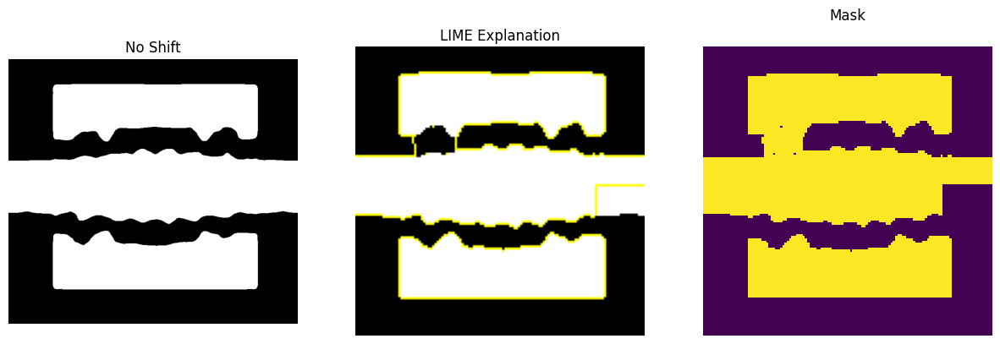

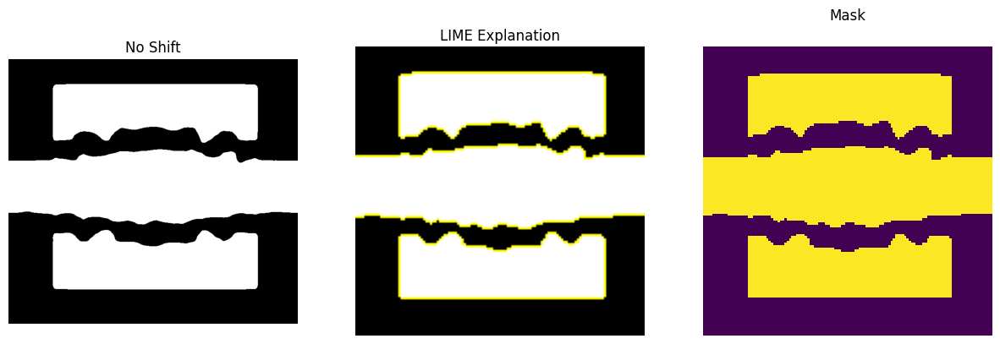

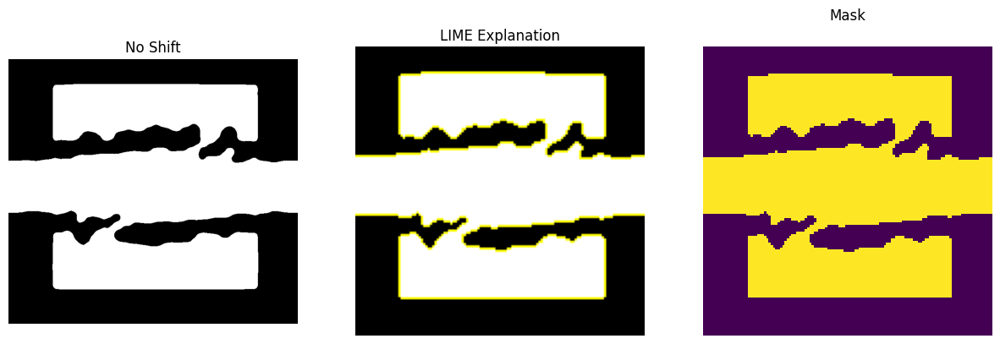

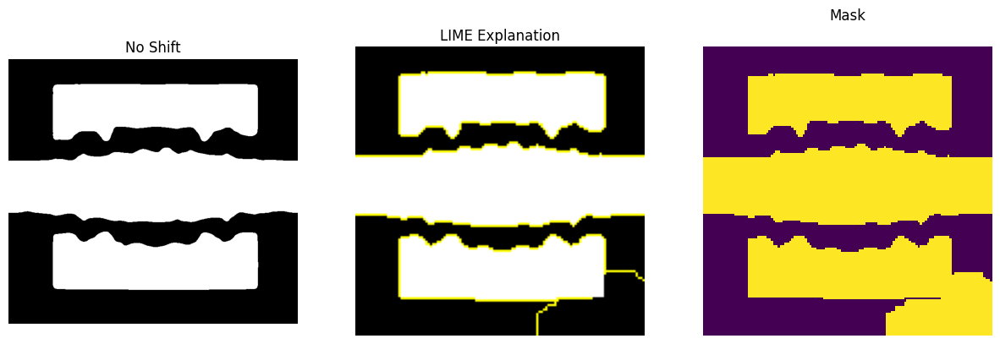

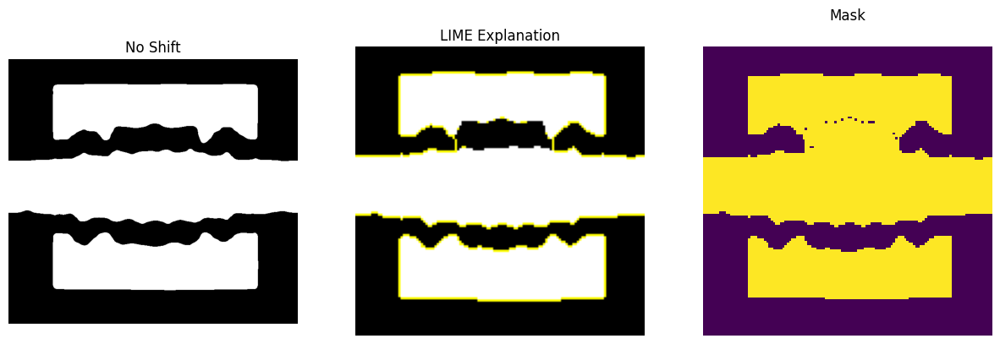

...

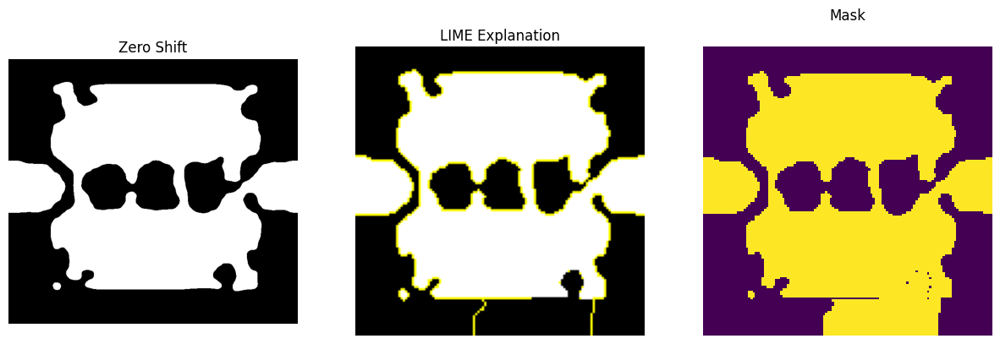

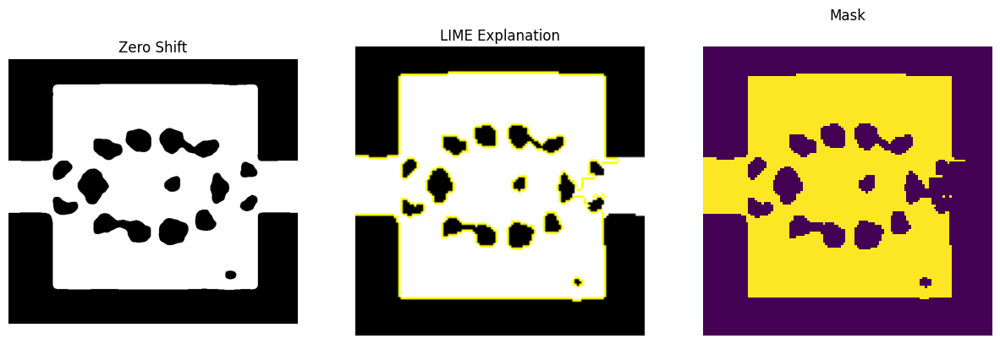

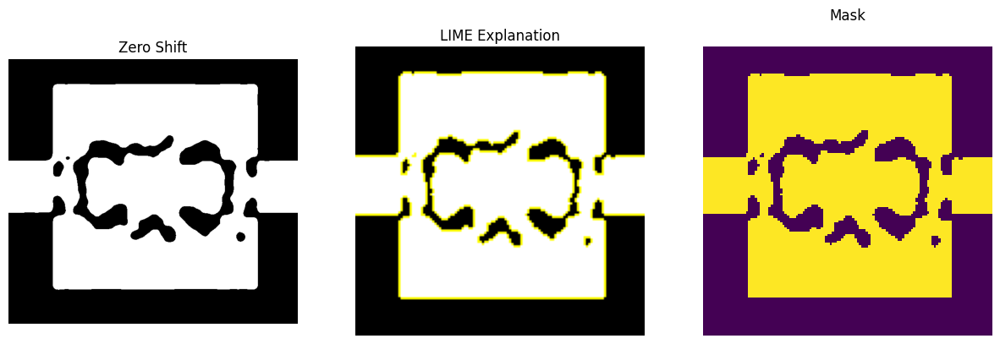

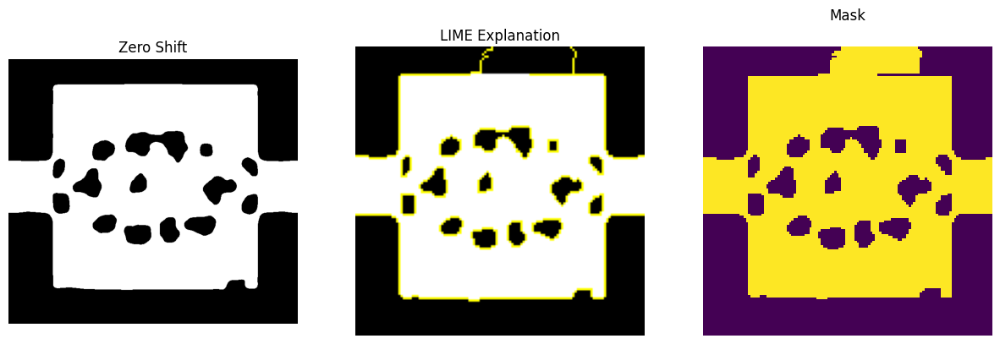

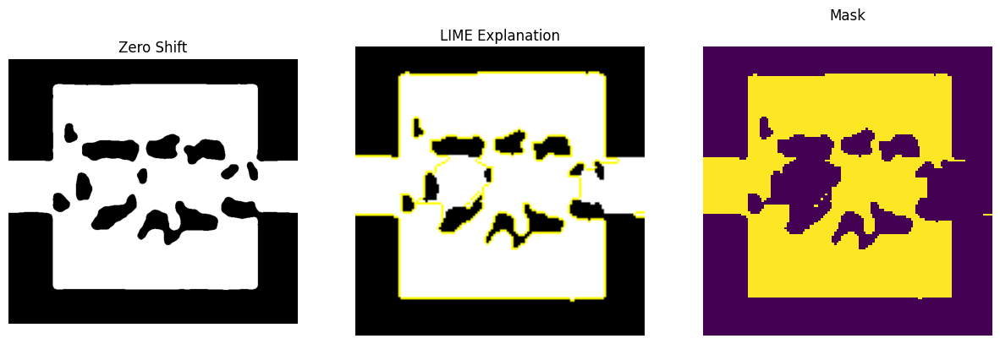

In [29]:
from skimage.segmentation import mark_boundaries
from lime import lime_image
from concurrent.futures import ThreadPoolExecutor
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Prediction function optimized for batch processing
def predict_fn(images):
    if images.shape[-1] == 3:  # If images are RGB, convert to grayscale
        images = np.mean(images, axis=-1, keepdims=True)
    images = np.array([cv2.resize(img, (256, 256)) for img in images])  # Resize to match model input
    return model.predict(images).reshape(images.shape[0], -1)

# Define LIME explainer and segmentation algorithm
explainer = lime_image.LimeImageExplainer()

# Define the function for LIME explanation on a single image
def lime_explain(image, label):
    # Convert image for LIME (resizing for faster processing)
    sample_image = cv2.cvtColor((image * 255).astype('uint8').squeeze(), cv2.COLOR_GRAY2RGB)
    sample_image_resized = cv2.resize(sample_image, (128, 128))  # Downscale to 128x128

    explanation = explainer.explain_instance(
        sample_image_resized.astype('double'),
        predict_fn,
        top_labels=1,
        hide_color=0,
        num_samples=1000  # Keeping num_samples at 1000
    )

    # Get the image and mask for the top label
    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=True,
        num_features=10,  # Use the existing number of features
        hide_rest=False
    )

    return sample_image, temp, mask, label

# Run explanations in parallel using ThreadPoolExecutor
with ThreadPoolExecutor(max_workers=4) as executor:  # Set max_workers based on your system capacity
    results = list(executor.map(lime_explain, images, labels))

# Display results
for sample_image, temp, mask, label in results:
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
    ax1.imshow(sample_image, cmap='gray')
    if label[0] == 1:
        ax1.set_title("No Shift")
    elif label[1] == 1:
        ax1.set_title("Pi/2 Shift")
    else:
        ax1.set_title("Zero Shift")
    ax1.axis('off')
    
    ax2.imshow(mark_boundaries(temp, mask))
    ax2.set_title('LIME Explanation')
    ax2.axis('off')

    ax3.matshow(mask)
    ax3.set_title("Mask")
    ax3.axis('off')

plt.show()
